### Preparativos del código

In [220]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from scipy.stats import mode
import seaborn as sns

df = pd.read_csv('muertes_por_enfermedades.csv')

paises = df['Entity']

# Eliminar duplicados y convertirlo a una lista
paises_unicos = paises.drop_duplicates().tolist()

print(paises_unicos)


['Afghanistan', 'Africa', 'Albania', 'Algeria', 'Angola', 'Antigua and Barbuda', 'Argentina', 'Armenia', 'Asia', 'Australia', 'Austria', 'Azerbaijan', 'Bahamas', 'Bahrain', 'Bangladesh', 'Barbados', 'Belarus', 'Belgium', 'Belize', 'Benin', 'Bhutan', 'Bolivia', 'Bosnia and Herzegovina', 'Botswana', 'Brazil', 'Brunei', 'Bulgaria', 'Burkina Faso', 'Burundi', 'Cambodia', 'Cameroon', 'Canada', 'Cape Verde', 'Central African Republic', 'Chad', 'Chile', 'China', 'Colombia', 'Comoros', 'Congo', 'Costa Rica', "Cote d'Ivoire", 'Croatia', 'Cuba', 'Cyprus', 'Czechia', 'Democratic Republic of Congo', 'Denmark', 'Djibouti', 'Dominican Republic', 'East Timor', 'Ecuador', 'Egypt', 'El Salvador', 'Equatorial Guinea', 'Eritrea', 'Estonia', 'Eswatini', 'Ethiopia', 'Europe', 'Fiji', 'Finland', 'France', 'Gabon', 'Gambia', 'Georgia', 'Germany', 'Ghana', 'Greece', 'Grenada', 'Guatemala', 'Guinea', 'Guinea-Bissau', 'Guyana', 'Haiti', 'Honduras', 'Hungary', 'Iceland', 'India', 'Indonesia', 'Iran', 'Iraq', 'Ir

In [221]:
P_Africa = ["Africa", "Algeria", "Angola", "Benin", "Botswana", "Burkina Faso", "Burundi", "Cape Verde", "Central African Republic", "Chad", "Comoros", "Congo", "Democratic Republic of Congo",  "Djibouti",  "Egypt", "Equatorial Guinea",  "Eritrea", "Eswatini", "Ethiopia",  "Gabon", "Gambia","Ghana", "Guinea", "Guinea-Bissau", "Cote d'Ivoire", "Kenya", "Lesotho", "Liberia", "Libya", "Madagascar", "Malawi", "Mali", "Mauritania", "Mauritius", "Morocco", "Mozambique", "Namibia", "Niger", "Nigeria", "Rwanda", "Sao Tome and Principe", "Senegal", "Seychelles", "Sierra Leone", "Somalia",  "South Africa", "South Sudan", "Sudan", "Tanzania", "Togo", "Tunisia", "Uganda", "Zambia", "Zimbabwe"]

P_AmericaNorte = ["North America", "Antigua and Barbuda", "Bahamas", "Barbados", "Belize", "Canada", "Costa Rica", "Cuba", "Dominican Republic", "El Salvador", "Grenada", "Guatemala", "Haiti", "Honduras", "Jamaica", "Mexico", "Nicaragua", "Panama", "Saint Lucia", "Saint Vincent and the Grenadines", "Trinidad and Tobago", "United States"]

P_AmericaSur = ["South America","Argentina", "Bolivia", "Brazil", "Chile", "Colombia", "Ecuador", "Guyana", "Paraguay", "Peru", "Suriname", "Uruguay", "Venezuela"]

P_Asia = ["Asia", "Afghanistan", "Armenia", "Azerbaijan", "Bahrain", "Bangladesh", "Bhutan", "Brunei", "Cambodia", "China", "Cyprus", "East Timor", "Georgia", "India", "Indonesia", "Iran", "Iraq", "Israel", "Japan", "Jordan", "Kazakhstan", "Kuwait", "Kyrgyzstan", "Laos", "Lebanon", "Malaysia", "Maldives", "Mongolia", "Myanmar", "Nepal", "North Korea", "Oman", "Pakistan", "Philippines", "Qatar", "Saudi Arabia", "Singapore", "South Korea", "Sri Lanka", "Syria", "Tajikistan", "Thailand", "Turkmenistan", "United Arab Emirates", "Uzbekistan", "Vietnam", "Yemen"]

P_Europa = ["Europe", "Albania", "Austria", "Belarus", "Belgium", "Bosnia and Herzegovina", "Bulgaria", "Croatia", "Czechia", "Denmark", "Estonia", "Finland", "France", "Germany", "Greece", "Hungary", "Iceland", "Ireland", "Italy", "Latvia", "Lithuania", "Luxembourg", "Malta", "Moldova", "Montenegro", "Netherlands", "North Macedonia", "Norway", "Poland", "Portugal", "Romania", "Russia", "Serbia", "Slovakia", "Slovenia", "Spain", "Sweden", "Switzerland", "Ukraine", "United Kingdom"]

P_Oceania = ["Oceania", "Australia", "Fiji", "Kiribati", "Micronesia (country)", "New Zealand", "Papua New Guinea", "Samoa", "Solomon Islands", "Tonga", "Vanuatu"]

#Mundo = ["World"]

In [222]:
patologias = ['Deaths - Cause: Rheumatic heart disease - Sex: Both sexes - Age group: ALLAges',
              'Deaths - Cause: Cardiomyopathy, myocarditis, endocarditis - Sex: Both sexes - Age group: ALLAges',
              'Deaths - Cause: Other circulatory diseases - Sex: Both sexes - Age group: ALLAges',
              'Deaths - Cause: Hypertensive heart disease - Sex: Both sexes - Age group: ALLAges',
              'Deaths - Cause: Ischaemic stroke - Sex: Both sexes - Age group: ALLAges',
              'Deaths - Cause: Haemorrhagic stroke - Sex: Both sexes - Age group: ALLAges',
              'Deaths - Cause: Ischaemic heart disease - Sex: Both sexes - Age group: ALLAges']

continentes = {"Africa" : P_Africa, "America del Norte" : P_AmericaNorte, "America del Sur" : P_AmericaSur, "Asia" : P_Asia, "Europa" : P_Europa, "Oceania" :P_Oceania, } #"Mundo" : Mundo

def reemplazar_texto(texto):
    reemplazos = {'Deaths - Cause: Rheumatic heart disease - Sex: Both sexes - Age group: ALLAges': 'Muertes por Enfermedad Cardíaca Reumática',
                  'Deaths - Cause: Cardiomyopathy, myocarditis, endocarditis - Sex: Both sexes - Age group: ALLAges': 'Muertes por Cardiomiopatía, Miocarditis y Endocarditis',
                  'Deaths - Cause: Other circulatory diseases - Sex: Both sexes - Age group: ALLAges': 'Muertes por Enfermedades Circulatorias',
                  'Deaths - Cause: Hypertensive heart disease - Sex: Both sexes - Age group: ALLAges': 'Muertes por Enfermedad Cardíaca Hipertensiva',
                  'Deaths - Cause: Ischaemic stroke - Sex: Both sexes - Age group: ALLAges': 'Muertes por Ictus Isquémico',
                  'Deaths - Cause: Haemorrhagic stroke - Sex: Both sexes - Age group: ALLAges': 'Muertes por Ictus Hemorrágico',
                  'Deaths - Cause: Ischaemic heart disease - Sex: Both sexes - Age group: ALLAges': 'Muertes por Enfermedad Cardíaca Isquémica'}
    return reemplazos.get(texto, texto)

#### Definición de listas

In [223]:
Paises_Africa = df[df['Entity'].isin(P_Africa)]
Paises_Asia = df[df['Entity'].isin(P_Asia)]
Paises_AmericaNorte = df[df['Entity'].isin(P_AmericaNorte)]
Paises_AmericaSur = df[df['Entity'].isin(P_AmericaSur)]
Paises_Oceania = df[df['Entity'].isin(P_Oceania)]
Paises_Europa = df[df['Entity'].isin(P_Europa)]


#### Creación de archivo csv que podría ser útil

In [224]:
import csv

# Nombre del archivo CSV
nombre_archivo = "paises.csv"

# Columnas adicionales
columnas_adicionales = [
    "Year",
    "Deaths - Cause: Rheumatic heart disease - Sex: Both sexes - Age group: ALLAges",
    "Deaths - Cause: Cardiomyopathy, myocarditis, endocarditis - Sex: Both sexes - Age group: ALLAges",
    "Deaths - Cause: Other circulatory diseases - Sex: Both sexes - Age group: ALLAges",
    "Deaths - Cause: Hypertensive heart disease - Sex: Both sexes - Age group: ALLAges",
    "Deaths - Cause: Ischaemic stroke - Sex: Both sexes - Age group: ALLAges",
    "Deaths - Cause: Haemorrhagic stroke - Sex: Both sexes - Age group: ALLAges",
    "Deaths - Cause: Ischaemic heart disease - Sex: Both sexes - Age group: ALLAges"
]

# Crear y escribir datos en el archivo CSV
with open(nombre_archivo, mode='w', newline='', encoding='utf-8') as archivo:
    escritor = csv.writer(archivo)
    # Escribir el encabezado
    encabezado = ["Entity"] + columnas_adicionales
    escritor.writerow(encabezado)
    # Escribir cada país 20 veces con los años del 2000 al 2019
    for pais in paises_unicos:
        for year in range(2000, 2020):
            escritor.writerow([pais, year] + [''] * (len(columnas_adicionales) - 1))

print(f"Archivo {nombre_archivo} creado exitosamente.")

Archivo paises.csv creado exitosamente.


### Medidas de tendencia central

#### Media

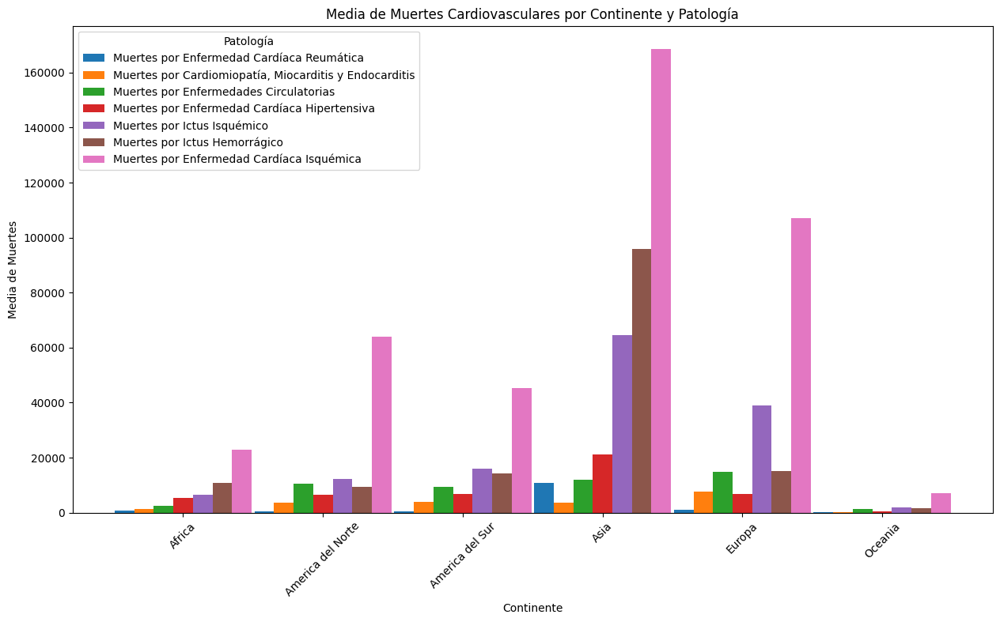

In [214]:
def calcular_media_continentes(data):
  return np.mean(data)


resultados = []

for continente, paises in continentes.items():
    df_continente = df[df['Entity'].isin(paises)]

    for patologia in patologias:
        data_patologia = df_continente[patologia]
        media = calcular_media_continentes(data_patologia)
        patologia_legible = reemplazar_texto(patologia)
        resultados.append({
            'Continente': continente,
            'Patologia': patologia_legible,
            'Media': media
        })

resultados_df = pd.DataFrame(resultados)


plt.figure(figsize=(15, 8))

bar_width = 0.14
index = np.arange(len(continentes))


for i, patologia in enumerate(resultados_df['Patologia'].unique()):
    subset = resultados_df[resultados_df['Patologia'] == patologia]
    plt.bar(index + i * bar_width, subset['Media'], bar_width, label=patologia)

plt.title('Media de Muertes Cardiovasculares por Continente y Patología')
plt.xlabel('Continente')
plt.ylabel('Media de Muertes')
plt.xticks(index + bar_width * (len(patologias) - 1) / 2, continentes.keys())
plt.legend(title='Patología')
plt.xticks(rotation=45)
plt.show()

#### Mediana

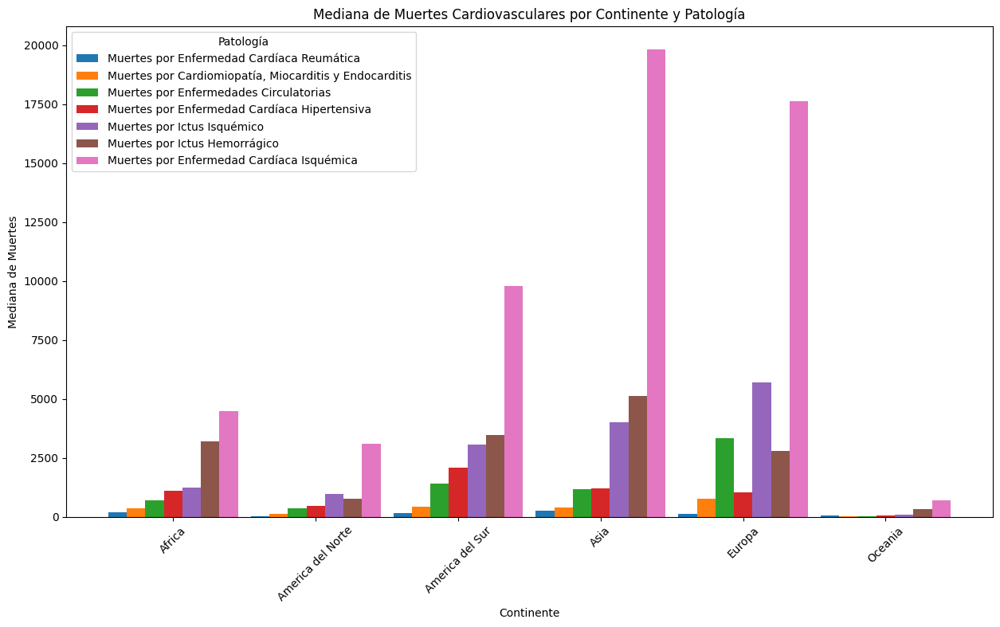

In [215]:
def calcular_mediana_continentes(data):
  return np.median(data)

resultados = []

for continente, paises in continentes.items():
    df_continente = df[df['Entity'].isin(paises)]

    for patologia in patologias:
        data_patologia = df_continente[patologia]
        mediana = calcular_mediana_continentes(data_patologia)
        patologia_legible = reemplazar_texto(patologia)
        resultados.append({
            'Continente': continente,
            'Patologia': patologia_legible,
            'Mediana': mediana
        })

# Convertir la lista de resultados a un DataFrame
resultados_df = pd.DataFrame(resultados)

# Graficar el histograma
plt.figure(figsize=(15, 8))
bar_width = 0.13
index = np.arange(len(continentes))

for i, patologia in enumerate(resultados_df['Patologia'].unique()):
    subset = resultados_df[resultados_df['Patologia'] == patologia]
    plt.bar(index + i * bar_width, subset['Mediana'], bar_width, label=patologia)

plt.title('Mediana de Muertes Cardiovasculares por Continente y Patología')
plt.xlabel('Continente')
plt.ylabel('Mediana de Muertes')
plt.xticks(index + bar_width * (len(patologias) - 1) / 2, continentes.keys())
plt.legend(title='Patología')
plt.xticks(rotation=45)
plt.show()

#### Varianza

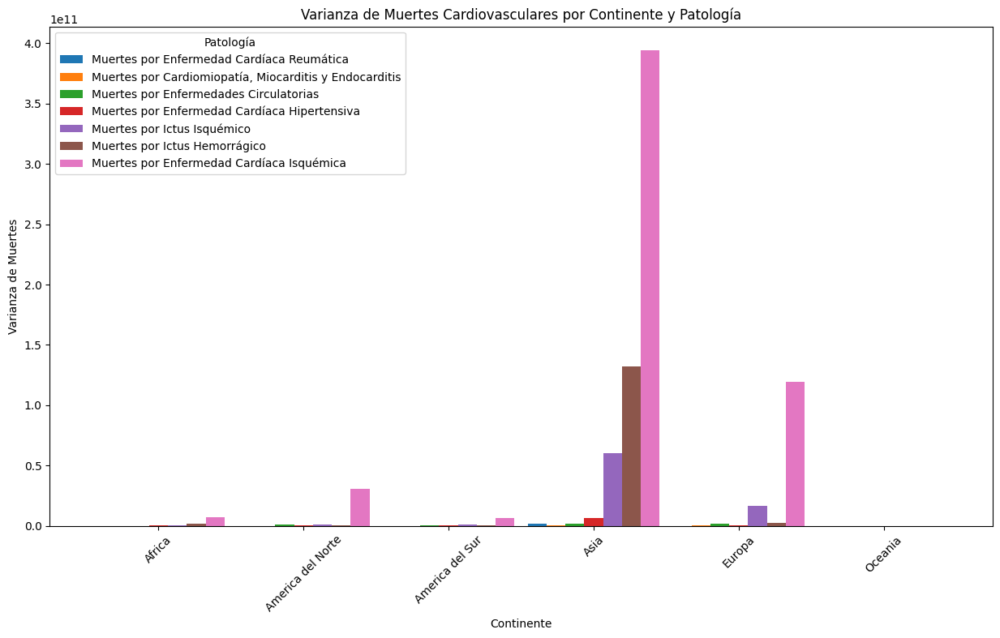

In [216]:
def calcular_varianza_continentes(data):
  return np.var(data)

# Diccionario para almacenar los resultados
resultados = []

# Calcular la varianza y almacenar los resultados
for continente, paises in continentes.items():
    df_continente = df[df['Entity'].isin(paises)]

    for patologia in patologias:
        data_patologia = df_continente[patologia]
        varianza = calcular_varianza_continentes(data_patologia)
        patologia_legible = reemplazar_texto(patologia)
        resultados.append({
            'Continente': continente,
            'Patologia': patologia_legible,
            'Varianza': varianza
        })

# Convertir la lista de resultados a un DataFrame
resultados_df = pd.DataFrame(resultados)

# Graficar el histograma de varianza
plt.figure(figsize=(15, 8))

bar_width = 0.13
index = np.arange(len(continentes))

# Iterar sobre las patologías para crear barras agrupadas
for i, patologia in enumerate(resultados_df['Patologia'].unique()):
    subset = resultados_df[resultados_df['Patologia'] == patologia]
    plt.bar(index + i * bar_width, subset['Varianza'], bar_width, label=patologia)

# Configuración del gráfico
plt.title('Varianza de Muertes Cardiovasculares por Continente y Patología')
plt.xlabel('Continente')
plt.ylabel('Varianza de Muertes')
plt.xticks(index + bar_width * (len(patologias) - 1) / 2, continentes.keys())
plt.legend(title='Patología')
plt.xticks(rotation=45)
plt.show()

#### Desviación estándar

Desviación estándar de Muertes Cardiovasculares en Africa
La Desviación estándar de Muertes por Enfermedad Cardíaca Reumática es: 2553.8927530788687
La Desviación estándar de Muertes por Cardiomiopatía, Miocarditis y Endocarditis es: 4948.268206693669
La Desviación estándar de Muertes por Enfermedades Circulatorias es: 9754.930564334583
La Desviación estándar de Muertes por Enfermedad Cardíaca Hipertensiva es: 19523.698056505284
La Desviación estándar de Muertes por Ictus Isquémico es: 24275.76307770034
La Desviación estándar de Muertes por Ictus Hemorrágico es: 39984.93196650453
La Desviación estándar de Muertes por Enfermedad Cardíaca Isquémica es: 86116.19476933702
----------------------------------------------------------------------------------
Desviación estándar de Muertes Cardiovasculares en America del Norte
La Desviación estándar de Muertes por Enfermedad Cardíaca Reumática es: 1436.8451596787072
La Desviación estándar de Muertes por Cardiomiopatía, Miocarditis y Endocarditis

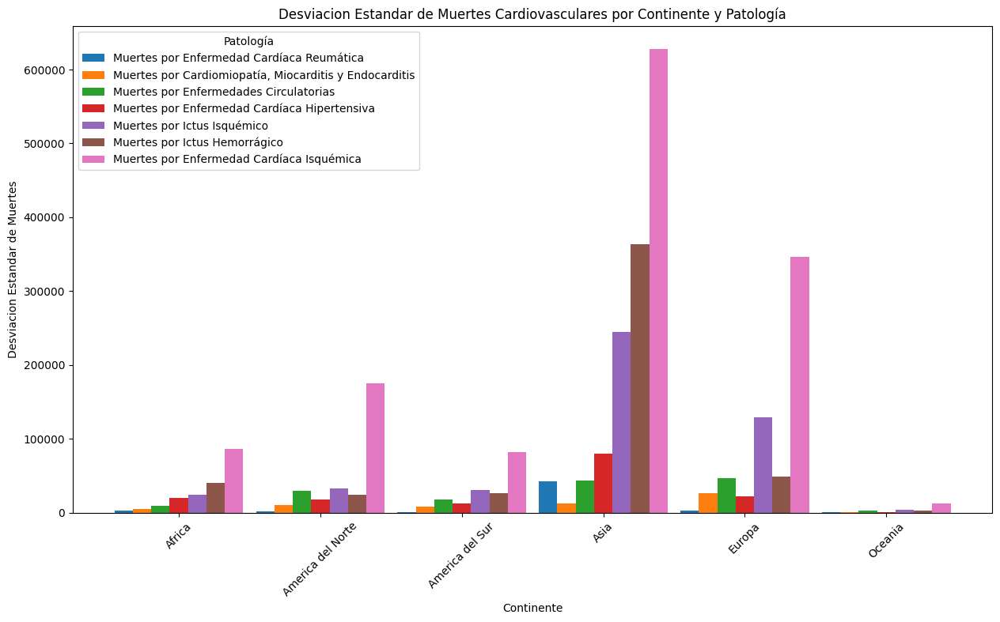

In [217]:
for continente, paises in continentes.items():
    df_continente = df[df['Entity'].isin(paises)]
    print(f"Desviación estándar de Muertes Cardiovasculares en {continente}")

    for patologia in patologias:
        data_patologia = df_continente[patologia]
        desv_est = np.sqrt(calcular_varianza_continentes(data_patologia))
        patologia_legible = reemplazar_texto(patologia)

        print(f"La Desviación estándar de {patologia_legible} es: {desv_est}")
    print("----------------------------------------------------------------------------------")

  # Diccionario para almacenar los resultados
resultados = []

# Calcular la varianza y almacenar los resultados
for continente, paises in continentes.items():
    df_continente = df[df['Entity'].isin(paises)]

    for patologia in patologias:
        data_patologia = df_continente[patologia]
        desv_est = np.sqrt(calcular_varianza_continentes(data_patologia))
        patologia_legible = reemplazar_texto(patologia)
        resultados.append({
            'Continente': continente,
            'Patologia': patologia_legible,
            'Desviacion Estandar': desv_est
        })

# Convertir la lista de resultados a un DataFrame
resultados_df = pd.DataFrame(resultados)

# Graficar el histograma de varianza
plt.figure(figsize=(15, 8))

bar_width = 0.13
index = np.arange(len(continentes))

# Iterar sobre las patologías para crear barras agrupadas
for i, patologia in enumerate(resultados_df['Patologia'].unique()):
    subset = resultados_df[resultados_df['Patologia'] == patologia]
    plt.bar(index + i * bar_width, subset['Desviacion Estandar'], bar_width, label=patologia)

# Configuración del gráfico
plt.title('Desviacion Estandar de Muertes Cardiovasculares por Continente y Patología')
plt.xlabel('Continente')
plt.ylabel('Desviacion Estandar de Muertes')
plt.xticks(index + bar_width * (len(patologias) - 1) / 2, continentes.keys())
plt.legend(title='Patología')
plt.xticks(rotation=45)
plt.show()

In [218]:
from google.colab import drive
drive.mount('/content/drive')

ModuleNotFoundError: No module named 'google'

In [ ]:
def calcular_varianza_continentes(data):
  return np.var(data)

# Diccionario para almacenar los resultados
resultados = []

# Calcular la varianza y almacenar los resultados
for continente, paises in continentes.items():
    df_continente = df[df['Entity'].isin(paises)]

    for patologia in patologias:
        data_patologia = df_continente[patologia]
        varianza = calcular_varianza_continentes(data_patologia)
        patologia_legible = reemplazar_texto(patologia)
        resultados.append({
            'Continente': continente,
            'Patologia': patologia_legible,
            'Varianza': varianza
        })

In [ ]:
for continente, paises in continentes.items():
    df_continente = df[df['Entity'].isin(paises)]
    print(f"Desviación estándar de Muertes Cardiovasculares en {continente}")

    for patologia in patologias:
        data_patologia = df_continente[patologia]
        desv_est = np.sqrt(calcular_varianza_continentes(data_patologia))
        patologia_legible = reemplazar_texto(patologia)

        print(f"La Desviación estándar de {patologia_legible} es: {desv_est}")
    print("----------------------------------------------------------------------------------")

Desviación estándar de Muertes Cardiovasculares en Africa
La Desviación estándar de Muertes por Enfermedad Cardíaca Reumática es: 2553.8927530788687
La Desviación estándar de Muertes por Cardiomiopatía, Miocarditis y Endocarditis es: 4948.268206693669
La Desviación estándar de Muertes por Enfermedades Circulatorias es: 9754.930564334583
La Desviación estándar de Muertes por Enfermedad Cardíaca Hipertensiva es: 19523.698056505284
La Desviación estándar de Muertes por Ictus Isquémico es: 24275.76307770034
La Desviación estándar de Muertes por Ictus Hemorrágico es: 39984.93196650453
La Desviación estándar de Muertes por Enfermedad Cardíaca Isquémica es: 86116.19476933702
----------------------------------------------------------------------------------
Desviación estándar de Muertes Cardiovasculares en America del Norte
La Desviación estándar de Muertes por Enfermedad Cardíaca Reumática es: 1436.8451596787072
La Desviación estándar de Muertes por Cardiomiopatía, Miocarditis y Endocarditis

#### Moda

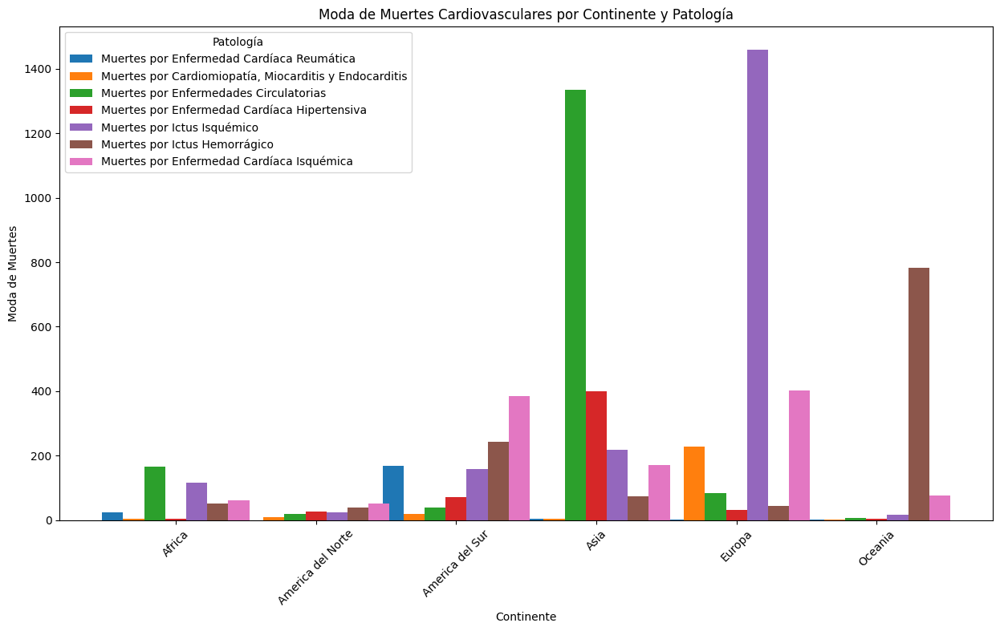

In [ ]:

# Definir la función para calcular la moda
def calcular_moda_continentes(data):
    if data.empty or data.isna().all():
        return np.nan
    moda_result = mode(data, nan_policy='omit')
    # Verificar si moda_result.count y moda_result.mode son escalares o arrays
    if isinstance(moda_result.count, np.ndarray):
        if moda_result.count.size > 0 and moda_result.count[0] > 0:
            return moda_result.mode[0]
    else:
        if moda_result.count > 0:
            return moda_result.mode
    return np.nan

# Lista para almacenar los resultados
resultados = []

# Iterar sobre cada continente y sus respectivos países
for continente, paises in continentes.items():
    df_continente = df[df['Entity'].isin(paises)]

    for patologia in patologias:
        data_patologia = df_continente[patologia]
        moda = calcular_moda_continentes(data_patologia)
        patologia_legible = reemplazar_texto(patologia)
        resultados.append({
            'Continente': continente,
            'Patologia': patologia_legible,
            'Moda': moda
        })

# Convertir la lista de resultados a un DataFrame
resultados_df = pd.DataFrame(resultados)

# Crear la figura para el gráfico
plt.figure(figsize=(15, 8))

# Configuración para las barras
bar_width = 0.15
index = np.arange(len(resultados_df['Continente'].unique()))

# Crear barras para cada patología
for i, patologia in enumerate(resultados_df['Patologia'].unique()):
    subset = resultados_df[resultados_df['Patologia'] == patologia]
    plt.bar(index + i * bar_width, subset['Moda'], bar_width, label=patologia)

# Configurar el gráfico
plt.title('Moda de Muertes Cardiovasculares por Continente y Patología')
plt.xlabel('Continente')
plt.ylabel('Moda de Muertes')
plt.xticks(index + bar_width * (len(resultados_df['Patologia'].unique()) - 1) / 2, resultados_df['Continente'].unique())
plt.legend(title='Patología')
plt.xticks(rotation=45)

# Mostrar el gráfico
plt.show()


### Rango

Rangos de muertes por enfermedades en Africa:
El rango de Muertes por Enfermedad Cardíaca Reumática es: 20652.04
El rango de Muertes por Cardiomiopatía, Miocarditis y Endocarditis es: 41908.55
El rango de Muertes por Enfermedades Circulatorias es: 85867.87000000001
El rango de Muertes por Enfermedad Cardíaca Hipertensiva es: 168949.03
El rango de Muertes por Ictus Isquémico es: 222580.45
El rango de Muertes por Ictus Hemorrágico es: 319762.4
El rango de Muertes por Enfermedad Cardíaca Isquémica es: 759482.9299999999
Rangos de muertes por enfermedades en America del Norte:
El rango de Muertes por Enfermedad Cardíaca Reumática es: 6772.0
El rango de Muertes por Cardiomiopatía, Miocarditis y Endocarditis es: 40493.43
El rango de Muertes por Enfermedades Circulatorias es: 140481.77000000002
El rango de Muertes por Enfermedad Cardíaca Hipertensiva es: 100504.29
El rango de Muertes por Ictus Isquémico es: 150371.72
El rango de Muertes por Ictus Hemorrágico es: 117844.38
El rango de Muertes p

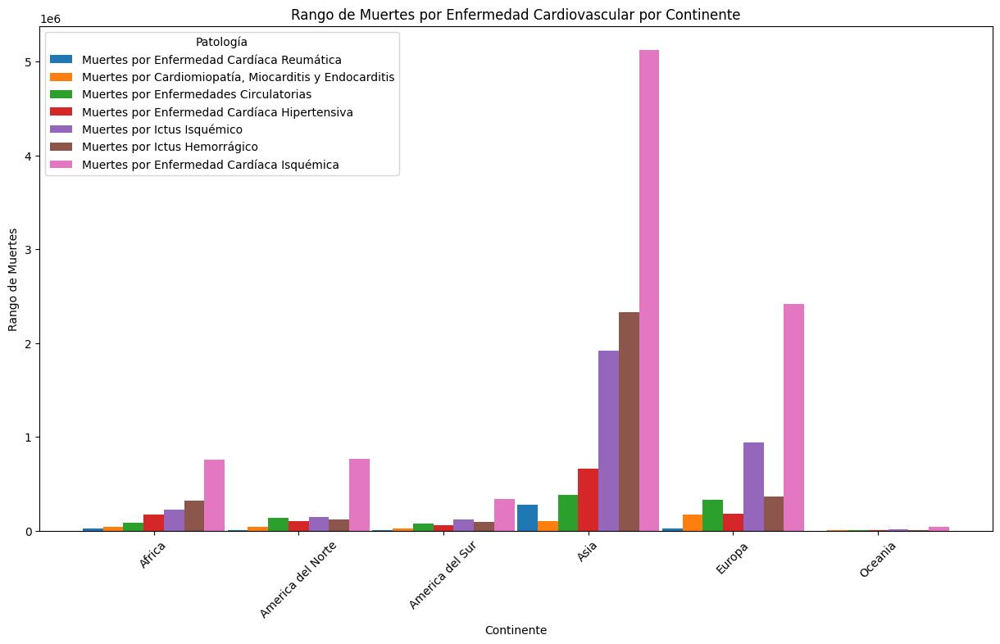

In [ ]:
def calcular_rango(data):
    return data.max() - data.min()

resultados = []

# Calcular el rango y almacenar los resultados
for continente, paises in continentes.items():
    df_continente = df[df['Entity'].isin(paises)]
    print(f"Rangos de muertes por enfermedades en {continente}:")

    for patologia in patologias:
        data_patologia = df_continente[patologia]
        rango = calcular_rango(data_patologia)
        patologia_legible = reemplazar_texto(patologia)
        resultados.append({
            'Continente': continente,
            'Patologia': patologia_legible,
            'Rango': rango
        })

        print(f"El rango de {patologia_legible} es: {rango}")

# Convertir la lista de resultados a un DataFrame
resultados_df = pd.DataFrame(resultados)

# Graficar el rango
plt.figure(figsize=(15, 8))

bar_width = 0.14
index = list(range(len(continentes)))  # Convertir el range a una lista

# Iterar sobre las patologías para crear barras agrupadas
for i, patologia in enumerate(resultados_df['Patologia'].unique()):
    subset = resultados_df[resultados_df['Patologia'] == patologia]
    plt.bar([x + i * bar_width for x in index], subset['Rango'], bar_width, label=patologia)  # Sumar elemento por elemento

# Configuración del gráfico
plt.title('Rango de Muertes por Enfermedad Cardiovascular por Continente')
plt.xlabel('Continente')
plt.ylabel('Rango de Muertes')
plt.xticks([x + bar_width * (len(patologias) - 1) / 2 for x in index], continentes.keys())  # Sumar elemento por elemento
plt.legend(title='Patología')
plt.xticks(rotation=45)
plt.show()


### Marcas de clase

In [ ]:
for continente, paises in continentes.items():
    df_continente = df[df['Entity'].isin(paises)]
    print(f"Marca de clase de muertes por enfermedades en {continentes}")

    for patologia in patologias:
        data_patologia = df_continente[patologia]
        rango = calcular_rango(data_patologia)
        num_bins = 1
        hist, bins = np.histogram(data_patologia, bins=num_bins)
        marcas_clase = [(bins[i] + bins[i + 1]) / 2 for i in range(len(bins) - 1)]

        patologia_legible = reemplazar_texto(patologia)
        print(f"Las marca de clase para {patologia_legible} es: {marcas_clase}")

    print("----------------------------------------------------------------------------------")

Marca de clase de muertes por enfermedades en {'Africa': ['Africa', 'Algeria', 'Angola', 'Benin', 'Botswana', 'Burkina Faso', 'Burundi', 'Cape Verde', 'Central African Republic', 'Chad', 'Comoros', 'Congo', 'Democratic Republic of Congo', 'Djibouti', 'Egypt', 'Equatorial Guinea', 'Eritrea', 'Eswatini', 'Ethiopia', 'Gabon', 'Gambia', 'Ghana', 'Guinea', 'Guinea-Bissau', "Cote d'Ivoire", 'Kenya', 'Lesotho', 'Liberia', 'Libya', 'Madagascar', 'Malawi', 'Mali', 'Mauritania', 'Mauritius', 'Morocco', 'Mozambique', 'Namibia', 'Niger', 'Nigeria', 'Rwanda', 'Sao Tome and Principe', 'Senegal', 'Seychelles', 'Sierra Leone', 'Somalia', 'South Africa', 'South Sudan', 'Sudan', 'Tanzania', 'Togo', 'Tunisia', 'Uganda', 'Zambia', 'Zimbabwe'], 'America del Norte': ['North America', 'Antigua and Barbuda', 'Bahamas', 'Barbados', 'Belize', 'Canada', 'Costa Rica', 'Cuba', 'Dominican Republic', 'El Salvador', 'Grenada', 'Guatemala', 'Haiti', 'Honduras', 'Jamaica', 'Mexico', 'Nicaragua', 'Panama', 'Saint Lucia'

Marca de clase de muertes por enfermedades en Africa


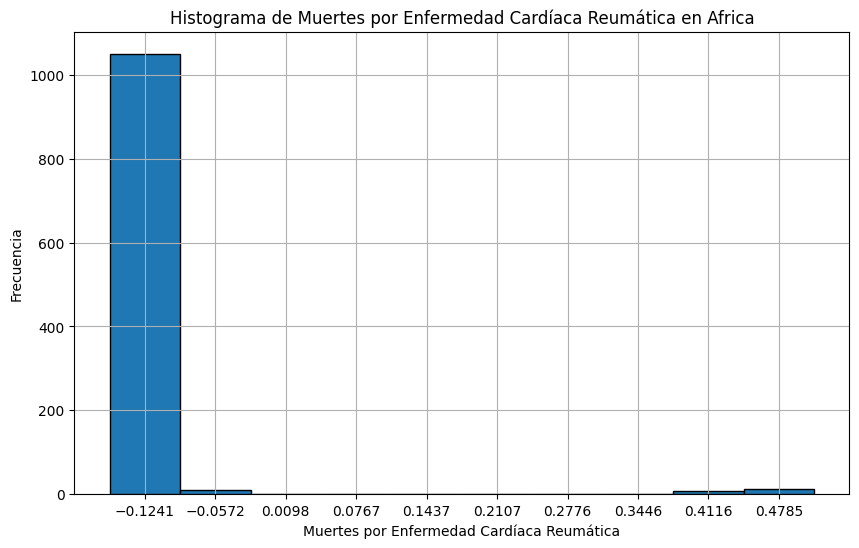

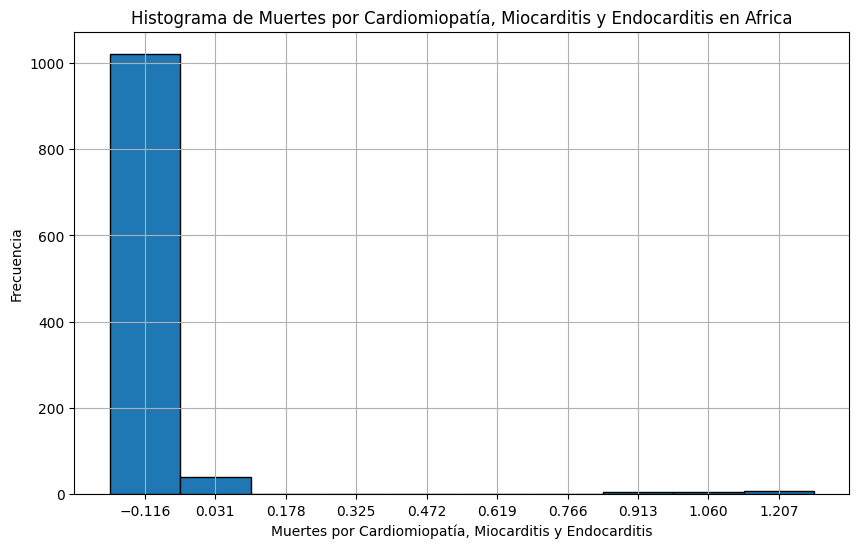

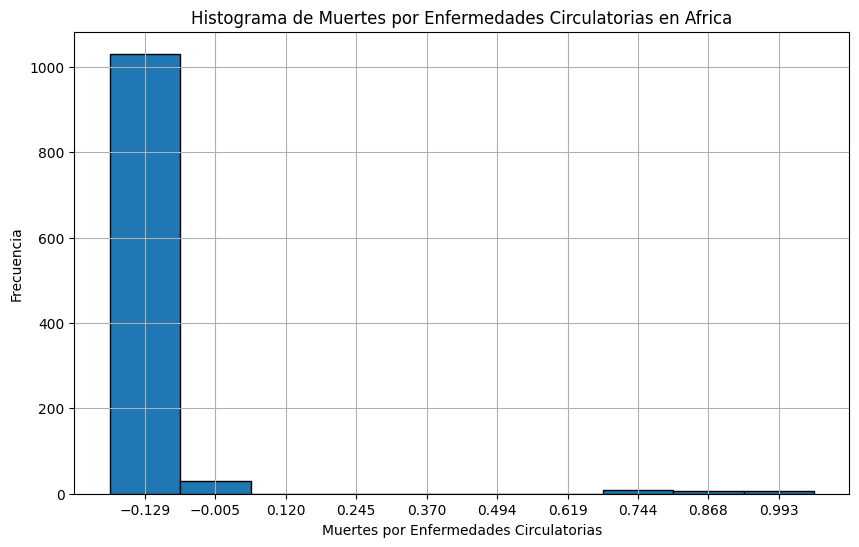

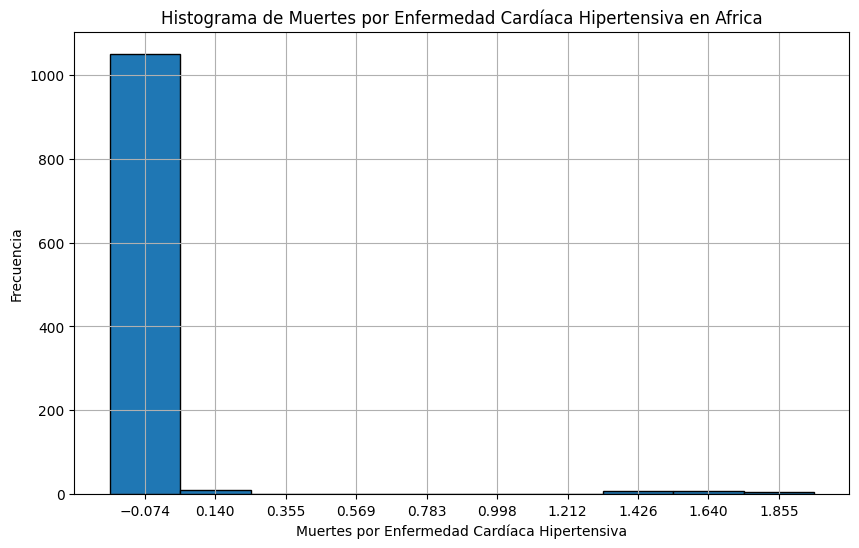

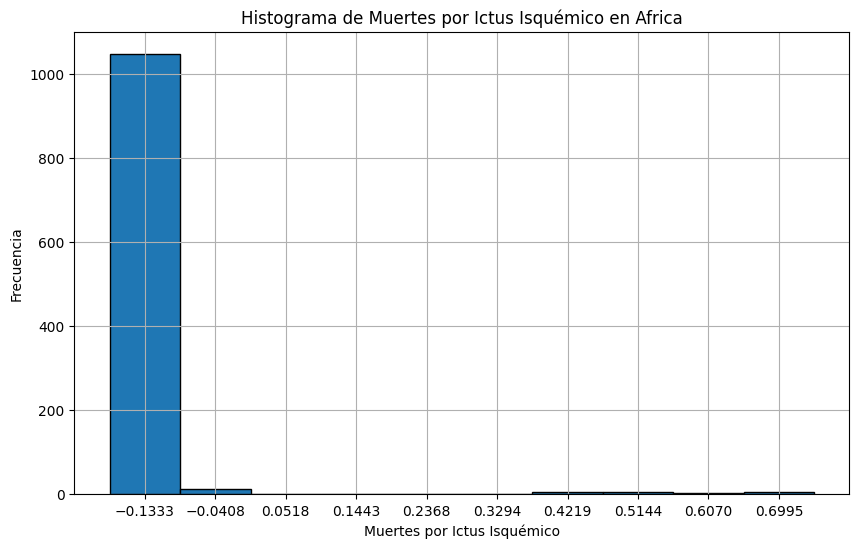

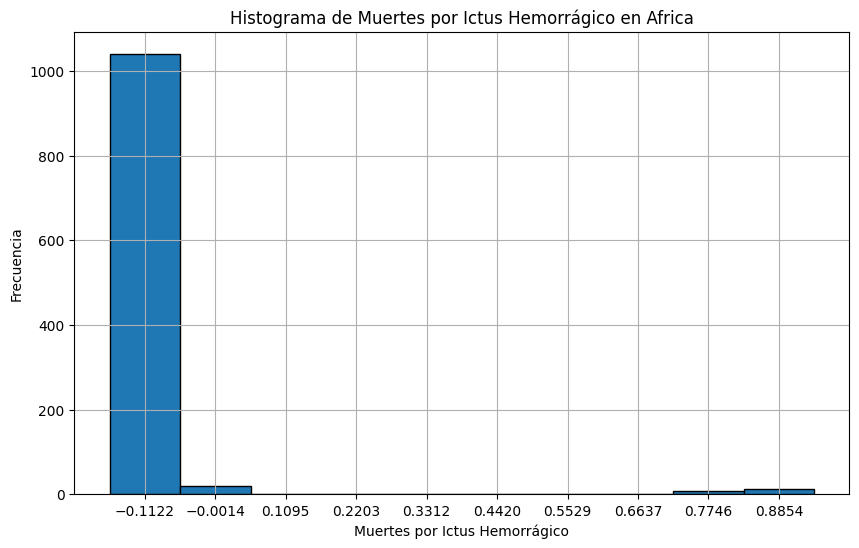

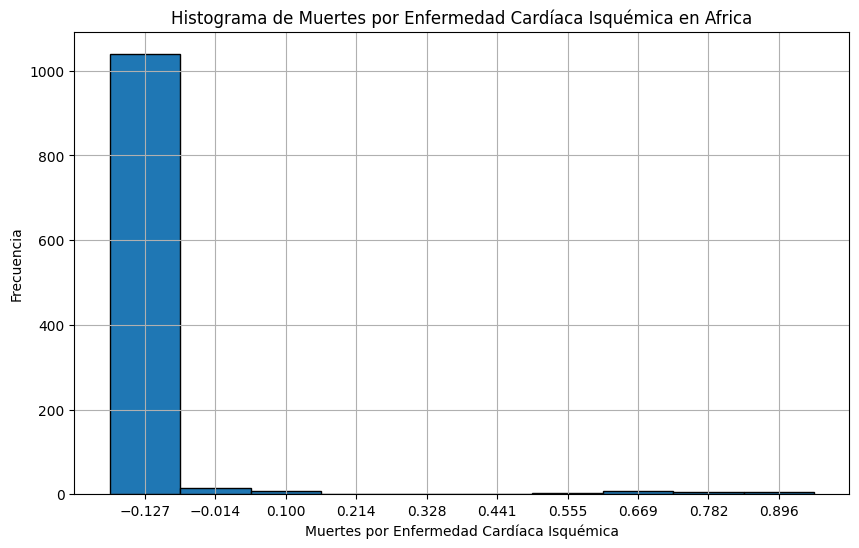

Marca de clase de muertes por enfermedades en America del Norte


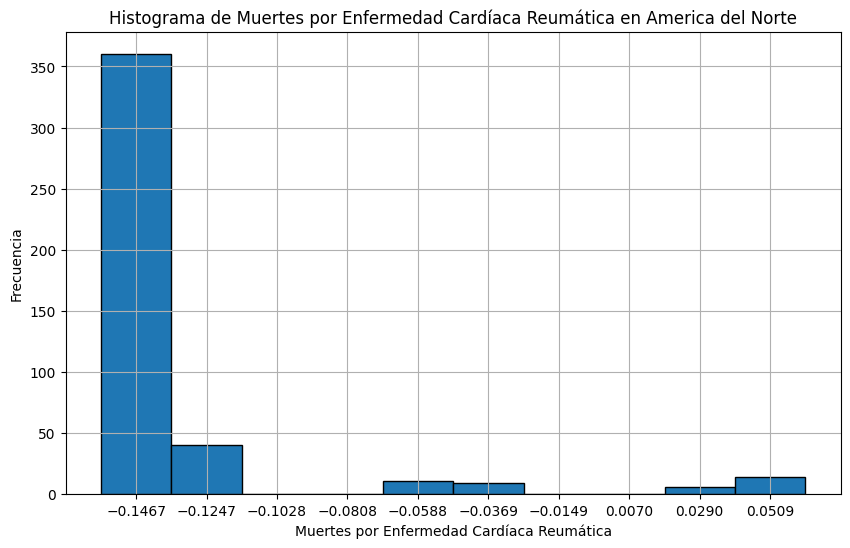

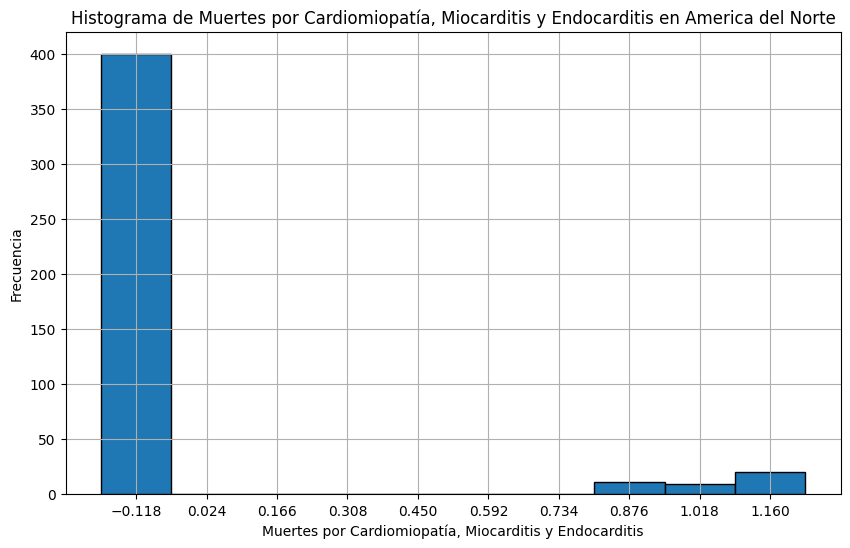

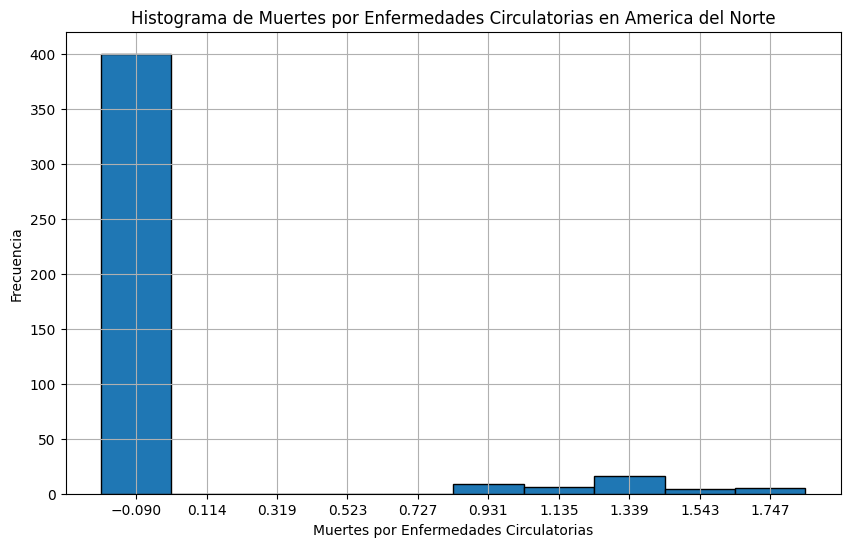

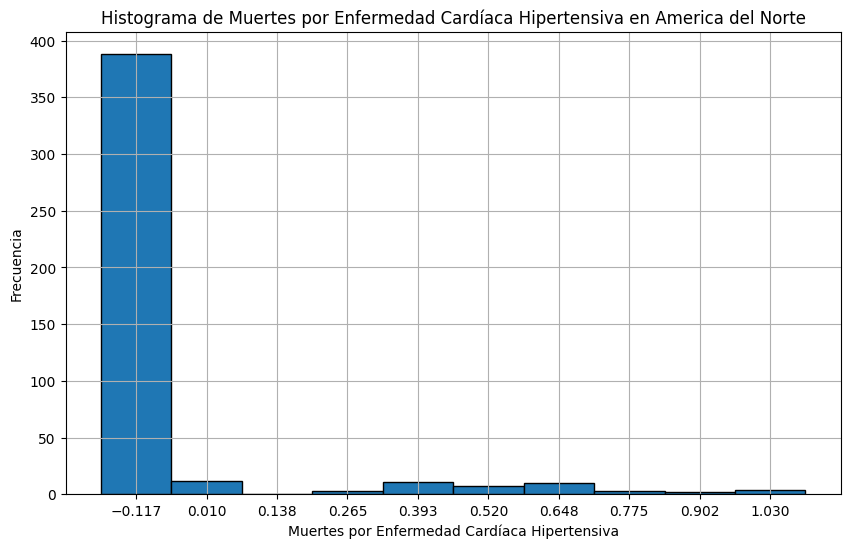

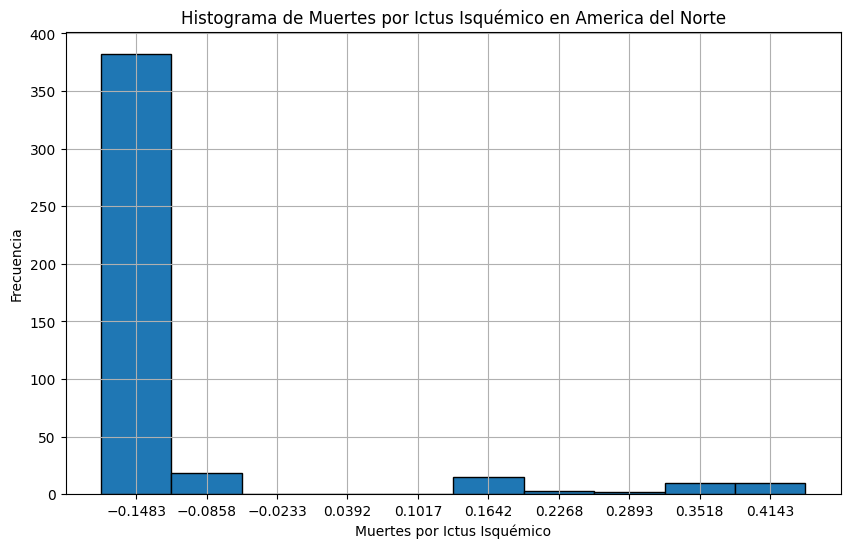

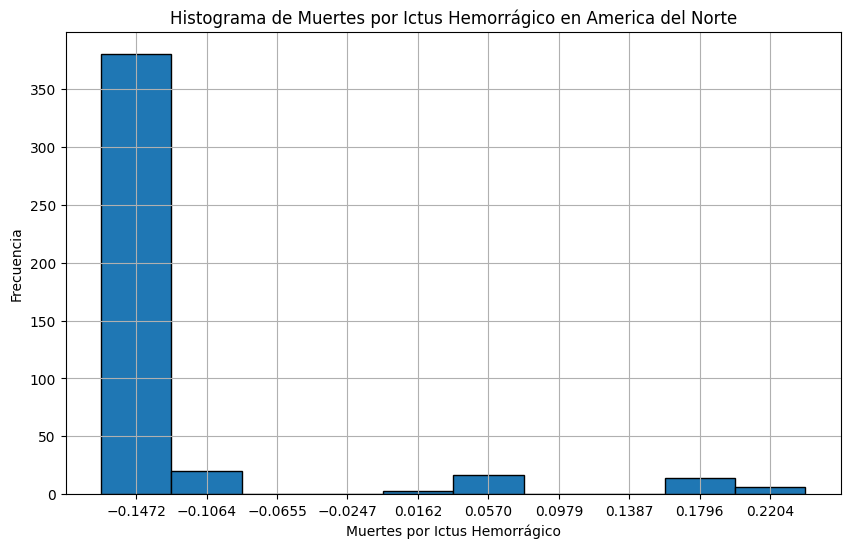

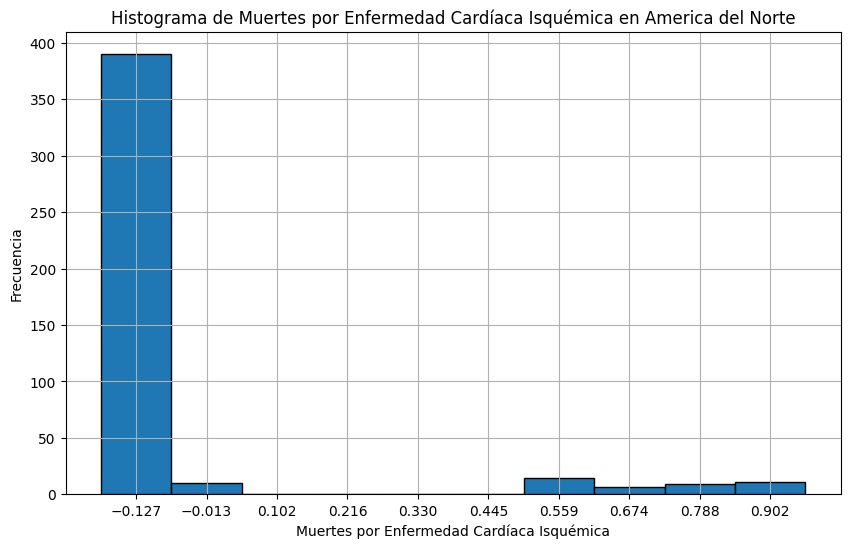

Marca de clase de muertes por enfermedades en America del Sur


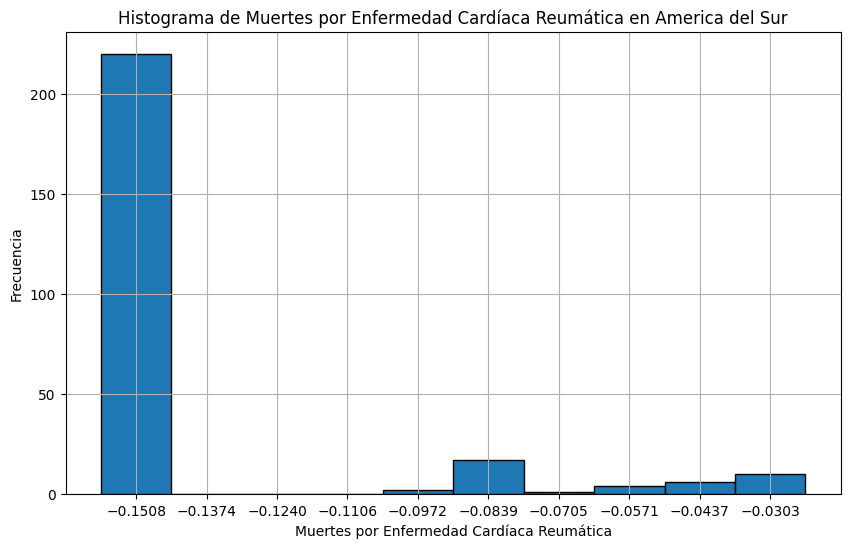

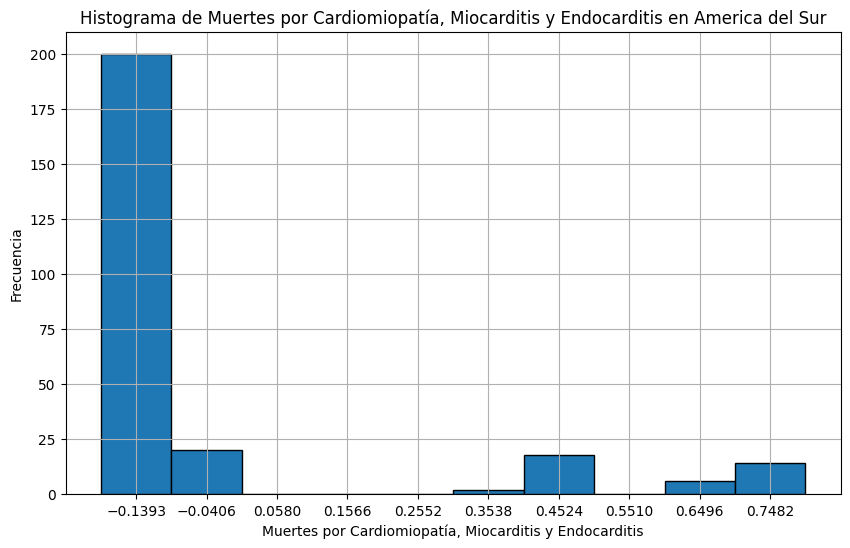

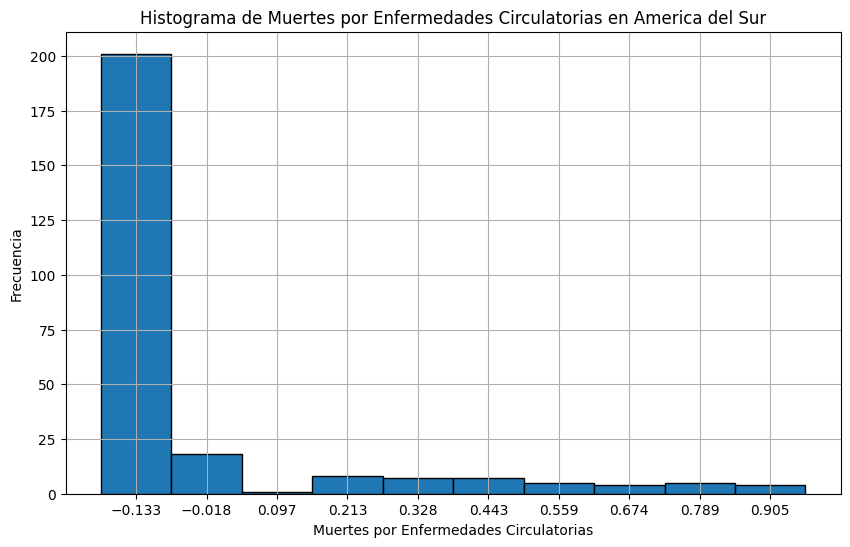

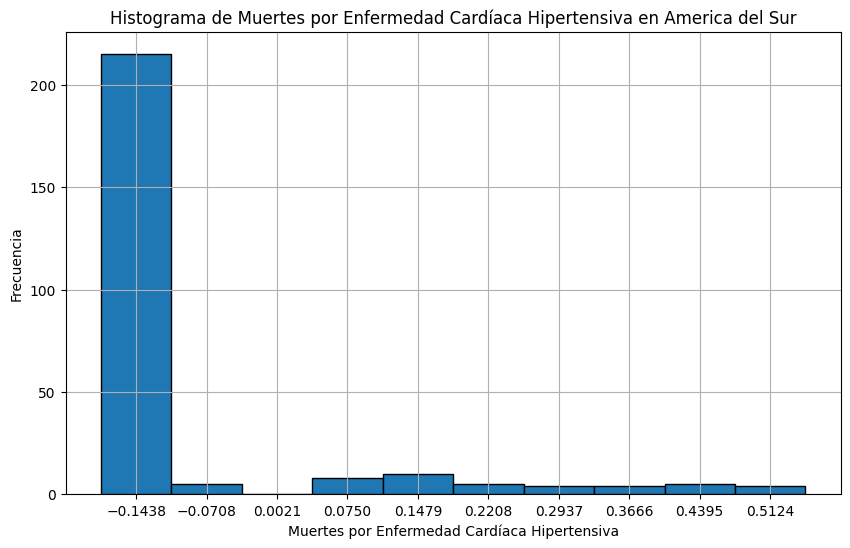

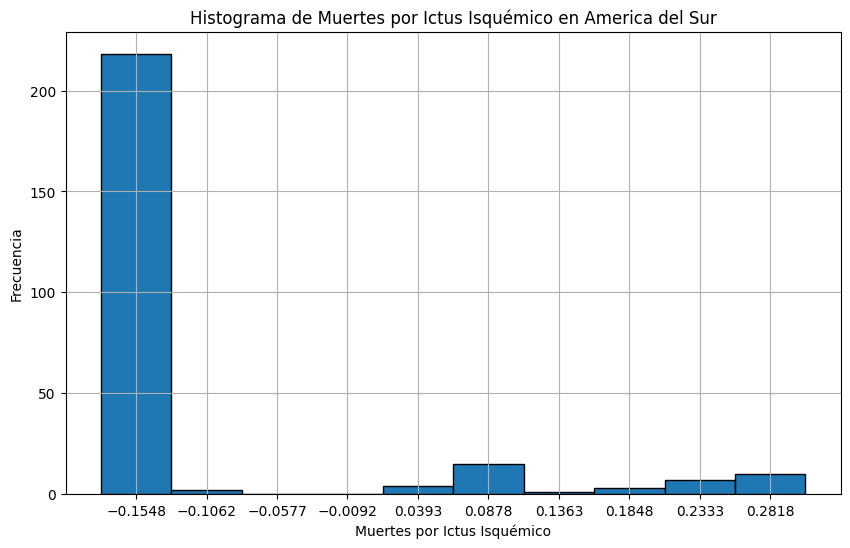

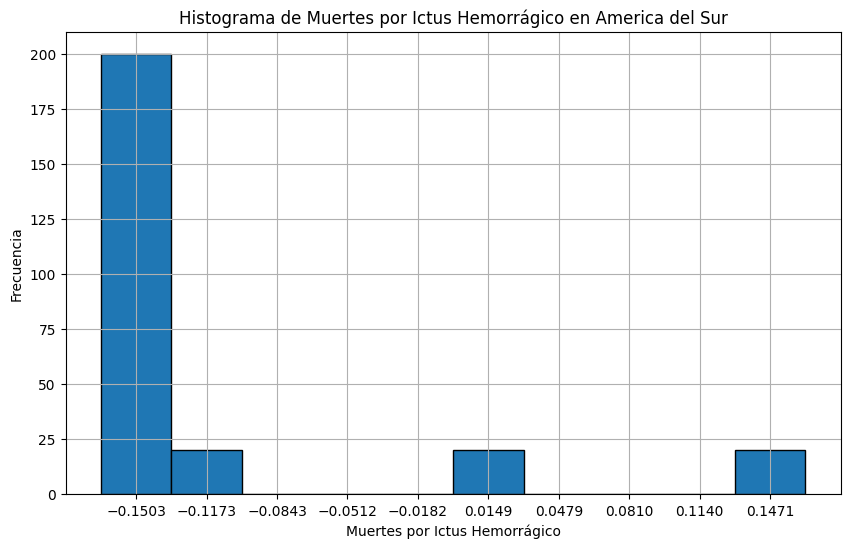

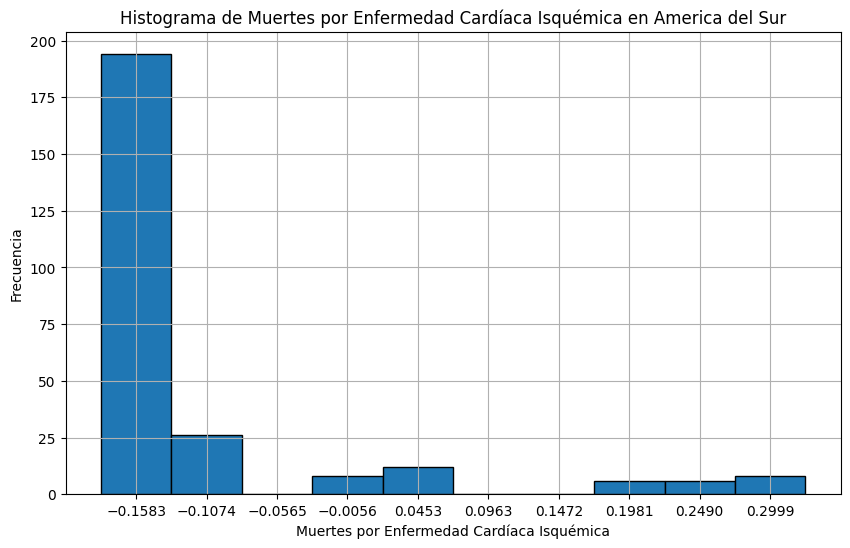

Marca de clase de muertes por enfermedades en Asia


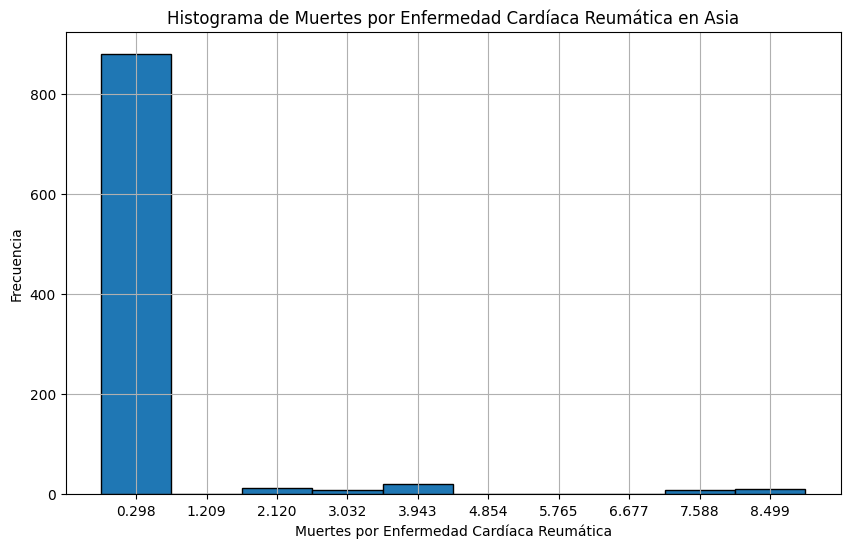

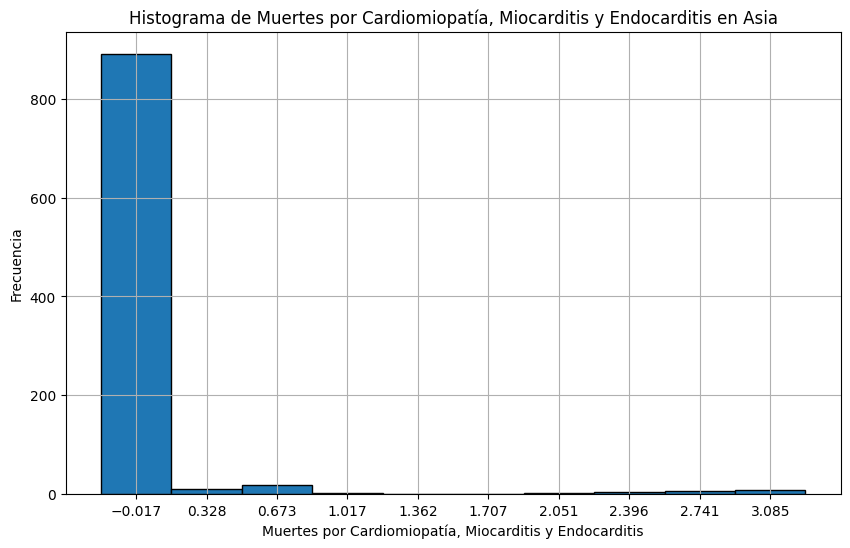

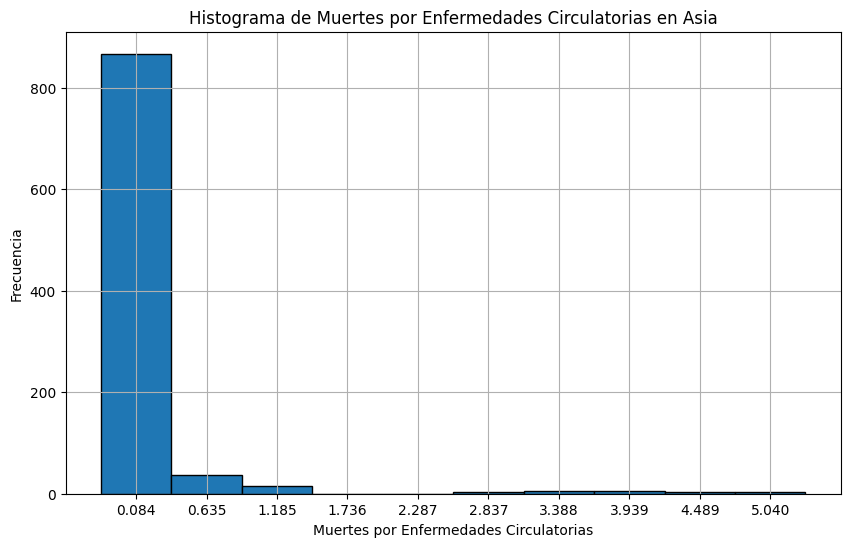

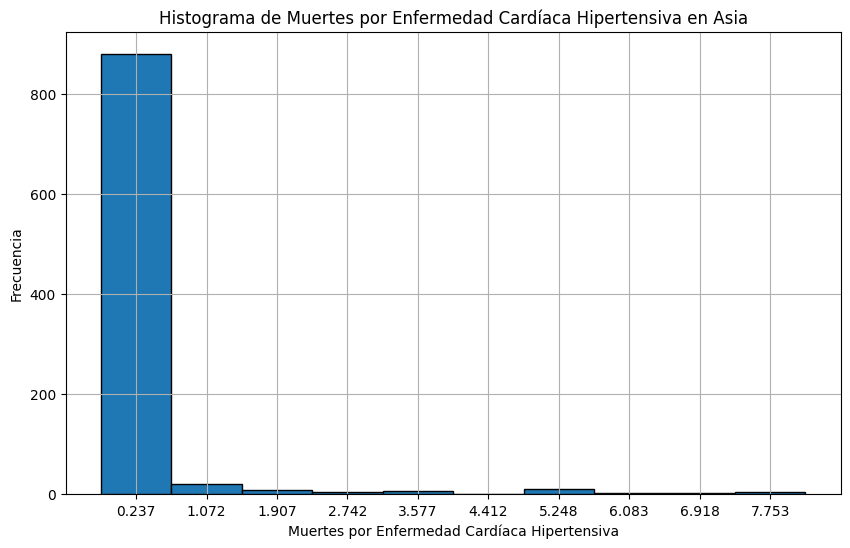

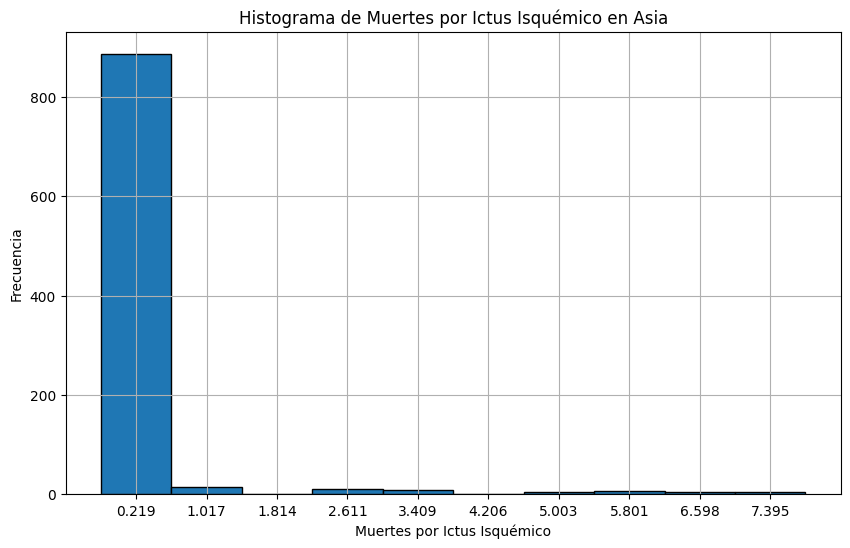

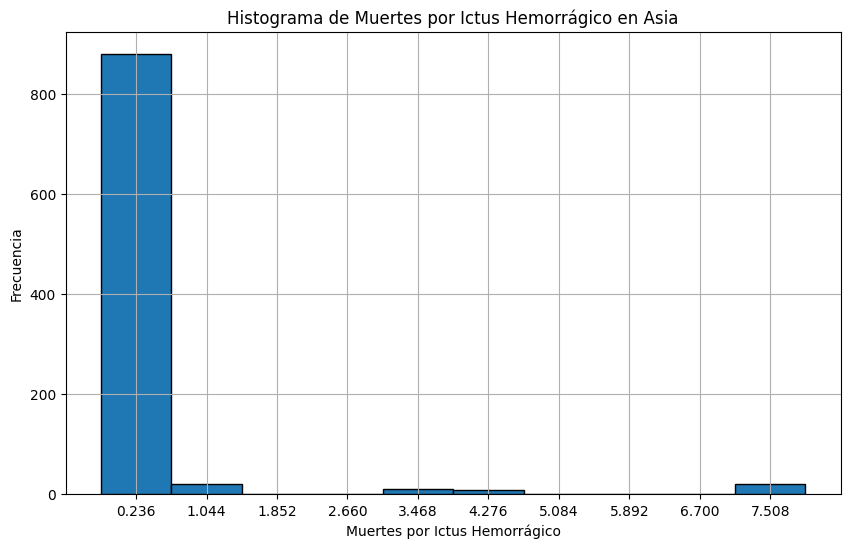

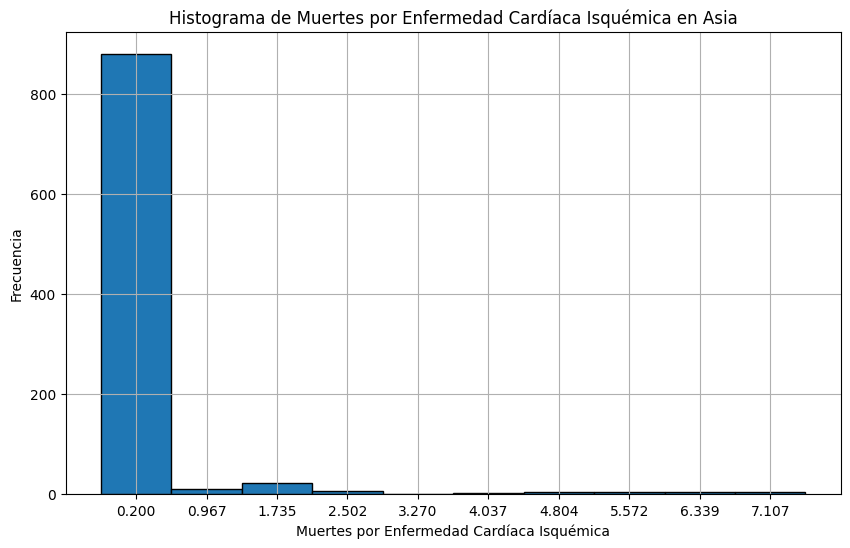

Marca de clase de muertes por enfermedades en Europa


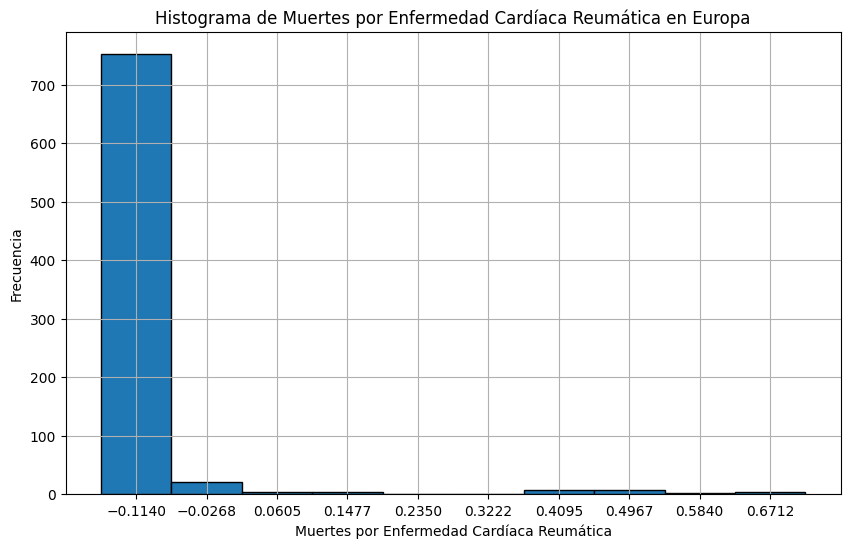

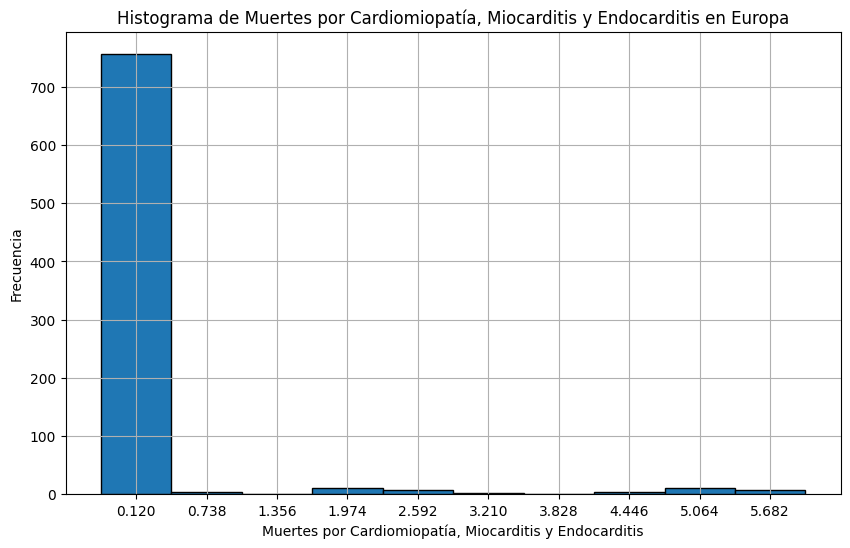

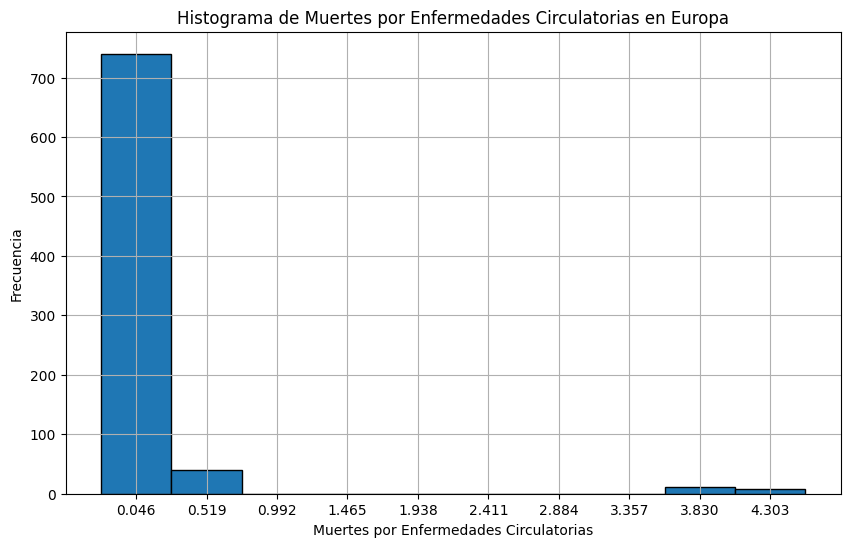

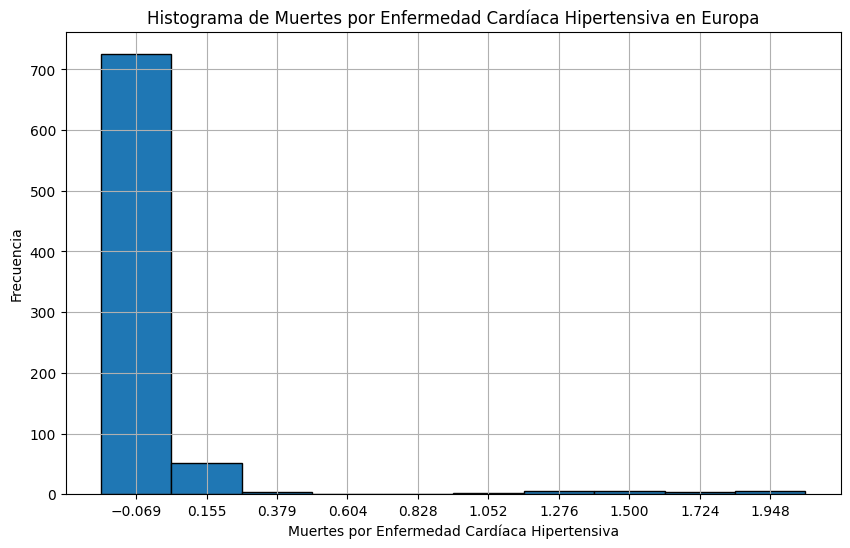

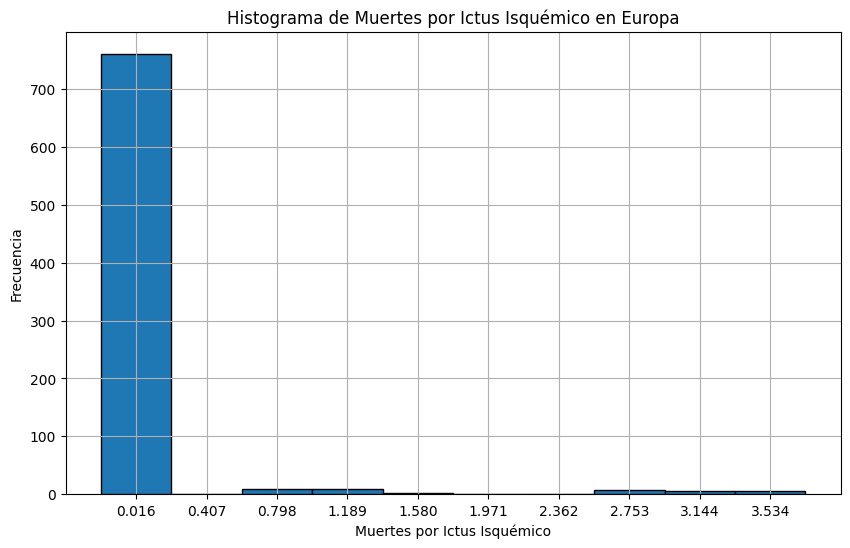

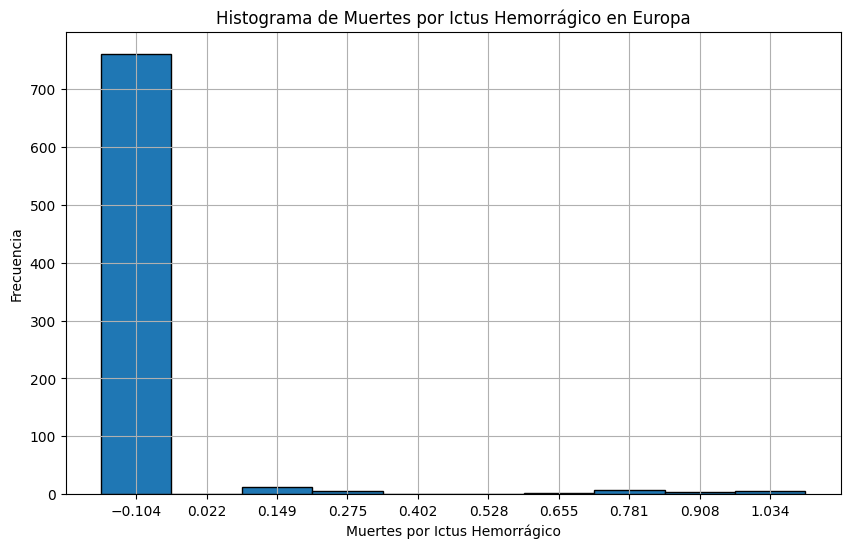

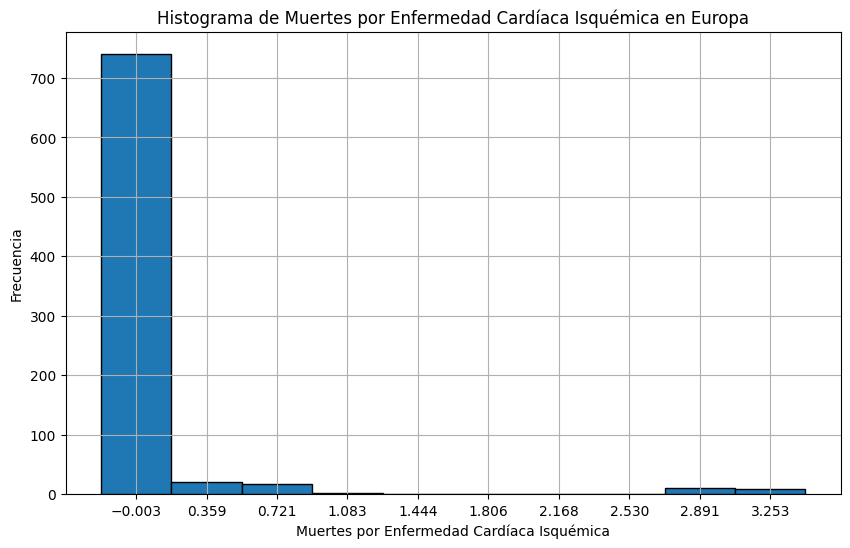

Marca de clase de muertes por enfermedades en Oceania


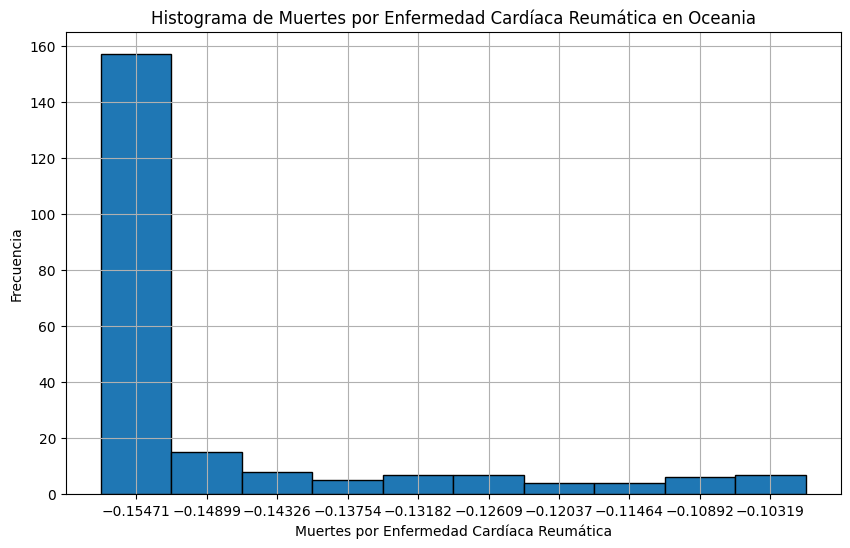

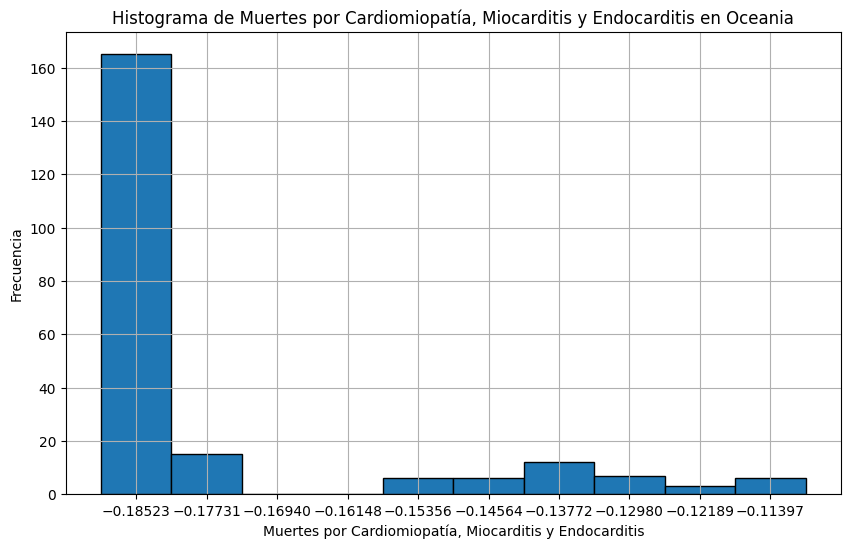

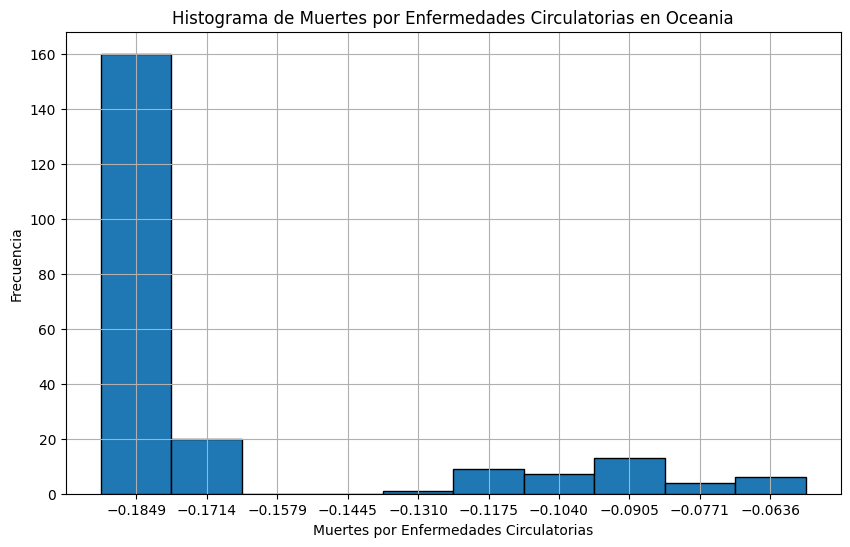

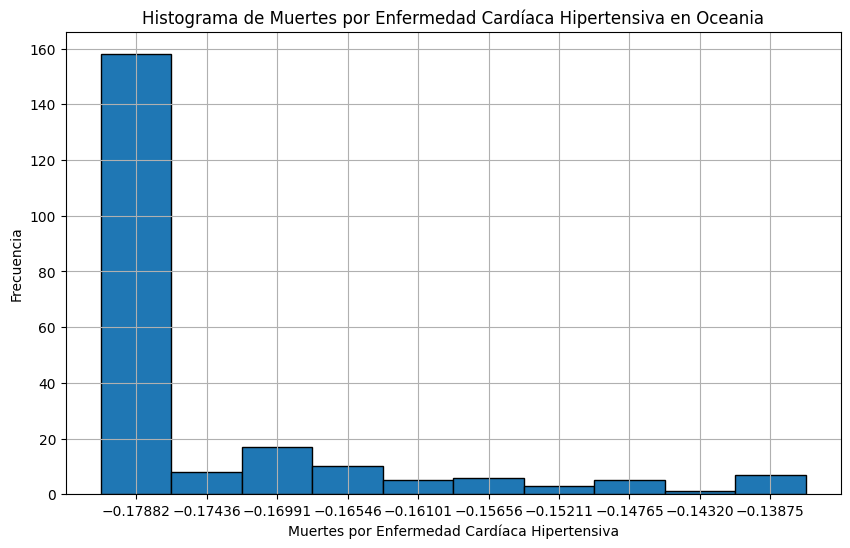

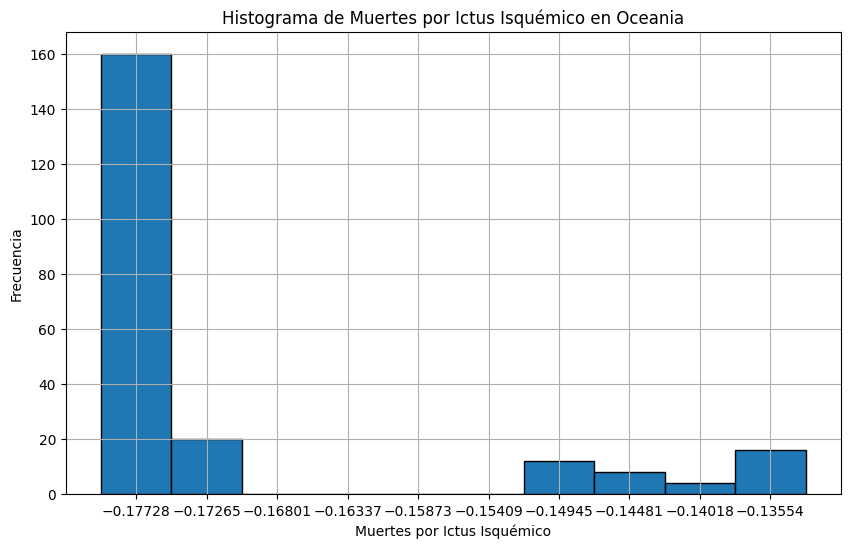

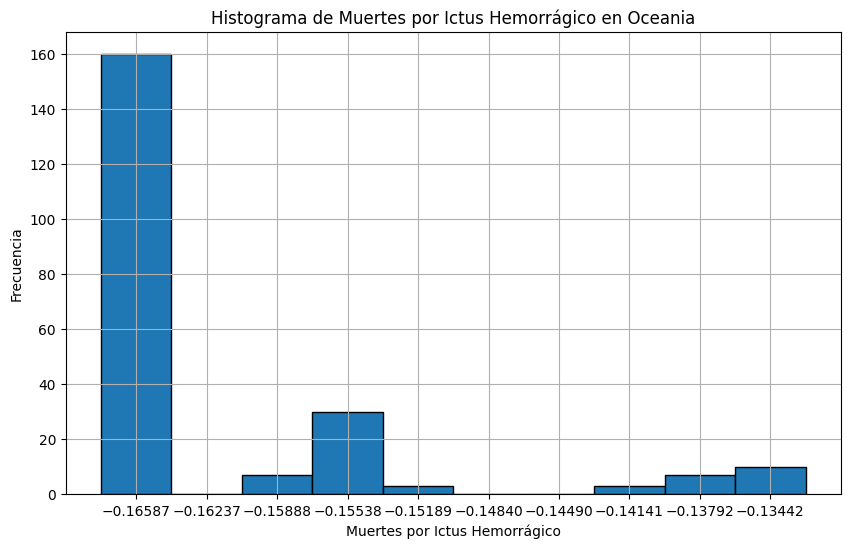

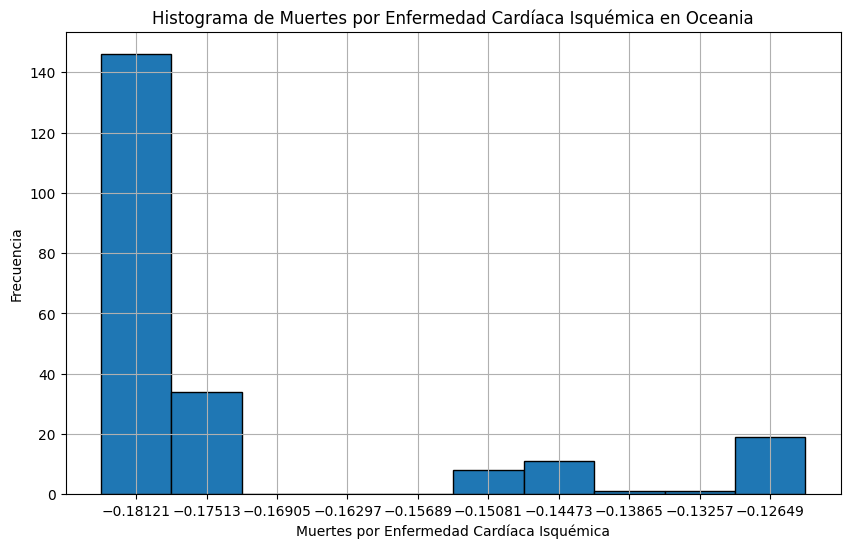

In [ ]:
for continente, paises in continentes.items():
    df_continente = df[df['Entity'].isin(paises)]

    for patologia in patologias:
        data_patologia = df_continente[patologia]
        rango = calcular_rango(data_patologia)
        num_bins = 10
        hist, bins = np.histogram(data_patologia, bins=num_bins)
        marcas_clase = [(bins[i] + bins[i + 1]) / 2 for i in range(len(bins) - 1)]

        patologia_legible = reemplazar_texto(patologia)

        plt.figure(figsize=(10, 6))
        plt.hist(data_patologia, bins=num_bins, edgecolor='black')
        plt.title(f'Histograma de {patologia_legible} en {continente}')
        plt.xlabel(patologia_legible)
        plt.ylabel('Frecuencia')
        plt.xticks(marcas_clase)
        plt.grid(True)
        plt.show()

# Frecuencias

### Frecuencia Absoluta

Frecuencia Absoluta de Muertes por Enfermedades Cardiovasculares en Africa
La Frecuencia Absoluta por Muertes por Enfermedad Cardíaca Reumática es:
 Deaths - Cause: Rheumatic heart disease - Sex: Both sexes - Age group: ALLAges
-0.157618    1
-0.157618    2
-0.157618    3
-0.157617    2
-0.157617    1
            ..
 0.473235    1
 0.481850    1
 0.491386    1
 0.501861    1
 0.511997    1
Name: count, Length: 1051, dtype: int64
----------------------------------------------------------------------------------


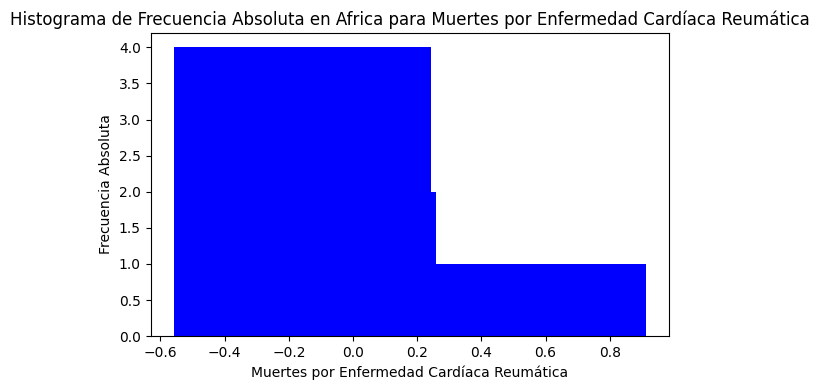

La Frecuencia Absoluta por Muertes por Cardiomiopatía, Miocarditis y Endocarditis es:
 Deaths - Cause: Cardiomyopathy, myocarditis, endocarditis - Sex: Both sexes - Age group: ALLAges
-0.189132    1
-0.189125    1
-0.189120    1
-0.189113    1
-0.189109    1
            ..
 1.191213    1
 1.218023    1
 1.239759    1
 1.262845    1
 1.280285    1
Name: count, Length: 1070, dtype: int64
----------------------------------------------------------------------------------


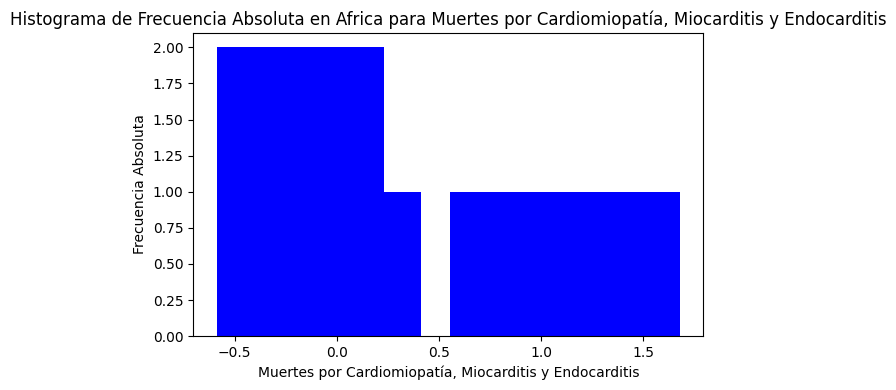

La Frecuencia Absoluta por Muertes por Enfermedades Circulatorias es:
 Deaths - Cause: Other circulatory diseases - Sex: Both sexes - Age group: ALLAges
-0.191609    1
-0.191607    1
-0.191603    1
-0.191597    1
-0.191595    1
            ..
 0.955555    1
 0.983218    1
 1.007231    1
 1.033750    1
 1.055372    1
Name: count, Length: 1077, dtype: int64
----------------------------------------------------------------------------------


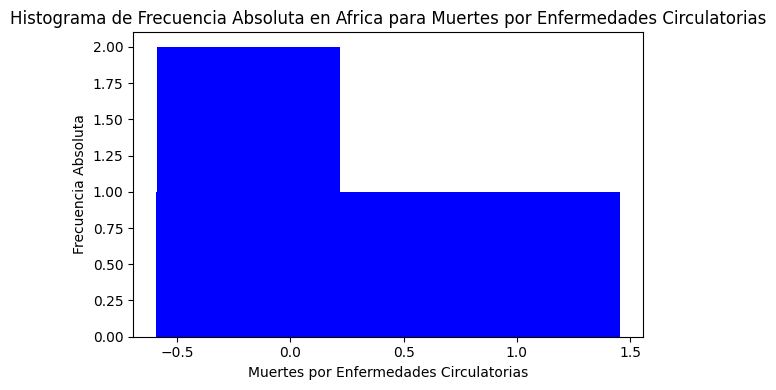

La Frecuencia Absoluta por Muertes por Enfermedad Cardíaca Hipertensiva es:
 Deaths - Cause: Hypertensive heart disease - Sex: Both sexes - Age group: ALLAges
-0.181047    1
-0.181045    1
-0.181041    1
-0.181040    1
-0.181038    1
            ..
 1.816504    1
 1.855520    1
 1.888209    1
 1.925931    1
 1.961878    1
Name: count, Length: 1074, dtype: int64
----------------------------------------------------------------------------------


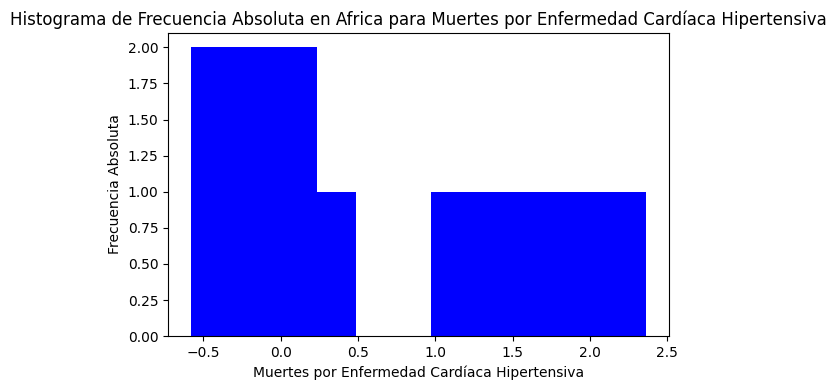

La Frecuencia Absoluta por Muertes por Ictus Isquémico es:
 Deaths - Cause: Ischaemic stroke - Sex: Both sexes - Age group: ALLAges
-0.179582    1
-0.179579    1
-0.179579    1
-0.179575    1
-0.179575    1
            ..
 0.662707    1
 0.685559    1
 0.705777    1
 0.727715    1
 0.745788    1
Name: count, Length: 1078, dtype: int64
----------------------------------------------------------------------------------


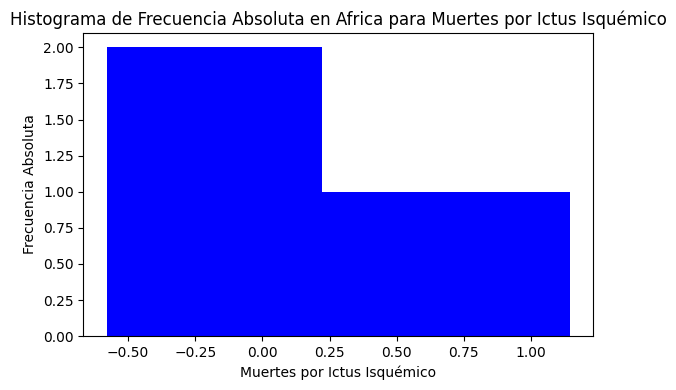

La Frecuencia Absoluta por Muertes por Ictus Hemorrágico es:
 Deaths - Cause: Haemorrhagic stroke - Sex: Both sexes - Age group: ALLAges
-0.167630    1
-0.167630    1
-0.167628    1
-0.167624    1
-0.167623    1
            ..
 0.900130    1
 0.911802    1
 0.917736    1
 0.928137    1
 0.940837    1
Name: count, Length: 1077, dtype: int64
----------------------------------------------------------------------------------


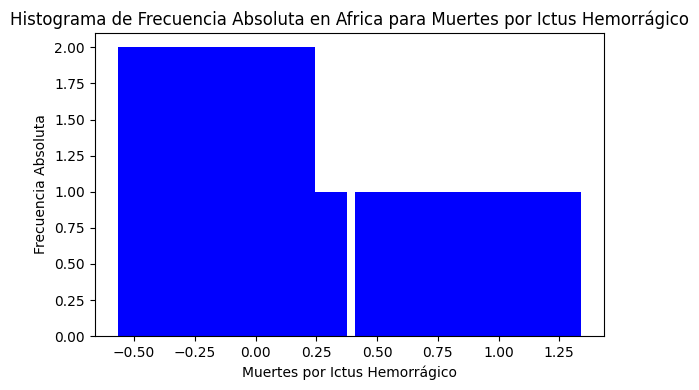

La Frecuencia Absoluta por Muertes por Enfermedad Cardíaca Isquémica es:
 Deaths - Cause: Ischaemic heart disease - Sex: Both sexes - Age group: ALLAges
-0.184269    1
-0.184268    1
-0.184266    1
-0.184262    1
-0.184260    1
            ..
 0.864614    1
 0.880814    1
 0.898801    1
 0.928629    1
 0.953044    1
Name: count, Length: 1080, dtype: int64
----------------------------------------------------------------------------------


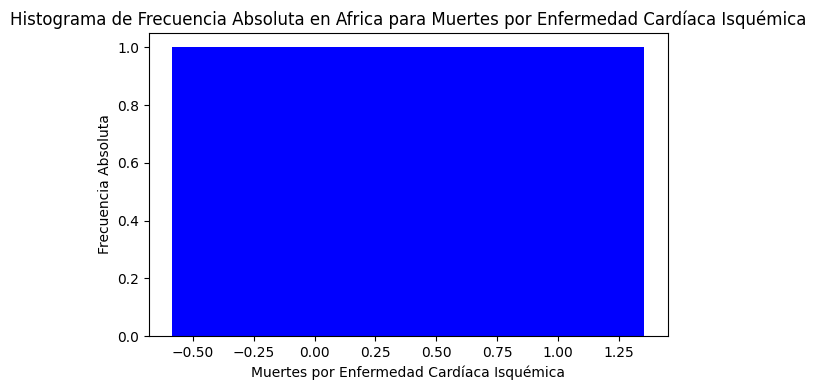

Frecuencia Absoluta de Muertes por Enfermedades Cardiovasculares en America del Norte
La Frecuencia Absoluta por Muertes por Enfermedad Cardíaca Reumática es:
 Deaths - Cause: Rheumatic heart disease - Sex: Both sexes - Age group: ALLAges
-0.157645    7
-0.157643    1
-0.157639    1
-0.157639    1
-0.157638    1
            ..
 0.052690    1
 0.052853    1
 0.056152    1
 0.059303    1
 0.061928    1
Name: count, Length: 407, dtype: int64
----------------------------------------------------------------------------------


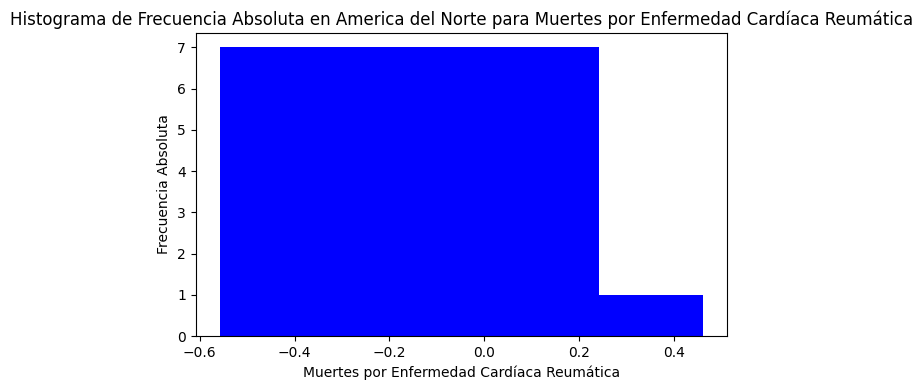

La Frecuencia Absoluta por Muertes por Cardiomiopatía, Miocarditis y Endocarditis es:
 Deaths - Cause: Cardiomyopathy, myocarditis, endocarditis - Sex: Both sexes - Age group: ALLAges
-0.189215    1
-0.189200    1
-0.189195    1
-0.189188    1
-0.189186    1
            ..
 1.196142    1
 1.206135    1
 1.210522    1
 1.219945    1
 1.230585    1
Name: count, Length: 438, dtype: int64
----------------------------------------------------------------------------------


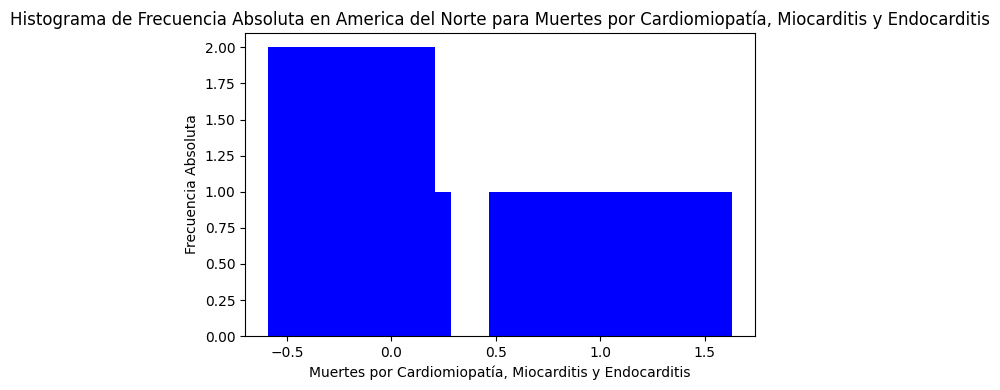

La Frecuencia Absoluta por Muertes por Enfermedades Circulatorias es:
 Deaths - Cause: Other circulatory diseases - Sex: Both sexes - Age group: ALLAges
-0.191514    1
-0.191512    1
-0.191509    1
-0.191476    1
-0.191469    1
            ..
 1.698056    1
 1.740157    1
 1.781318    1
 1.815275    1
 1.848576    1
Name: count, Length: 437, dtype: int64
----------------------------------------------------------------------------------


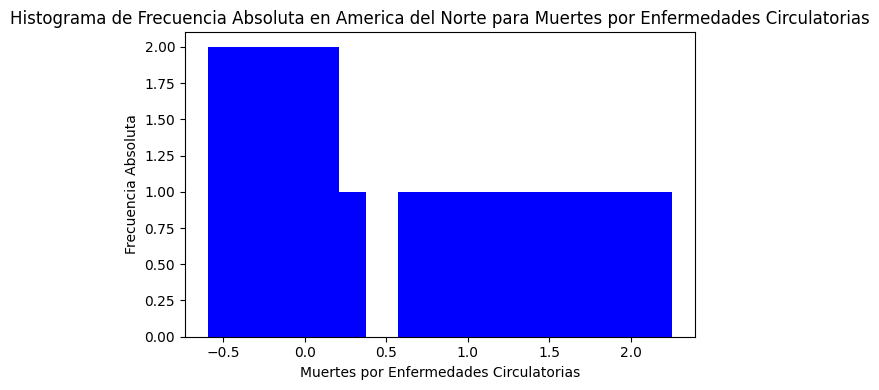

La Frecuencia Absoluta por Muertes por Enfermedad Cardíaca Hipertensiva es:
 Deaths - Cause: Hypertensive heart disease - Sex: Both sexes - Age group: ALLAges
-0.181103    1
-0.181085    1
-0.181070    1
-0.181039    1
-0.181020    1
            ..
 0.942232    1
 0.998787    1
 1.060447    1
 1.084381    1
 1.093678    1
Name: count, Length: 435, dtype: int64
----------------------------------------------------------------------------------


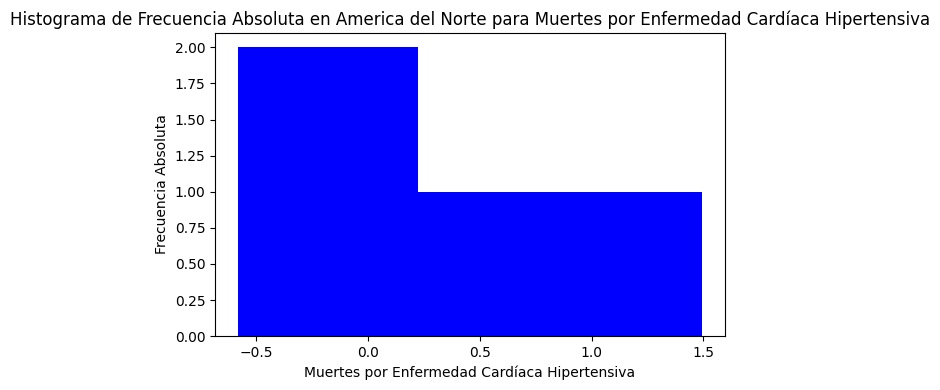

La Frecuencia Absoluta por Muertes por Ictus Isquémico es:
 Deaths - Cause: Ischaemic stroke - Sex: Both sexes - Age group: ALLAges
-0.179593    1
-0.179586    1
-0.179584    1
-0.179577    1
-0.179575    1
            ..
 0.422260    1
 0.429137    1
 0.433134    1
 0.433995    1
 0.445572    1
Name: count, Length: 438, dtype: int64
----------------------------------------------------------------------------------


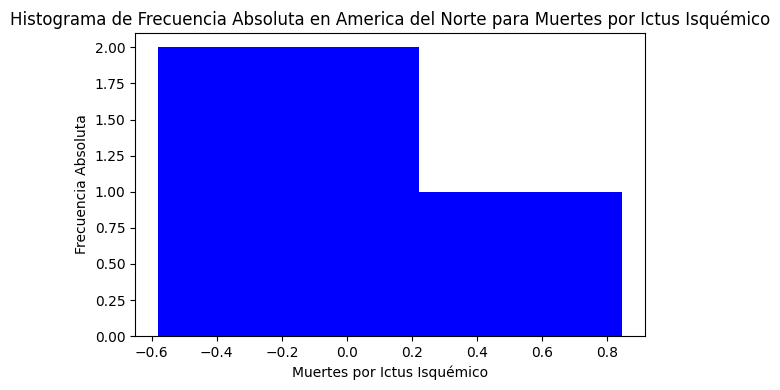

La Frecuencia Absoluta por Muertes por Ictus Hemorrágico es:
 Deaths - Cause: Haemorrhagic stroke - Sex: Both sexes - Age group: ALLAges
-0.167647    1
-0.167645    1
-0.167639    1
-0.167639    1
-0.167638    1
            ..
 0.214469    1
 0.219615    1
 0.228449    1
 0.233758    1
 0.240864    1
Name: count, Length: 435, dtype: int64
----------------------------------------------------------------------------------


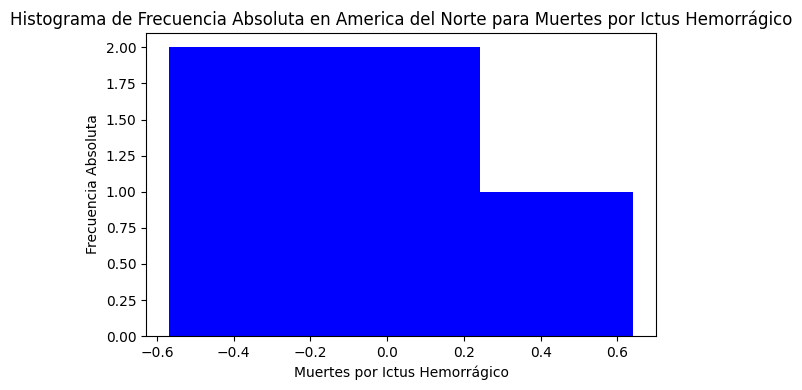

La Frecuencia Absoluta por Muertes por Enfermedad Cardíaca Isquémica es:
 Deaths - Cause: Ischaemic heart disease - Sex: Both sexes - Age group: ALLAges
-0.184284    1
-0.184278    1
-0.184265    1
-0.184262    1
-0.184249    1
            ..
 0.920929    1
 0.933471    1
 0.940097    1
 0.943414    1
 0.959658    1
Name: count, Length: 440, dtype: int64
----------------------------------------------------------------------------------


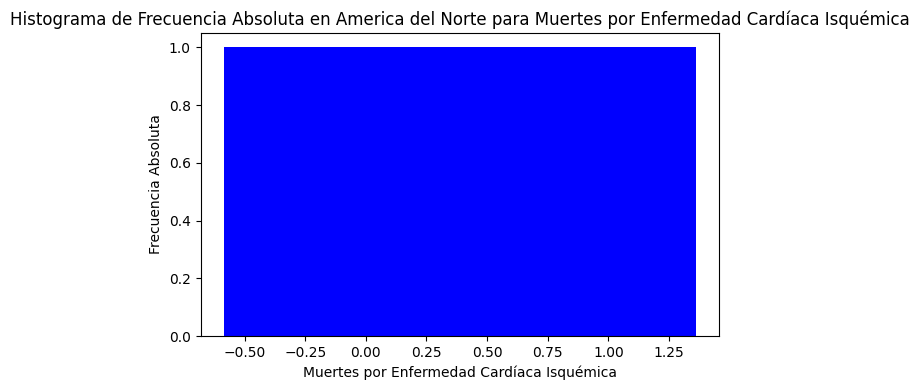

Frecuencia Absoluta de Muertes por Enfermedades Cardiovasculares en America del Sur
La Frecuencia Absoluta por Muertes por Enfermedad Cardíaca Reumática es:
 Deaths - Cause: Rheumatic heart disease - Sex: Both sexes - Age group: ALLAges
-0.157467    1
-0.157466    1
-0.157464    1
-0.157464    1
-0.157459    1
            ..
-0.032739    1
-0.030748    1
-0.030304    1
-0.030243    1
-0.023645    1
Name: count, Length: 259, dtype: int64
----------------------------------------------------------------------------------


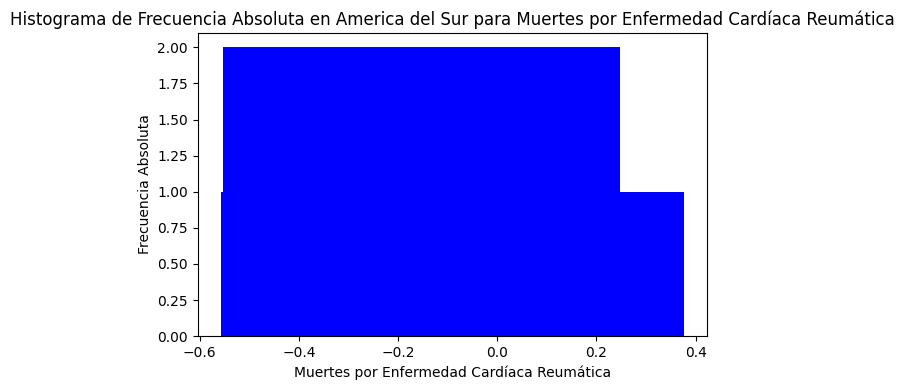

La Frecuencia Absoluta por Muertes por Cardiomiopatía, Miocarditis y Endocarditis es:
 Deaths - Cause: Cardiomyopathy, myocarditis, endocarditis - Sex: Both sexes - Age group: ALLAges
-0.188556    1
-0.188487    1
-0.188477    1
-0.188468    1
-0.188459    1
            ..
 0.744260    1
 0.757123    1
 0.757998    1
 0.771911    1
 0.797496    1
Name: count, Length: 260, dtype: int64
----------------------------------------------------------------------------------


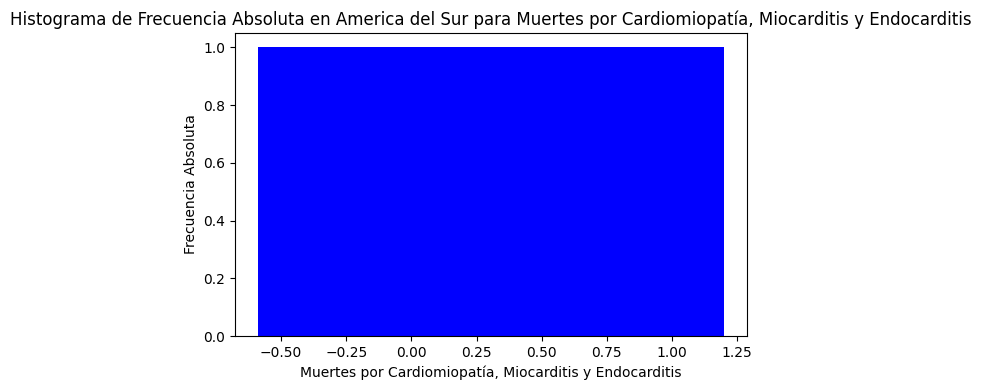

La Frecuencia Absoluta por Muertes por Enfermedades Circulatorias es:
 Deaths - Cause: Other circulatory diseases - Sex: Both sexes - Age group: ALLAges
-0.191156    1
-0.191105    1
-0.191084    1
-0.191078    1
-0.191074    1
            ..
 0.845592    1
 0.896090    1
 0.916339    1
 0.950265    1
 0.962460    1
Name: count, Length: 260, dtype: int64
----------------------------------------------------------------------------------


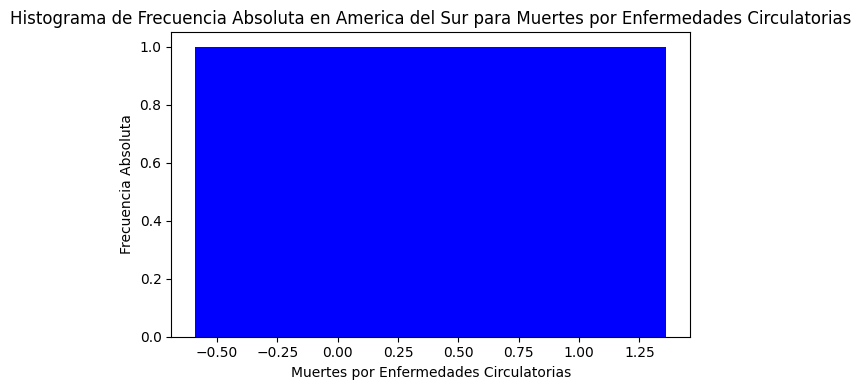

La Frecuencia Absoluta por Muertes por Enfermedad Cardíaca Hipertensiva es:
 Deaths - Cause: Hypertensive heart disease - Sex: Both sexes - Age group: ALLAges
-0.180206    1
-0.180152    1
-0.180124    1
-0.180115    1
-0.180115    1
            ..
 0.470730    1
 0.499434    1
 0.543956    1
 0.548519    1
 0.548844    1
Name: count, Length: 260, dtype: int64
----------------------------------------------------------------------------------


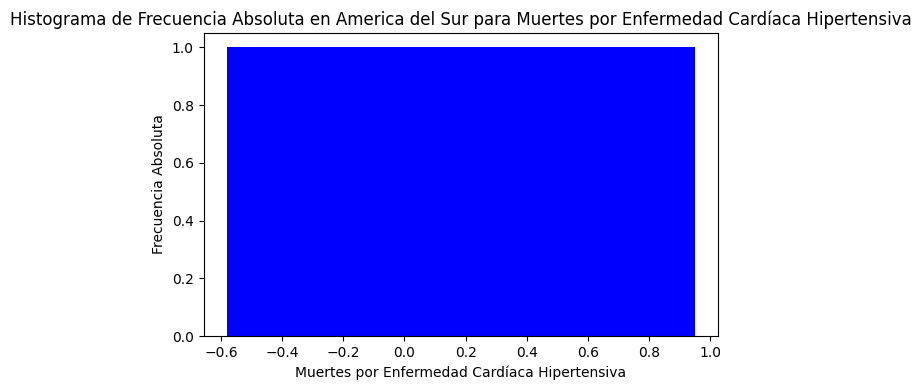

La Frecuencia Absoluta por Muertes por Ictus Isquémico es:
 Deaths - Cause: Ischaemic stroke - Sex: Both sexes - Age group: ALLAges
-0.179007    1
-0.178948    1
-0.178941    1
-0.178940    1
-0.178930    1
            ..
 0.283729    1
 0.287759    1
 0.293025    1
 0.293912    1
 0.306054    1
Name: count, Length: 260, dtype: int64
----------------------------------------------------------------------------------


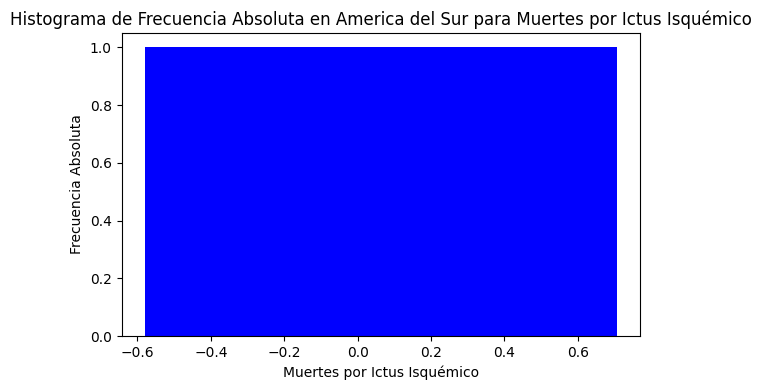

La Frecuencia Absoluta por Muertes por Ictus Hemorrágico es:
 Deaths - Cause: Haemorrhagic stroke - Sex: Both sexes - Age group: ALLAges
-0.166870    1
-0.166860    1
-0.166853    1
-0.166845    1
-0.166832    1
            ..
 0.156756    1
 0.160623    1
 0.160782    1
 0.163484    1
 0.163577    1
Name: count, Length: 260, dtype: int64
----------------------------------------------------------------------------------


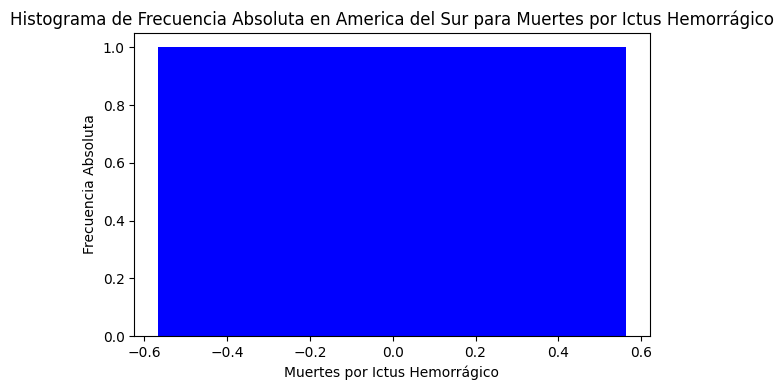

La Frecuencia Absoluta por Muertes por Enfermedad Cardíaca Isquémica es:
 Deaths - Cause: Ischaemic heart disease - Sex: Both sexes - Age group: ALLAges
-0.183788    1
-0.183761    1
-0.183761    1
-0.183760    1
-0.183759    1
            ..
 0.293382    1
 0.309018    1
 0.313121    1
 0.315098    1
 0.325397    1
Name: count, Length: 260, dtype: int64
----------------------------------------------------------------------------------


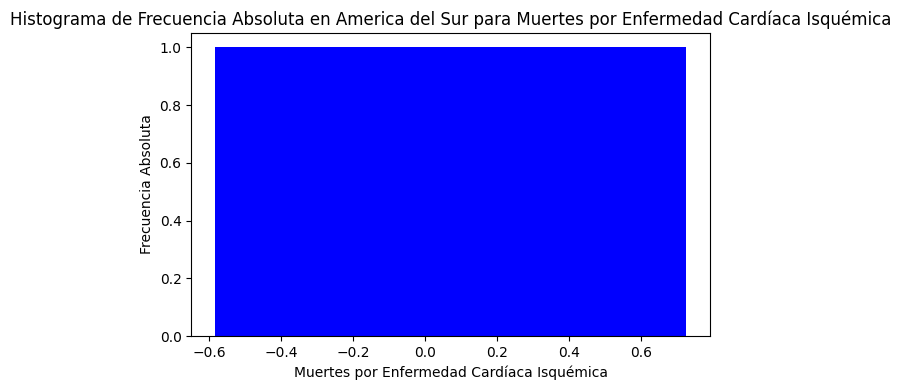

Frecuencia Absoluta de Muertes por Enfermedades Cardiovasculares en Asia
La Frecuencia Absoluta por Muertes por Enfermedad Cardíaca Reumática es:
 Deaths - Cause: Rheumatic heart disease - Sex: Both sexes - Age group: ALLAges
-0.157568    1
-0.157545    1
-0.157542    1
-0.157541    1
-0.157540    1
            ..
 8.487723    1
 8.684022    1
 8.823340    1
 8.892646    1
 8.954622    1
Name: count, Length: 929, dtype: int64
----------------------------------------------------------------------------------


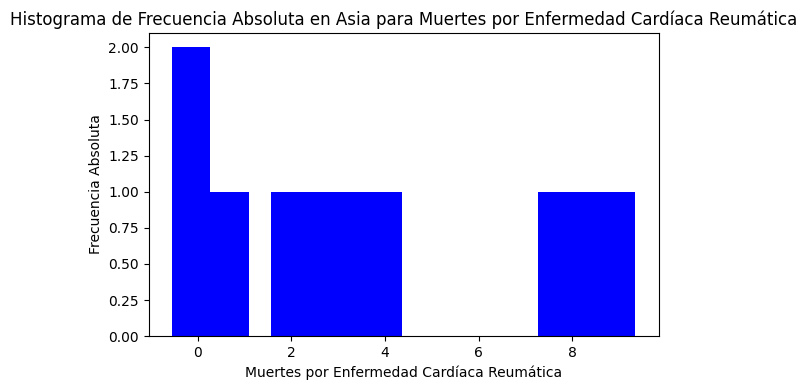

La Frecuencia Absoluta por Muertes por Cardiomiopatía, Miocarditis y Endocarditis es:
 Deaths - Cause: Cardiomyopathy, myocarditis, endocarditis - Sex: Both sexes - Age group: ALLAges
-0.189137    1
-0.189134    1
-0.189131    1
-0.189127    1
-0.189125    1
            ..
 3.033451    1
 3.102452    1
 3.155250    1
 3.208084    1
 3.257754    1
Name: count, Length: 936, dtype: int64
----------------------------------------------------------------------------------


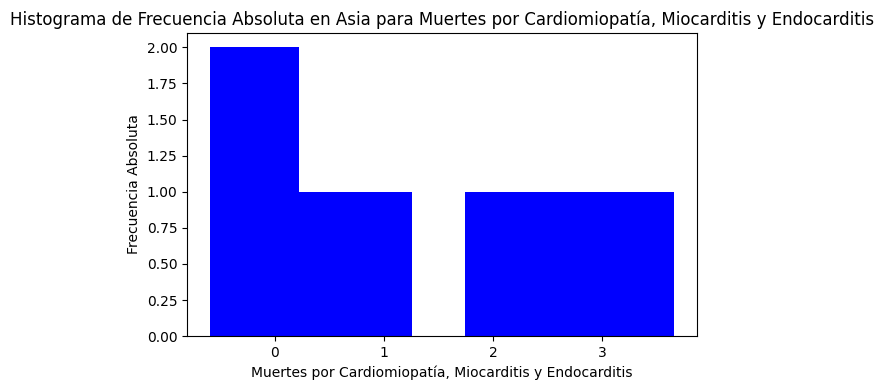

La Frecuencia Absoluta por Muertes por Enfermedades Circulatorias es:
 Deaths - Cause: Other circulatory diseases - Sex: Both sexes - Age group: ALLAges
-0.191510    1
-0.191505    1
-0.191503    1
-0.191482    1
-0.191477    1
            ..
 4.560314    1
 4.801751    1
 5.037440    1
 5.197655    1
 5.315324    1
Name: count, Length: 938, dtype: int64
----------------------------------------------------------------------------------


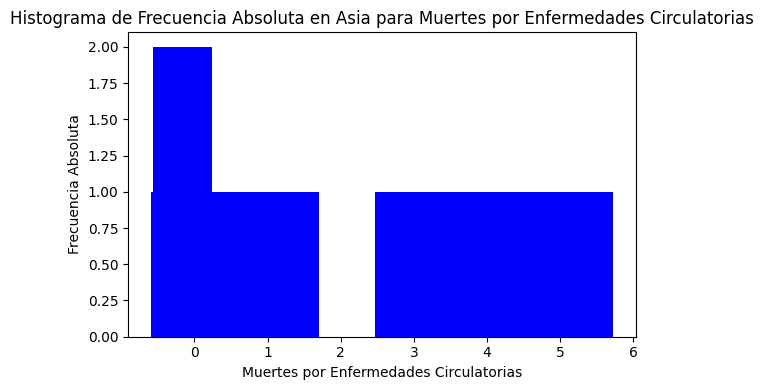

La Frecuencia Absoluta por Muertes por Enfermedad Cardíaca Hipertensiva es:
 Deaths - Cause: Hypertensive heart disease - Sex: Both sexes - Age group: ALLAges
-0.180983    1
-0.180981    1
-0.180977    1
-0.180970    1
-0.180969    1
            ..
 7.392716    1
 7.713370    1
 7.938586    1
 8.059726    1
 8.170555    1
Name: count, Length: 938, dtype: int64
----------------------------------------------------------------------------------


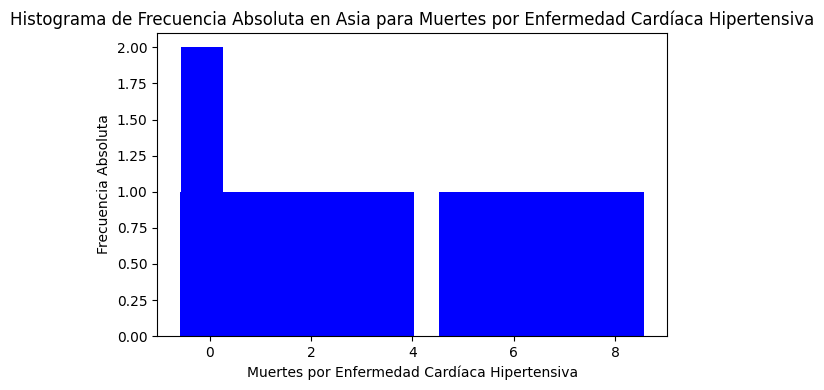

La Frecuencia Absoluta por Muertes por Ictus Isquémico es:
 Deaths - Cause: Ischaemic stroke - Sex: Both sexes - Age group: ALLAges
-0.179511    1
-0.179506    1
-0.179499    1
-0.179486    1
-0.179484    1
            ..
 6.843052    1
 7.116991    1
 7.378511    1
 7.591217    1
 7.793966    1
Name: count, Length: 939, dtype: int64
----------------------------------------------------------------------------------


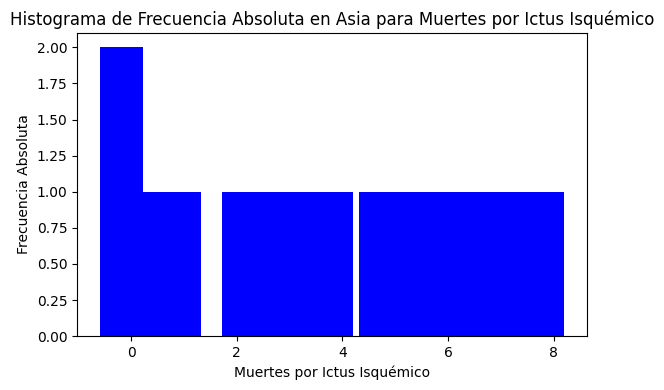

La Frecuencia Absoluta por Muertes por Ictus Hemorrágico es:
 Deaths - Cause: Haemorrhagic stroke - Sex: Both sexes - Age group: ALLAges
-0.167532    1
-0.167528    1
-0.167526    1
-0.167525    1
-0.167519    1
            ..
 7.740420    1
 7.749859    1
 7.763825    1
 7.795195    1
 7.911506    1
Name: count, Length: 939, dtype: int64
----------------------------------------------------------------------------------


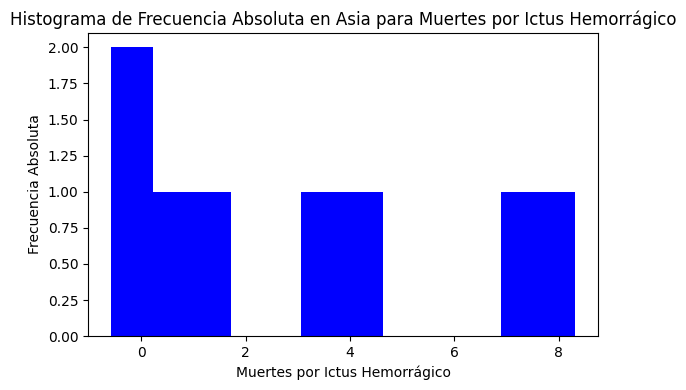

La Frecuencia Absoluta por Muertes por Enfermedad Cardíaca Isquémica es:
 Deaths - Cause: Ischaemic heart disease - Sex: Both sexes - Age group: ALLAges
-0.184105    1
-0.184087    1
-0.184060    1
-0.184059    1
-0.184058    1
            ..
 6.706150    1
 6.932718    1
 7.135996    1
 7.335131    1
 7.490590    1
Name: count, Length: 940, dtype: int64
----------------------------------------------------------------------------------


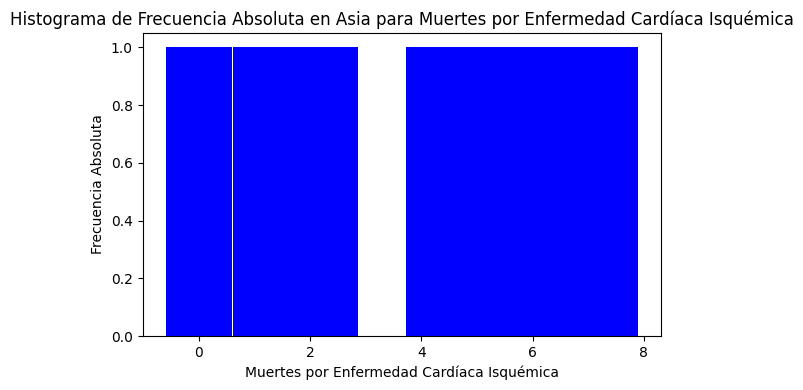

Frecuencia Absoluta de Muertes por Enfermedades Cardiovasculares en Europa
La Frecuencia Absoluta por Muertes por Enfermedad Cardíaca Reumática es:
 Deaths - Cause: Rheumatic heart disease - Sex: Both sexes - Age group: ALLAges
-0.157634    1
-0.157624    1
-0.157623    1
-0.157622    1
-0.157612    1
            ..
 0.599143    1
 0.646851    1
 0.652860    1
 0.663865    1
 0.714865    1
Name: count, Length: 783, dtype: int64
----------------------------------------------------------------------------------


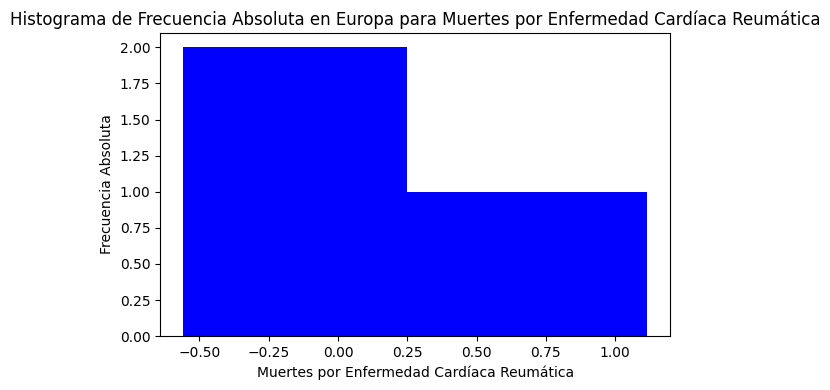

La Frecuencia Absoluta por Muertes por Cardiomiopatía, Miocarditis y Endocarditis es:
 Deaths - Cause: Cardiomyopathy, myocarditis, endocarditis - Sex: Both sexes - Age group: ALLAges
-0.189041    1
-0.189019    1
-0.189016    1
-0.189005    1
-0.189002    1
            ..
 5.665388    1
 5.836135    1
 5.845965    1
 5.853409    1
 5.991205    1
Name: count, Length: 799, dtype: int64
----------------------------------------------------------------------------------


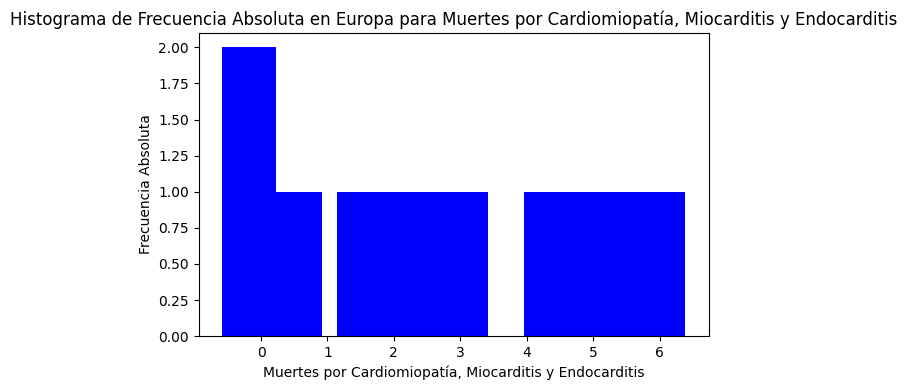

La Frecuencia Absoluta por Muertes por Enfermedades Circulatorias es:
 Deaths - Cause: Other circulatory diseases - Sex: Both sexes - Age group: ALLAges
-0.190947    1
-0.190920    1
-0.190900    1
-0.190834    1
-0.190727    1
            ..
 4.232024    1
 4.388285    1
 4.441143    1
 4.533261    1
 4.539361    1
Name: count, Length: 797, dtype: int64
----------------------------------------------------------------------------------


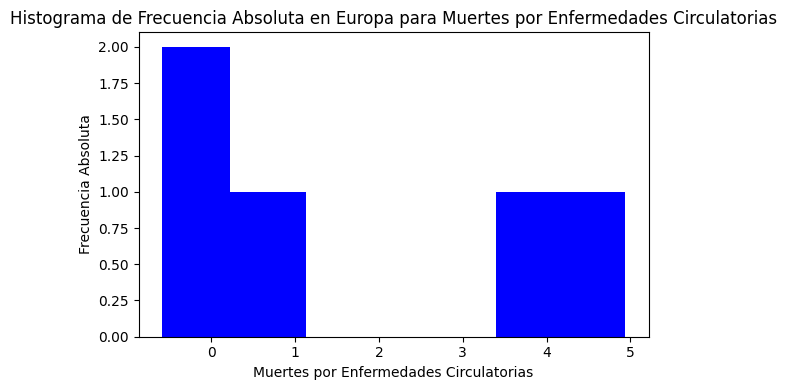

La Frecuencia Absoluta por Muertes por Enfermedad Cardíaca Hipertensiva es:
 Deaths - Cause: Hypertensive heart disease - Sex: Both sexes - Age group: ALLAges
-0.180945    1
-0.180935    1
-0.180932    1
-0.180920    1
-0.180912    1
            ..
 1.858711    1
 1.958052    1
 1.977970    1
 2.045636    1
 2.060574    1
Name: count, Length: 799, dtype: int64
----------------------------------------------------------------------------------


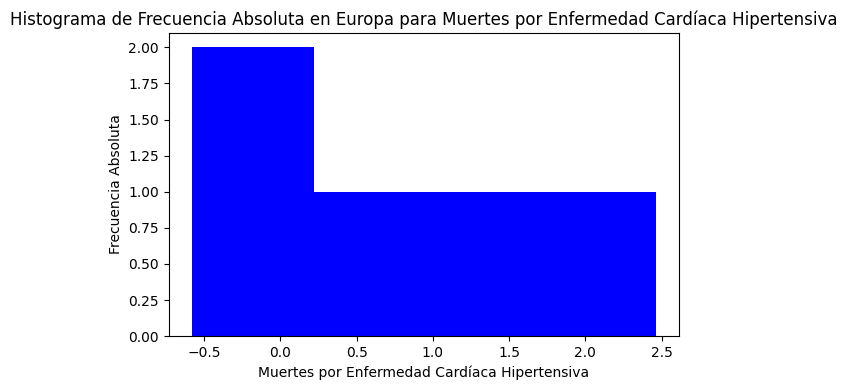

La Frecuencia Absoluta por Muertes por Ictus Isquémico es:
 Deaths - Cause: Ischaemic stroke - Sex: Both sexes - Age group: ALLAges
-0.179292    1
-0.179284    1
-0.179279    1
-0.179278    1
-0.179276    1
            ..
 3.458548    1
 3.603682    1
 3.619952    1
 3.679093    1
 3.729906    1
Name: count, Length: 799, dtype: int64
----------------------------------------------------------------------------------


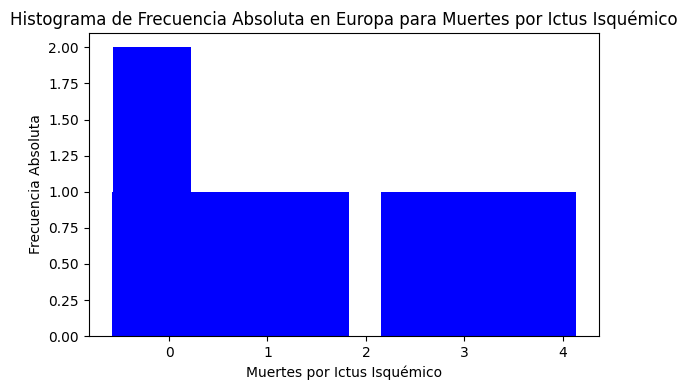

La Frecuencia Absoluta por Muertes por Ictus Hemorrágico es:
 Deaths - Cause: Haemorrhagic stroke - Sex: Both sexes - Age group: ALLAges
-0.167562    1
-0.167559    1
-0.167559    1
-0.167554    1
-0.167552    1
            ..
 1.031820    1
 1.066427    1
 1.068638    1
 1.088859    1
 1.097636    1
Name: count, Length: 800, dtype: int64
----------------------------------------------------------------------------------


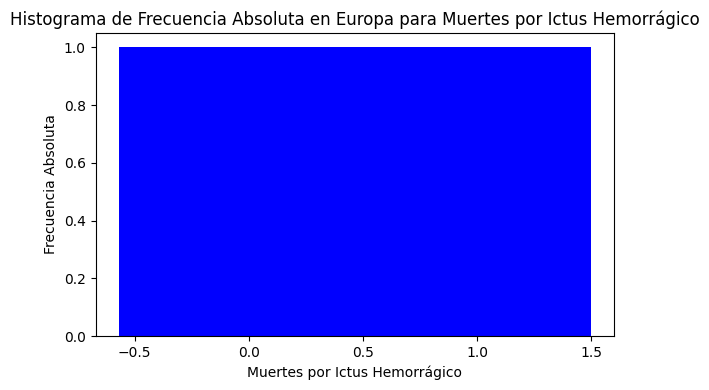

La Frecuencia Absoluta por Muertes por Enfermedad Cardíaca Isquémica es:
 Deaths - Cause: Ischaemic heart disease - Sex: Both sexes - Age group: ALLAges
-0.183759    1
-0.183758    1
-0.183742    1
-0.183738    1
-0.183729    1
            ..
 3.259792    1
 3.267359    1
 3.284078    1
 3.360220    1
 3.434178    1
Name: count, Length: 800, dtype: int64
----------------------------------------------------------------------------------


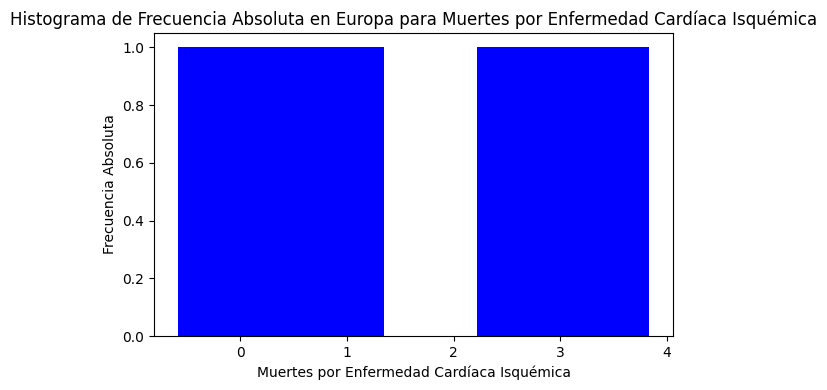

Frecuencia Absoluta de Muertes por Enfermedades Cardiovasculares en Oceania
La Frecuencia Absoluta por Muertes por Enfermedad Cardíaca Reumática es:
 Deaths - Cause: Rheumatic heart disease - Sex: Both sexes - Age group: ALLAges
-0.157576    1
-0.157573    1
-0.157570    1
-0.157570    1
-0.157565    1
            ..
-0.101739    1
-0.101411    1
-0.101060    1
-0.100431    1
-0.100331    1
Name: count, Length: 214, dtype: int64
----------------------------------------------------------------------------------


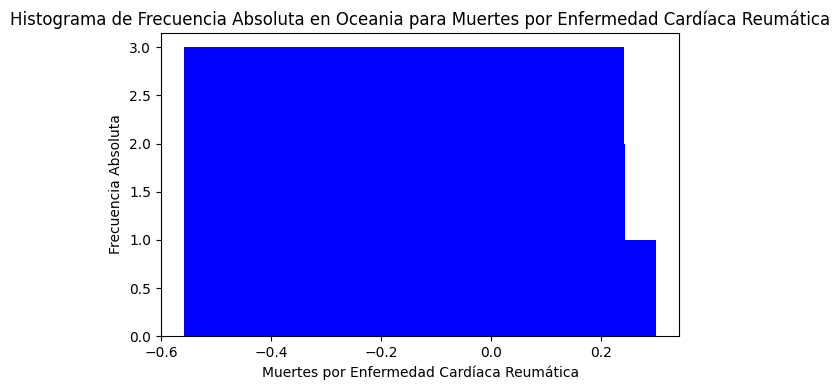

La Frecuencia Absoluta por Muertes por Cardiomiopatía, Miocarditis y Endocarditis es:
 Deaths - Cause: Cardiomyopathy, myocarditis, endocarditis - Sex: Both sexes - Age group: ALLAges
-0.189191    1
-0.189189    1
-0.189188    2
-0.189186    1
-0.189185    1
            ..
-0.113579    1
-0.111789    1
-0.111524    1
-0.110023    1
-0.110008    1
Name: count, Length: 212, dtype: int64
----------------------------------------------------------------------------------


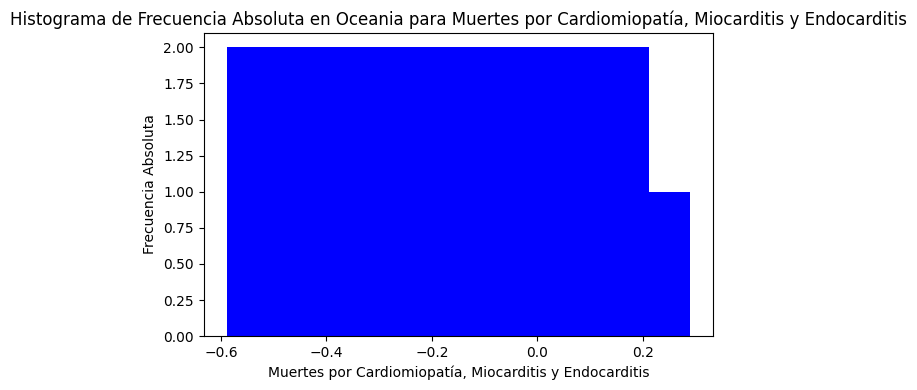

La Frecuencia Absoluta por Muertes por Enfermedades Circulatorias es:
 Deaths - Cause: Other circulatory diseases - Sex: Both sexes - Age group: ALLAges
-0.191628    2
-0.191626    1
-0.191625    1
-0.191624    1
-0.191622    1
            ..
-0.061009    1
-0.058516    1
-0.057676    1
-0.056901    1
-0.056837    1
Name: count, Length: 216, dtype: int64
----------------------------------------------------------------------------------


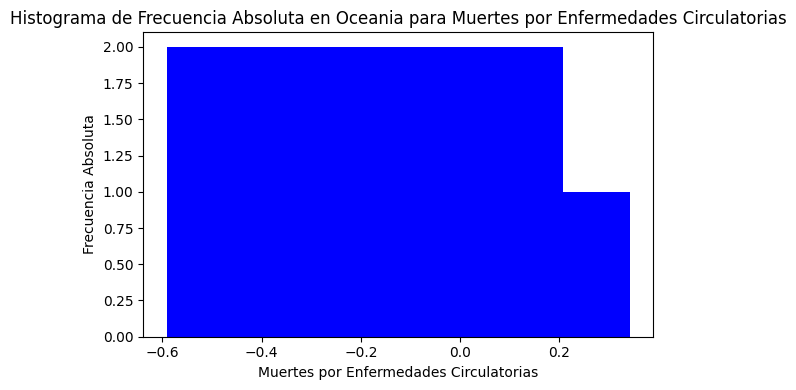

La Frecuencia Absoluta por Muertes por Enfermedad Cardíaca Hipertensiva es:
 Deaths - Cause: Hypertensive heart disease - Sex: Both sexes - Age group: ALLAges
-0.181041    1
-0.181041    1
-0.181039    2
-0.181039    1
-0.181039    1
            ..
-0.138750    1
-0.138346    1
-0.137691    1
-0.137360    1
-0.136525    1
Name: count, Length: 216, dtype: int64
----------------------------------------------------------------------------------


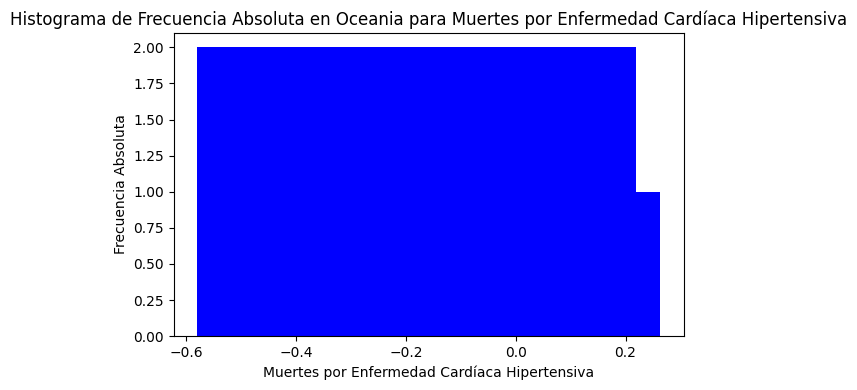

La Frecuencia Absoluta por Muertes por Ictus Isquémico es:
 Deaths - Cause: Ischaemic stroke - Sex: Both sexes - Age group: ALLAges
-0.179604    1
-0.179604    1
-0.179602    1
-0.179601    1
-0.179601    2
            ..
-0.134258    1
-0.134179    1
-0.134035    1
-0.134016    1
-0.133218    1
Name: count, Length: 218, dtype: int64
----------------------------------------------------------------------------------


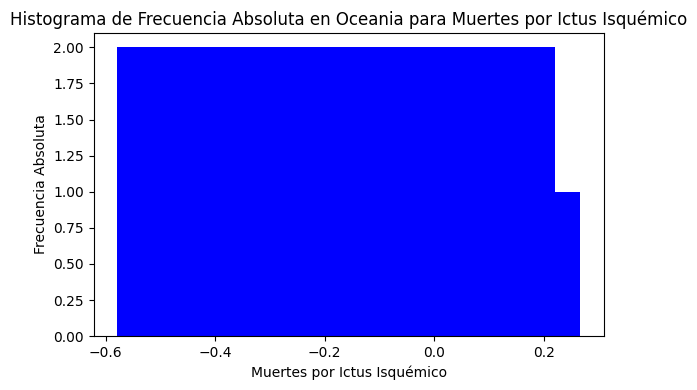

La Frecuencia Absoluta por Muertes por Ictus Hemorrágico es:
 Deaths - Cause: Haemorrhagic stroke - Sex: Both sexes - Age group: ALLAges
-0.167612    1
-0.167610    1
-0.167608    1
-0.167607    1
-0.167607    1
            ..
-0.133616    1
-0.133329    1
-0.133314    1
-0.133127    1
-0.132676    1
Name: count, Length: 219, dtype: int64
----------------------------------------------------------------------------------


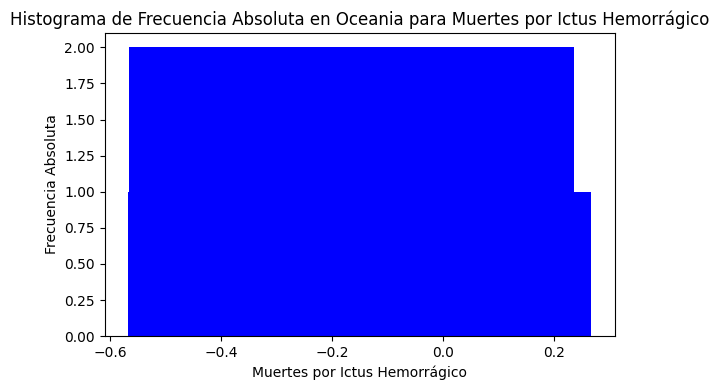

La Frecuencia Absoluta por Muertes por Enfermedad Cardíaca Isquémica es:
 Deaths - Cause: Ischaemic heart disease - Sex: Both sexes - Age group: ALLAges
-0.184249    1
-0.184247    1
-0.184245    1
-0.184244    1
-0.184243    1
            ..
-0.124665    1
-0.124218    1
-0.123945    1
-0.123669    1
-0.123455    1
Name: count, Length: 220, dtype: int64
----------------------------------------------------------------------------------


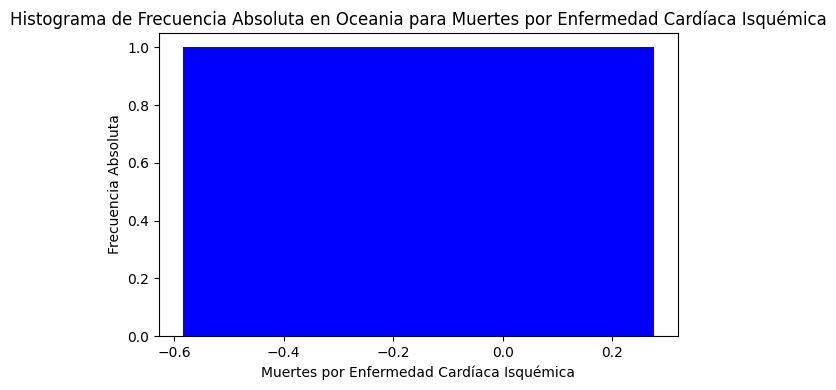

In [ ]:
def calcular_frecuencia_absoluta(df, patologia):
  data_patologia = df[patologia]
  return data_patologia.value_counts().sort_index()

for continente, paises in continentes.items():
  df_continente = df[df['Entity'].isin(paises)]
  print(f"Frecuencia Absoluta de Muertes por Enfermedades Cardiovasculares en {continente}")

  for patologia in patologias:
    Fabs = calcular_frecuencia_absoluta(df_continente, patologia)
    patologia_legible = reemplazar_texto(patologia)
    print(f"La Frecuencia Absoluta por {patologia_legible} es:\n {Fabs}")
    print("----------------------------------------------------------------------------------")

    plt.figure(figsize=(6, 4))
    bar_width = 1
    plt.bar(Fabs.index, Fabs.values, color='blue', alpha=1)
    plt.xlabel(f'{patologia_legible}')
    plt.ylabel('Frecuencia Absoluta')
    plt.title(f'Histograma de Frecuencia Absoluta en {continente} para {patologia_legible}')
    plt.xticks(rotation=0)
    plt.tight_layout()
    plt.show()

### Frecuencias Relativas

Frecuencias Relativa de muertes por Enfermedades Cardiovasculares en Africa:


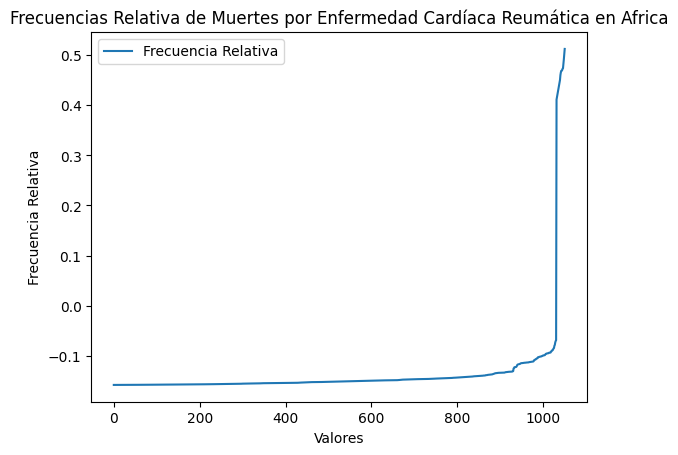

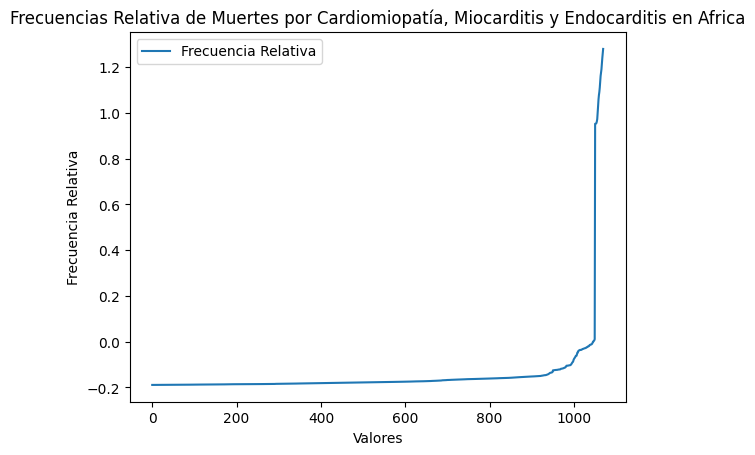

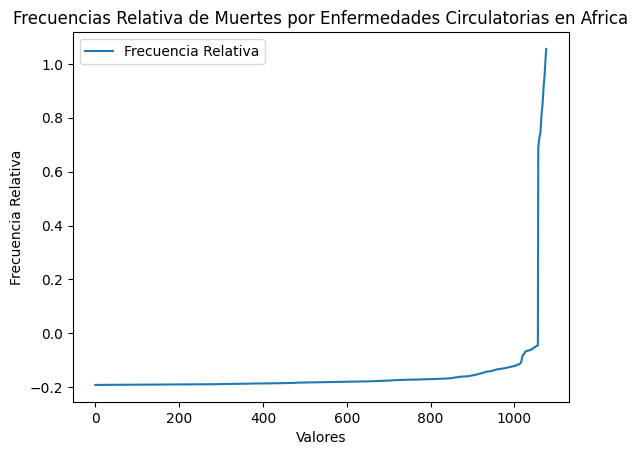

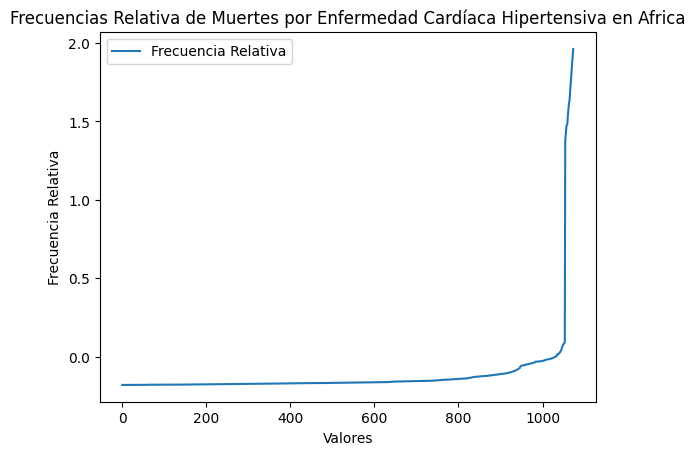

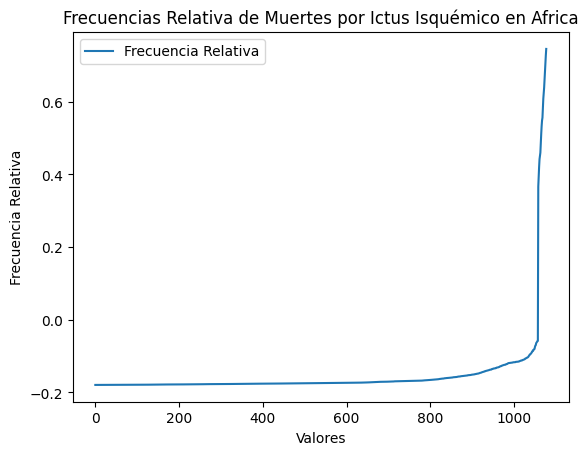

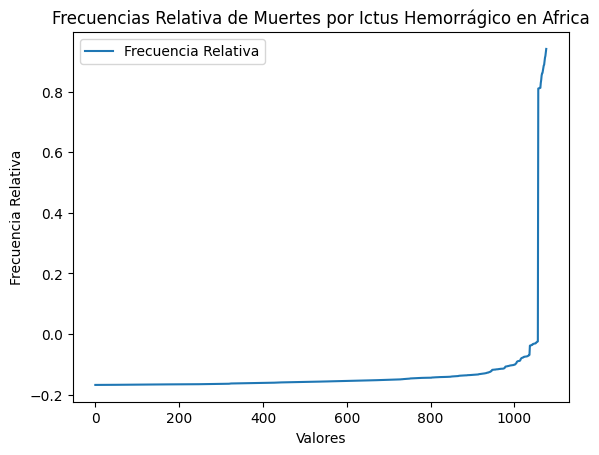

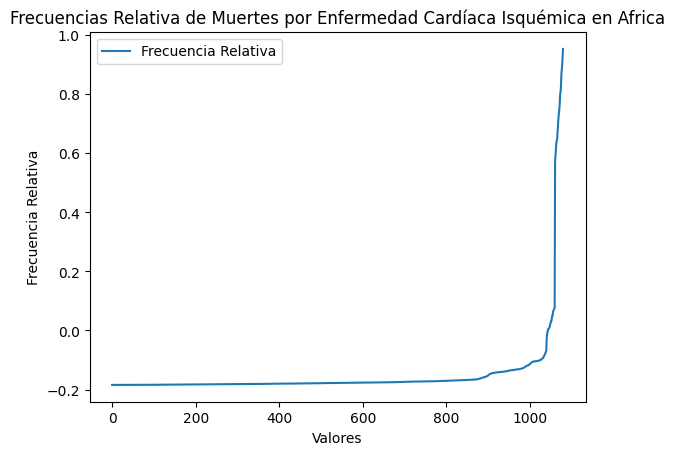

----------------------------------------------------------------------------------
Frecuencias Relativa de muertes por Enfermedades Cardiovasculares en America del Norte:


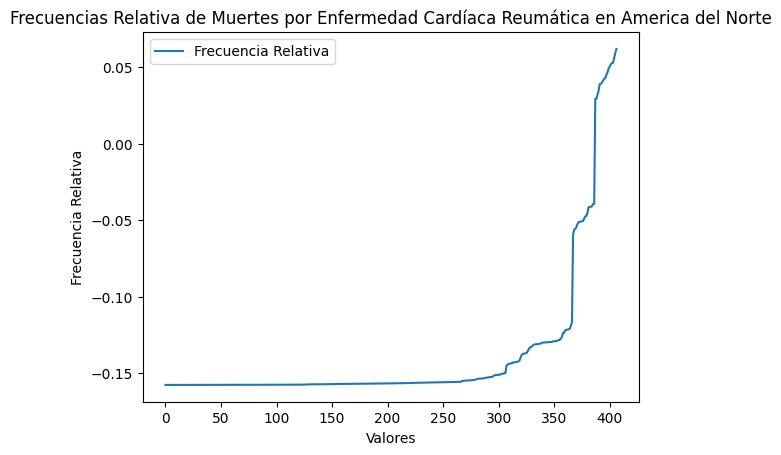

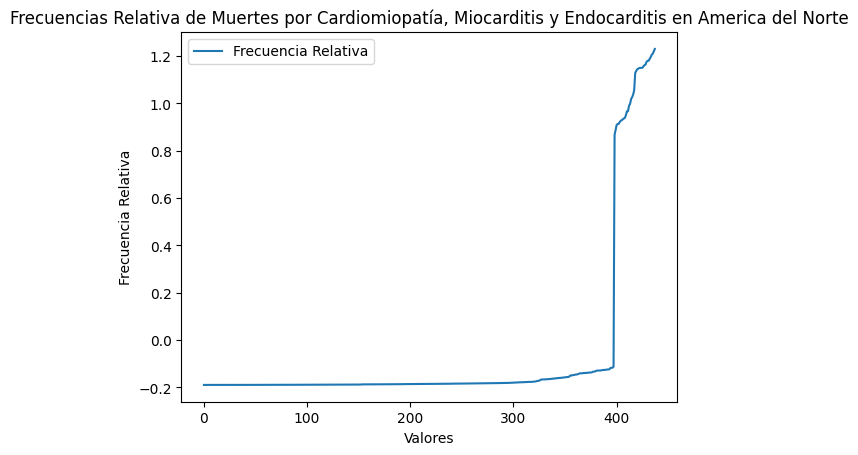

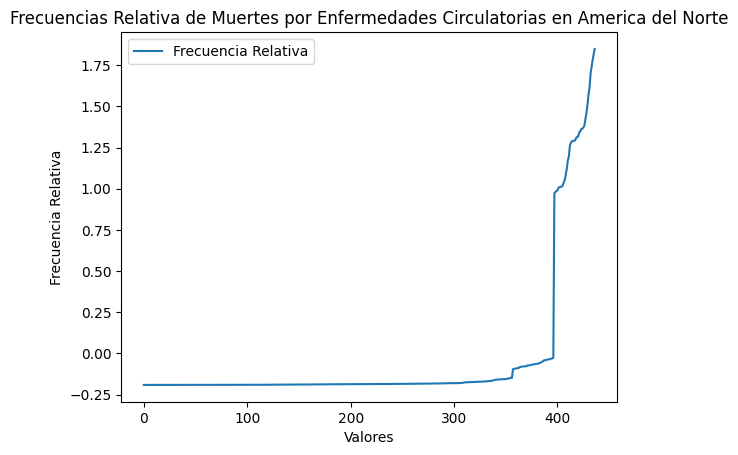

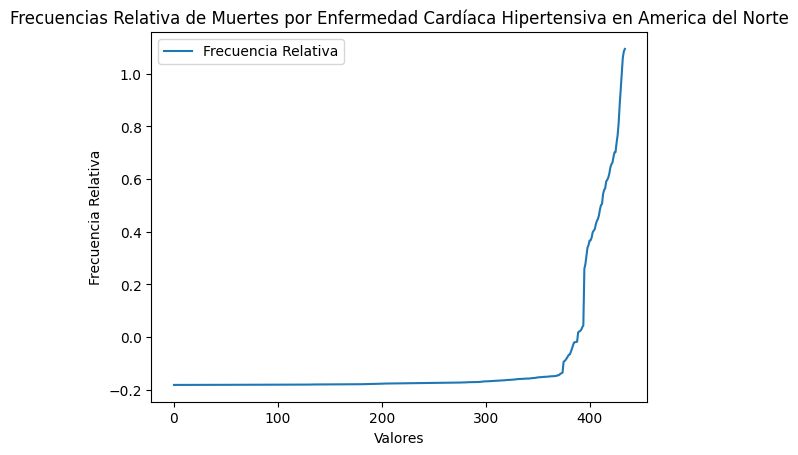

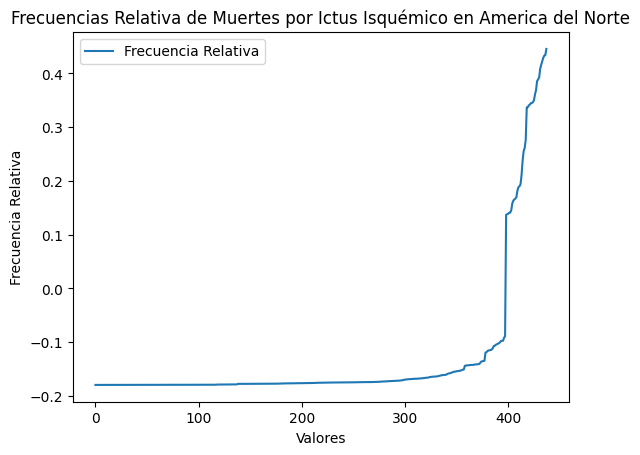

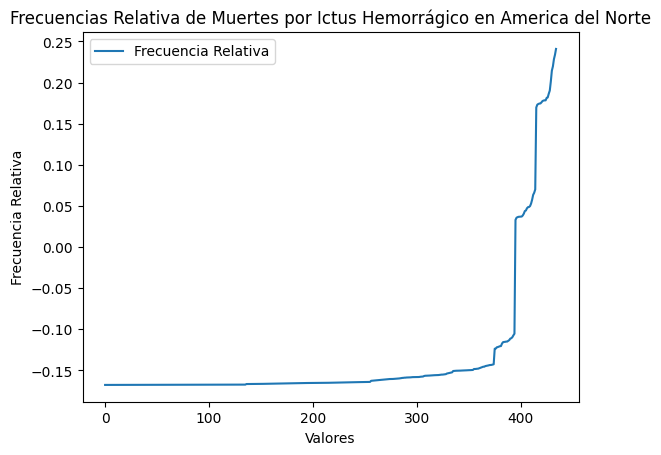

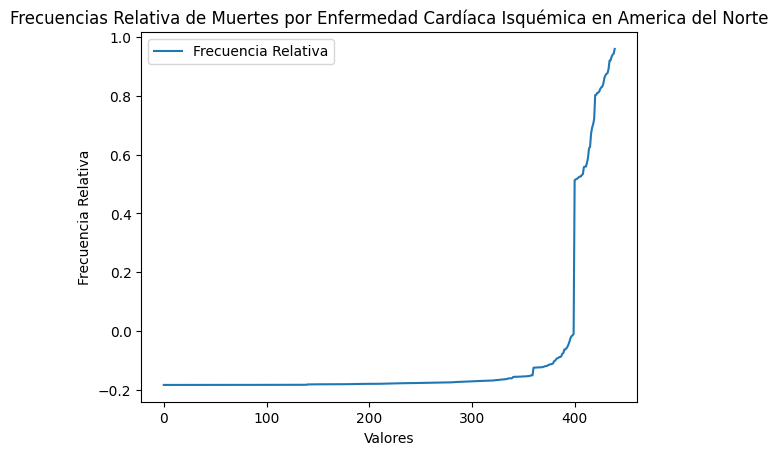

----------------------------------------------------------------------------------
Frecuencias Relativa de muertes por Enfermedades Cardiovasculares en America del Sur:


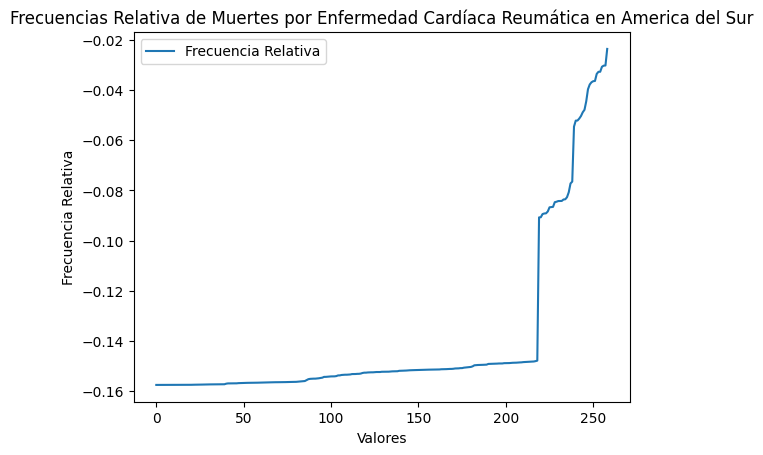

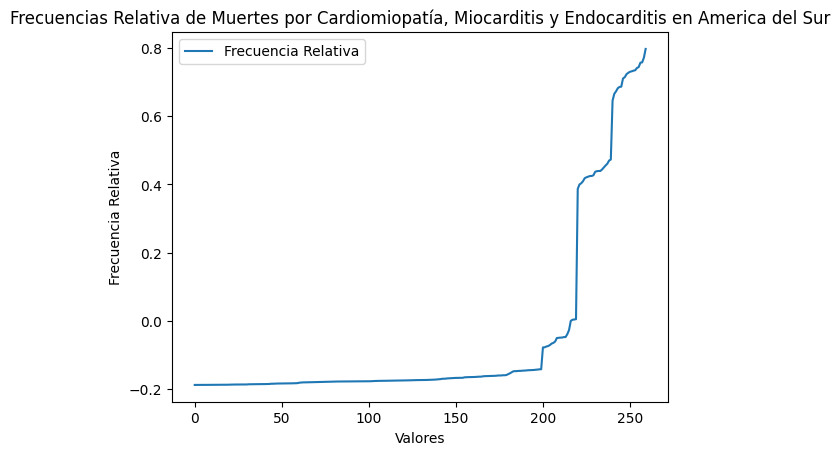

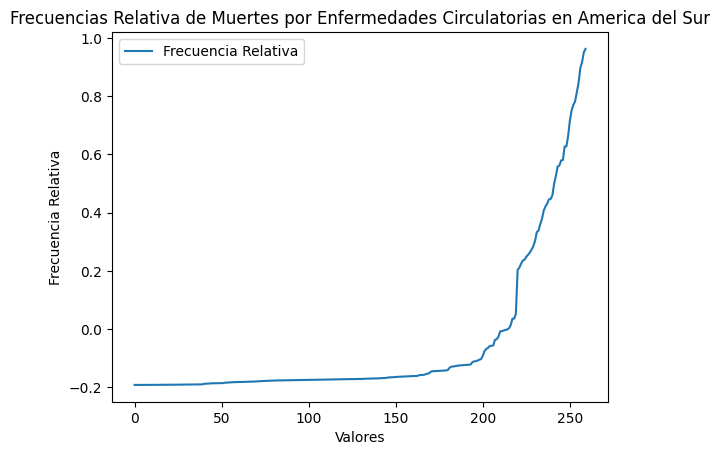

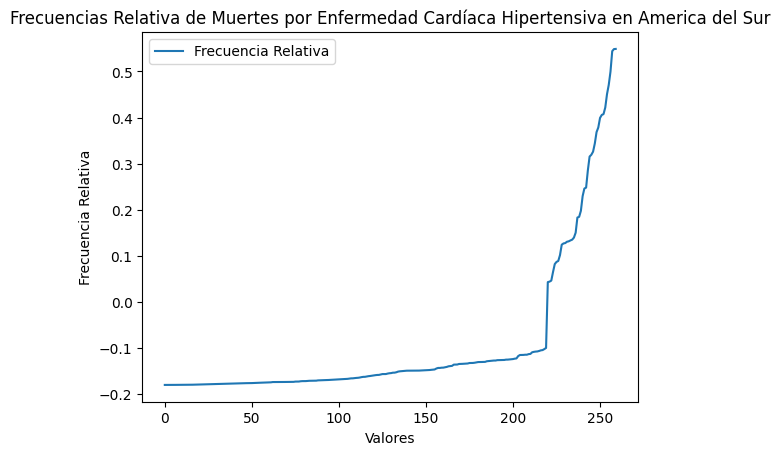

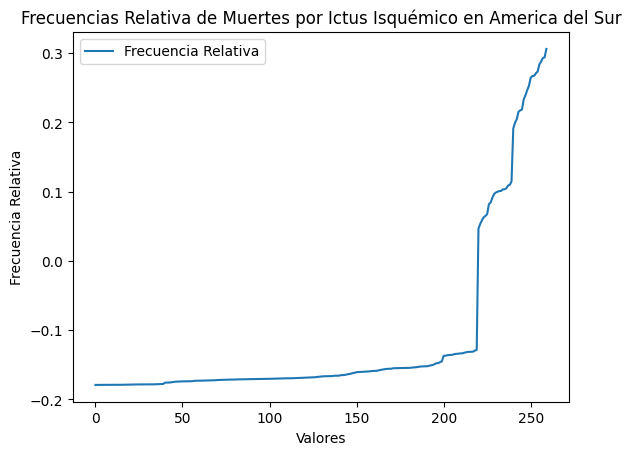

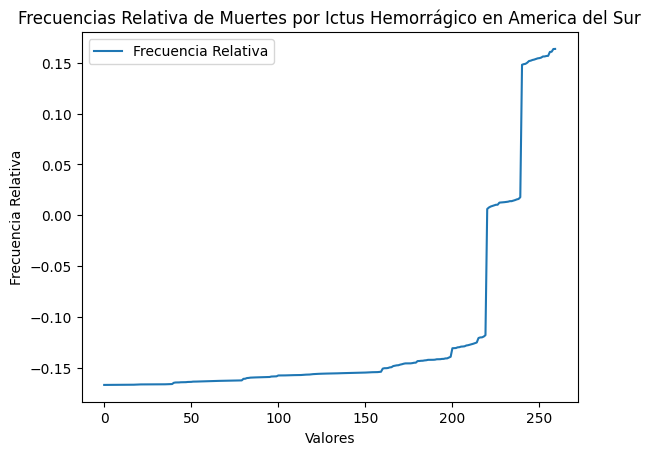

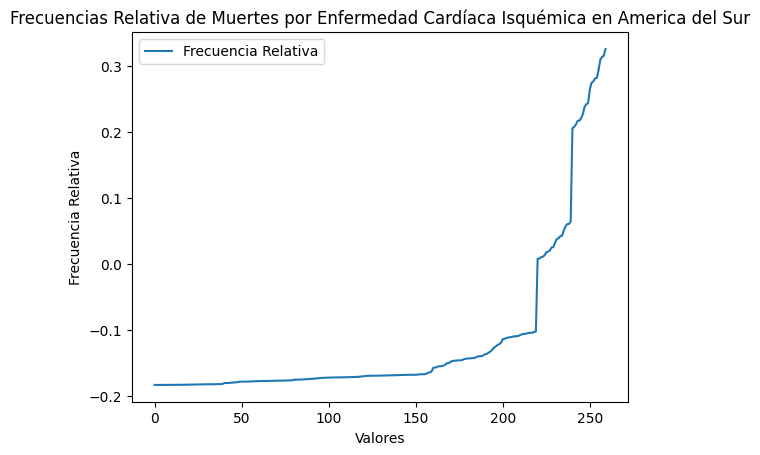

----------------------------------------------------------------------------------
Frecuencias Relativa de muertes por Enfermedades Cardiovasculares en Asia:


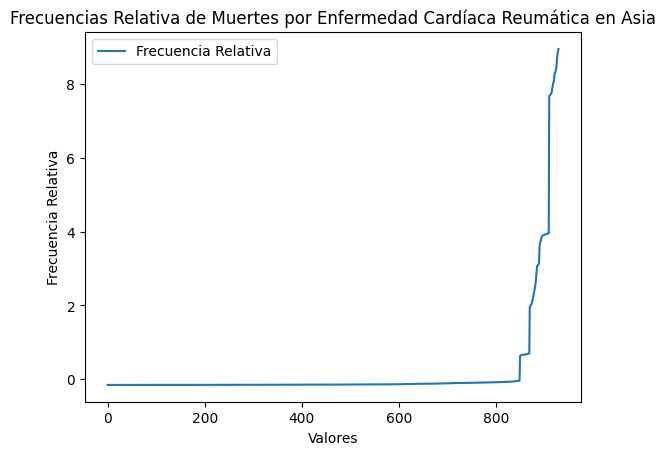

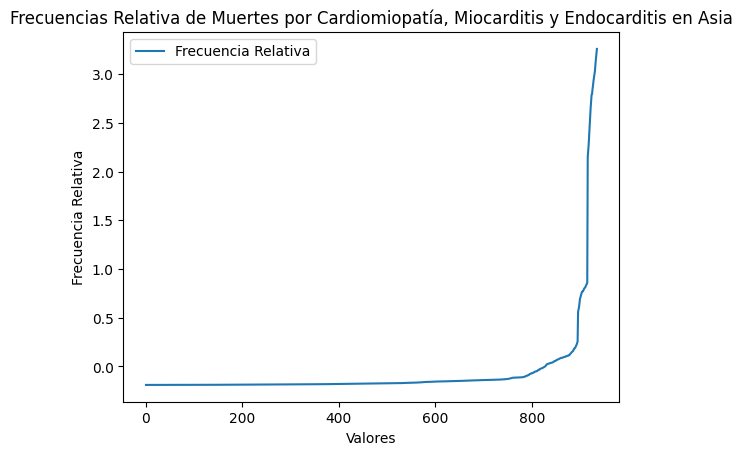

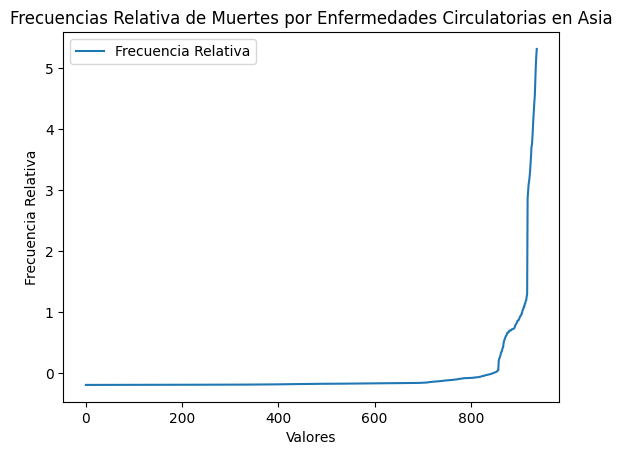

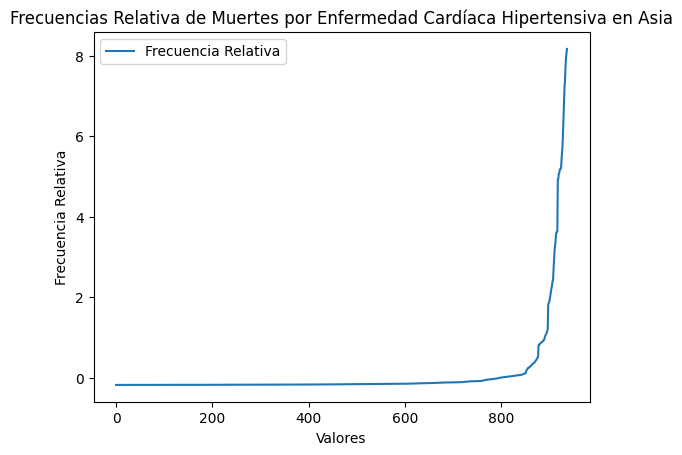

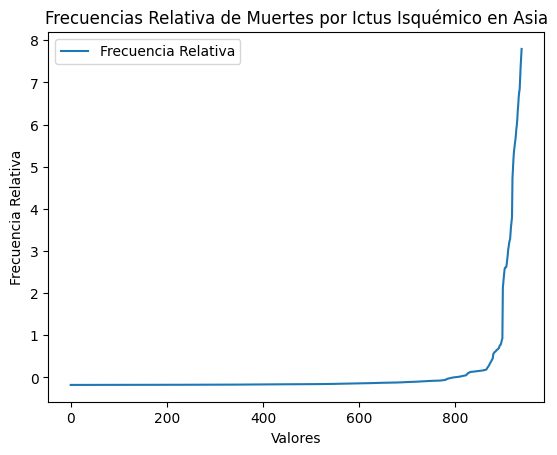

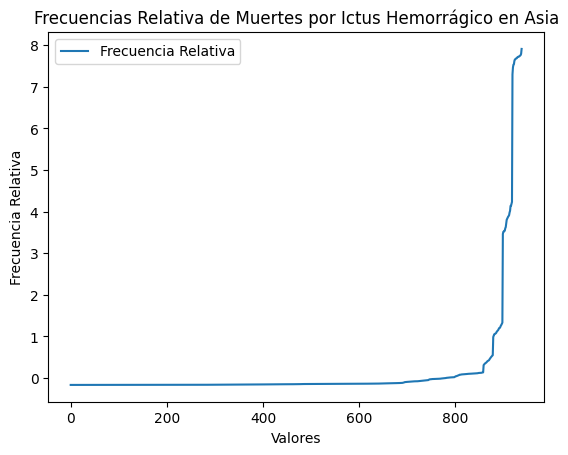

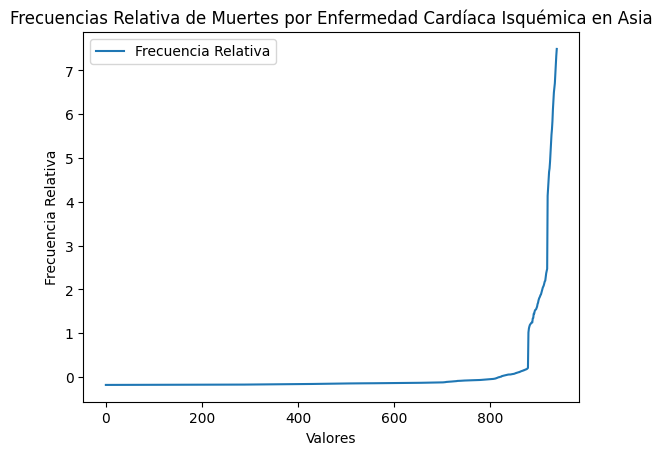

----------------------------------------------------------------------------------
Frecuencias Relativa de muertes por Enfermedades Cardiovasculares en Europa:


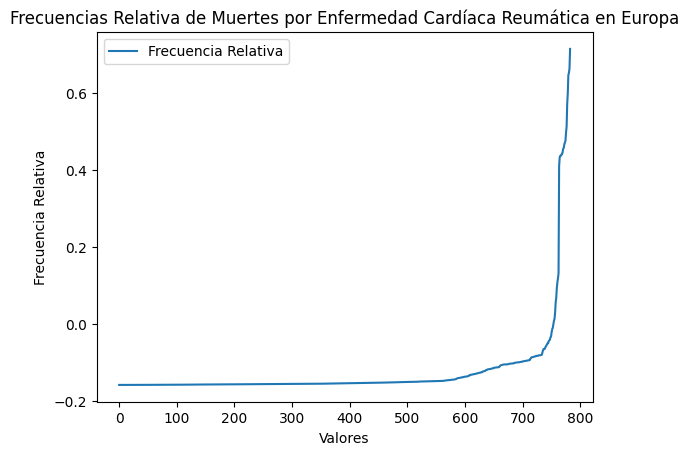

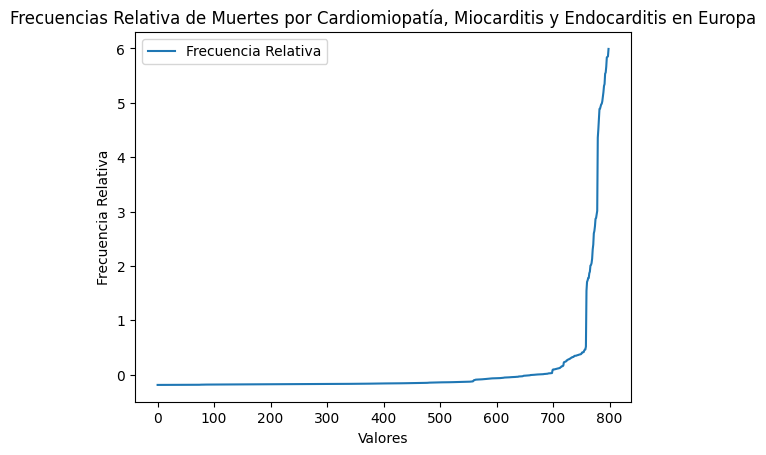

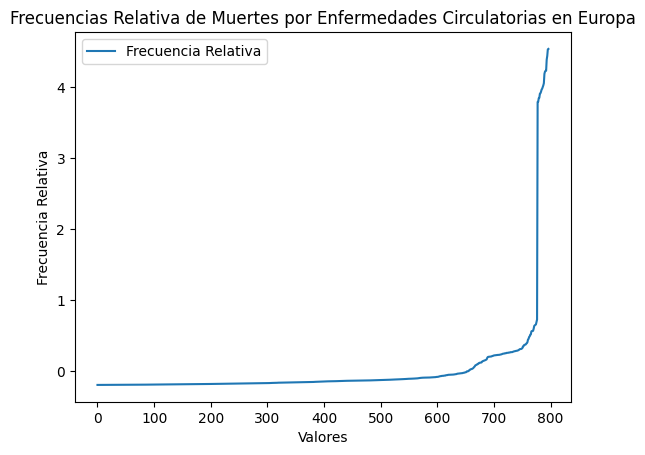

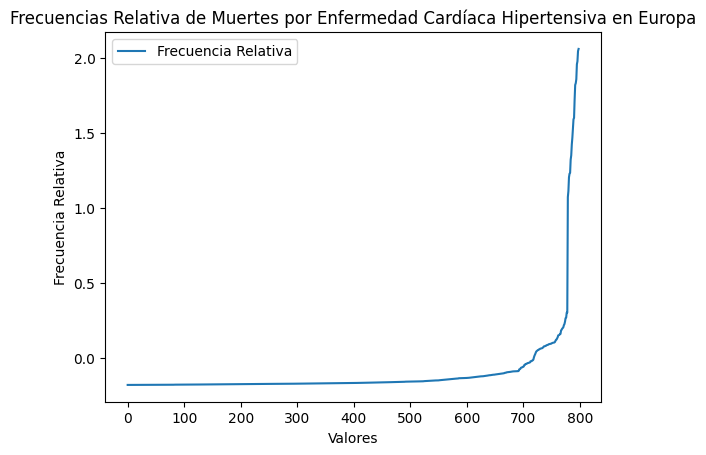

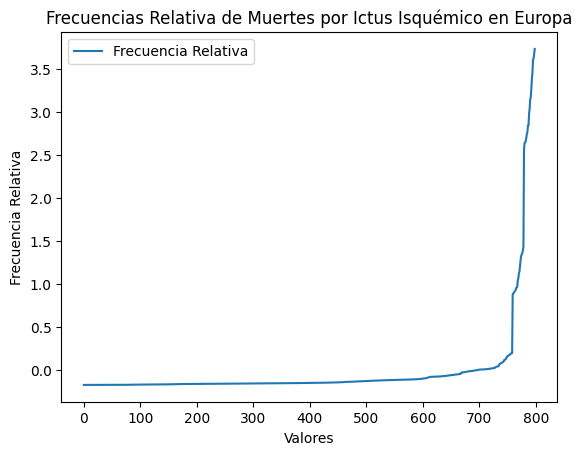

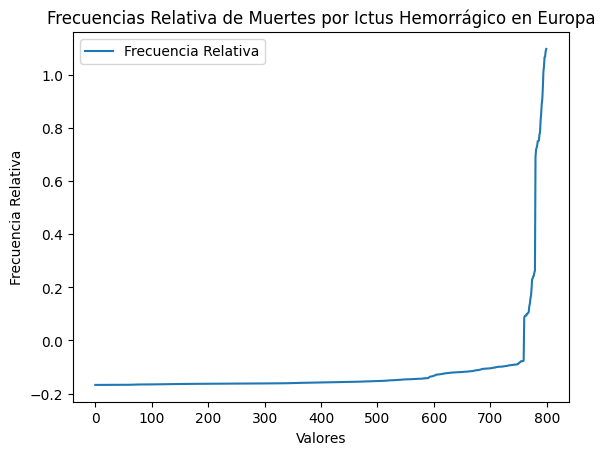

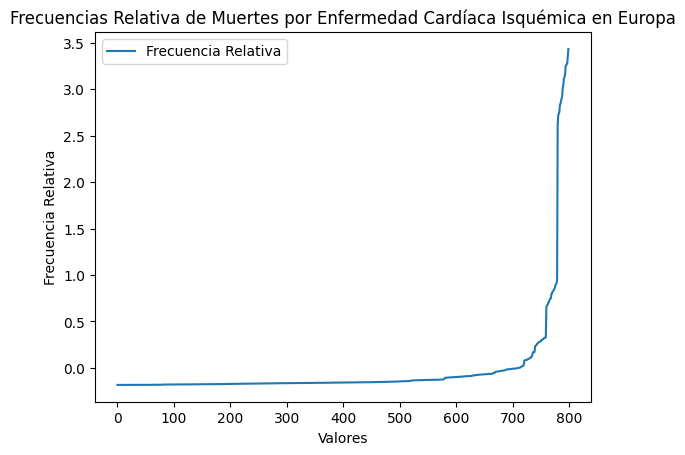

----------------------------------------------------------------------------------
Frecuencias Relativa de muertes por Enfermedades Cardiovasculares en Oceania:


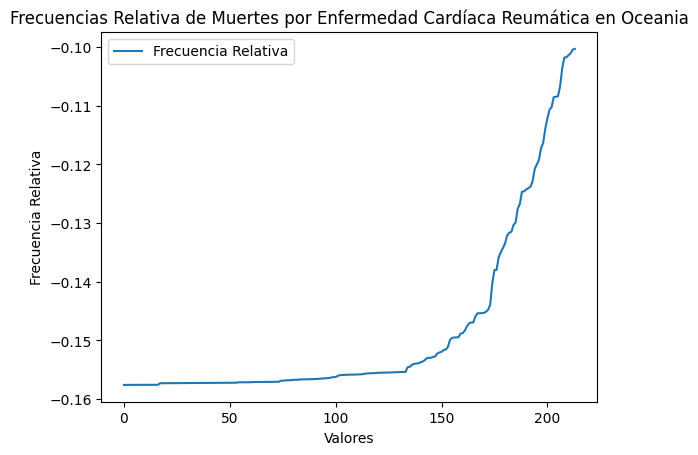

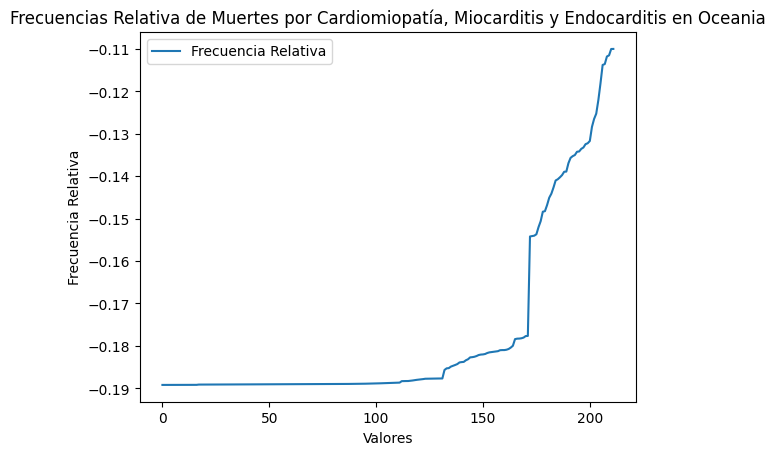

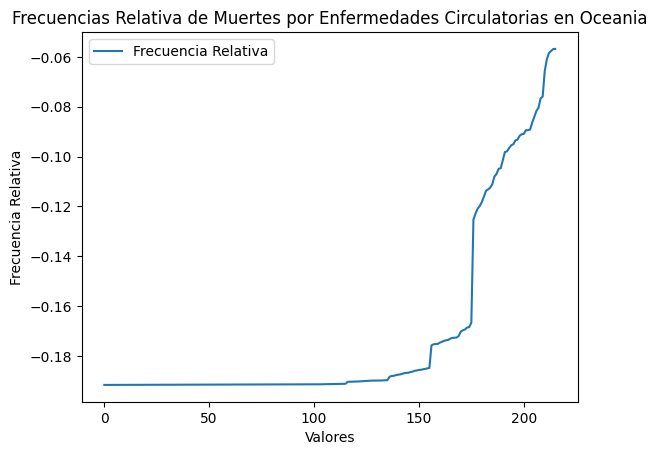

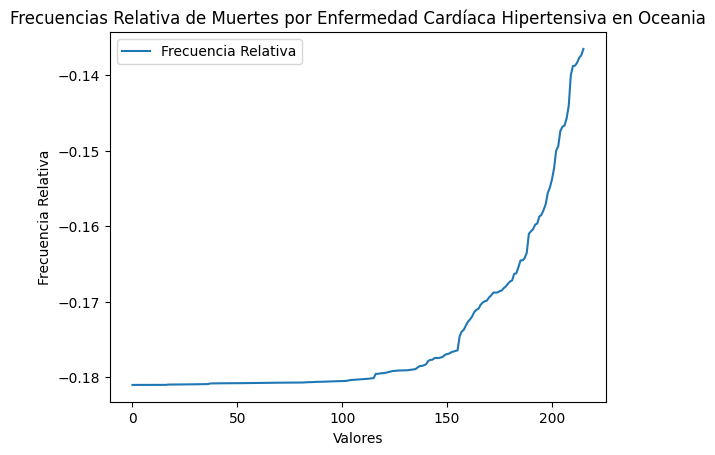

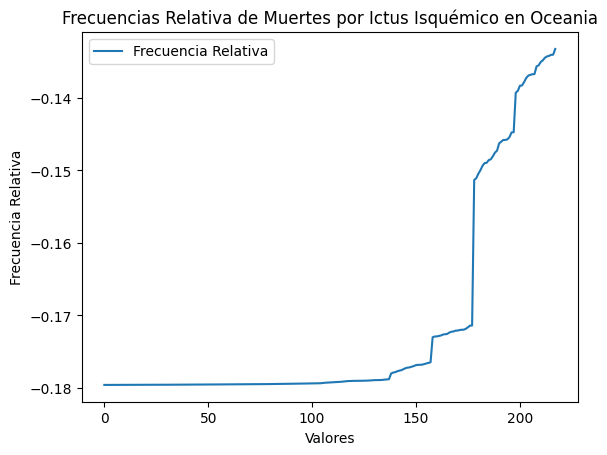

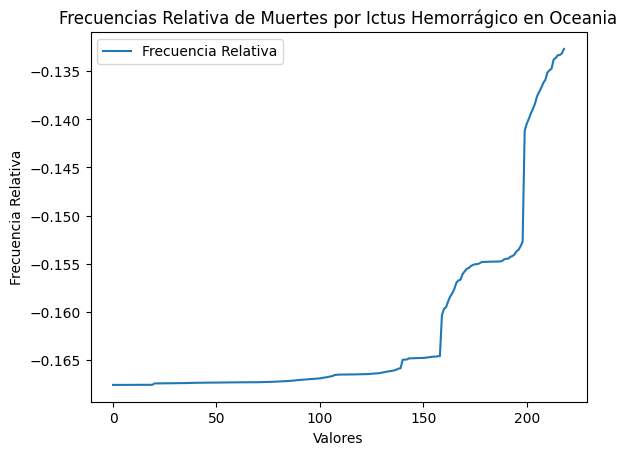

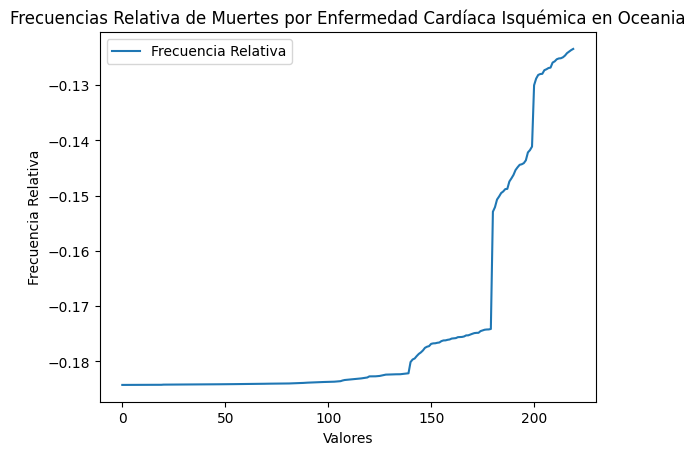

----------------------------------------------------------------------------------


In [ ]:

def calcular_frecuencia_absoluta(data):
  return data.value_counts().sort_index()

resultados = []

for continente, paises in continentes.items():
    df_continente = df[df['Entity'].isin(paises)]
    print(f"Frecuencias Relativa de muertes por Enfermedades Cardiovasculares en {continente}:")

    for patologia in patologias:
        data_patologia = df_continente[patologia]  # Indented this line
        Fabs = calcular_frecuencia_absoluta(data_patologia)
        Frel = Fabs / len(Fabs)
        patologia_legible = reemplazar_texto(patologia)
        resultados.append({
            'Continente': continente,
            'Patologia': patologia_legible,
            'Frecuencia Relativa': Frel
        })
        plt.figure()
        plt.plot(Frel.index, label='Frecuencia Relativa')
        plt.title(f'Frecuencias Relativa de {patologia_legible} en {continente}')
        plt.xlabel('Valores')
        plt.ylabel('Frecuencia Relativa')
        plt.legend()
        plt.show()

    print("----------------------------------------------------------------------------------")

### Frecuencias absolutas

Frecuencias Acumuladas de muertes por Enfermedades Cardiovasculares en Africa:
La Frecuencia Absoluta por Muertes por Enfermedad Cardíaca Reumática es:
 Deaths - Cause: Rheumatic heart disease - Sex: Both sexes - Age group: ALLAges
0.84        1
0.85        2
0.86        3
0.87        2
0.88        1
           ..
19457.38    1
19723.10    1
20017.19    1
20340.27    1
20652.88    1
Name: count, Length: 1051, dtype: int64
La Frecuencia Relativa por Muertes por Enfermedad Cardíaca Reumática es:
 Deaths - Cause: Rheumatic heart disease - Sex: Both sexes - Age group: ALLAges
0.84        0.000926
0.85        0.001852
0.86        0.002778
0.87        0.001852
0.88        0.000926
              ...   
19457.38    0.000926
19723.10    0.000926
20017.19    0.000926
20340.27    0.000926
20652.88    0.000926
Name: count, Length: 1051, dtype: float64
La Frecuencia Absoluta Acumulada por Muertes por Enfermedad Cardíaca Reumática es:
 Deaths - Cause: Rheumatic heart disease - Sex: Both sexes - Age 

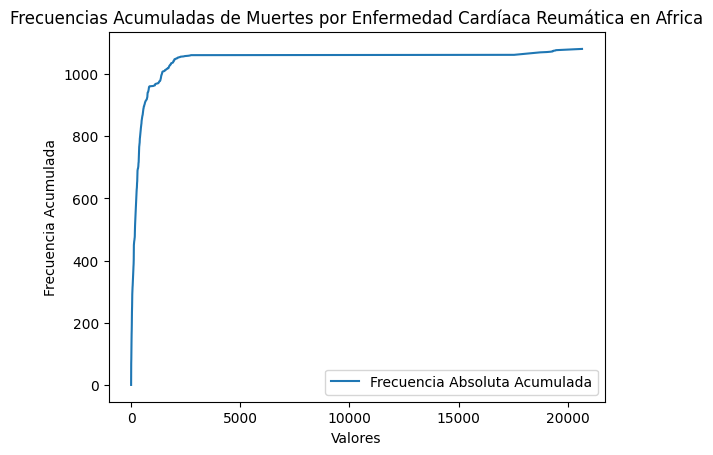

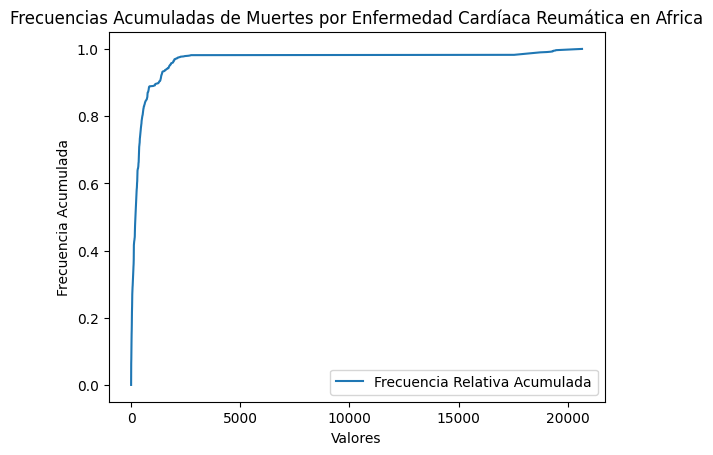

La Frecuencia Absoluta por Muertes por Cardiomiopatía, Miocarditis y Endocarditis es:
 Deaths - Cause: Cardiomyopathy, myocarditis, endocarditis - Sex: Both sexes - Age group: ALLAges
3.590        1
3.790        1
3.950        1
4.140        1
4.260        1
            ..
39371.770    1
40136.400    1
40756.310    1
41414.742    1
41912.140    1
Name: count, Length: 1070, dtype: int64
La Frecuencia Relativa por Muertes por Cardiomiopatía, Miocarditis y Endocarditis es:
 Deaths - Cause: Cardiomyopathy, myocarditis, endocarditis - Sex: Both sexes - Age group: ALLAges
3.590        0.000926
3.790        0.000926
3.950        0.000926
4.140        0.000926
4.260        0.000926
               ...   
39371.770    0.000926
40136.400    0.000926
40756.310    0.000926
41414.742    0.000926
41912.140    0.000926
Name: count, Length: 1070, dtype: float64
La Frecuencia Absoluta Acumulada por Muertes por Cardiomiopatía, Miocarditis y Endocarditis es:
 Deaths - Cause: Cardiomyopathy, myocarditis, e

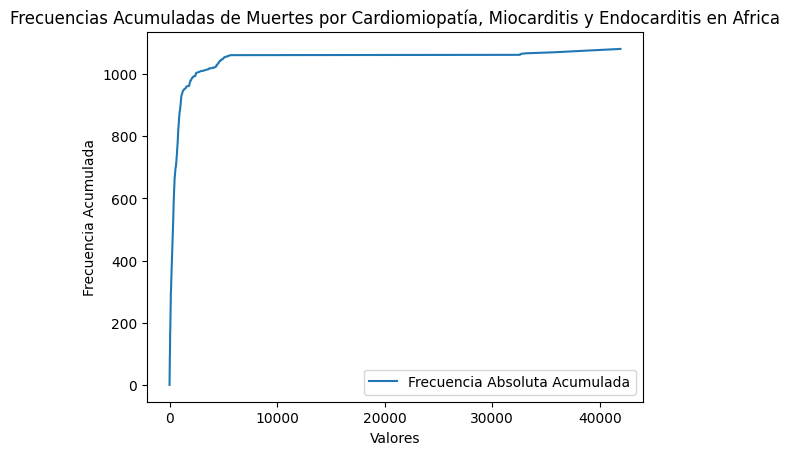

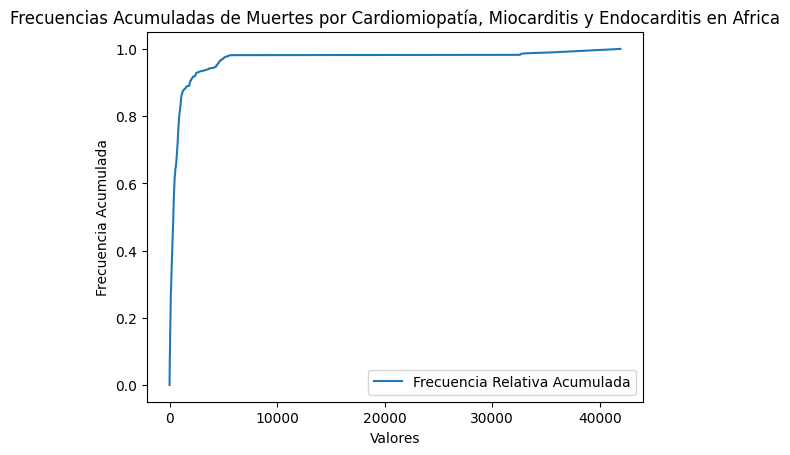

La Frecuencia Absoluta por Muertes por Enfermedades Circulatorias es:
 Deaths - Cause: Other circulatory diseases - Sex: Both sexes - Age group: ALLAges
7.84        1
8.01        1
8.30        1
8.67        1
8.79        1
           ..
79002.25    1
80907.11    1
82560.66    1
84386.80    1
85875.71    1
Name: count, Length: 1077, dtype: int64
La Frecuencia Relativa por Muertes por Enfermedades Circulatorias es:
 Deaths - Cause: Other circulatory diseases - Sex: Both sexes - Age group: ALLAges
7.84        0.000926
8.01        0.000926
8.30        0.000926
8.67        0.000926
8.79        0.000926
              ...   
79002.25    0.000926
80907.11    0.000926
82560.66    0.000926
84386.80    0.000926
85875.71    0.000926
Name: count, Length: 1077, dtype: float64
La Frecuencia Absoluta Acumulada por Muertes por Enfermedades Circulatorias es:
 Deaths - Cause: Other circulatory diseases - Sex: Both sexes - Age group: ALLAges
7.84           1
8.01           2
8.30           3
8.67         

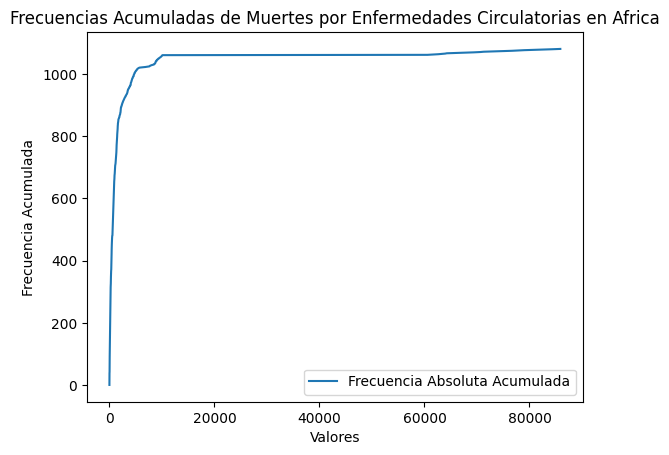

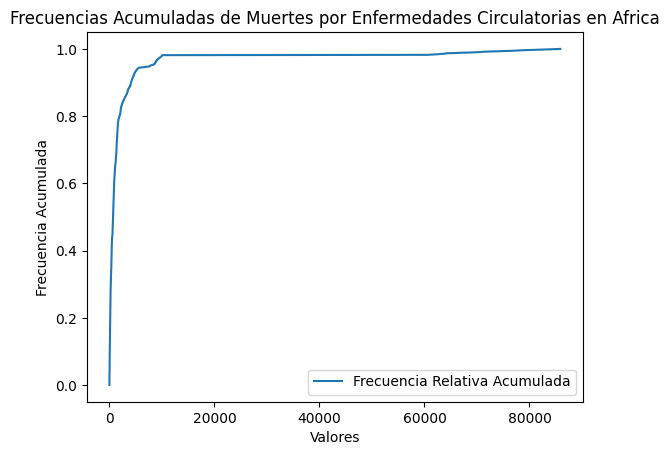

La Frecuencia Absoluta por Muertes por Enfermedad Cardíaca Hipertensiva es:
 Deaths - Cause: Hypertensive heart disease - Sex: Both sexes - Age group: ALLAges
4.49         1
4.60         1
4.91         1
5.01         1
5.13         1
            ..
157492.22    1
160568.23    1
163145.42    1
166119.48    1
168953.52    1
Name: count, Length: 1074, dtype: int64
La Frecuencia Relativa por Muertes por Enfermedad Cardíaca Hipertensiva es:
 Deaths - Cause: Hypertensive heart disease - Sex: Both sexes - Age group: ALLAges
4.49         0.000926
4.60         0.000926
4.91         0.000926
5.01         0.000926
5.13         0.000926
               ...   
157492.22    0.000926
160568.23    0.000926
163145.42    0.000926
166119.48    0.000926
168953.52    0.000926
Name: count, Length: 1074, dtype: float64
La Frecuencia Absoluta Acumulada por Muertes por Enfermedad Cardíaca Hipertensiva es:
 Deaths - Cause: Hypertensive heart disease - Sex: Both sexes - Age group: ALLAges
4.49            1
4.60  

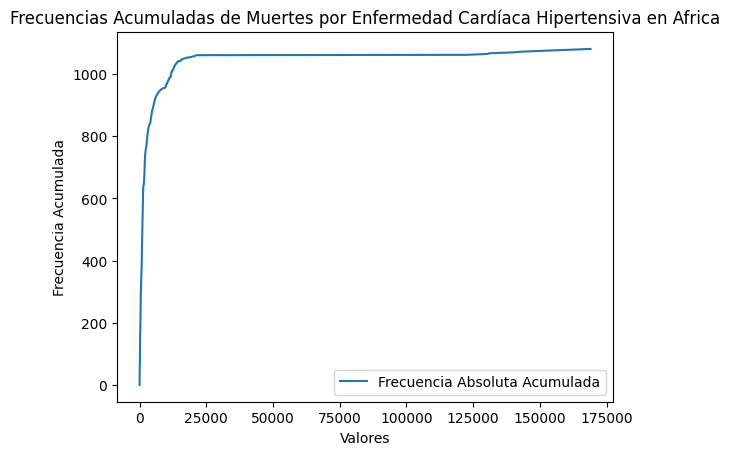

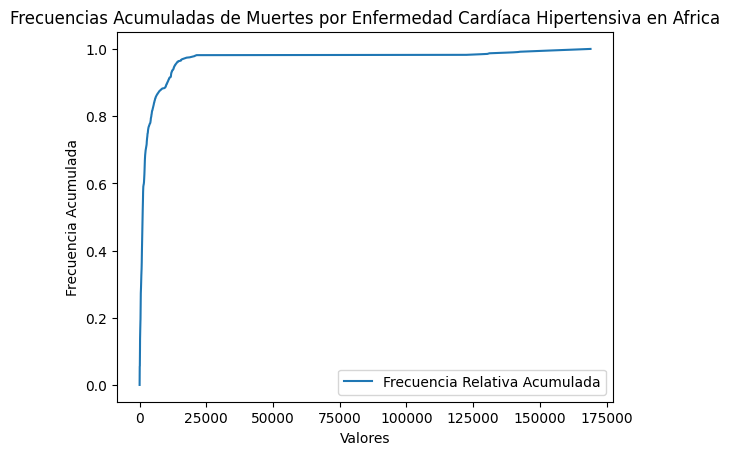

La Frecuencia Absoluta por Muertes por Ictus Isquémico es:
 Deaths - Cause: Ischaemic stroke - Sex: Both sexes - Age group: ALLAges
20.72        1
21.32        1
21.41        1
22.23        1
22.44        1
            ..
202617.55    1
208114.31    1
212977.38    1
218254.10    1
222601.17    1
Name: count, Length: 1078, dtype: int64
La Frecuencia Relativa por Muertes por Ictus Isquémico es:
 Deaths - Cause: Ischaemic stroke - Sex: Both sexes - Age group: ALLAges
20.72        0.000926
21.32        0.000926
21.41        0.000926
22.23        0.000926
22.44        0.000926
               ...   
202617.55    0.000926
208114.31    0.000926
212977.38    0.000926
218254.10    0.000926
222601.17    0.000926
Name: count, Length: 1078, dtype: float64
La Frecuencia Absoluta Acumulada por Muertes por Ictus Isquémico es:
 Deaths - Cause: Ischaemic stroke - Sex: Both sexes - Age group: ALLAges
20.72           1
21.32           2
21.41           3
22.23           4
22.44           5
             ..

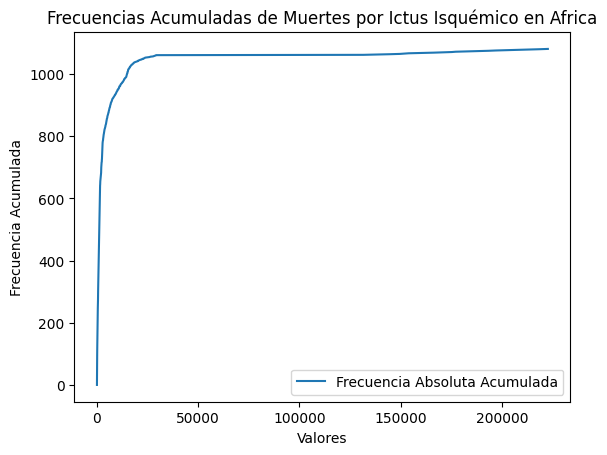

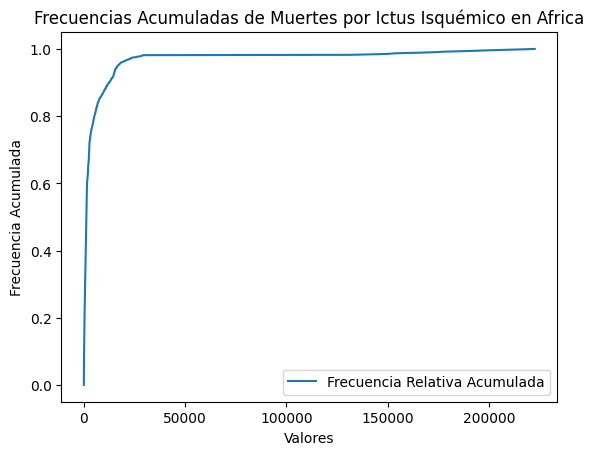

La Frecuencia Absoluta por Muertes por Ictus Hemorrágico es:
 Deaths - Cause: Haemorrhagic stroke - Sex: Both sexes - Age group: ALLAges
24.60        1
24.63        1
25.12        1
26.29        1
26.51        1
            ..
308043.97    1
311411.28    1
313122.80    1
316123.34    1
319787.00    1
Name: count, Length: 1077, dtype: int64
La Frecuencia Relativa por Muertes por Ictus Hemorrágico es:
 Deaths - Cause: Haemorrhagic stroke - Sex: Both sexes - Age group: ALLAges
24.60        0.000926
24.63        0.000926
25.12        0.000926
26.29        0.000926
26.51        0.000926
               ...   
308043.97    0.000926
311411.28    0.000926
313122.80    0.000926
316123.34    0.000926
319787.00    0.000926
Name: count, Length: 1077, dtype: float64
La Frecuencia Absoluta Acumulada por Muertes por Ictus Hemorrágico es:
 Deaths - Cause: Haemorrhagic stroke - Sex: Both sexes - Age group: ALLAges
24.60           1
24.63           2
25.12           3
26.29           4
26.51           5


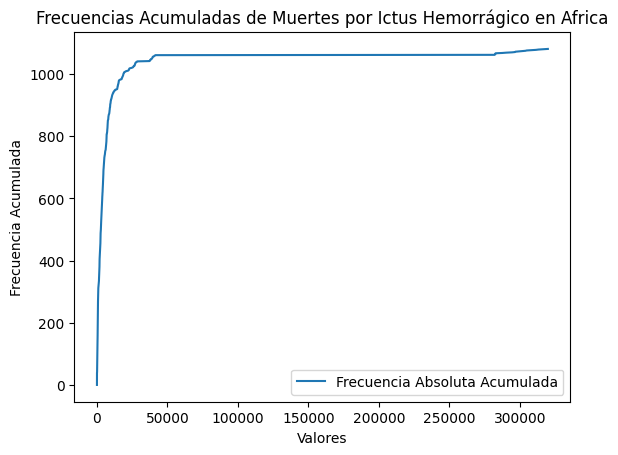

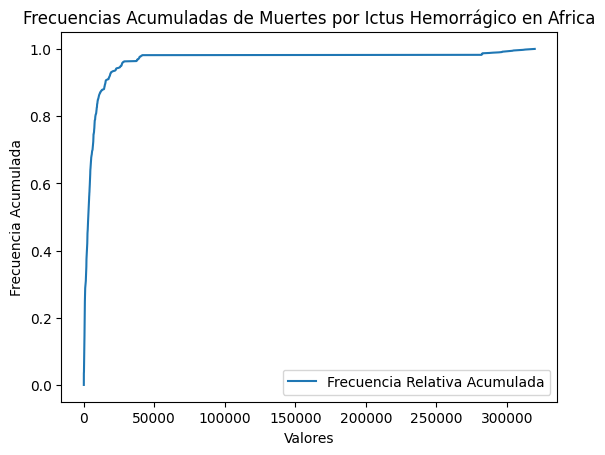

La Frecuencia Absoluta por Muertes por Enfermedad Cardíaca Isquémica es:
 Deaths - Cause: Ischaemic heart disease - Sex: Both sexes - Age group: ALLAges
62.27        1
63.46        1
64.86        1
67.25        1
68.50        1
            ..
700492.70    1
711311.40    1
723322.70    1
743241.20    1
759545.20    1
Name: count, Length: 1080, dtype: int64
La Frecuencia Relativa por Muertes por Enfermedad Cardíaca Isquémica es:
 Deaths - Cause: Ischaemic heart disease - Sex: Both sexes - Age group: ALLAges
62.27        0.000926
63.46        0.000926
64.86        0.000926
67.25        0.000926
68.50        0.000926
               ...   
700492.70    0.000926
711311.40    0.000926
723322.70    0.000926
743241.20    0.000926
759545.20    0.000926
Name: count, Length: 1080, dtype: float64
La Frecuencia Absoluta Acumulada por Muertes por Enfermedad Cardíaca Isquémica es:
 Deaths - Cause: Ischaemic heart disease - Sex: Both sexes - Age group: ALLAges
62.27           1
63.46           2
64.86 

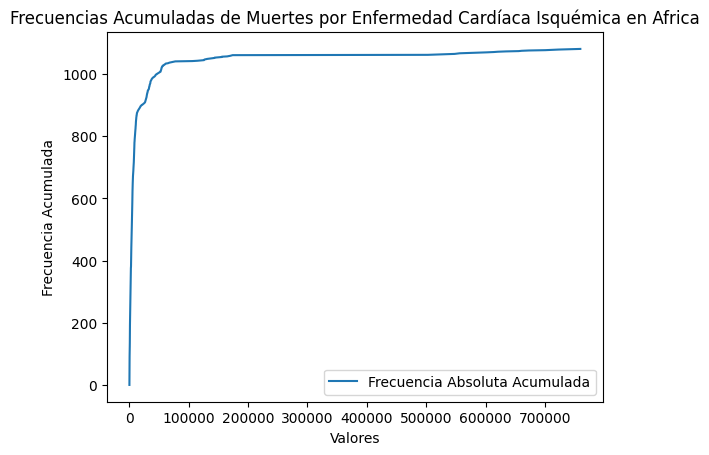

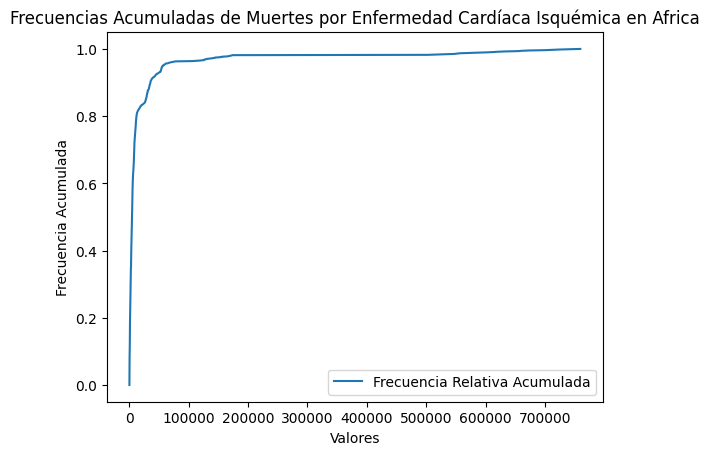

----------------------------------------------------------------------------------
Frecuencias Acumuladas de muertes por Enfermedades Cardiovasculares en America del Norte:
La Frecuencia Absoluta por Muertes por Enfermedad Cardíaca Reumática es:
 Deaths - Cause: Rheumatic heart disease - Sex: Both sexes - Age group: ALLAges
0.00       7
0.09       1
0.19       1
0.20       1
0.24       1
          ..
6487.09    1
6492.11    1
6593.87    1
6691.04    1
6772.00    1
Name: count, Length: 407, dtype: int64
La Frecuencia Relativa por Muertes por Enfermedad Cardíaca Reumática es:
 Deaths - Cause: Rheumatic heart disease - Sex: Both sexes - Age group: ALLAges
0.00       0.015909
0.09       0.002273
0.19       0.002273
0.20       0.002273
0.24       0.002273
             ...   
6487.09    0.002273
6492.11    0.002273
6593.87    0.002273
6691.04    0.002273
6772.00    0.002273
Name: count, Length: 407, dtype: float64
La Frecuencia Absoluta Acumulada por Muertes por Enfermedad Cardíaca Reumática

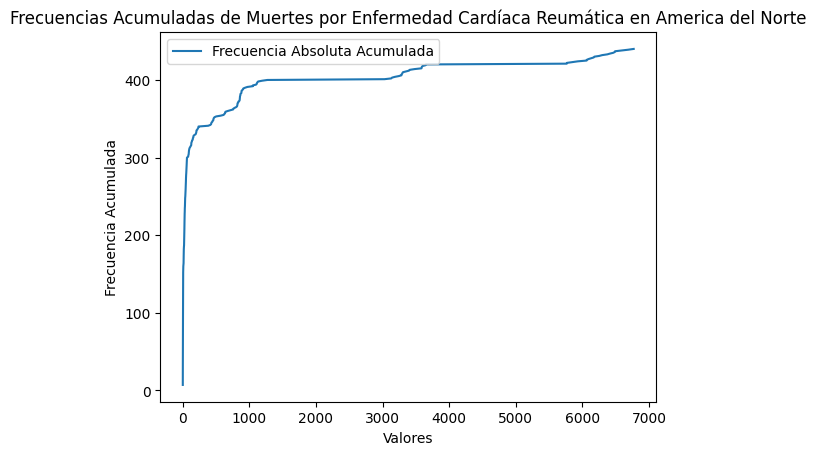

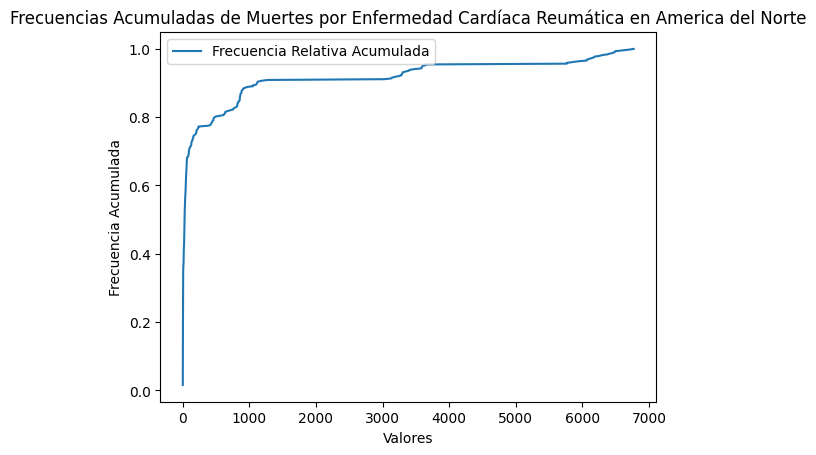

La Frecuencia Absoluta por Muertes por Cardiomiopatía, Miocarditis y Endocarditis es:
 Deaths - Cause: Cardiomyopathy, myocarditis, endocarditis - Sex: Both sexes - Age group: ALLAges
1.23        1
1.67        1
1.79        1
2.00        1
2.05        1
           ..
39512.35    1
39797.33    1
39922.47    1
40191.20    1
40494.66    1
Name: count, Length: 438, dtype: int64
La Frecuencia Relativa por Muertes por Cardiomiopatía, Miocarditis y Endocarditis es:
 Deaths - Cause: Cardiomyopathy, myocarditis, endocarditis - Sex: Both sexes - Age group: ALLAges
1.23        0.002273
1.67        0.002273
1.79        0.002273
2.00        0.002273
2.05        0.002273
              ...   
39512.35    0.002273
39797.33    0.002273
39922.47    0.002273
40191.20    0.002273
40494.66    0.002273
Name: count, Length: 438, dtype: float64
La Frecuencia Absoluta Acumulada por Muertes por Cardiomiopatía, Miocarditis y Endocarditis es:
 Deaths - Cause: Cardiomyopathy, myocarditis, endocarditis - Sex: Both 

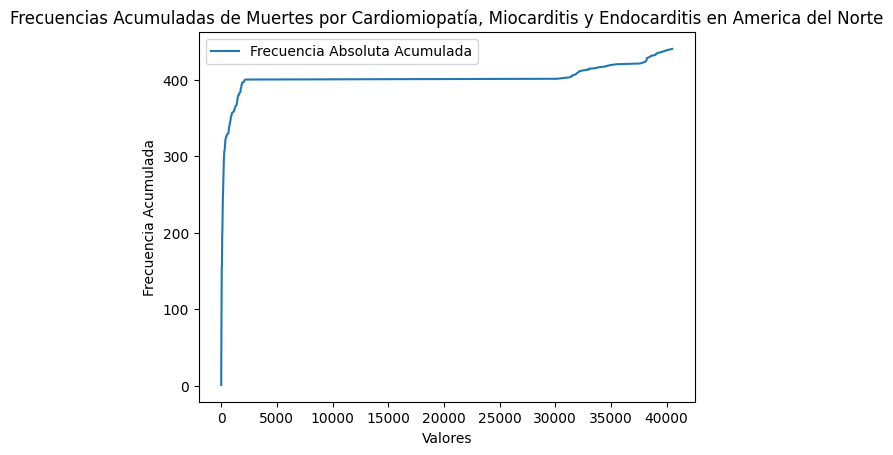

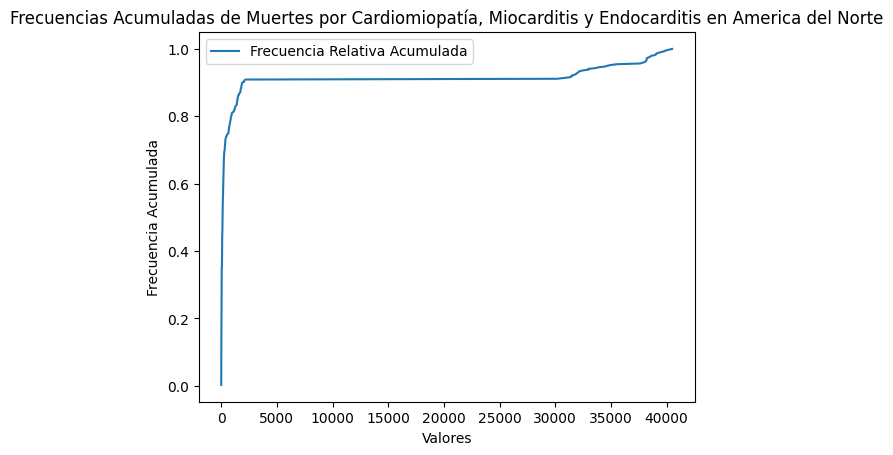

La Frecuencia Absoluta por Muertes por Enfermedades Circulatorias es:
 Deaths - Cause: Other circulatory diseases - Sex: Both sexes - Age group: ALLAges
14.40        1
14.52        1
14.73        1
16.99        1
17.50        1
            ..
130131.31    1
133030.39    1
135864.75    1
138203.08    1
140496.17    1
Name: count, Length: 437, dtype: int64
La Frecuencia Relativa por Muertes por Enfermedades Circulatorias es:
 Deaths - Cause: Other circulatory diseases - Sex: Both sexes - Age group: ALLAges
14.40        0.002273
14.52        0.002273
14.73        0.002273
16.99        0.002273
17.50        0.002273
               ...   
130131.31    0.002273
133030.39    0.002273
135864.75    0.002273
138203.08    0.002273
140496.17    0.002273
Name: count, Length: 437, dtype: float64
La Frecuencia Absoluta Acumulada por Muertes por Enfermedades Circulatorias es:
 Deaths - Cause: Other circulatory diseases - Sex: Both sexes - Age group: ALLAges
14.40          1
14.52          2
14.73     

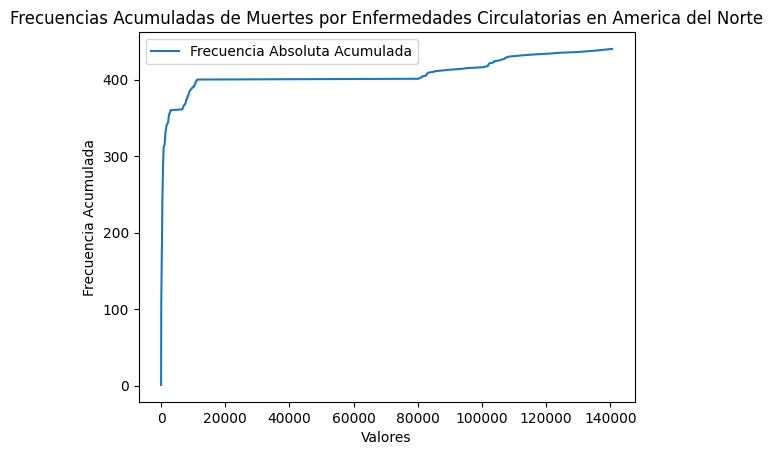

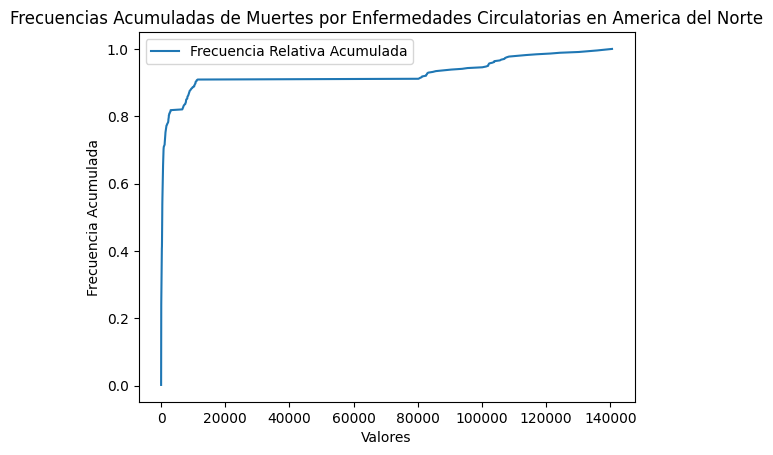

La Frecuencia Absoluta por Muertes por Enfermedad Cardíaca Hipertensiva es:
 Deaths - Cause: Hypertensive heart disease - Sex: Both sexes - Age group: ALLAges
0.00         1
1.44         1
2.61         1
5.05         1
6.60         1
            ..
88564.22     1
93023.07     1
97884.39     1
99771.36     1
100504.29    1
Name: count, Length: 435, dtype: int64
La Frecuencia Relativa por Muertes por Enfermedad Cardíaca Hipertensiva es:
 Deaths - Cause: Hypertensive heart disease - Sex: Both sexes - Age group: ALLAges
0.00         0.002273
1.44         0.002273
2.61         0.002273
5.05         0.002273
6.60         0.002273
               ...   
88564.22     0.002273
93023.07     0.002273
97884.39     0.002273
99771.36     0.002273
100504.29    0.002273
Name: count, Length: 435, dtype: float64
La Frecuencia Absoluta Acumulada por Muertes por Enfermedad Cardíaca Hipertensiva es:
 Deaths - Cause: Hypertensive heart disease - Sex: Both sexes - Age group: ALLAges
0.00           1
1.44     

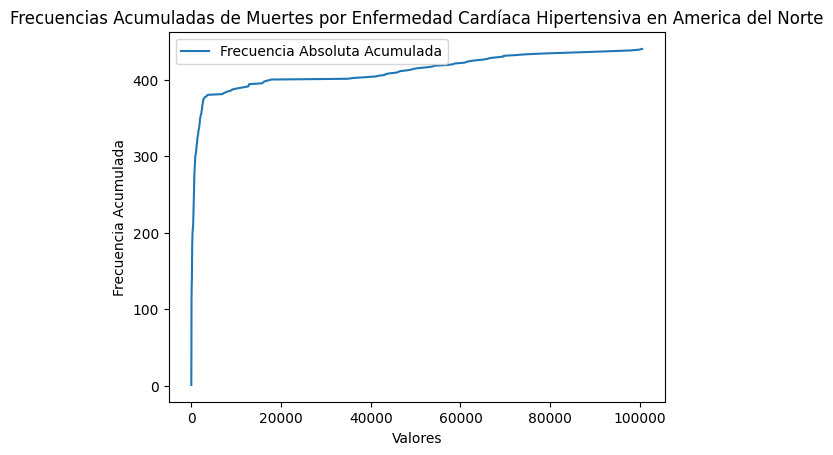

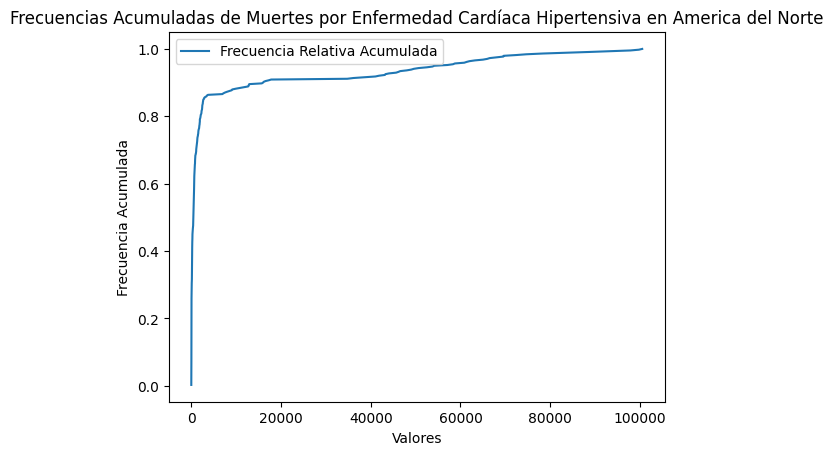

La Frecuencia Absoluta por Muertes por Ictus Isquémico es:
 Deaths - Cause: Ischaemic stroke - Sex: Both sexes - Age group: ALLAges
18.06        1
19.76        1
20.19        1
21.92        1
22.37        1
            ..
144782.52    1
146436.77    1
147397.98    1
147605.08    1
150389.78    1
Name: count, Length: 438, dtype: int64
La Frecuencia Relativa por Muertes por Ictus Isquémico es:
 Deaths - Cause: Ischaemic stroke - Sex: Both sexes - Age group: ALLAges
18.06        0.002273
19.76        0.002273
20.19        0.002273
21.92        0.002273
22.37        0.002273
               ...   
144782.52    0.002273
146436.77    0.002273
147397.98    0.002273
147605.08    0.002273
150389.78    0.002273
Name: count, Length: 438, dtype: float64
La Frecuencia Absoluta Acumulada por Muertes por Ictus Isquémico es:
 Deaths - Cause: Ischaemic stroke - Sex: Both sexes - Age group: ALLAges
18.06          1
19.76          2
20.19          3
21.92          4
22.37          5
            ... 
14478

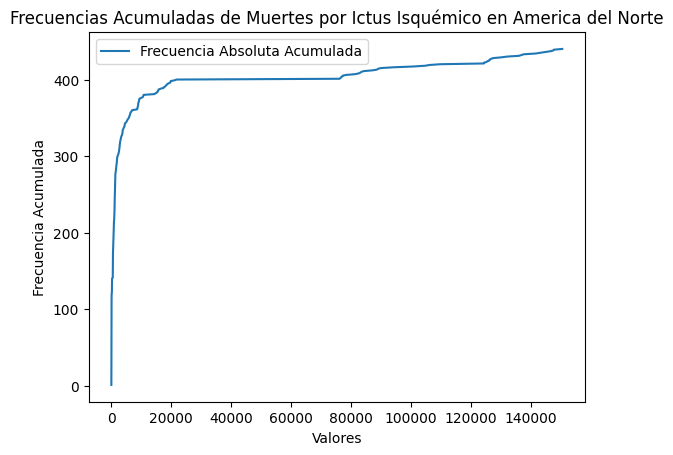

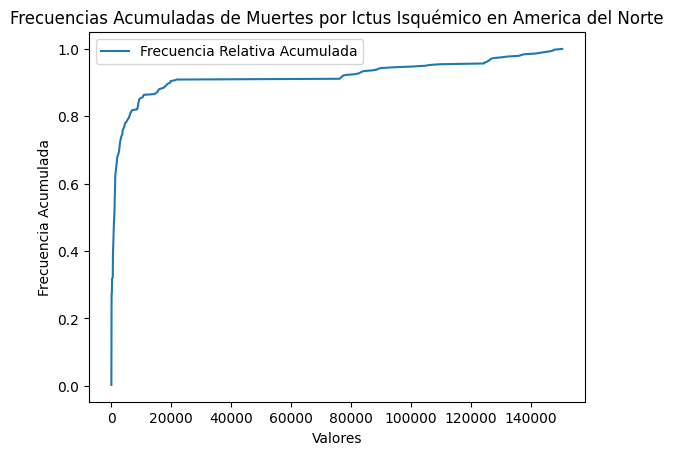

La Frecuencia Absoluta por Muertes por Ictus Hemorrágico es:
 Deaths - Cause: Haemorrhagic stroke - Sex: Both sexes - Age group: ALLAges
19.59        1
20.18        1
21.92        1
22.05        1
22.20        1
            ..
110249.72    1
111734.02    1
114282.62    1
115814.10    1
117863.97    1
Name: count, Length: 435, dtype: int64
La Frecuencia Relativa por Muertes por Ictus Hemorrágico es:
 Deaths - Cause: Haemorrhagic stroke - Sex: Both sexes - Age group: ALLAges
19.59        0.002273
20.18        0.002273
21.92        0.002273
22.05        0.002273
22.20        0.002273
               ...   
110249.72    0.002273
111734.02    0.002273
114282.62    0.002273
115814.10    0.002273
117863.97    0.002273
Name: count, Length: 435, dtype: float64
La Frecuencia Absoluta Acumulada por Muertes por Ictus Hemorrágico es:
 Deaths - Cause: Haemorrhagic stroke - Sex: Both sexes - Age group: ALLAges
19.59          1
20.18          2
21.92          3
22.05          4
22.20          5
       

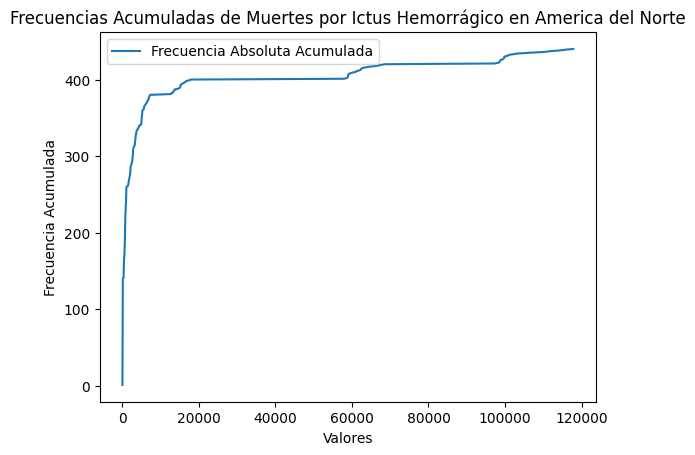

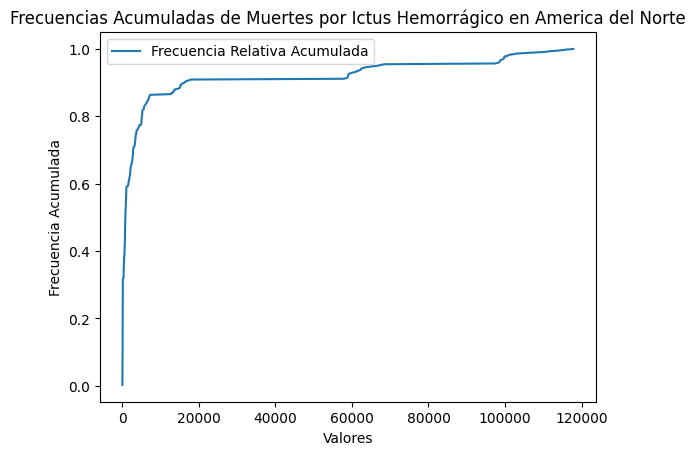

La Frecuencia Absoluta por Muertes por Enfermedad Cardíaca Isquémica es:
 Deaths - Cause: Ischaemic heart disease - Sex: Both sexes - Age group: ALLAges
52.45        1
56.61        1
65.10        1
67.10        1
76.19        1
            ..
738099.70    1
746474.90    1
750899.60    1
753114.75    1
763962.44    1
Name: count, Length: 440, dtype: int64
La Frecuencia Relativa por Muertes por Enfermedad Cardíaca Isquémica es:
 Deaths - Cause: Ischaemic heart disease - Sex: Both sexes - Age group: ALLAges
52.45        0.002273
56.61        0.002273
65.10        0.002273
67.10        0.002273
76.19        0.002273
               ...   
738099.70    0.002273
746474.90    0.002273
750899.60    0.002273
753114.75    0.002273
763962.44    0.002273
Name: count, Length: 440, dtype: float64
La Frecuencia Absoluta Acumulada por Muertes por Enfermedad Cardíaca Isquémica es:
 Deaths - Cause: Ischaemic heart disease - Sex: Both sexes - Age group: ALLAges
52.45          1
56.61          2
65.10     

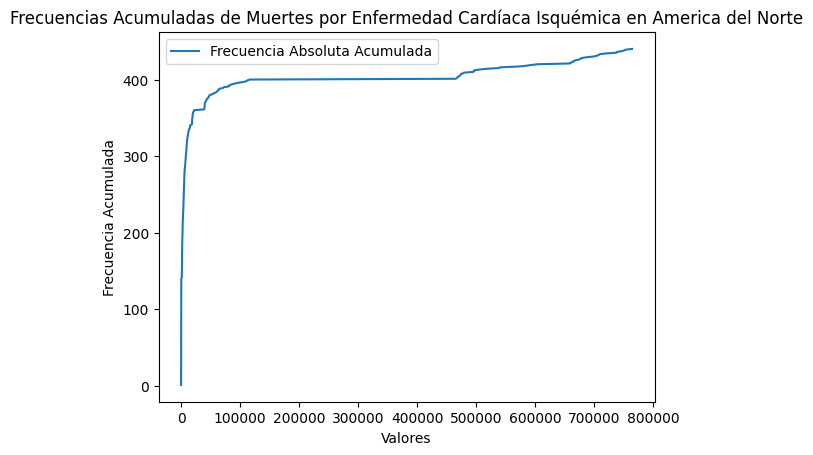

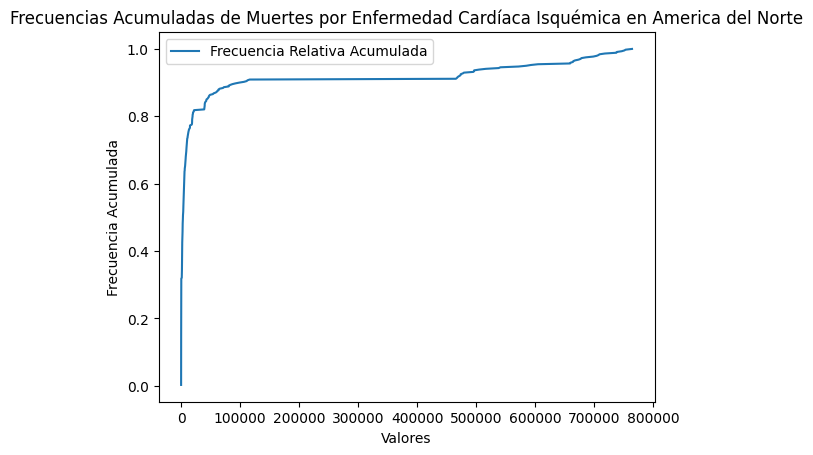

----------------------------------------------------------------------------------
Frecuencias Acumuladas de muertes por Enfermedades Cardiovasculares en America del Sur:
La Frecuencia Absoluta por Muertes por Enfermedad Cardíaca Reumática es:
 Deaths - Cause: Rheumatic heart disease - Sex: Both sexes - Age group: ALLAges
5.4900       1
5.5400       1
5.6000       1
5.6100       1
5.7400       1
            ..
3852.3300    1
3913.7200    1
3927.4200    1
3929.3098    1
4132.8003    1
Name: count, Length: 259, dtype: int64
La Frecuencia Relativa por Muertes por Enfermedad Cardíaca Reumática es:
 Deaths - Cause: Rheumatic heart disease - Sex: Both sexes - Age group: ALLAges
5.4900       0.003846
5.5400       0.003846
5.6000       0.003846
5.6100       0.003846
5.7400       0.003846
               ...   
3852.3300    0.003846
3913.7200    0.003846
3927.4200    0.003846
3929.3098    0.003846
4132.8003    0.003846
Name: count, Length: 259, dtype: float64
La Frecuencia Absoluta Acumulada por

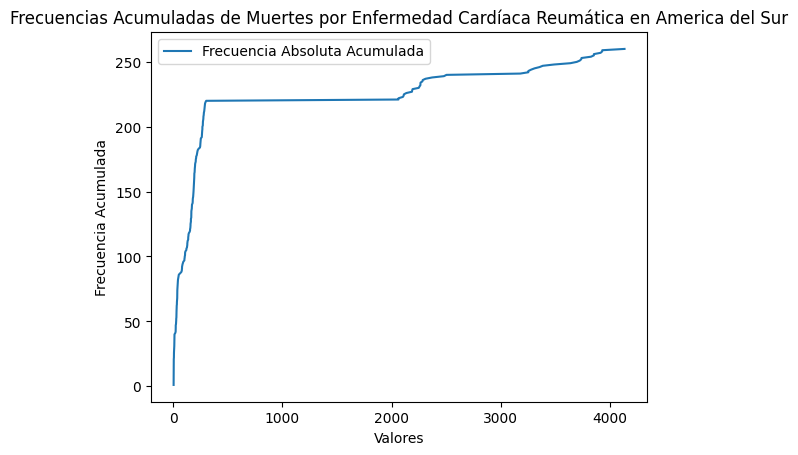

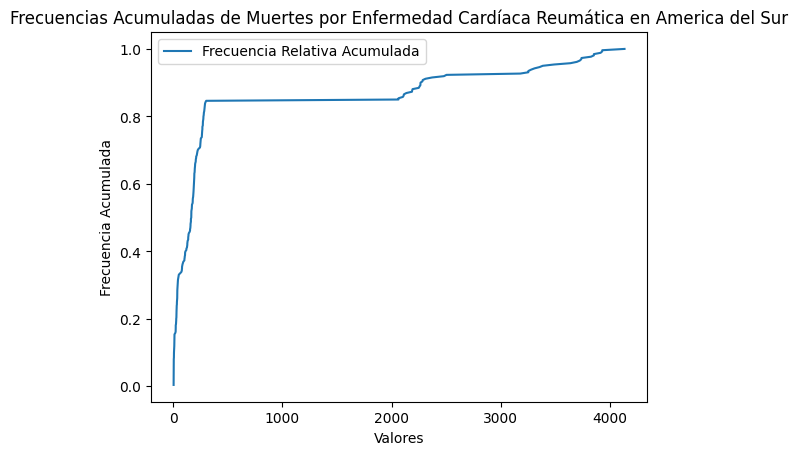

La Frecuencia Absoluta por Muertes por Cardiomiopatía, Miocarditis y Endocarditis es:
 Deaths - Cause: Cardiomyopathy, myocarditis, endocarditis - Sex: Both sexes - Age group: ALLAges
20.020       1
22.010       1
22.270       1
22.530       1
22.800       1
            ..
26624.418    1
26991.300    1
27016.250    1
27413.060    1
28142.750    1
Name: count, Length: 260, dtype: int64
La Frecuencia Relativa por Muertes por Cardiomiopatía, Miocarditis y Endocarditis es:
 Deaths - Cause: Cardiomyopathy, myocarditis, endocarditis - Sex: Both sexes - Age group: ALLAges
20.020       0.003846
22.010       0.003846
22.270       0.003846
22.530       0.003846
22.800       0.003846
               ...   
26624.418    0.003846
26991.300    0.003846
27016.250    0.003846
27413.060    0.003846
28142.750    0.003846
Name: count, Length: 260, dtype: float64
La Frecuencia Absoluta Acumulada por Muertes por Cardiomiopatía, Miocarditis y Endocarditis es:
 Deaths - Cause: Cardiomyopathy, myocarditis, end

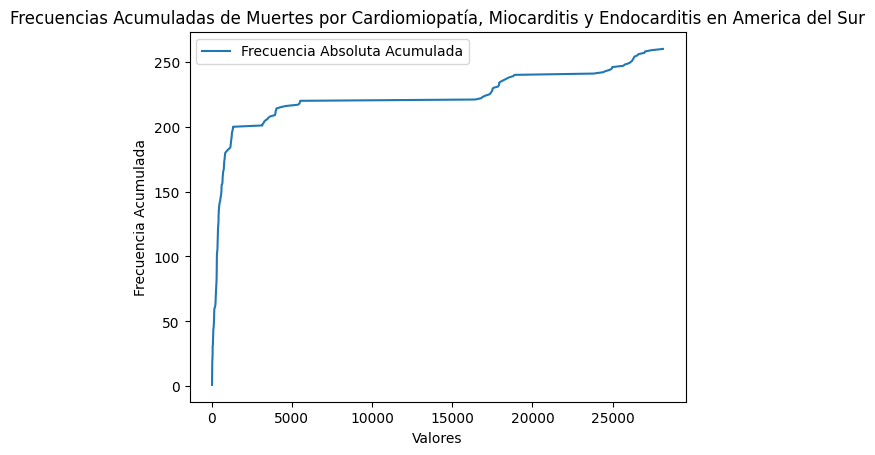

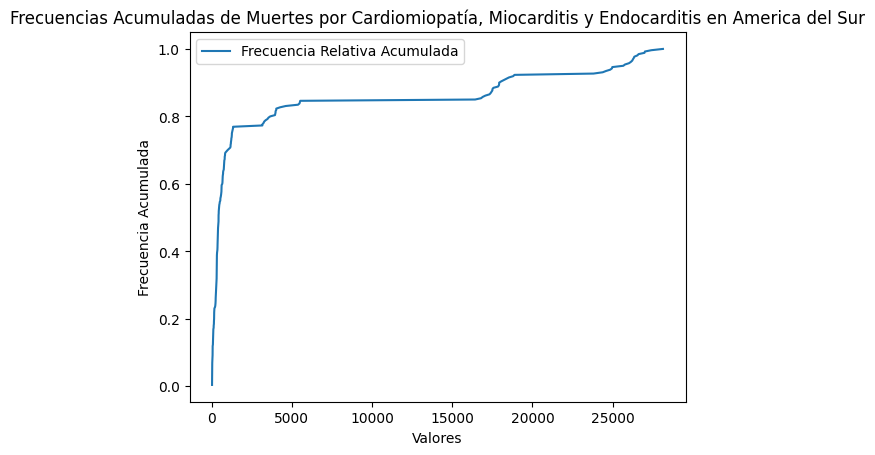

La Frecuencia Absoluta por Muertes por Enfermedades Circulatorias es:
 Deaths - Cause: Other circulatory diseases - Sex: Both sexes - Age group: ALLAges
39.040       1
42.550       1
43.990       1
44.420       1
44.730       1
            ..
71430.110    1
74907.460    1
76301.810    1
78637.980    1
79477.734    1
Name: count, Length: 260, dtype: int64
La Frecuencia Relativa por Muertes por Enfermedades Circulatorias es:
 Deaths - Cause: Other circulatory diseases - Sex: Both sexes - Age group: ALLAges
39.040       0.003846
42.550       0.003846
43.990       0.003846
44.420       0.003846
44.730       0.003846
               ...   
71430.110    0.003846
74907.460    0.003846
76301.810    0.003846
78637.980    0.003846
79477.734    0.003846
Name: count, Length: 260, dtype: float64
La Frecuencia Absoluta Acumulada por Muertes por Enfermedades Circulatorias es:
 Deaths - Cause: Other circulatory diseases - Sex: Both sexes - Age group: ALLAges
39.040         1
42.550         2
43.990    

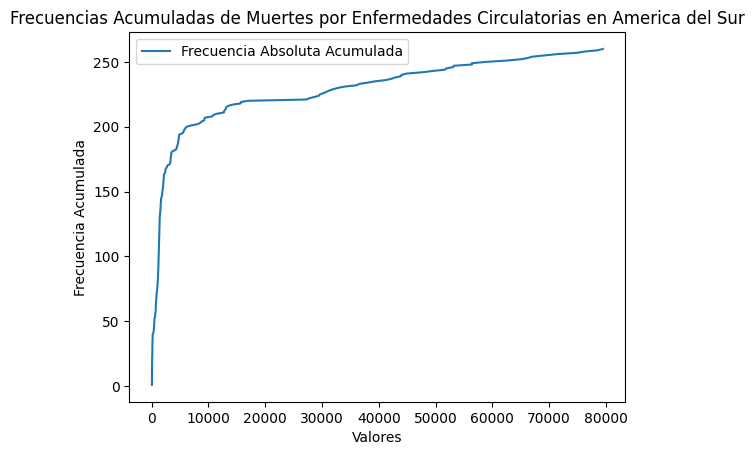

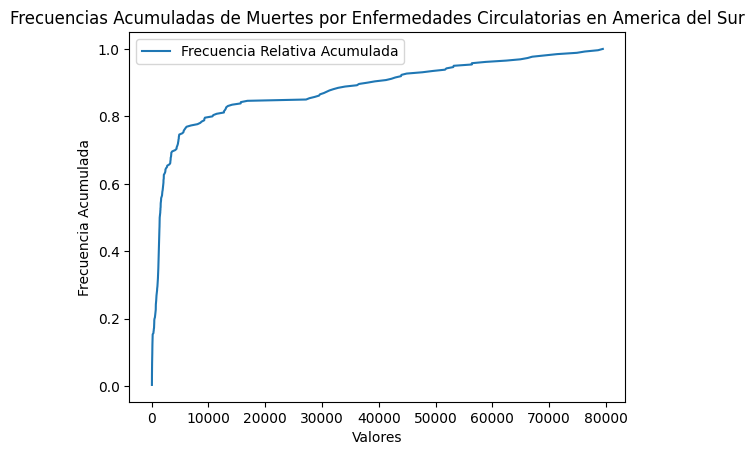

La Frecuencia Absoluta por Muertes por Enfermedad Cardíaca Hipertensiva es:
 Deaths - Cause: Hypertensive heart disease - Sex: Both sexes - Age group: ALLAges
70.750       1
75.000       1
77.250       1
77.940       1
77.950       1
            ..
51390.860    1
53653.867    1
57164.020    1
57523.770    1
57549.332    1
Name: count, Length: 260, dtype: int64
La Frecuencia Relativa por Muertes por Enfermedad Cardíaca Hipertensiva es:
 Deaths - Cause: Hypertensive heart disease - Sex: Both sexes - Age group: ALLAges
70.750       0.003846
75.000       0.003846
77.250       0.003846
77.940       0.003846
77.950       0.003846
               ...   
51390.860    0.003846
53653.867    0.003846
57164.020    0.003846
57523.770    0.003846
57549.332    0.003846
Name: count, Length: 260, dtype: float64
La Frecuencia Absoluta Acumulada por Muertes por Enfermedad Cardíaca Hipertensiva es:
 Deaths - Cause: Hypertensive heart disease - Sex: Both sexes - Age group: ALLAges
70.750         1
75.000   

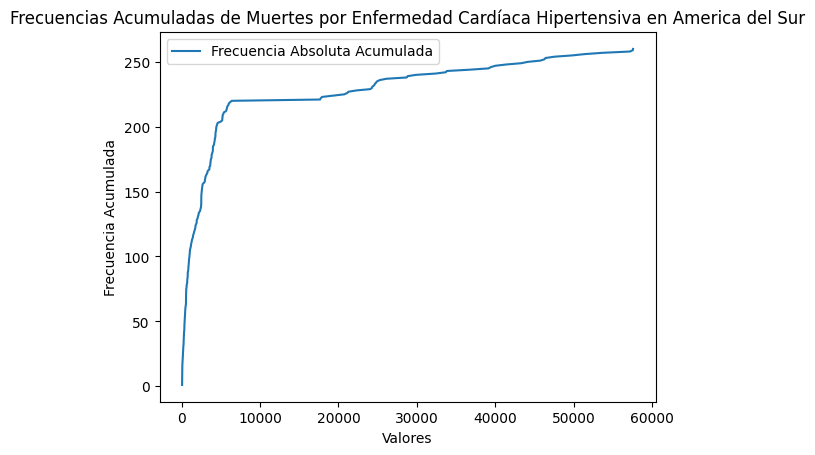

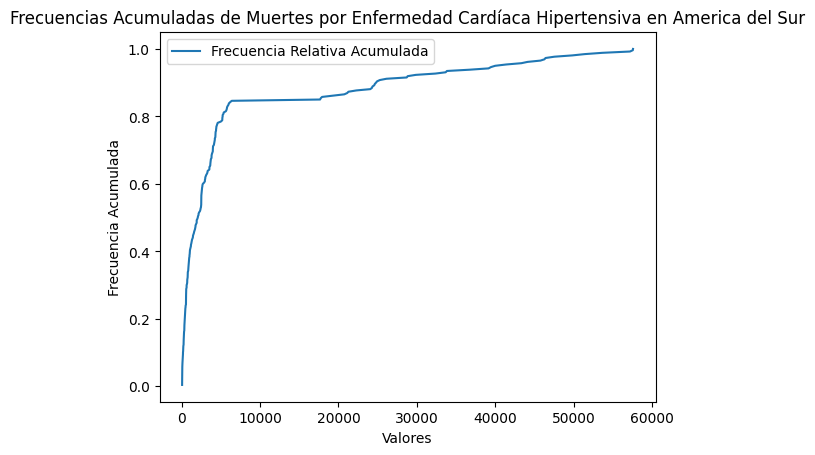

La Frecuencia Absoluta por Muertes por Ictus Isquémico es:
 Deaths - Cause: Ischaemic stroke - Sex: Both sexes - Age group: ALLAges
159.000       1
173.220       1
174.700       1
175.140       1
177.390       1
             ..
111461.516    1
112430.830    1
113697.450    1
113910.890    1
116831.370    1
Name: count, Length: 260, dtype: int64
La Frecuencia Relativa por Muertes por Ictus Isquémico es:
 Deaths - Cause: Ischaemic stroke - Sex: Both sexes - Age group: ALLAges
159.000       0.003846
173.220       0.003846
174.700       0.003846
175.140       0.003846
177.390       0.003846
                ...   
111461.516    0.003846
112430.830    0.003846
113697.450    0.003846
113910.890    0.003846
116831.370    0.003846
Name: count, Length: 260, dtype: float64
La Frecuencia Absoluta Acumulada por Muertes por Ictus Isquémico es:
 Deaths - Cause: Ischaemic stroke - Sex: Both sexes - Age group: ALLAges
159.000         1
173.220         2
174.700         3
175.140         4
177.390      

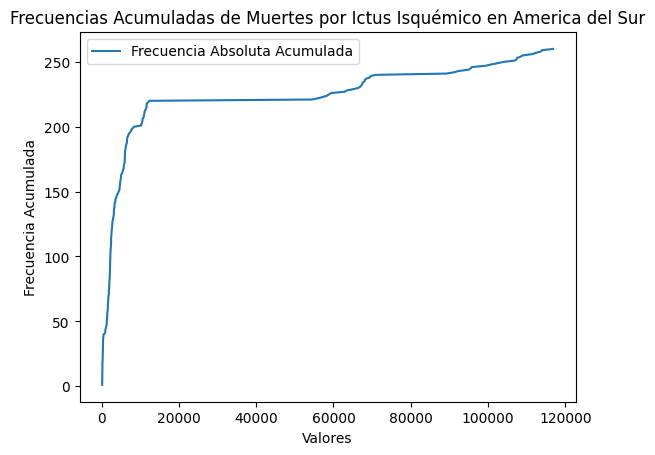

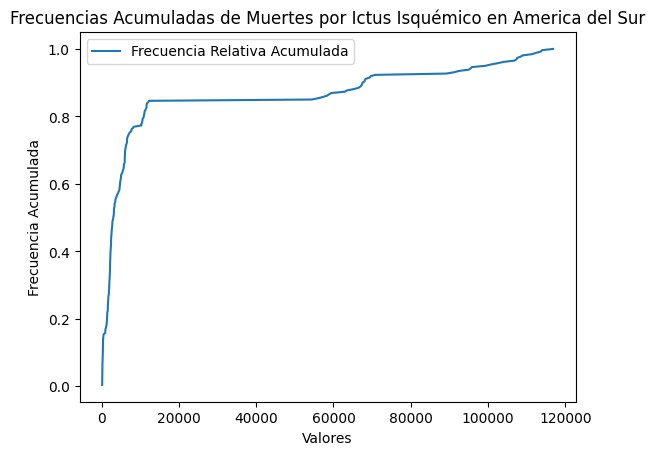

La Frecuencia Absoluta por Muertes por Ictus Hemorrágico es:
 Deaths - Cause: Haemorrhagic stroke - Sex: Both sexes - Age group: ALLAges
243.940      1
246.690      1
248.580      1
251.130      1
254.770      1
            ..
93601.140    1
94716.630    1
94762.350    1
95542.016    1
95568.690    1
Name: count, Length: 260, dtype: int64
La Frecuencia Relativa por Muertes por Ictus Hemorrágico es:
 Deaths - Cause: Haemorrhagic stroke - Sex: Both sexes - Age group: ALLAges
243.940      0.003846
246.690      0.003846
248.580      0.003846
251.130      0.003846
254.770      0.003846
               ...   
93601.140    0.003846
94716.630    0.003846
94762.350    0.003846
95542.016    0.003846
95568.690    0.003846
Name: count, Length: 260, dtype: float64
La Frecuencia Absoluta Acumulada por Muertes por Ictus Hemorrágico es:
 Deaths - Cause: Haemorrhagic stroke - Sex: Both sexes - Age group: ALLAges
243.940        1
246.690        2
248.580        3
251.130        4
254.770        5
       

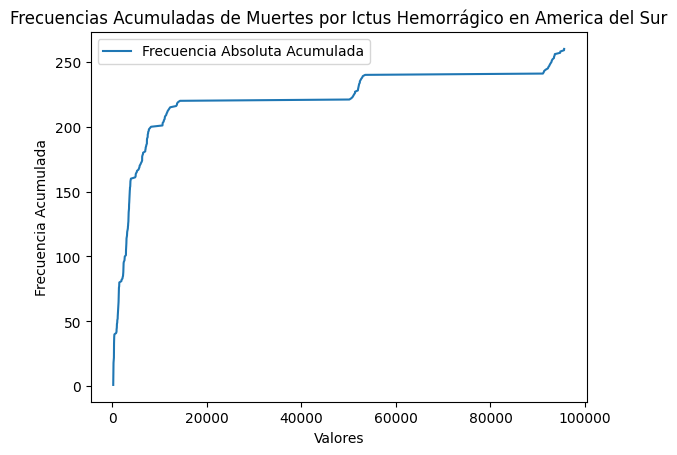

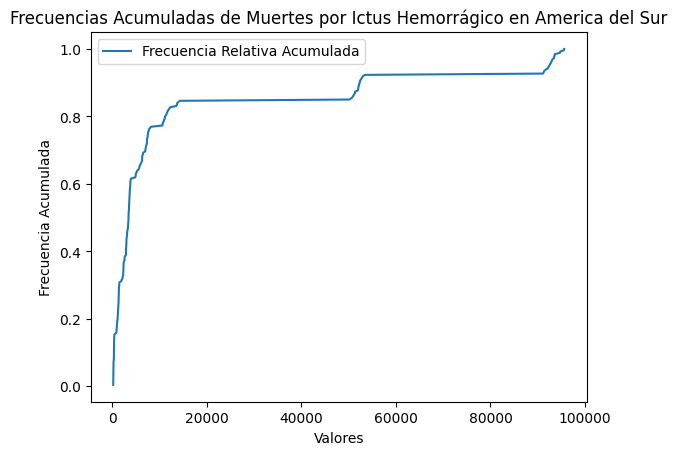

La Frecuencia Absoluta por Muertes por Enfermedad Cardíaca Isquémica es:
 Deaths - Cause: Ischaemic heart disease - Sex: Both sexes - Age group: ALLAges
383.98       1
401.88       1
401.98       1
402.35       1
403.00       1
            ..
319031.44    1
329473.50    1
332213.12    1
333533.47    1
340410.97    1
Name: count, Length: 260, dtype: int64
La Frecuencia Relativa por Muertes por Enfermedad Cardíaca Isquémica es:
 Deaths - Cause: Ischaemic heart disease - Sex: Both sexes - Age group: ALLAges
383.98       0.003846
401.88       0.003846
401.98       0.003846
402.35       0.003846
403.00       0.003846
               ...   
319031.44    0.003846
329473.50    0.003846
332213.12    0.003846
333533.47    0.003846
340410.97    0.003846
Name: count, Length: 260, dtype: float64
La Frecuencia Absoluta Acumulada por Muertes por Enfermedad Cardíaca Isquémica es:
 Deaths - Cause: Ischaemic heart disease - Sex: Both sexes - Age group: ALLAges
383.98         1
401.88         2
401.98    

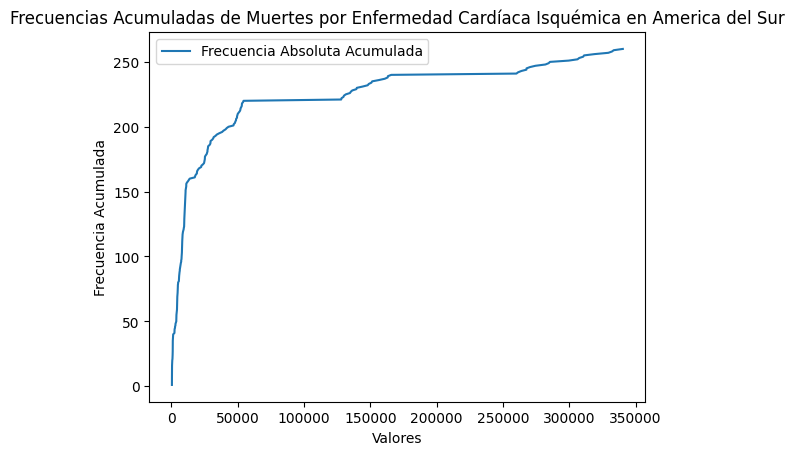

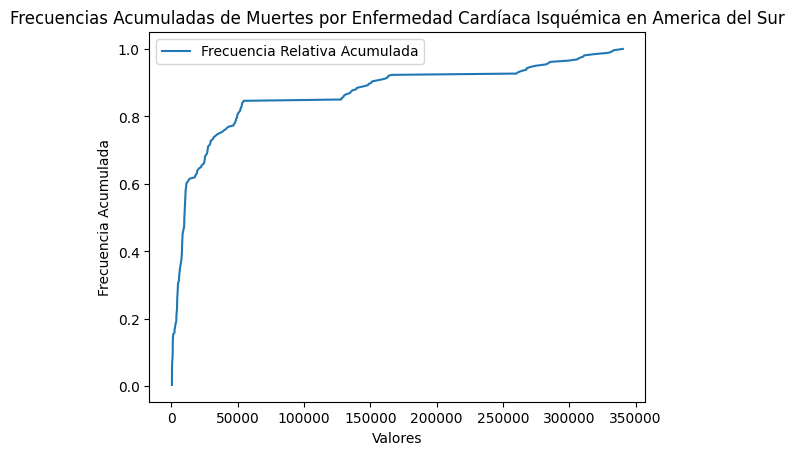

----------------------------------------------------------------------------------
Frecuencias Acumuladas de muertes por Enfermedades Cardiovasculares en Asia:
La Frecuencia Absoluta por Muertes por Enfermedad Cardíaca Reumática es:
 Deaths - Cause: Rheumatic heart disease - Sex: Both sexes - Age group: ALLAges
2.38         1
3.11         1
3.19         1
3.22         1
3.25         1
            ..
266637.30    1
272691.47    1
276988.28    1
279125.80    1
281037.22    1
Name: count, Length: 929, dtype: int64
La Frecuencia Relativa por Muertes por Enfermedad Cardíaca Reumática es:
 Deaths - Cause: Rheumatic heart disease - Sex: Both sexes - Age group: ALLAges
2.38         0.001064
3.11         0.001064
3.19         0.001064
3.22         0.001064
3.25         0.001064
               ...   
266637.30    0.001064
272691.47    0.001064
276988.28    0.001064
279125.80    0.001064
281037.22    0.001064
Name: count, Length: 929, dtype: float64
La Frecuencia Absoluta Acumulada por Muertes po

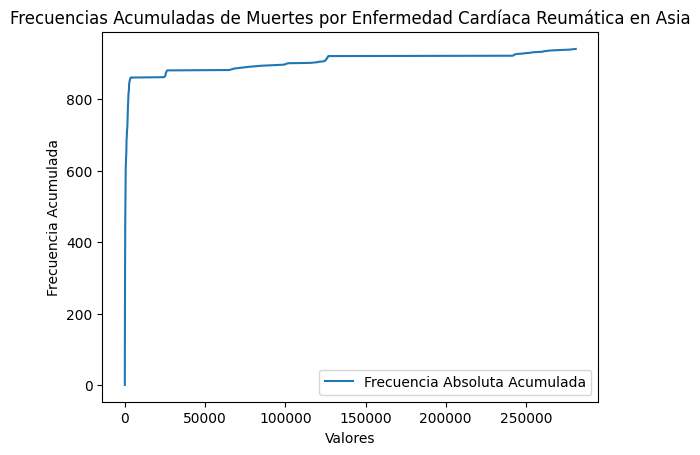

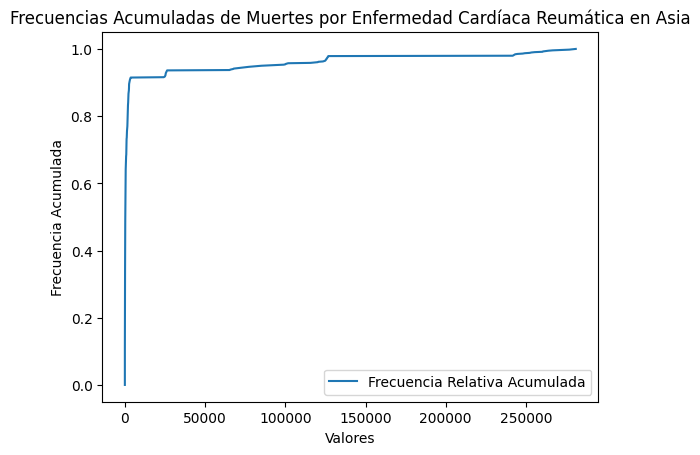

La Frecuencia Absoluta por Muertes por Cardiomiopatía, Miocarditis y Endocarditis es:
 Deaths - Cause: Cardiomyopathy, myocarditis, endocarditis - Sex: Both sexes - Age group: ALLAges
3.460        1
3.530        1
3.620        1
3.740        1
3.810        1
            ..
91913.340    1
93881.290    1
95387.130    1
96893.984    1
98310.586    1
Name: count, Length: 936, dtype: int64
La Frecuencia Relativa por Muertes por Cardiomiopatía, Miocarditis y Endocarditis es:
 Deaths - Cause: Cardiomyopathy, myocarditis, endocarditis - Sex: Both sexes - Age group: ALLAges
3.460        0.001064
3.530        0.001064
3.620        0.001064
3.740        0.001064
3.810        0.001064
               ...   
91913.340    0.001064
93881.290    0.001064
95387.130    0.001064
96893.984    0.001064
98310.586    0.001064
Name: count, Length: 936, dtype: float64
La Frecuencia Absoluta Acumulada por Muertes por Cardiomiopatía, Miocarditis y Endocarditis es:
 Deaths - Cause: Cardiomyopathy, myocarditis, end

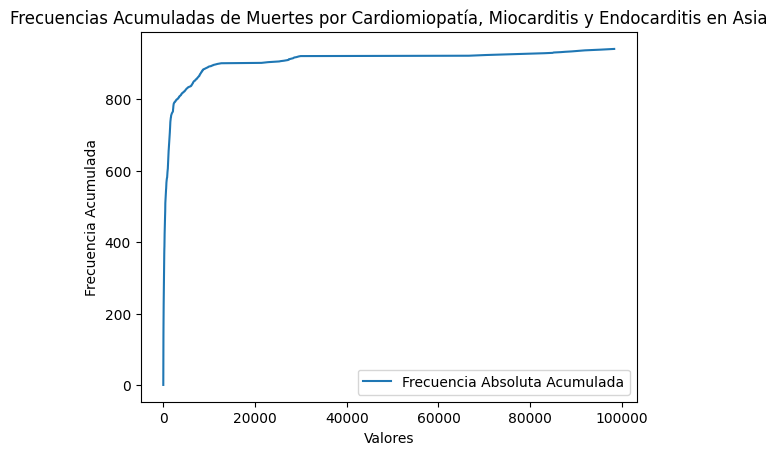

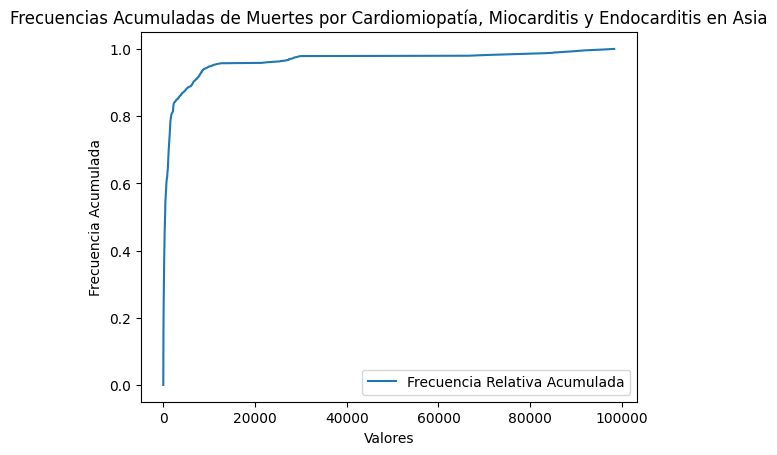

La Frecuencia Absoluta por Muertes por Enfermedades Circulatorias es:
 Deaths - Cause: Other circulatory diseases - Sex: Both sexes - Age group: ALLAges
14.65        1
15.01        1
15.14        1
16.58        1
16.94        1
            ..
327228.03    1
343853.56    1
360083.22    1
371115.75    1
379218.47    1
Name: count, Length: 938, dtype: int64
La Frecuencia Relativa por Muertes por Enfermedades Circulatorias es:
 Deaths - Cause: Other circulatory diseases - Sex: Both sexes - Age group: ALLAges
14.65        0.001064
15.01        0.001064
15.14        0.001064
16.58        0.001064
16.94        0.001064
               ...   
327228.03    0.001064
343853.56    0.001064
360083.22    0.001064
371115.75    0.001064
379218.47    0.001064
Name: count, Length: 938, dtype: float64
La Frecuencia Absoluta Acumulada por Muertes por Enfermedades Circulatorias es:
 Deaths - Cause: Other circulatory diseases - Sex: Both sexes - Age group: ALLAges
14.65          1
15.01          2
15.14     

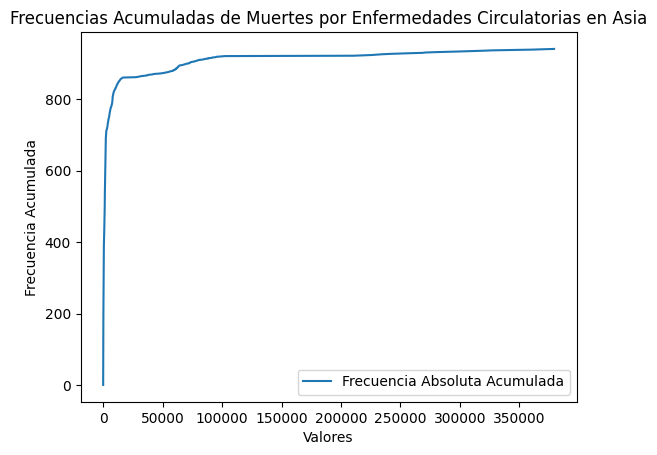

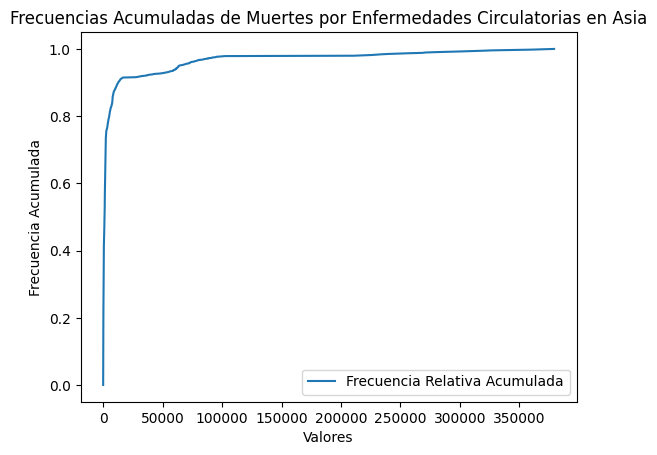

La Frecuencia Absoluta por Muertes por Enfermedad Cardíaca Hipertensiva es:
 Deaths - Cause: Hypertensive heart disease - Sex: Both sexes - Age group: ALLAges
9.49         1
9.69         1
9.99         1
10.55        1
10.64        1
            ..
597123.10    1
622403.56    1
640159.70    1
649710.44    1
658448.20    1
Name: count, Length: 938, dtype: int64
La Frecuencia Relativa por Muertes por Enfermedad Cardíaca Hipertensiva es:
 Deaths - Cause: Hypertensive heart disease - Sex: Both sexes - Age group: ALLAges
9.49         0.001064
9.69         0.001064
9.99         0.001064
10.55        0.001064
10.64        0.001064
               ...   
597123.10    0.001064
622403.56    0.001064
640159.70    0.001064
649710.44    0.001064
658448.20    0.001064
Name: count, Length: 938, dtype: float64
La Frecuencia Absoluta Acumulada por Muertes por Enfermedad Cardíaca Hipertensiva es:
 Deaths - Cause: Hypertensive heart disease - Sex: Both sexes - Age group: ALLAges
9.49           1
9.69     

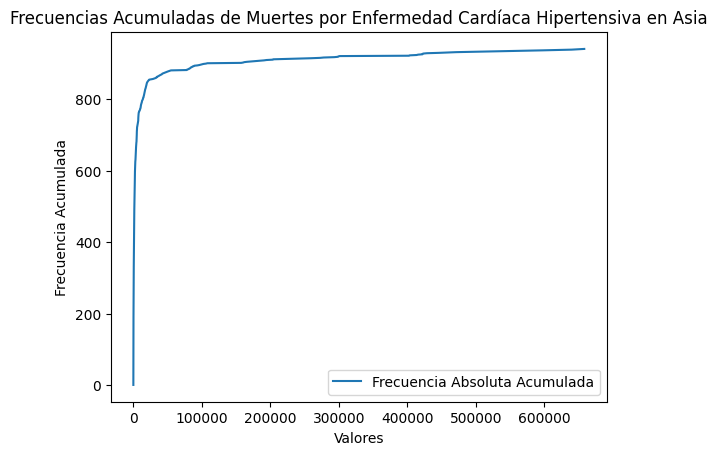

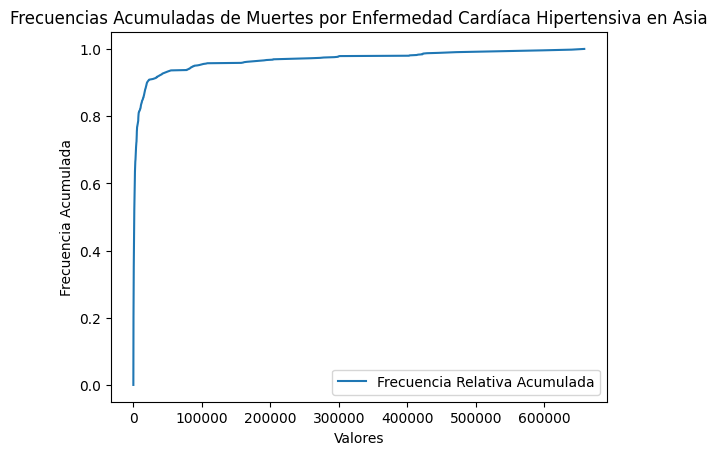

La Frecuencia Absoluta por Muertes por Ictus Isquémico es:
 Deaths - Cause: Ischaemic stroke - Sex: Both sexes - Age group: ALLAges
37.77         1
38.82         1
40.51         1
43.64         1
44.21         1
             ..
1689184.90    1
1755075.80    1
1817979.50    1
1869142.00    1
1917909.50    1
Name: count, Length: 939, dtype: int64
La Frecuencia Relativa por Muertes por Ictus Isquémico es:
 Deaths - Cause: Ischaemic stroke - Sex: Both sexes - Age group: ALLAges
37.77         0.001064
38.82         0.001064
40.51         0.001064
43.64         0.001064
44.21         0.001064
                ...   
1689184.90    0.001064
1755075.80    0.001064
1817979.50    0.001064
1869142.00    0.001064
1917909.50    0.001064
Name: count, Length: 939, dtype: float64
La Frecuencia Absoluta Acumulada por Muertes por Ictus Isquémico es:
 Deaths - Cause: Ischaemic stroke - Sex: Both sexes - Age group: ALLAges
37.77           1
38.82           2
40.51           3
43.64           4
44.21        

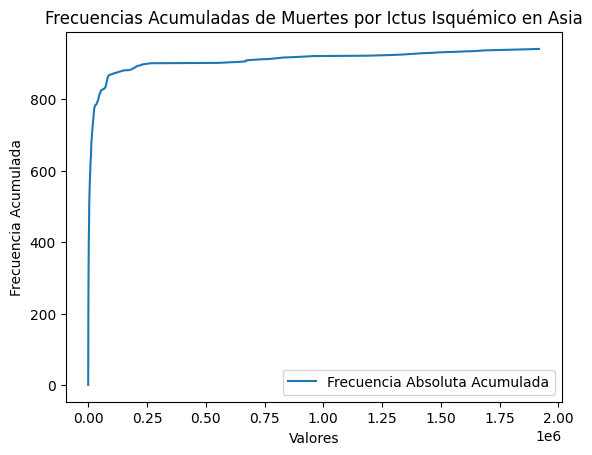

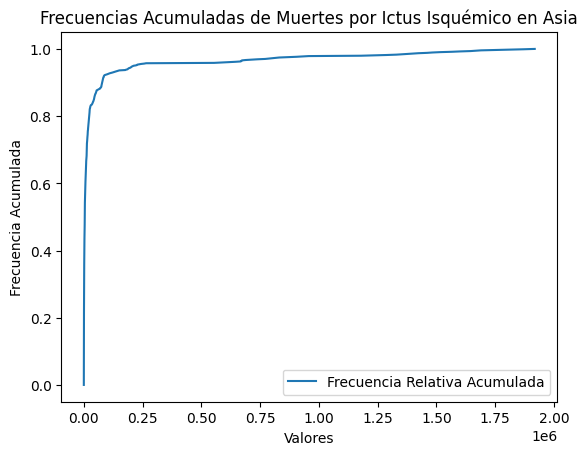

La Frecuencia Absoluta por Muertes por Ictus Hemorrágico es:
 Deaths - Cause: Haemorrhagic stroke - Sex: Both sexes - Age group: ALLAges
52.96         1
54.13         1
54.68         1
54.86         1
56.49         1
             ..
2281280.50    1
2284003.20    1
2288032.20    1
2297081.50    1
2330634.00    1
Name: count, Length: 939, dtype: int64
La Frecuencia Relativa por Muertes por Ictus Hemorrágico es:
 Deaths - Cause: Haemorrhagic stroke - Sex: Both sexes - Age group: ALLAges
52.96         0.001064
54.13         0.001064
54.68         0.001064
54.86         0.001064
56.49         0.001064
                ...   
2281280.50    0.001064
2284003.20    0.001064
2288032.20    0.001064
2297081.50    0.001064
2330634.00    0.001064
Name: count, Length: 939, dtype: float64
La Frecuencia Absoluta Acumulada por Muertes por Ictus Hemorrágico es:
 Deaths - Cause: Haemorrhagic stroke - Sex: Both sexes - Age group: ALLAges
52.96           1
54.13           2
54.68           3
54.86           

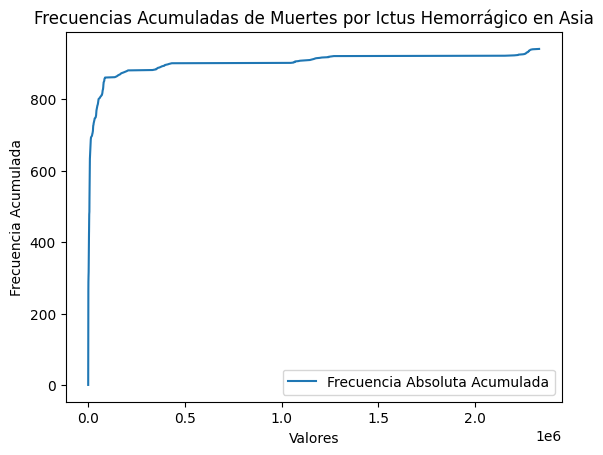

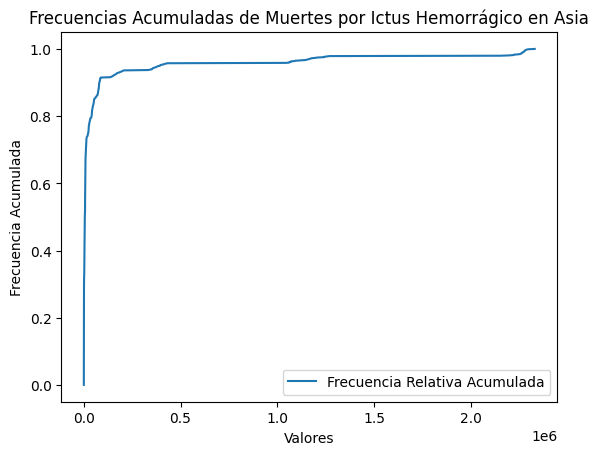

La Frecuencia Absoluta por Muertes por Enfermedad Cardíaca Isquémica es:
 Deaths - Cause: Ischaemic heart disease - Sex: Both sexes - Age group: ALLAges
171.95        1
184.02        1
202.40        1
202.80        1
203.36        1
             ..
4601395.00    1
4752694.00    1
4888440.50    1
5021420.50    1
5125233.50    1
Name: count, Length: 940, dtype: int64
La Frecuencia Relativa por Muertes por Enfermedad Cardíaca Isquémica es:
 Deaths - Cause: Ischaemic heart disease - Sex: Both sexes - Age group: ALLAges
171.95        0.001064
184.02        0.001064
202.40        0.001064
202.80        0.001064
203.36        0.001064
                ...   
4601395.00    0.001064
4752694.00    0.001064
4888440.50    0.001064
5021420.50    0.001064
5125233.50    0.001064
Name: count, Length: 940, dtype: float64
La Frecuencia Absoluta Acumulada por Muertes por Enfermedad Cardíaca Isquémica es:
 Deaths - Cause: Ischaemic heart disease - Sex: Both sexes - Age group: ALLAges
171.95          1
184.

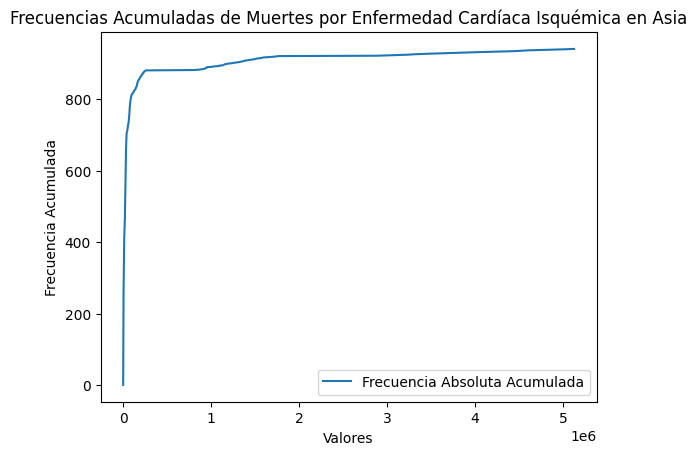

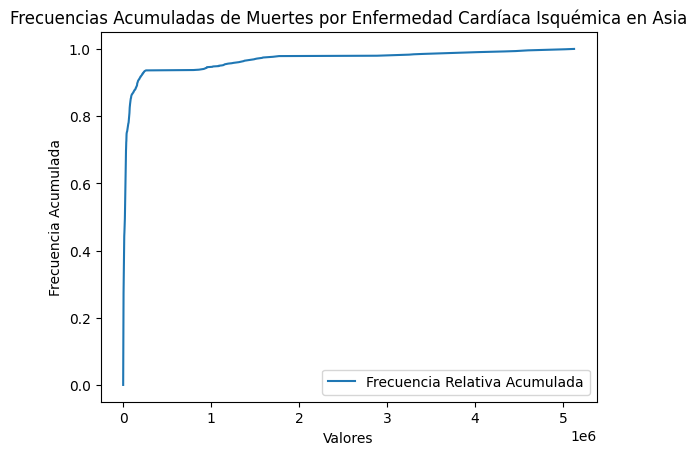

----------------------------------------------------------------------------------
Frecuencias Acumuladas de muertes por Enfermedades Cardiovasculares en Europa:
La Frecuencia Absoluta por Muertes por Enfermedad Cardíaca Reumática es:
 Deaths - Cause: Rheumatic heart disease - Sex: Both sexes - Age group: ALLAges
0.34        1
0.67        1
0.69        1
0.73        1
1.02        1
           ..
23340.59    1
24811.98    1
24997.32    1
25336.74    1
26909.65    1
Name: count, Length: 783, dtype: int64
La Frecuencia Relativa por Muertes por Enfermedad Cardíaca Reumática es:
 Deaths - Cause: Rheumatic heart disease - Sex: Both sexes - Age group: ALLAges
0.34        0.00125
0.67        0.00125
0.69        0.00125
0.73        0.00125
1.02        0.00125
             ...   
23340.59    0.00125
24811.98    0.00125
24997.32    0.00125
25336.74    0.00125
26909.65    0.00125
Name: count, Length: 783, dtype: float64
La Frecuencia Absoluta Acumulada por Muertes por Enfermedad Cardíaca Reumática

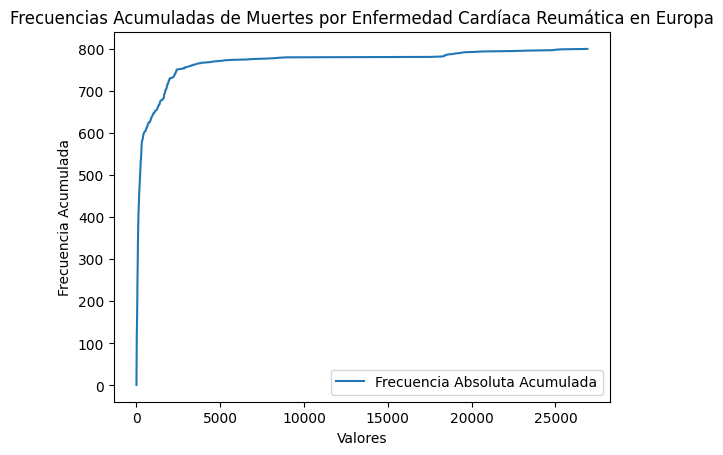

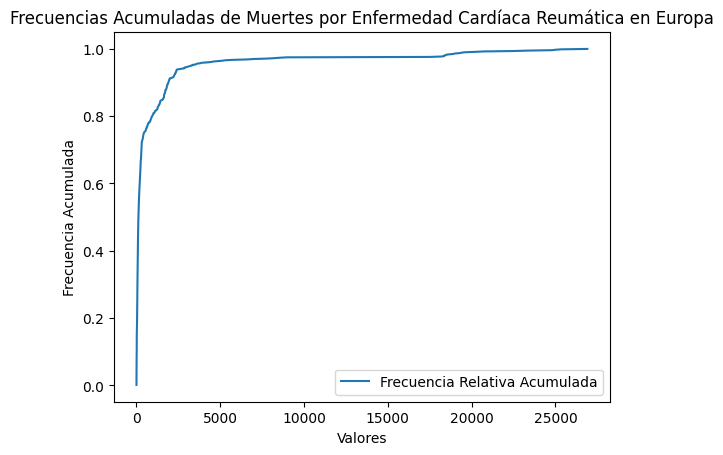

La Frecuencia Absoluta por Muertes por Cardiomiopatía, Miocarditis y Endocarditis es:
 Deaths - Cause: Cardiomyopathy, myocarditis, endocarditis - Sex: Both sexes - Age group: ALLAges
6.19         1
6.83         1
6.92         1
7.21         1
7.30         1
            ..
166977.55    1
171847.36    1
172127.72    1
172340.02    1
176270.03    1
Name: count, Length: 799, dtype: int64
La Frecuencia Relativa por Muertes por Cardiomiopatía, Miocarditis y Endocarditis es:
 Deaths - Cause: Cardiomyopathy, myocarditis, endocarditis - Sex: Both sexes - Age group: ALLAges
6.19         0.00125
6.83         0.00125
6.92         0.00125
7.21         0.00125
7.30         0.00125
              ...   
166977.55    0.00125
171847.36    0.00125
172127.72    0.00125
172340.02    0.00125
176270.03    0.00125
Name: count, Length: 799, dtype: float64
La Frecuencia Absoluta Acumulada por Muertes por Cardiomiopatía, Miocarditis y Endocarditis es:
 Deaths - Cause: Cardiomyopathy, myocarditis, endocarditis -

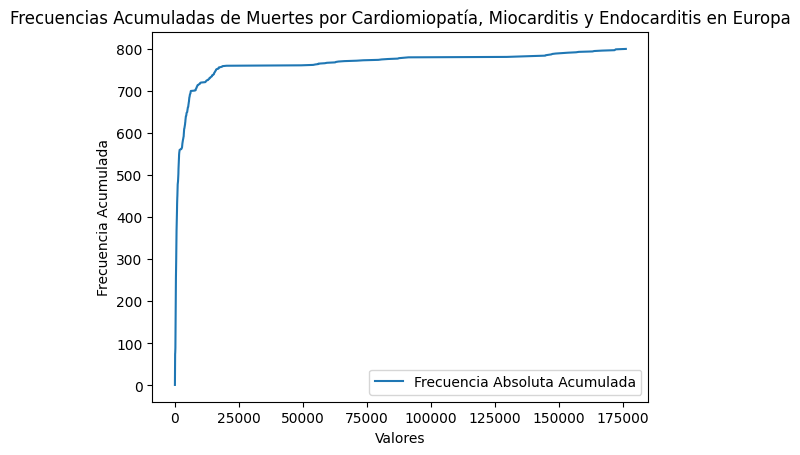

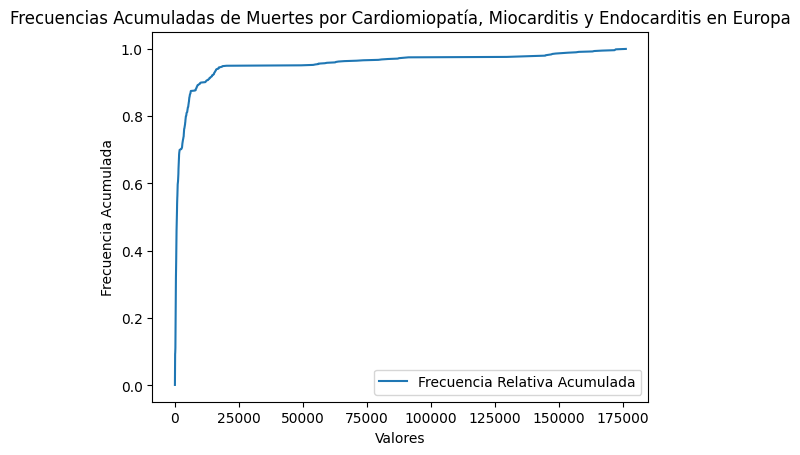

La Frecuencia Absoluta por Muertes por Enfermedades Circulatorias es:
 Deaths - Cause: Other circulatory diseases - Sex: Both sexes - Age group: ALLAges
53.46        1
55.33        1
56.65        1
61.20        1
68.59        1
            ..
304621.84    1
315382.03    1
319021.90    1
325365.20    1
325785.25    1
Name: count, Length: 797, dtype: int64
La Frecuencia Relativa por Muertes por Enfermedades Circulatorias es:
 Deaths - Cause: Other circulatory diseases - Sex: Both sexes - Age group: ALLAges
53.46        0.00125
55.33        0.00125
56.65        0.00125
61.20        0.00125
68.59        0.00125
              ...   
304621.84    0.00125
315382.03    0.00125
319021.90    0.00125
325365.20    0.00125
325785.25    0.00125
Name: count, Length: 797, dtype: float64
La Frecuencia Absoluta Acumulada por Muertes por Enfermedades Circulatorias es:
 Deaths - Cause: Other circulatory diseases - Sex: Both sexes - Age group: ALLAges
53.46          1
55.33          2
56.65          3
61.2

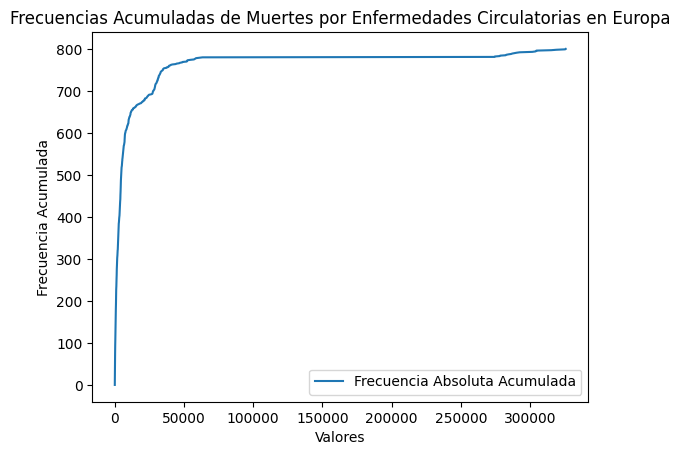

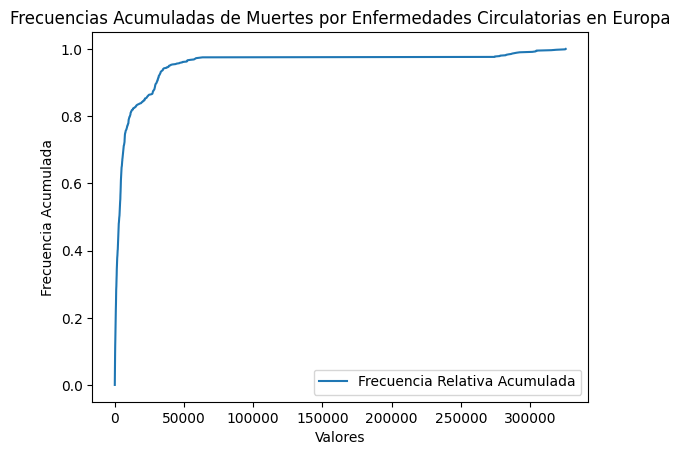

La Frecuencia Absoluta por Muertes por Enfermedad Cardíaca Hipertensiva es:
 Deaths - Cause: Hypertensive heart disease - Sex: Both sexes - Age group: ALLAges
12.46        1
13.31        1
13.50        1
14.49        1
15.09        1
            ..
160819.80    1
168651.89    1
170222.22    1
175557.06    1
176734.75    1
Name: count, Length: 799, dtype: int64
La Frecuencia Relativa por Muertes por Enfermedad Cardíaca Hipertensiva es:
 Deaths - Cause: Hypertensive heart disease - Sex: Both sexes - Age group: ALLAges
12.46        0.00125
13.31        0.00125
13.50        0.00125
14.49        0.00125
15.09        0.00125
              ...   
160819.80    0.00125
168651.89    0.00125
170222.22    0.00125
175557.06    0.00125
176734.75    0.00125
Name: count, Length: 799, dtype: float64
La Frecuencia Absoluta Acumulada por Muertes por Enfermedad Cardíaca Hipertensiva es:
 Deaths - Cause: Hypertensive heart disease - Sex: Both sexes - Age group: ALLAges
12.46          1
13.31          2
13.

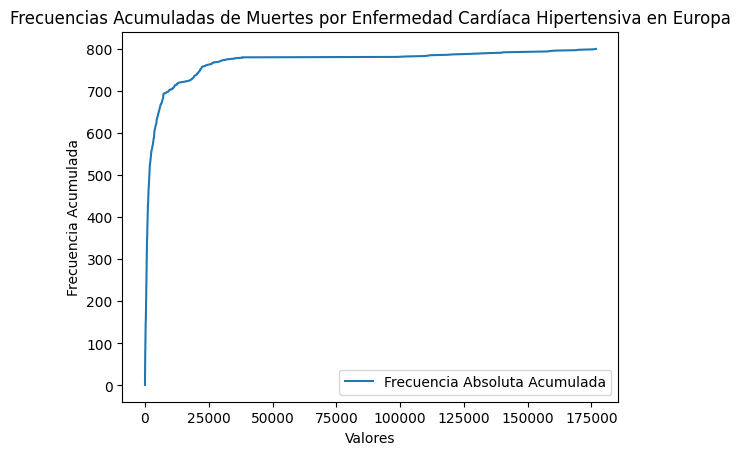

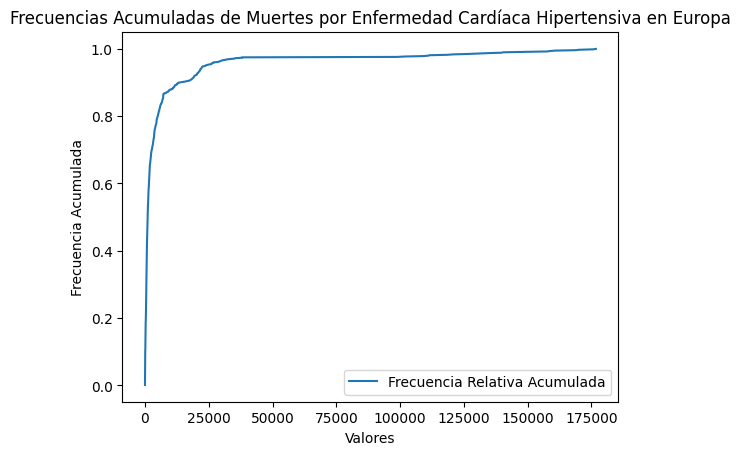

La Frecuencia Absoluta por Muertes por Ictus Isquémico es:
 Deaths - Cause: Ischaemic stroke - Sex: Both sexes - Age group: ALLAges
90.46        1
92.35        1
93.40        1
93.75        1
94.13        1
            ..
875105.30    1
910014.50    1
913928.06    1
928153.30    1
940375.40    1
Name: count, Length: 799, dtype: int64
La Frecuencia Relativa por Muertes por Ictus Isquémico es:
 Deaths - Cause: Ischaemic stroke - Sex: Both sexes - Age group: ALLAges
90.46        0.00125
92.35        0.00125
93.40        0.00125
93.75        0.00125
94.13        0.00125
              ...   
875105.30    0.00125
910014.50    0.00125
913928.06    0.00125
928153.30    0.00125
940375.40    0.00125
Name: count, Length: 799, dtype: float64
La Frecuencia Absoluta Acumulada por Muertes por Ictus Isquémico es:
 Deaths - Cause: Ischaemic stroke - Sex: Both sexes - Age group: ALLAges
90.46          1
92.35          2
93.40          3
93.75          4
94.13          5
            ... 
875105.30    796

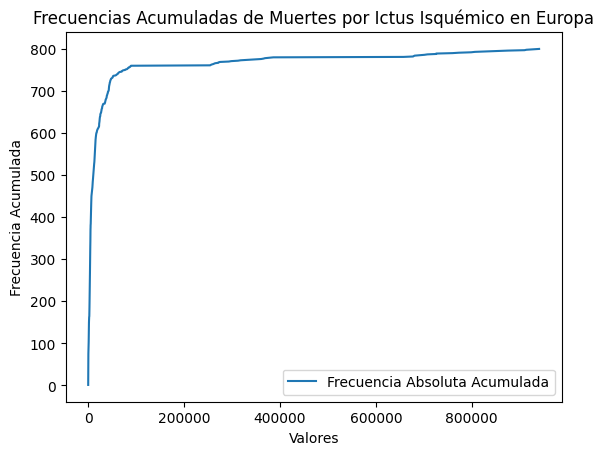

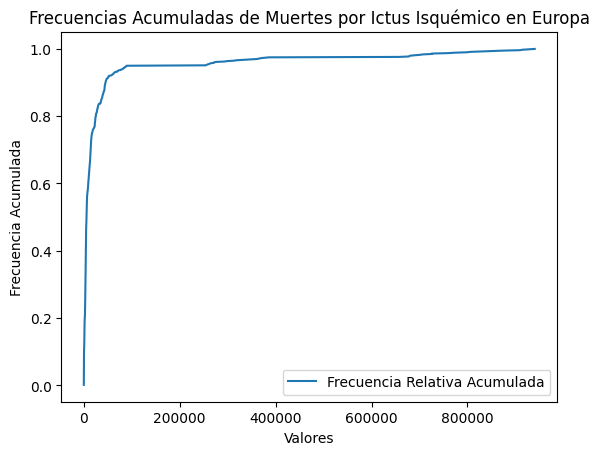

La Frecuencia Absoluta por Muertes por Ictus Hemorrágico es:
 Deaths - Cause: Haemorrhagic stroke - Sex: Both sexes - Age group: ALLAges
44.20        1
45.08        1
45.11        1
46.46        1
47.10        1
            ..
346032.97    1
356016.20    1
356654.03    1
362487.20    1
365019.06    1
Name: count, Length: 800, dtype: int64
La Frecuencia Relativa por Muertes por Ictus Hemorrágico es:
 Deaths - Cause: Haemorrhagic stroke - Sex: Both sexes - Age group: ALLAges
44.20        0.00125
45.08        0.00125
45.11        0.00125
46.46        0.00125
47.10        0.00125
              ...   
346032.97    0.00125
356016.20    0.00125
356654.03    0.00125
362487.20    0.00125
365019.06    0.00125
Name: count, Length: 800, dtype: float64
La Frecuencia Absoluta Acumulada por Muertes por Ictus Hemorrágico es:
 Deaths - Cause: Haemorrhagic stroke - Sex: Both sexes - Age group: ALLAges
44.20          1
45.08          2
45.11          3
46.46          4
47.10          5
            ... 
3

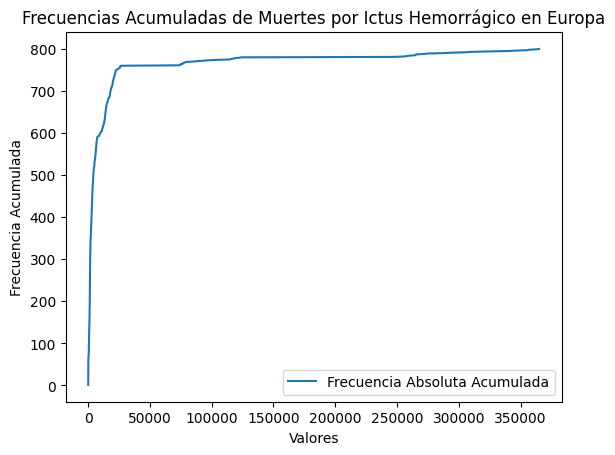

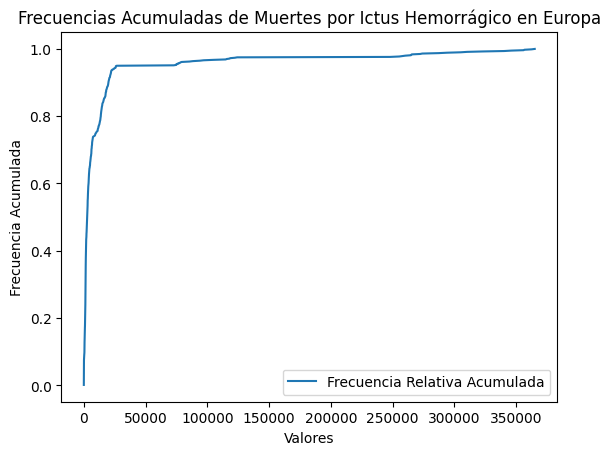

La Frecuencia Absoluta por Muertes por Enfermedad Cardíaca Isquémica es:
 Deaths - Cause: Ischaemic heart disease - Sex: Both sexes - Age group: ALLAges
403.43        1
403.83        1
414.61        1
417.13        1
423.04        1
             ..
2299962.00    1
2305014.80    1
2316179.80    1
2367026.00    1
2416414.50    1
Name: count, Length: 800, dtype: int64
La Frecuencia Relativa por Muertes por Enfermedad Cardíaca Isquémica es:
 Deaths - Cause: Ischaemic heart disease - Sex: Both sexes - Age group: ALLAges
403.43        0.00125
403.83        0.00125
414.61        0.00125
417.13        0.00125
423.04        0.00125
               ...   
2299962.00    0.00125
2305014.80    0.00125
2316179.80    0.00125
2367026.00    0.00125
2416414.50    0.00125
Name: count, Length: 800, dtype: float64
La Frecuencia Absoluta Acumulada por Muertes por Enfermedad Cardíaca Isquémica es:
 Deaths - Cause: Ischaemic heart disease - Sex: Both sexes - Age group: ALLAges
403.43          1
403.83         

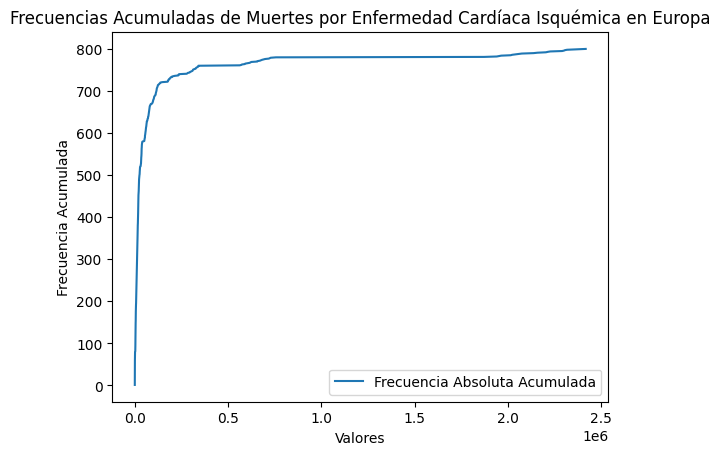

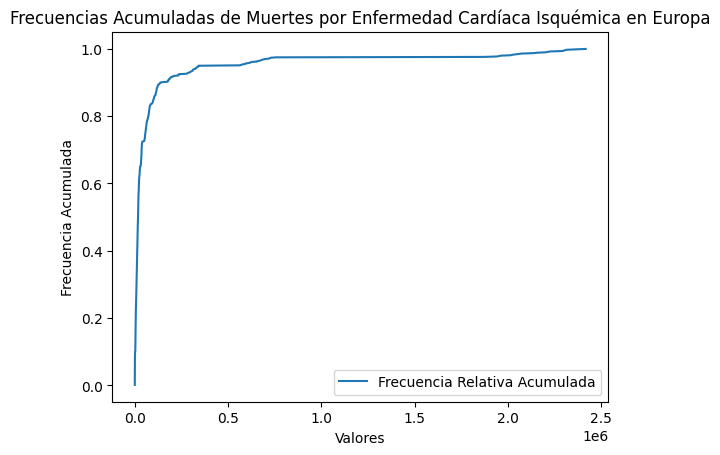

----------------------------------------------------------------------------------
Frecuencias Acumuladas de muertes por Enfermedades Cardiovasculares en Oceania:
La Frecuencia Absoluta por Muertes por Enfermedad Cardíaca Reumática es:
 Deaths - Cause: Rheumatic heart disease - Sex: Both sexes - Age group: ALLAges
2.1400       1
2.2500       1
2.3300       1
2.3400       1
2.4800       1
            ..
1724.2600    1
1734.3500    1
1745.1799    1
1764.5901    1
1767.6799    1
Name: count, Length: 214, dtype: int64
La Frecuencia Relativa por Muertes por Enfermedad Cardíaca Reumática es:
 Deaths - Cause: Rheumatic heart disease - Sex: Both sexes - Age group: ALLAges
2.1400       0.004545
2.2500       0.004545
2.3300       0.004545
2.3400       0.004545
2.4800       0.004545
               ...   
1724.2600    0.004545
1734.3500    0.004545
1745.1799    0.004545
1764.5901    0.004545
1767.6799    0.004545
Name: count, Length: 214, dtype: float64
La Frecuencia Absoluta Acumulada por Muertes

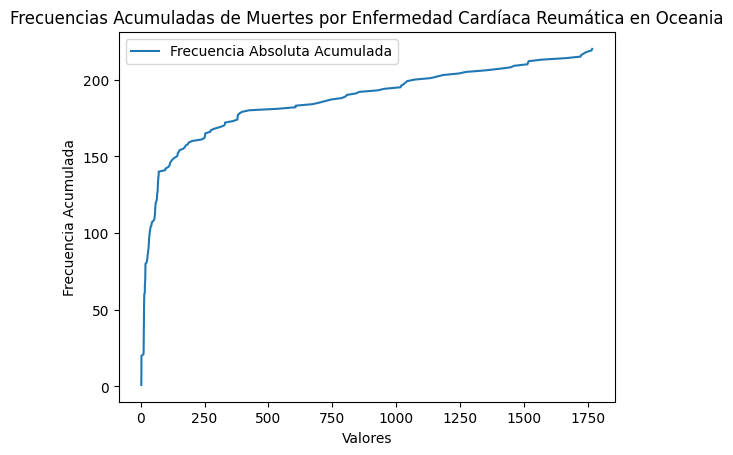

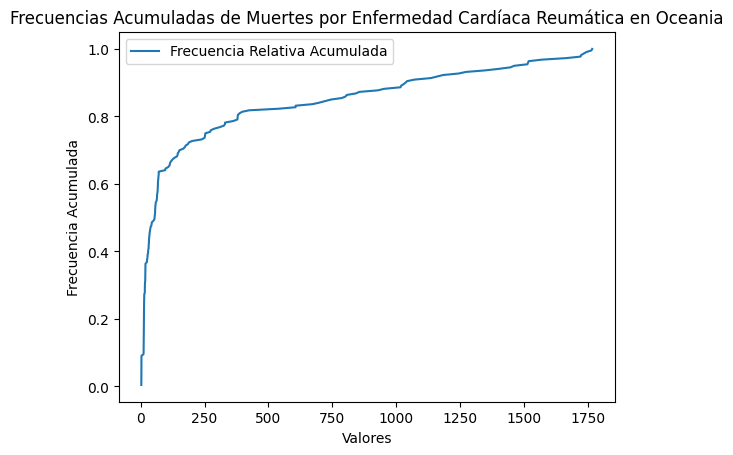

La Frecuencia Absoluta por Muertes por Cardiomiopatía, Miocarditis y Endocarditis es:
 Deaths - Cause: Cardiomyopathy, myocarditis, endocarditis - Sex: Both sexes - Age group: ALLAges
1.9100       1
1.9700       1
2.0100       2
2.0600       1
2.0800       1
            ..
2158.4200    1
2209.4700    1
2217.0200    1
2259.8198    1
2260.2600    1
Name: count, Length: 212, dtype: int64
La Frecuencia Relativa por Muertes por Cardiomiopatía, Miocarditis y Endocarditis es:
 Deaths - Cause: Cardiomyopathy, myocarditis, endocarditis - Sex: Both sexes - Age group: ALLAges
1.9100       0.004545
1.9700       0.004545
2.0100       0.009091
2.0600       0.004545
2.0800       0.004545
               ...   
2158.4200    0.004545
2209.4700    0.004545
2217.0200    0.004545
2259.8198    0.004545
2260.2600    0.004545
Name: count, Length: 212, dtype: float64
La Frecuencia Absoluta Acumulada por Muertes por Cardiomiopatía, Miocarditis y Endocarditis es:
 Deaths - Cause: Cardiomyopathy, myocarditis, end

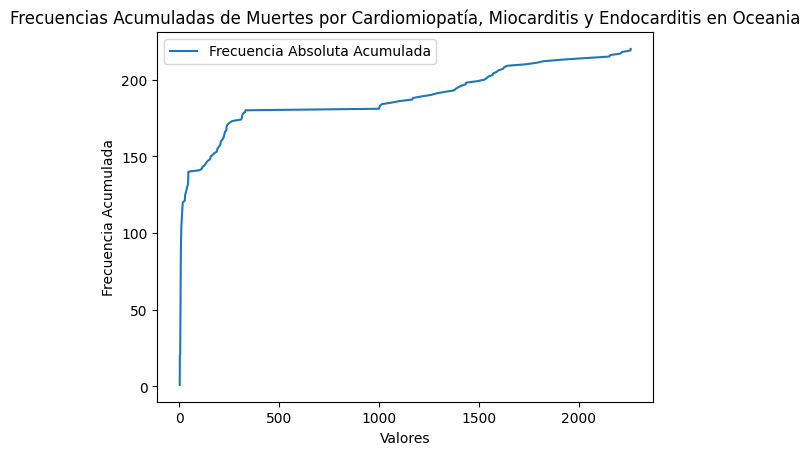

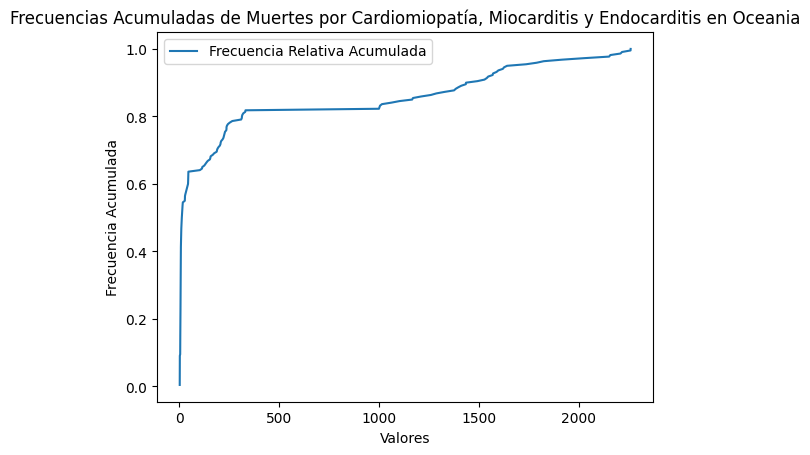

La Frecuencia Absoluta por Muertes por Enfermedades Circulatorias es:
 Deaths - Cause: Other circulatory diseases - Sex: Both sexes - Age group: ALLAges
6.580       2
6.720       1
6.770       1
6.860       1
6.940       1
           ..
9001.080    1
9172.710    1
9230.550    1
9283.910    1
9288.359    1
Name: count, Length: 216, dtype: int64
La Frecuencia Relativa por Muertes por Enfermedades Circulatorias es:
 Deaths - Cause: Other circulatory diseases - Sex: Both sexes - Age group: ALLAges
6.580       0.009091
6.720       0.004545
6.770       0.004545
6.860       0.004545
6.940       0.004545
              ...   
9001.080    0.004545
9172.710    0.004545
9230.550    0.004545
9283.910    0.004545
9288.359    0.004545
Name: count, Length: 216, dtype: float64
La Frecuencia Absoluta Acumulada por Muertes por Enfermedades Circulatorias es:
 Deaths - Cause: Other circulatory diseases - Sex: Both sexes - Age group: ALLAges
6.580         2
6.720         3
6.770         4
6.860         5
6.

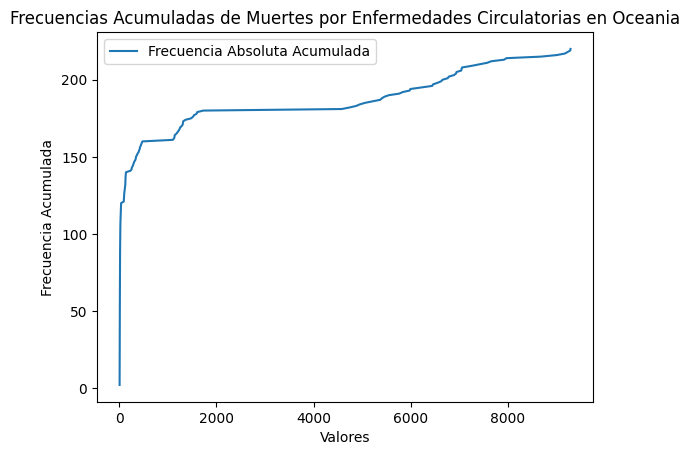

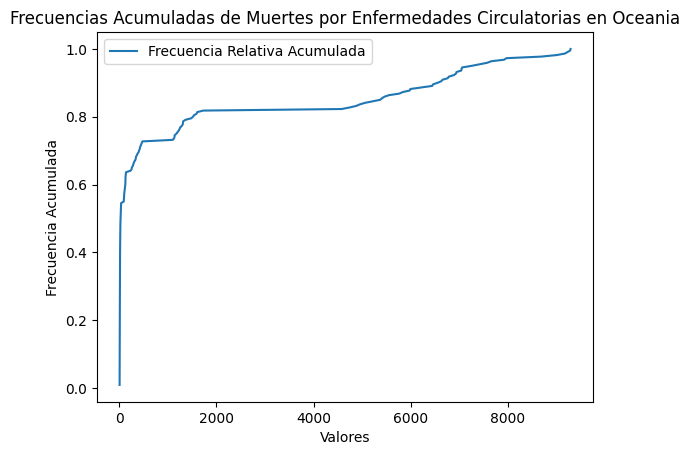

La Frecuencia Absoluta por Muertes por Enfermedad Cardíaca Hipertensiva es:
 Deaths - Cause: Hypertensive heart disease - Sex: Both sexes - Age group: ALLAges
4.9300       1
4.9600       1
5.0600       2
5.1100       1
5.1200       1
            ..
3339.2000    1
3371.0498    1
3422.6500    1
3448.7200    1
3514.5898    1
Name: count, Length: 216, dtype: int64
La Frecuencia Relativa por Muertes por Enfermedad Cardíaca Hipertensiva es:
 Deaths - Cause: Hypertensive heart disease - Sex: Both sexes - Age group: ALLAges
4.9300       0.004545
4.9600       0.004545
5.0600       0.009091
5.1100       0.004545
5.1200       0.004545
               ...   
3339.2000    0.004545
3371.0498    0.004545
3422.6500    0.004545
3448.7200    0.004545
3514.5898    0.004545
Name: count, Length: 216, dtype: float64
La Frecuencia Absoluta Acumulada por Muertes por Enfermedad Cardíaca Hipertensiva es:
 Deaths - Cause: Hypertensive heart disease - Sex: Both sexes - Age group: ALLAges
4.9300         1
4.9600   

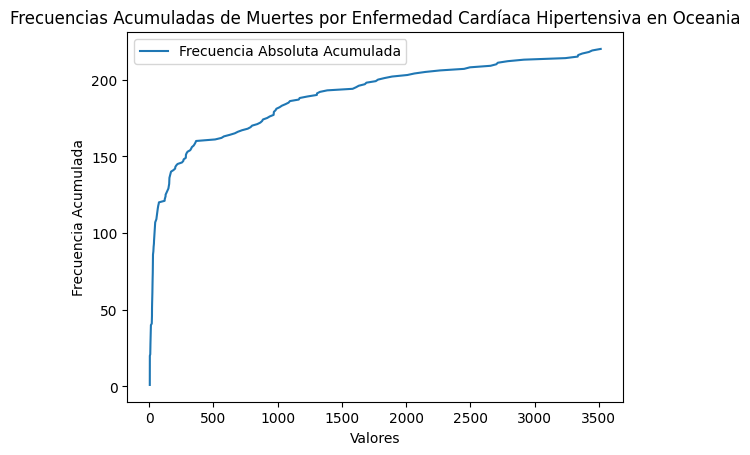

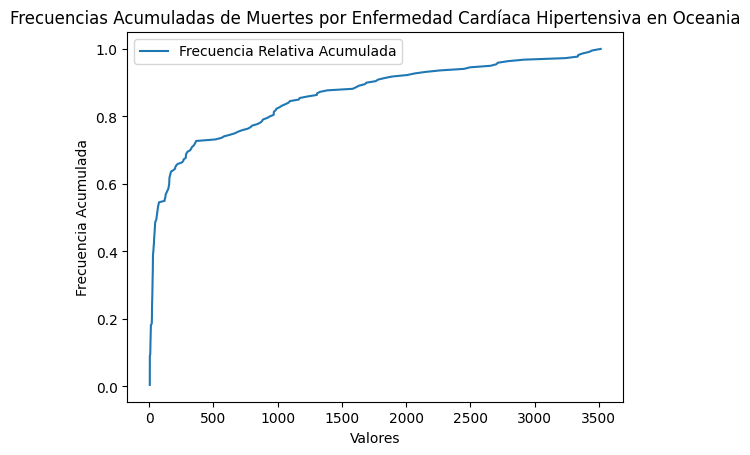

La Frecuencia Absoluta por Muertes por Ictus Isquémico es:
 Deaths - Cause: Ischaemic stroke - Sex: Both sexes - Age group: ALLAges
15.390       1
15.440       1
15.750       1
16.010       1
16.110       2
            ..
10922.420    1
10941.430    1
10976.090    1
10980.591    1
11172.591    1
Name: count, Length: 218, dtype: int64
La Frecuencia Relativa por Muertes por Ictus Isquémico es:
 Deaths - Cause: Ischaemic stroke - Sex: Both sexes - Age group: ALLAges
15.390       0.004545
15.440       0.004545
15.750       0.004545
16.010       0.004545
16.110       0.009091
               ...   
10922.420    0.004545
10941.430    0.004545
10976.090    0.004545
10980.591    0.004545
11172.591    0.004545
Name: count, Length: 218, dtype: float64
La Frecuencia Absoluta Acumulada por Muertes por Ictus Isquémico es:
 Deaths - Cause: Ischaemic stroke - Sex: Both sexes - Age group: ALLAges
15.390         1
15.440         2
15.750         3
16.010         4
16.110         6
            ... 
10922

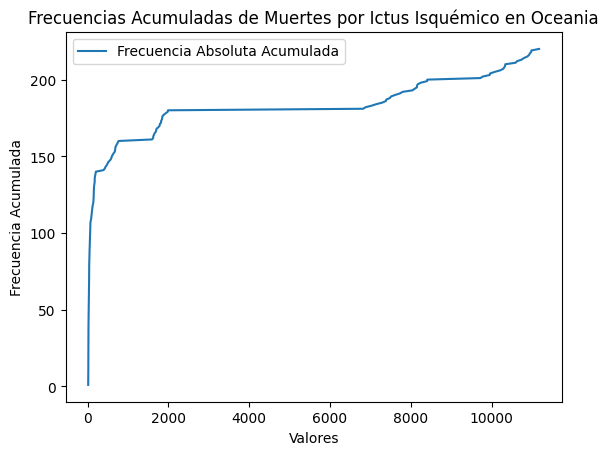

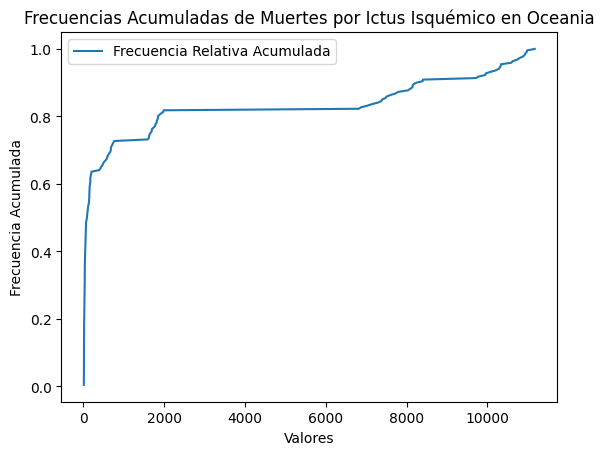

La Frecuencia Absoluta por Muertes por Ictus Hemorrágico es:
 Deaths - Cause: Haemorrhagic stroke - Sex: Both sexes - Age group: ALLAges
29.75       1
30.20       1
31.04       1
31.14       1
31.16       1
           ..
9836.74     1
9919.37     1
9923.87     1
9977.64     1
10107.84    1
Name: count, Length: 219, dtype: int64
La Frecuencia Relativa por Muertes por Ictus Hemorrágico es:
 Deaths - Cause: Haemorrhagic stroke - Sex: Both sexes - Age group: ALLAges
29.75       0.004545
30.20       0.004545
31.04       0.004545
31.14       0.004545
31.16       0.004545
              ...   
9836.74     0.004545
9919.37     0.004545
9923.87     0.004545
9977.64     0.004545
10107.84    0.004545
Name: count, Length: 219, dtype: float64
La Frecuencia Absoluta Acumulada por Muertes por Ictus Hemorrágico es:
 Deaths - Cause: Haemorrhagic stroke - Sex: Both sexes - Age group: ALLAges
29.75         1
30.20         2
31.04         3
31.14         4
31.16         5
           ... 
9836.74     216
99

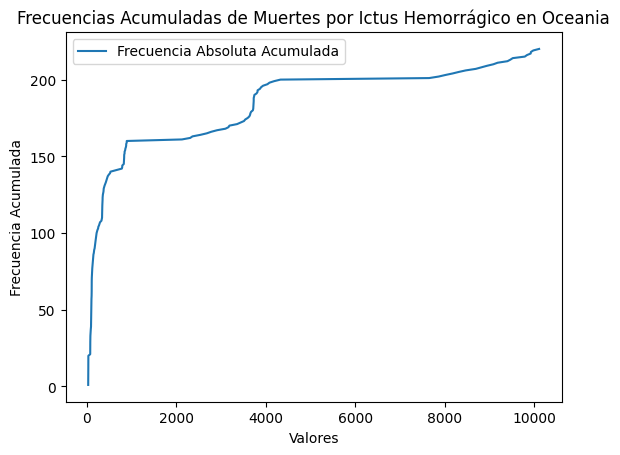

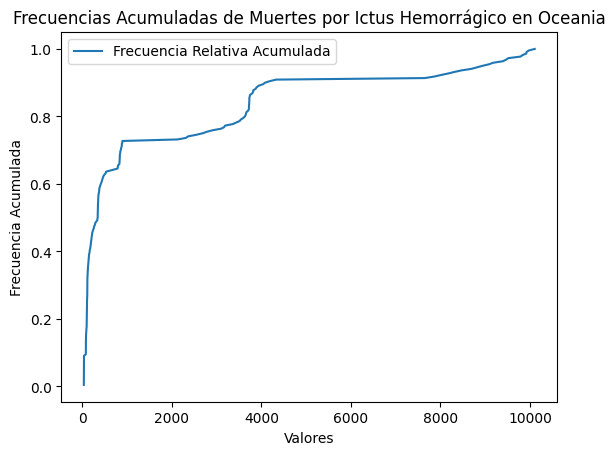

La Frecuencia Absoluta por Muertes por Enfermedad Cardíaca Isquémica es:
 Deaths - Cause: Ischaemic heart disease - Sex: Both sexes - Age group: ALLAges
75.770       1
77.500       1
78.790       1
79.220       1
80.130       1
            ..
39865.652    1
40163.850    1
40346.000    1
40530.190    1
40673.220    1
Name: count, Length: 220, dtype: int64
La Frecuencia Relativa por Muertes por Enfermedad Cardíaca Isquémica es:
 Deaths - Cause: Ischaemic heart disease - Sex: Both sexes - Age group: ALLAges
75.770       0.004545
77.500       0.004545
78.790       0.004545
79.220       0.004545
80.130       0.004545
               ...   
39865.652    0.004545
40163.850    0.004545
40346.000    0.004545
40530.190    0.004545
40673.220    0.004545
Name: count, Length: 220, dtype: float64
La Frecuencia Absoluta Acumulada por Muertes por Enfermedad Cardíaca Isquémica es:
 Deaths - Cause: Ischaemic heart disease - Sex: Both sexes - Age group: ALLAges
75.770         1
77.500         2
78.790    

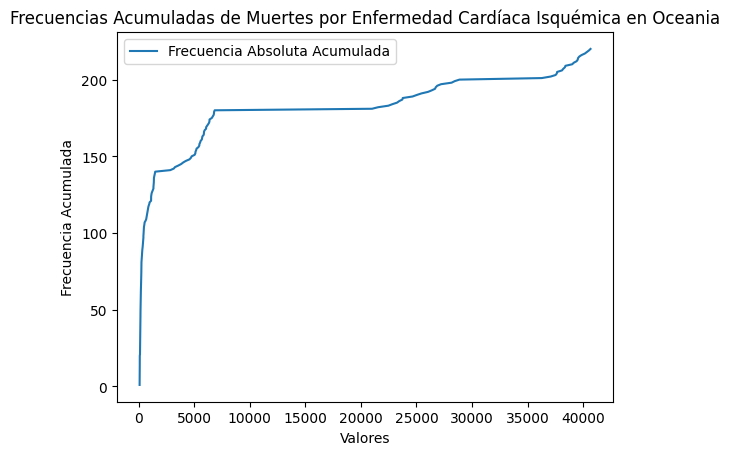

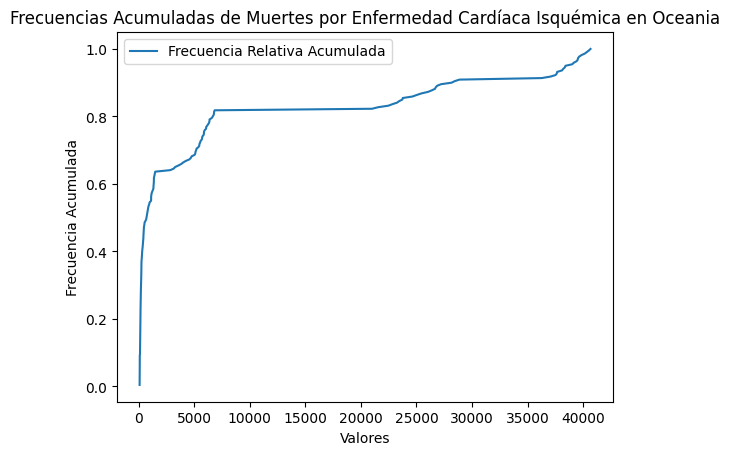

----------------------------------------------------------------------------------


In [ ]:
resultados = []
def calcular_frecuencia_absoluta(data):
    return data.value_counts().sort_index()

import matplotlib.pyplot as plt

# Iterar sobre los resultados
for continente, paises in continentes.items():
    df_continente = df[df['Entity'].isin(paises)]
    print(f"Frecuencias Acumuladas de muertes por Enfermedades Cardiovasculares en {continente}:")

    for patologia in patologias:
        data_patologia = df_continente[patologia]
        Fabs = calcular_frecuencia_absoluta(data_patologia)
        Frel = Fabs / Fabs.sum()
        Fabs_acum = Fabs.cumsum()
        Frel_acum = Frel.cumsum()
        patologia_legible = reemplazar_texto(patologia)

        print(f"La Frecuencia Absoluta por {patologia_legible} es:\n {Fabs}")
        print(f"La Frecuencia Relativa por {patologia_legible} es:\n {Frel}")
        print(f"La Frecuencia Absoluta Acumulada por {patologia_legible} es:\n {Fabs_acum}")
        print(f"La Frecuencia Relativa Acumulada por {patologia_legible} es:\n {Frel_acum}")

        resultados.append({
            'Continente': continente,
            'Patologia': patologia_legible,
            'Frecuencia Absoluta': Fabs,
            'Frecuencia Absoluta Acumulada': Fabs_acum
        })
        # Crear una nueva figura para cada combinación de enfermedad y continente
        plt.figure()
        plt.plot(Fabs_acum.index, Fabs_acum.values, label='Frecuencia Absoluta Acumulada')
        plt.title(f'Frecuencias Acumuladas de {patologia_legible} en {continente}')
        plt.xlabel('Valores')
        plt.ylabel('Frecuencia Acumulada')
        plt.legend()
        plt.show()

        # Crear una nueva figura para cada combinación de enfermedad y continente
        plt.figure()
        plt.plot(Frel_acum.index, Frel_acum.values, label='Frecuencia Relativa Acumulada')
        plt.title(f'Frecuencias Acumuladas de {patologia_legible} en {continente}')
        plt.xlabel('Valores')
        plt.ylabel('Frecuencia Acumulada')
        plt.legend()
        plt.show()

    print("----------------------------------------------------------------------------------")



### Frecuencias absolutas relativas

### Frecuencia sobreviviente

Frecuencias Acumuladas de muertes por Enfermedades Cardiovasculares en Africa:
La Frecuencia Absoluta Complementaria por Muertes por Enfermedad Cardíaca Reumática es:
 Deaths - Cause: Rheumatic heart disease - Sex: Both sexes - Age group: ALLAges
-0.157618    1079
-0.157618    1078
-0.157618    1077
-0.157617    1078
-0.157617    1079
             ... 
 0.473235    1079
 0.481850    1079
 0.491386    1079
 0.501861    1079
 0.511997    1079
Name: count, Length: 1051, dtype: int64
La Frecuencia Relativa Complementaria por Muertes por Enfermedad Cardíaca Reumática es:
 Deaths - Cause: Rheumatic heart disease - Sex: Both sexes - Age group: ALLAges
-0.157618    9.990741e-01
-0.157618    9.972222e-01
-0.157618    9.944444e-01
-0.157617    9.925926e-01
-0.157617    9.916667e-01
                 ...     
 0.473235    3.703704e-03
 0.481850    2.777778e-03
 0.491386    1.851852e-03
 0.501861    9.259259e-04
 0.511997    1.898481e-14
Name: count, Length: 1051, dtype: float64


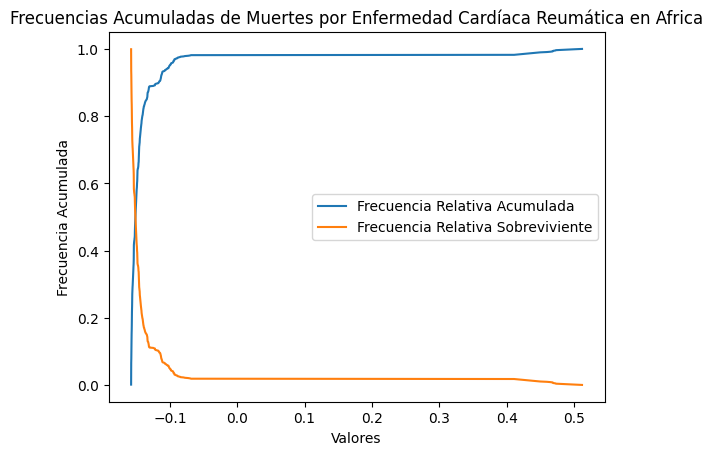

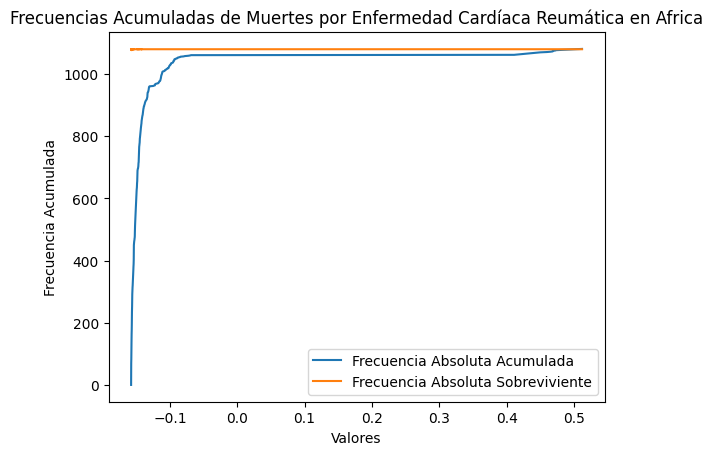

La Frecuencia Absoluta Complementaria por Muertes por Cardiomiopatía, Miocarditis y Endocarditis es:
 Deaths - Cause: Cardiomyopathy, myocarditis, endocarditis - Sex: Both sexes - Age group: ALLAges
-0.189132    1079
-0.189125    1079
-0.189120    1079
-0.189113    1079
-0.189109    1079
             ... 
 1.191213    1079
 1.218023    1079
 1.239759    1079
 1.262845    1079
 1.280285    1079
Name: count, Length: 1070, dtype: int64
La Frecuencia Relativa Complementaria por Muertes por Cardiomiopatía, Miocarditis y Endocarditis es:
 Deaths - Cause: Cardiomyopathy, myocarditis, endocarditis - Sex: Both sexes - Age group: ALLAges
-0.189132    9.990741e-01
-0.189125    9.981481e-01
-0.189120    9.972222e-01
-0.189113    9.962963e-01
-0.189109    9.953704e-01
                 ...     
 1.191213    3.703704e-03
 1.218023    2.777778e-03
 1.239759    1.851852e-03
 1.262845    9.259259e-04
 1.280285    1.920686e-14
Name: count, Length: 1070, dtype: float64


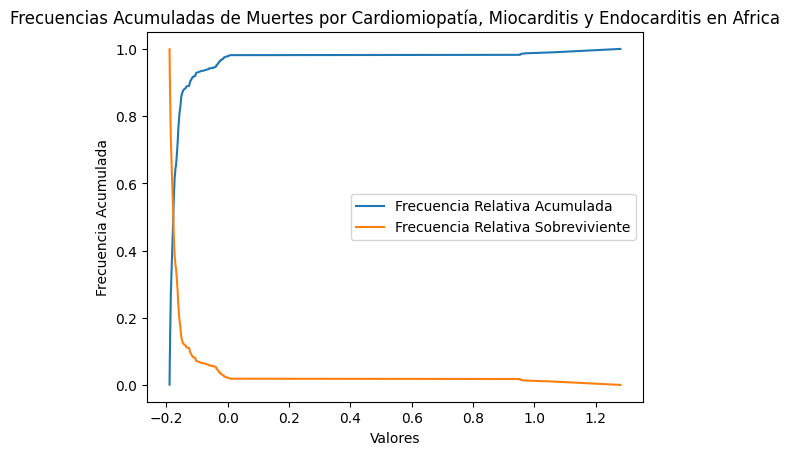

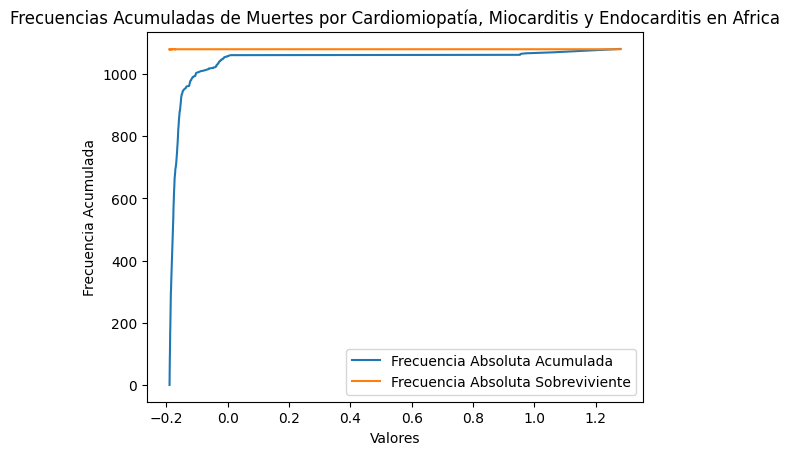

La Frecuencia Absoluta Complementaria por Muertes por Enfermedades Circulatorias es:
 Deaths - Cause: Other circulatory diseases - Sex: Both sexes - Age group: ALLAges
-0.191609    1079
-0.191607    1079
-0.191603    1079
-0.191597    1079
-0.191595    1079
             ... 
 0.955555    1079
 0.983218    1079
 1.007231    1079
 1.033750    1079
 1.055372    1079
Name: count, Length: 1077, dtype: int64
La Frecuencia Relativa Complementaria por Muertes por Enfermedades Circulatorias es:
 Deaths - Cause: Other circulatory diseases - Sex: Both sexes - Age group: ALLAges
-0.191609    9.990741e-01
-0.191607    9.981481e-01
-0.191603    9.972222e-01
-0.191597    9.962963e-01
-0.191595    9.953704e-01
                 ...     
 0.955555    3.703704e-03
 0.983218    2.777778e-03
 1.007231    1.851852e-03
 1.033750    9.259259e-04
 1.055372    1.920686e-14
Name: count, Length: 1077, dtype: float64


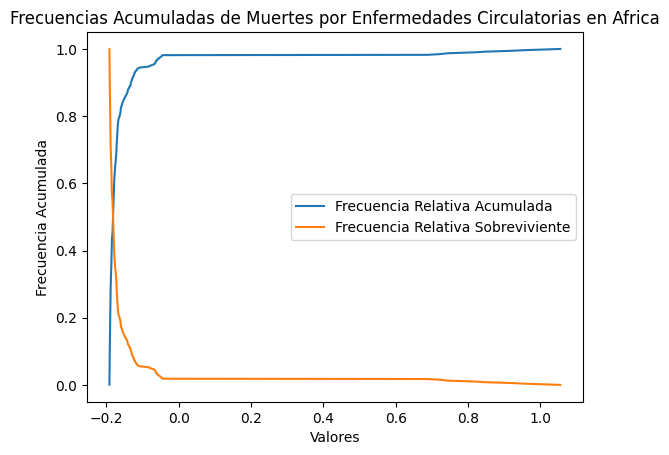

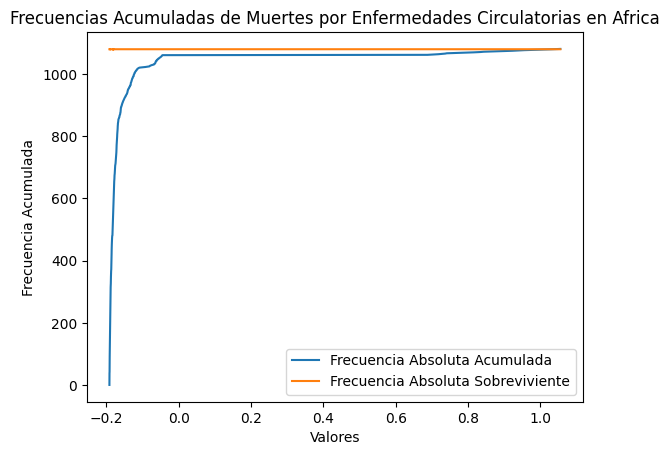

La Frecuencia Absoluta Complementaria por Muertes por Enfermedad Cardíaca Hipertensiva es:
 Deaths - Cause: Hypertensive heart disease - Sex: Both sexes - Age group: ALLAges
-0.181047    1079
-0.181045    1079
-0.181041    1079
-0.181040    1079
-0.181038    1079
             ... 
 1.816504    1079
 1.855520    1079
 1.888209    1079
 1.925931    1079
 1.961878    1079
Name: count, Length: 1074, dtype: int64
La Frecuencia Relativa Complementaria por Muertes por Enfermedad Cardíaca Hipertensiva es:
 Deaths - Cause: Hypertensive heart disease - Sex: Both sexes - Age group: ALLAges
-0.181047    9.990741e-01
-0.181045    9.981481e-01
-0.181041    9.972222e-01
-0.181040    9.962963e-01
-0.181038    9.953704e-01
                 ...     
 1.816504    3.703704e-03
 1.855520    2.777778e-03
 1.888209    1.851852e-03
 1.925931    9.259259e-04
 1.961878    1.931788e-14
Name: count, Length: 1074, dtype: float64


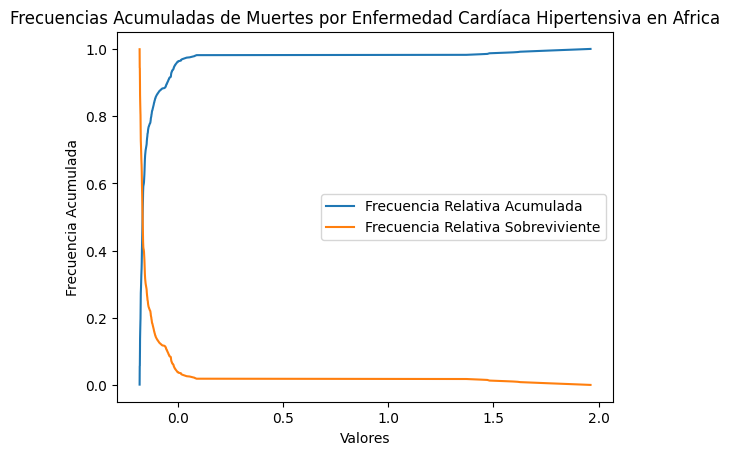

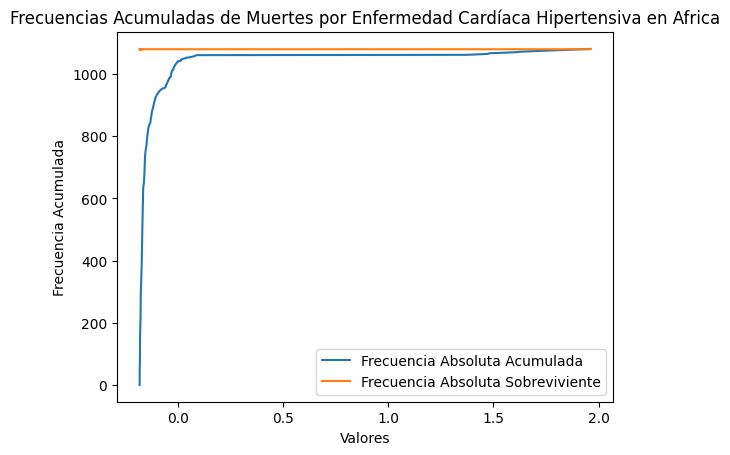

La Frecuencia Absoluta Complementaria por Muertes por Ictus Isquémico es:
 Deaths - Cause: Ischaemic stroke - Sex: Both sexes - Age group: ALLAges
-0.179582    1079
-0.179579    1079
-0.179579    1079
-0.179575    1079
-0.179575    1079
             ... 
 0.662707    1079
 0.685559    1079
 0.705777    1079
 0.727715    1079
 0.745788    1079
Name: count, Length: 1078, dtype: int64
La Frecuencia Relativa Complementaria por Muertes por Ictus Isquémico es:
 Deaths - Cause: Ischaemic stroke - Sex: Both sexes - Age group: ALLAges
-0.179582    9.990741e-01
-0.179579    9.981481e-01
-0.179579    9.972222e-01
-0.179575    9.962963e-01
-0.179575    9.953704e-01
                 ...     
 0.662707    3.703704e-03
 0.685559    2.777778e-03
 0.705777    1.851852e-03
 0.727715    9.259259e-04
 0.745788    1.920686e-14
Name: count, Length: 1078, dtype: float64


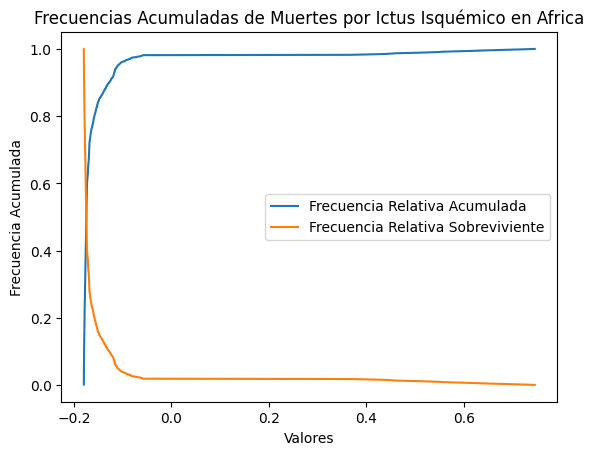

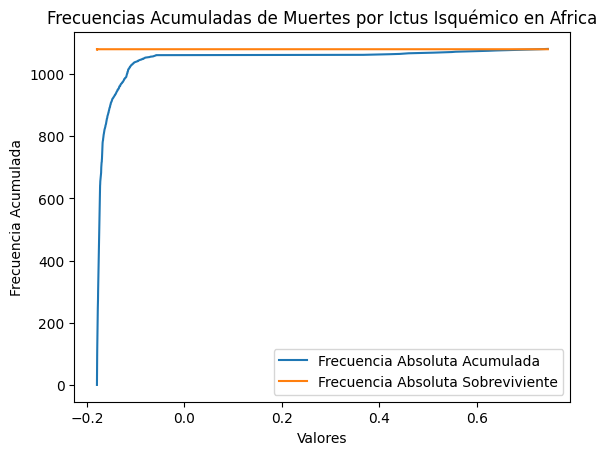

La Frecuencia Absoluta Complementaria por Muertes por Ictus Hemorrágico es:
 Deaths - Cause: Haemorrhagic stroke - Sex: Both sexes - Age group: ALLAges
-0.167630    1079
-0.167630    1079
-0.167628    1079
-0.167624    1079
-0.167623    1079
             ... 
 0.900130    1079
 0.911802    1079
 0.917736    1079
 0.928137    1079
 0.940837    1079
Name: count, Length: 1077, dtype: int64
La Frecuencia Relativa Complementaria por Muertes por Ictus Hemorrágico es:
 Deaths - Cause: Haemorrhagic stroke - Sex: Both sexes - Age group: ALLAges
-0.167630    9.990741e-01
-0.167630    9.981481e-01
-0.167628    9.972222e-01
-0.167624    9.962963e-01
-0.167623    9.953704e-01
                 ...     
 0.900130    3.703704e-03
 0.911802    2.777778e-03
 0.917736    1.851852e-03
 0.928137    9.259259e-04
 0.940837    1.909584e-14
Name: count, Length: 1077, dtype: float64


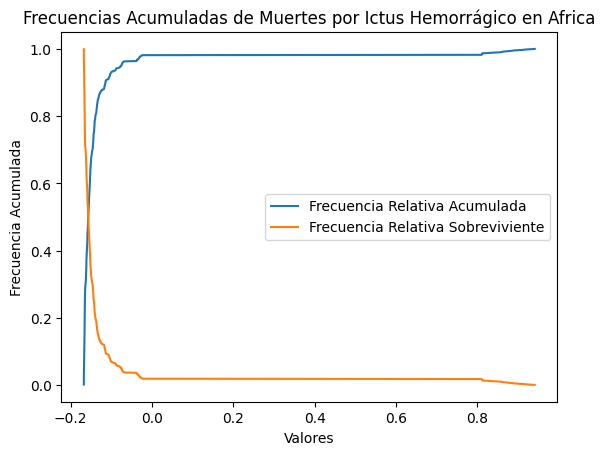

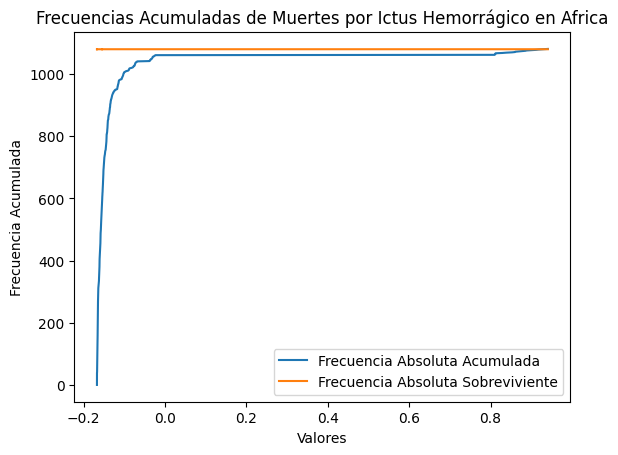

La Frecuencia Absoluta Complementaria por Muertes por Enfermedad Cardíaca Isquémica es:
 Deaths - Cause: Ischaemic heart disease - Sex: Both sexes - Age group: ALLAges
-0.184269    1079
-0.184268    1079
-0.184266    1079
-0.184262    1079
-0.184260    1079
             ... 
 0.864614    1079
 0.880814    1079
 0.898801    1079
 0.928629    1079
 0.953044    1079
Name: count, Length: 1080, dtype: int64
La Frecuencia Relativa Complementaria por Muertes por Enfermedad Cardíaca Isquémica es:
 Deaths - Cause: Ischaemic heart disease - Sex: Both sexes - Age group: ALLAges
-0.184269    9.990741e-01
-0.184268    9.981481e-01
-0.184266    9.972222e-01
-0.184262    9.962963e-01
-0.184260    9.953704e-01
                 ...     
 0.864614    3.703704e-03
 0.880814    2.777778e-03
 0.898801    1.851852e-03
 0.928629    9.259259e-04
 0.953044    1.920686e-14
Name: count, Length: 1080, dtype: float64


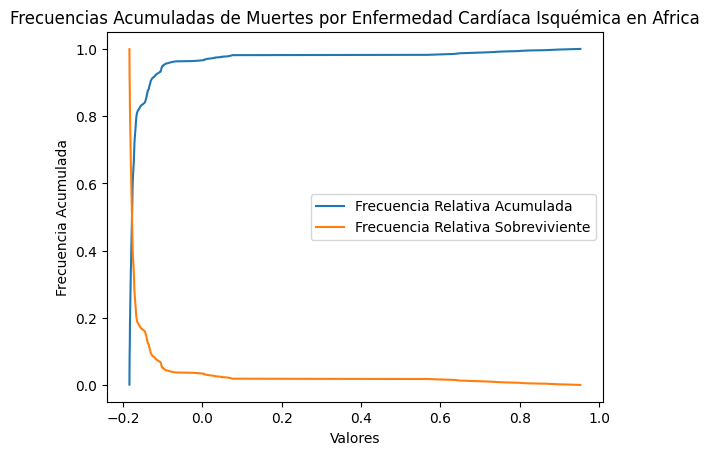

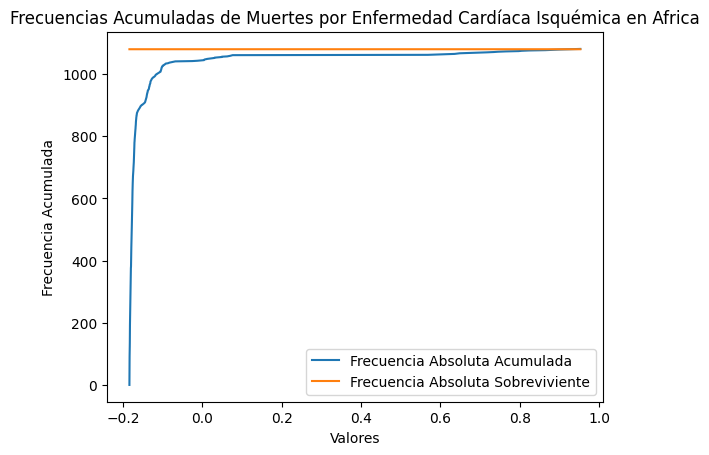

----------------------------------------------------------------------------------
Frecuencias Acumuladas de muertes por Enfermedades Cardiovasculares en America del Norte:
La Frecuencia Absoluta Complementaria por Muertes por Enfermedad Cardíaca Reumática es:
 Deaths - Cause: Rheumatic heart disease - Sex: Both sexes - Age group: ALLAges
-0.157645    433
-0.157643    439
-0.157639    439
-0.157639    439
-0.157638    439
            ... 
 0.052690    439
 0.052853    439
 0.056152    439
 0.059303    439
 0.061928    439
Name: count, Length: 407, dtype: int64
La Frecuencia Relativa Complementaria por Muertes por Enfermedad Cardíaca Reumática es:
 Deaths - Cause: Rheumatic heart disease - Sex: Both sexes - Age group: ALLAges
-0.157645    9.840909e-01
-0.157643    9.818182e-01
-0.157639    9.795455e-01
-0.157639    9.772727e-01
-0.157638    9.750000e-01
                 ...     
 0.052690    9.090909e-03
 0.052853    6.818182e-03
 0.056152    4.545455e-03
 0.059303    2.272727e-03
 0.06

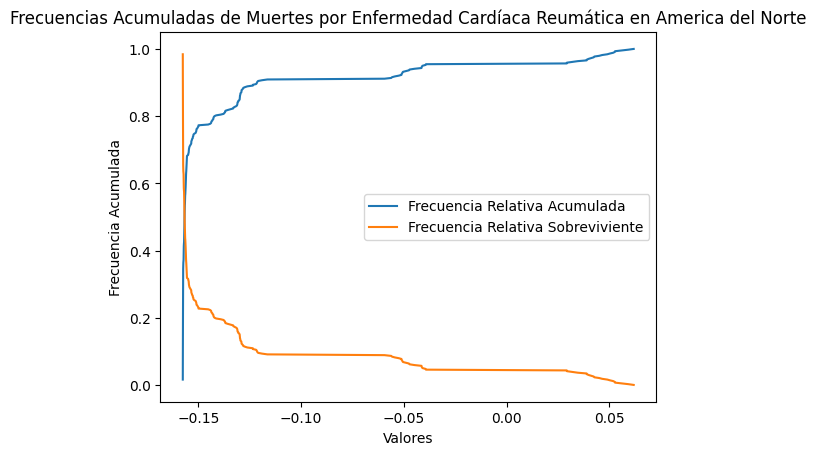

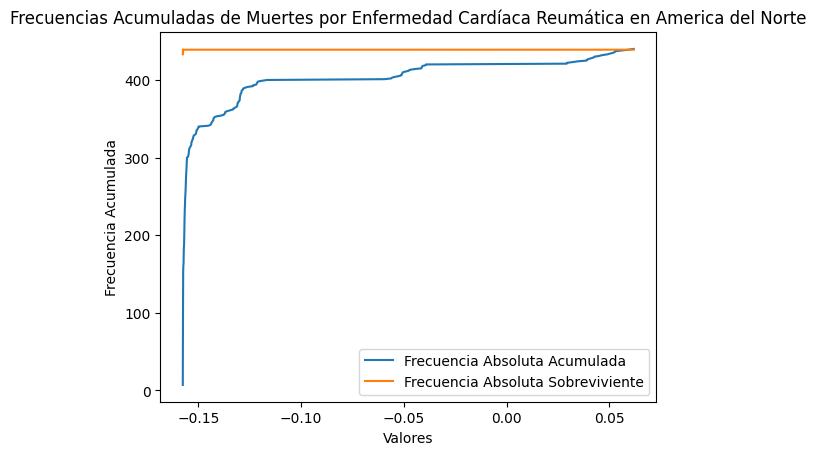

La Frecuencia Absoluta Complementaria por Muertes por Cardiomiopatía, Miocarditis y Endocarditis es:
 Deaths - Cause: Cardiomyopathy, myocarditis, endocarditis - Sex: Both sexes - Age group: ALLAges
-0.189215    439
-0.189200    439
-0.189195    439
-0.189188    439
-0.189186    439
            ... 
 1.196142    439
 1.206135    439
 1.210522    439
 1.219945    439
 1.230585    439
Name: count, Length: 438, dtype: int64
La Frecuencia Relativa Complementaria por Muertes por Cardiomiopatía, Miocarditis y Endocarditis es:
 Deaths - Cause: Cardiomyopathy, myocarditis, endocarditis - Sex: Both sexes - Age group: ALLAges
-0.189215    9.977273e-01
-0.189200    9.954545e-01
-0.189195    9.931818e-01
-0.189188    9.909091e-01
-0.189186    9.886364e-01
                 ...     
 1.196142    9.090909e-03
 1.206135    6.818182e-03
 1.210522    4.545455e-03
 1.219945    2.272727e-03
 1.230585   -7.105427e-15
Name: count, Length: 438, dtype: float64


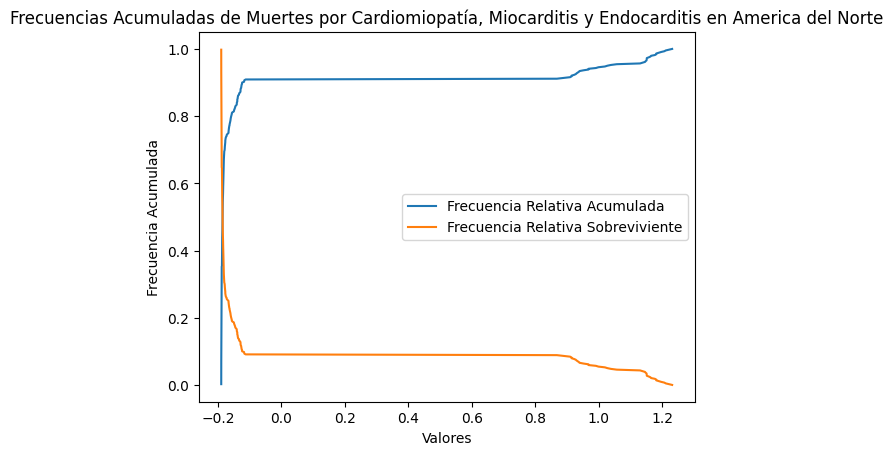

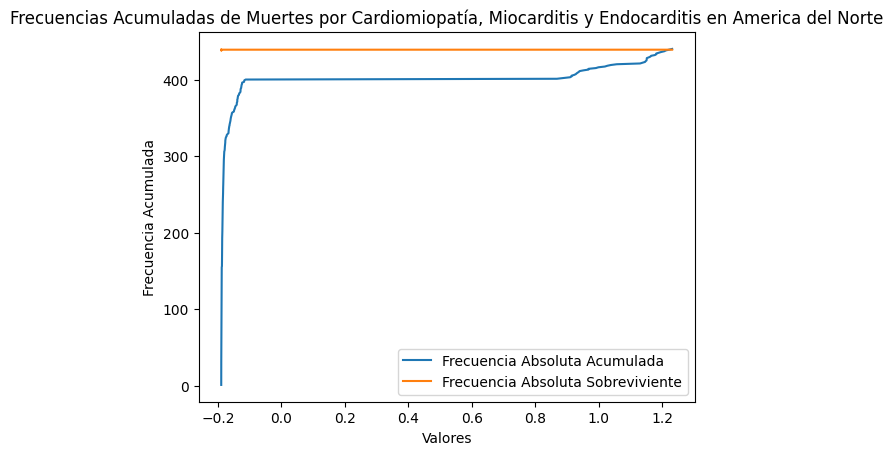

La Frecuencia Absoluta Complementaria por Muertes por Enfermedades Circulatorias es:
 Deaths - Cause: Other circulatory diseases - Sex: Both sexes - Age group: ALLAges
-0.191514    439
-0.191512    439
-0.191509    439
-0.191476    439
-0.191469    439
            ... 
 1.698056    439
 1.740157    439
 1.781318    439
 1.815275    439
 1.848576    439
Name: count, Length: 437, dtype: int64
La Frecuencia Relativa Complementaria por Muertes por Enfermedades Circulatorias es:
 Deaths - Cause: Other circulatory diseases - Sex: Both sexes - Age group: ALLAges
-0.191514    9.977273e-01
-0.191512    9.954545e-01
-0.191509    9.931818e-01
-0.191476    9.909091e-01
-0.191469    9.886364e-01
                 ...     
 1.698056    9.090909e-03
 1.740157    6.818182e-03
 1.781318    4.545455e-03
 1.815275    2.272727e-03
 1.848576   -7.105427e-15
Name: count, Length: 437, dtype: float64


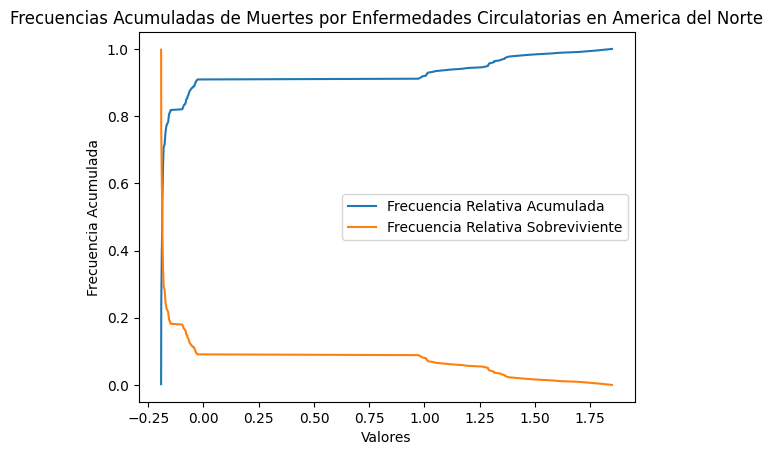

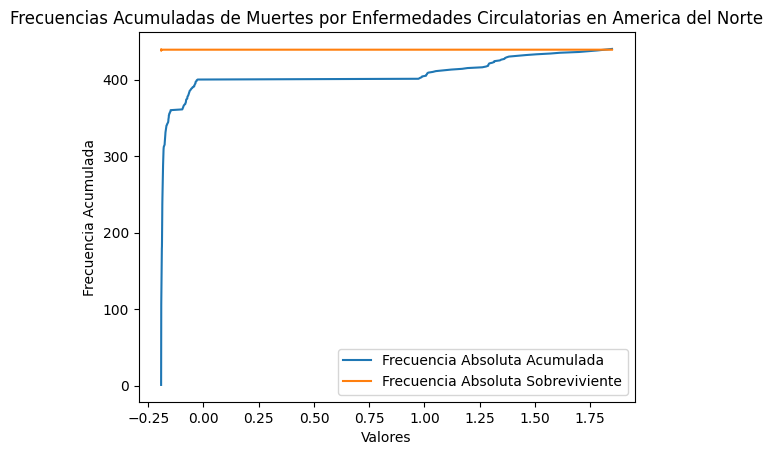

La Frecuencia Absoluta Complementaria por Muertes por Enfermedad Cardíaca Hipertensiva es:
 Deaths - Cause: Hypertensive heart disease - Sex: Both sexes - Age group: ALLAges
-0.181103    439
-0.181085    439
-0.181070    439
-0.181039    439
-0.181020    439
            ... 
 0.942232    439
 0.998787    439
 1.060447    439
 1.084381    439
 1.093678    439
Name: count, Length: 435, dtype: int64
La Frecuencia Relativa Complementaria por Muertes por Enfermedad Cardíaca Hipertensiva es:
 Deaths - Cause: Hypertensive heart disease - Sex: Both sexes - Age group: ALLAges
-0.181103    9.977273e-01
-0.181085    9.954545e-01
-0.181070    9.931818e-01
-0.181039    9.909091e-01
-0.181020    9.886364e-01
                 ...     
 0.942232    9.090909e-03
 0.998787    6.818182e-03
 1.060447    4.545455e-03
 1.084381    2.272727e-03
 1.093678   -7.105427e-15
Name: count, Length: 435, dtype: float64


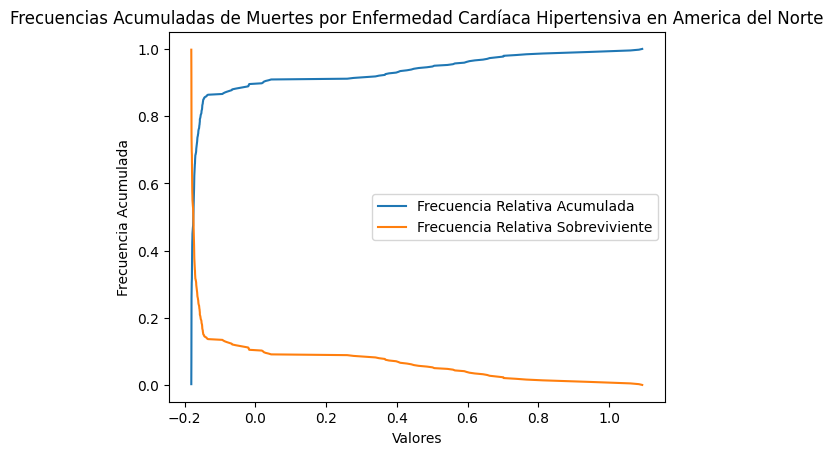

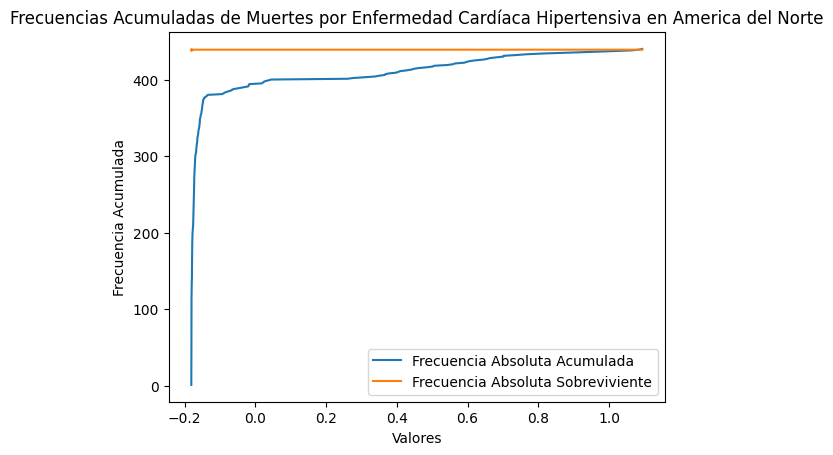

La Frecuencia Absoluta Complementaria por Muertes por Ictus Isquémico es:
 Deaths - Cause: Ischaemic stroke - Sex: Both sexes - Age group: ALLAges
-0.179593    439
-0.179586    439
-0.179584    439
-0.179577    439
-0.179575    439
            ... 
 0.422260    439
 0.429137    439
 0.433134    439
 0.433995    439
 0.445572    439
Name: count, Length: 438, dtype: int64
La Frecuencia Relativa Complementaria por Muertes por Ictus Isquémico es:
 Deaths - Cause: Ischaemic stroke - Sex: Both sexes - Age group: ALLAges
-0.179593    9.977273e-01
-0.179586    9.954545e-01
-0.179584    9.931818e-01
-0.179577    9.909091e-01
-0.179575    9.886364e-01
                 ...     
 0.422260    9.090909e-03
 0.429137    6.818182e-03
 0.433134    4.545455e-03
 0.433995    2.272727e-03
 0.445572   -7.105427e-15
Name: count, Length: 438, dtype: float64


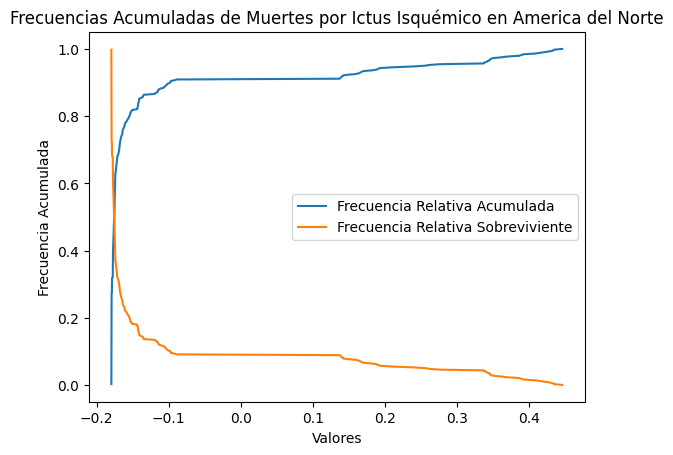

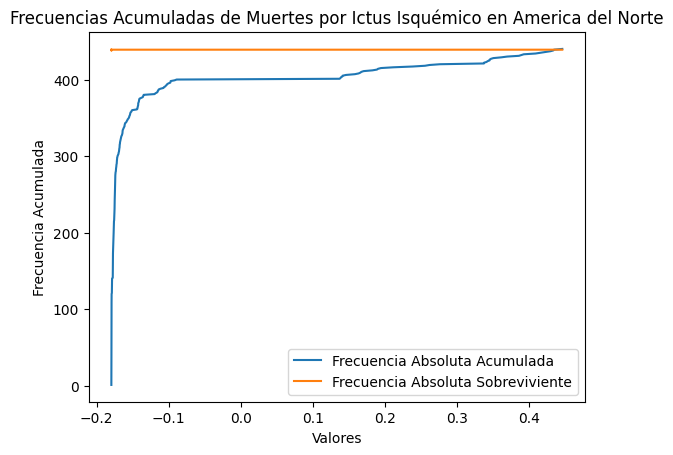

La Frecuencia Absoluta Complementaria por Muertes por Ictus Hemorrágico es:
 Deaths - Cause: Haemorrhagic stroke - Sex: Both sexes - Age group: ALLAges
-0.167647    439
-0.167645    439
-0.167639    439
-0.167639    439
-0.167638    439
            ... 
 0.214469    439
 0.219615    439
 0.228449    439
 0.233758    439
 0.240864    439
Name: count, Length: 435, dtype: int64
La Frecuencia Relativa Complementaria por Muertes por Ictus Hemorrágico es:
 Deaths - Cause: Haemorrhagic stroke - Sex: Both sexes - Age group: ALLAges
-0.167647    9.977273e-01
-0.167645    9.954545e-01
-0.167639    9.931818e-01
-0.167639    9.909091e-01
-0.167638    9.886364e-01
                 ...     
 0.214469    9.090909e-03
 0.219615    6.818182e-03
 0.228449    4.545455e-03
 0.233758    2.272727e-03
 0.240864   -7.105427e-15
Name: count, Length: 435, dtype: float64


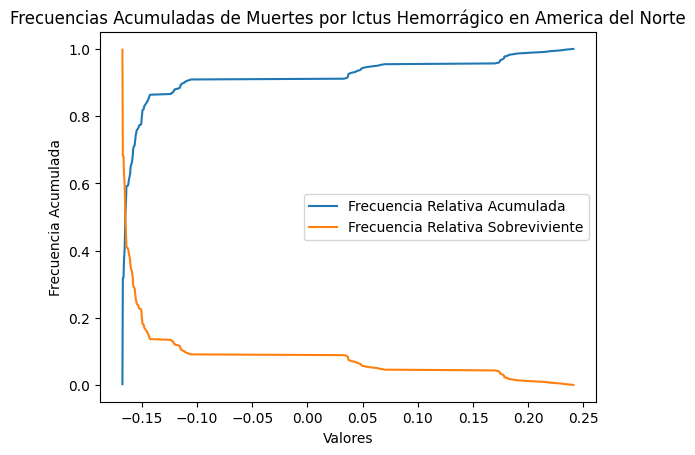

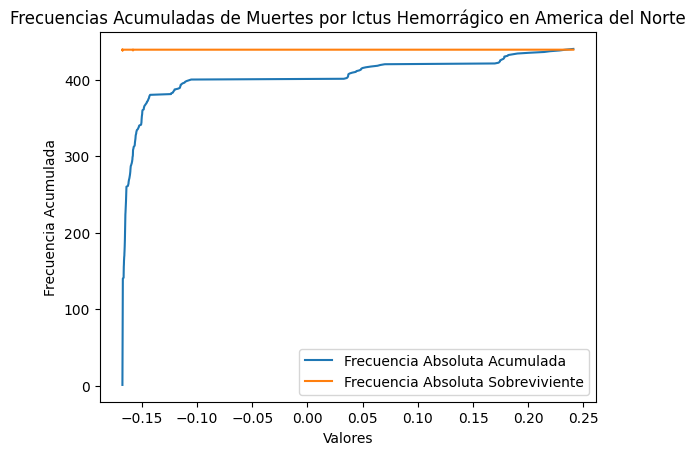

La Frecuencia Absoluta Complementaria por Muertes por Enfermedad Cardíaca Isquémica es:
 Deaths - Cause: Ischaemic heart disease - Sex: Both sexes - Age group: ALLAges
-0.184284    439
-0.184278    439
-0.184265    439
-0.184262    439
-0.184249    439
            ... 
 0.920929    439
 0.933471    439
 0.940097    439
 0.943414    439
 0.959658    439
Name: count, Length: 440, dtype: int64
La Frecuencia Relativa Complementaria por Muertes por Enfermedad Cardíaca Isquémica es:
 Deaths - Cause: Ischaemic heart disease - Sex: Both sexes - Age group: ALLAges
-0.184284    9.977273e-01
-0.184278    9.954545e-01
-0.184265    9.931818e-01
-0.184262    9.909091e-01
-0.184249    9.886364e-01
                 ...     
 0.920929    9.090909e-03
 0.933471    6.818182e-03
 0.940097    4.545455e-03
 0.943414    2.272727e-03
 0.959658   -7.105427e-15
Name: count, Length: 440, dtype: float64


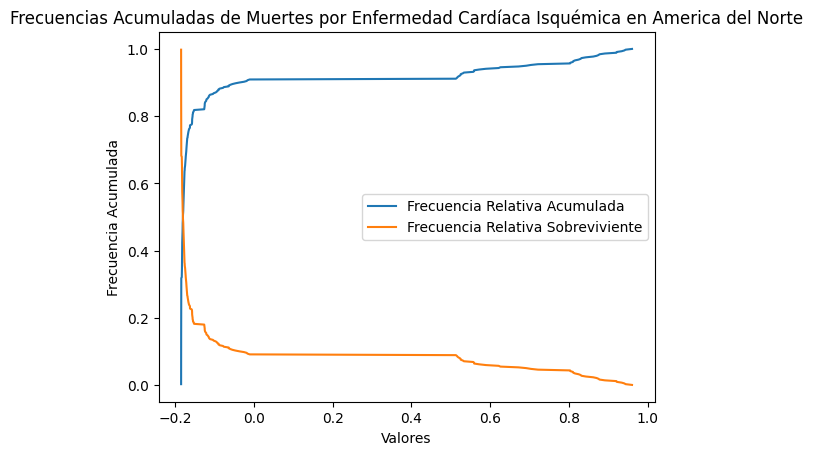

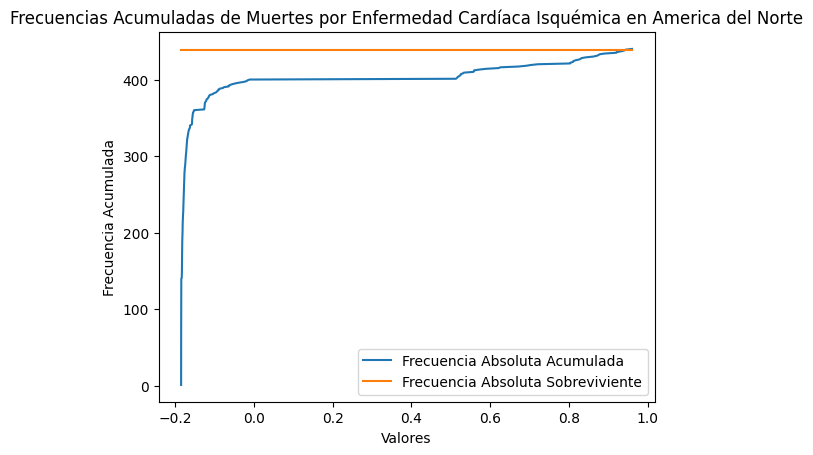

----------------------------------------------------------------------------------
Frecuencias Acumuladas de muertes por Enfermedades Cardiovasculares en America del Sur:
La Frecuencia Absoluta Complementaria por Muertes por Enfermedad Cardíaca Reumática es:
 Deaths - Cause: Rheumatic heart disease - Sex: Both sexes - Age group: ALLAges
-0.157467    259
-0.157466    259
-0.157464    259
-0.157464    259
-0.157459    259
            ... 
-0.032739    259
-0.030748    259
-0.030304    259
-0.030243    259
-0.023645    259
Name: count, Length: 259, dtype: int64
La Frecuencia Relativa Complementaria por Muertes por Enfermedad Cardíaca Reumática es:
 Deaths - Cause: Rheumatic heart disease - Sex: Both sexes - Age group: ALLAges
-0.157467    9.961538e-01
-0.157466    9.923077e-01
-0.157464    9.884615e-01
-0.157464    9.846154e-01
-0.157459    9.807692e-01
                 ...     
-0.032739    1.538462e-02
-0.030748    1.153846e-02
-0.030304    7.692308e-03
-0.030243    3.846154e-03
-0.0236

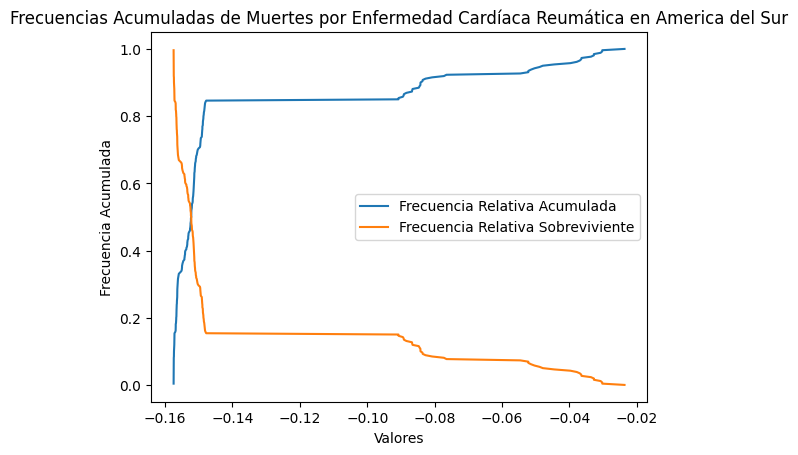

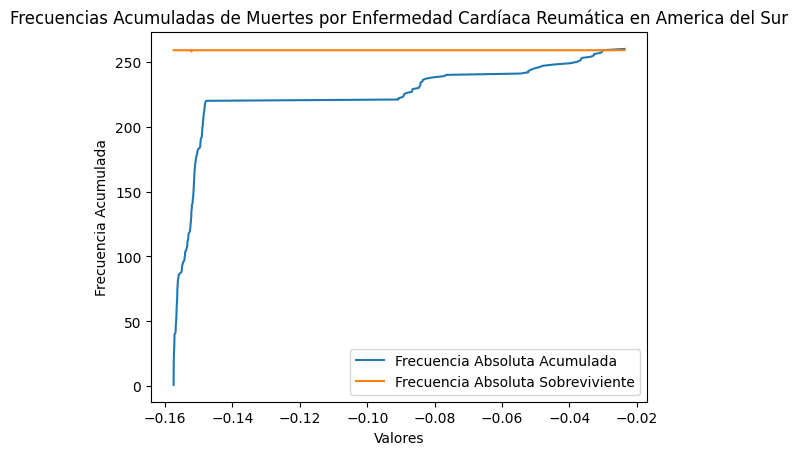

La Frecuencia Absoluta Complementaria por Muertes por Cardiomiopatía, Miocarditis y Endocarditis es:
 Deaths - Cause: Cardiomyopathy, myocarditis, endocarditis - Sex: Both sexes - Age group: ALLAges
-0.188556    259
-0.188487    259
-0.188477    259
-0.188468    259
-0.188459    259
            ... 
 0.744260    259
 0.757123    259
 0.757998    259
 0.771911    259
 0.797496    259
Name: count, Length: 260, dtype: int64
La Frecuencia Relativa Complementaria por Muertes por Cardiomiopatía, Miocarditis y Endocarditis es:
 Deaths - Cause: Cardiomyopathy, myocarditis, endocarditis - Sex: Both sexes - Age group: ALLAges
-0.188556    9.961538e-01
-0.188487    9.923077e-01
-0.188477    9.884615e-01
-0.188468    9.846154e-01
-0.188459    9.807692e-01
                 ...     
 0.744260    1.538462e-02
 0.757123    1.153846e-02
 0.757998    7.692308e-03
 0.771911    3.846154e-03
 0.797496    3.108624e-15
Name: count, Length: 260, dtype: float64


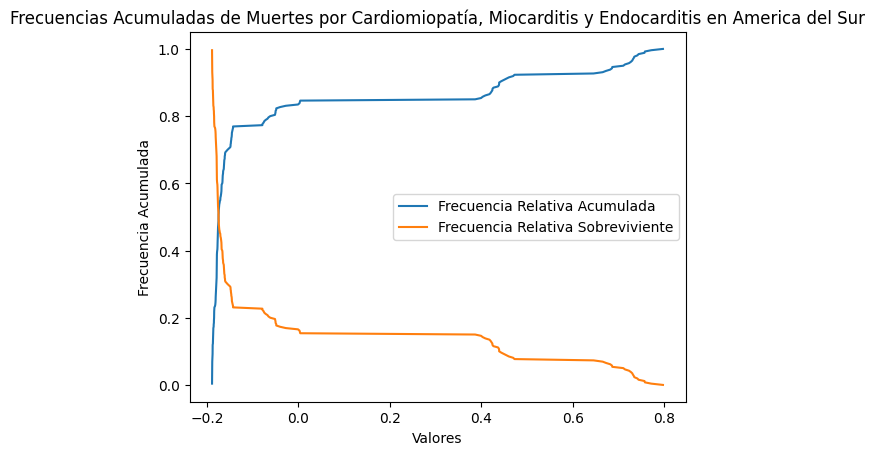

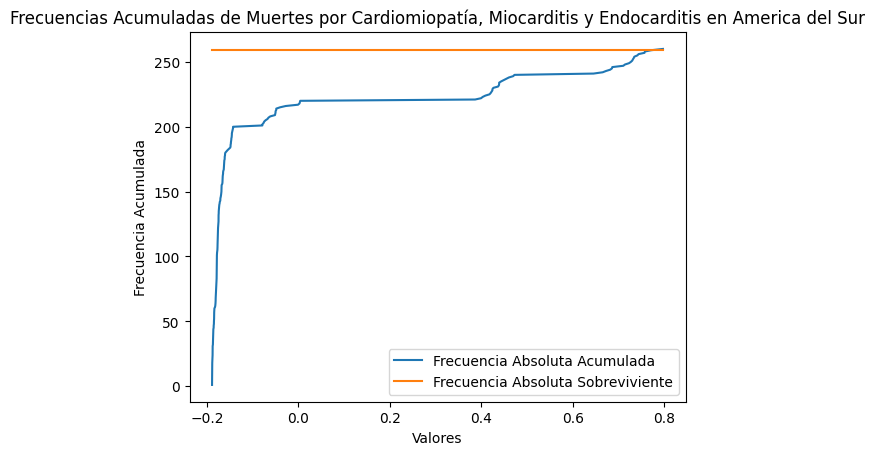

La Frecuencia Absoluta Complementaria por Muertes por Enfermedades Circulatorias es:
 Deaths - Cause: Other circulatory diseases - Sex: Both sexes - Age group: ALLAges
-0.191156    259
-0.191105    259
-0.191084    259
-0.191078    259
-0.191074    259
            ... 
 0.845592    259
 0.896090    259
 0.916339    259
 0.950265    259
 0.962460    259
Name: count, Length: 260, dtype: int64
La Frecuencia Relativa Complementaria por Muertes por Enfermedades Circulatorias es:
 Deaths - Cause: Other circulatory diseases - Sex: Both sexes - Age group: ALLAges
-0.191156    9.961538e-01
-0.191105    9.923077e-01
-0.191084    9.884615e-01
-0.191078    9.846154e-01
-0.191074    9.807692e-01
                 ...     
 0.845592    1.538462e-02
 0.896090    1.153846e-02
 0.916339    7.692308e-03
 0.950265    3.846154e-03
 0.962460    3.108624e-15
Name: count, Length: 260, dtype: float64


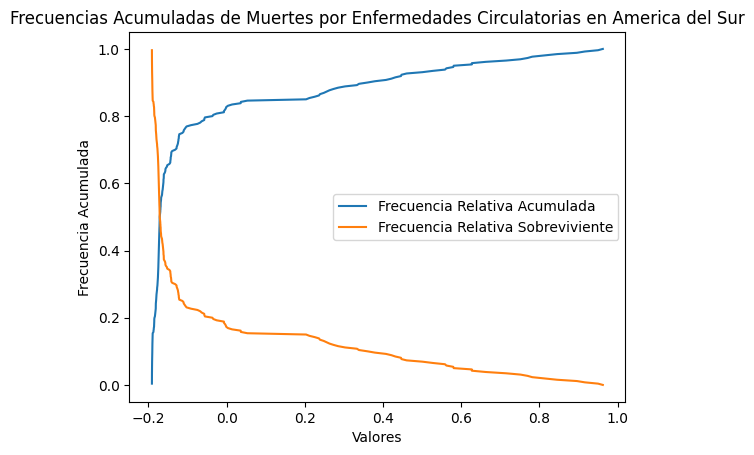

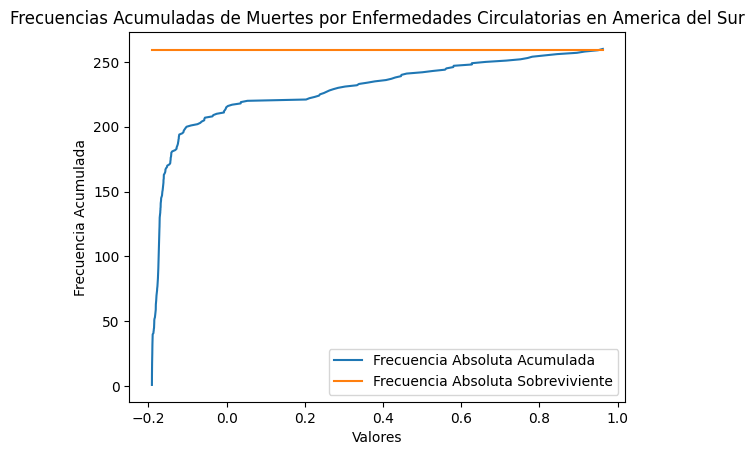

La Frecuencia Absoluta Complementaria por Muertes por Enfermedad Cardíaca Hipertensiva es:
 Deaths - Cause: Hypertensive heart disease - Sex: Both sexes - Age group: ALLAges
-0.180206    259
-0.180152    259
-0.180124    259
-0.180115    259
-0.180115    259
            ... 
 0.470730    259
 0.499434    259
 0.543956    259
 0.548519    259
 0.548844    259
Name: count, Length: 260, dtype: int64
La Frecuencia Relativa Complementaria por Muertes por Enfermedad Cardíaca Hipertensiva es:
 Deaths - Cause: Hypertensive heart disease - Sex: Both sexes - Age group: ALLAges
-0.180206    9.961538e-01
-0.180152    9.923077e-01
-0.180124    9.884615e-01
-0.180115    9.846154e-01
-0.180115    9.807692e-01
                 ...     
 0.470730    1.538462e-02
 0.499434    1.153846e-02
 0.543956    7.692308e-03
 0.548519    3.846154e-03
 0.548844    3.108624e-15
Name: count, Length: 260, dtype: float64


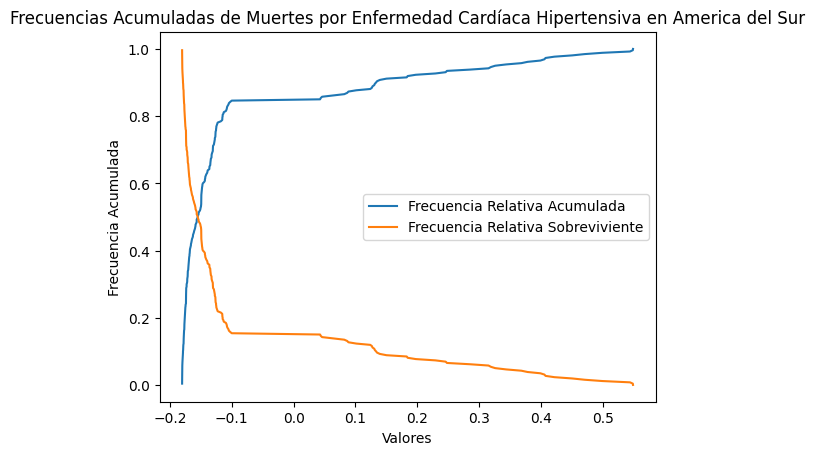

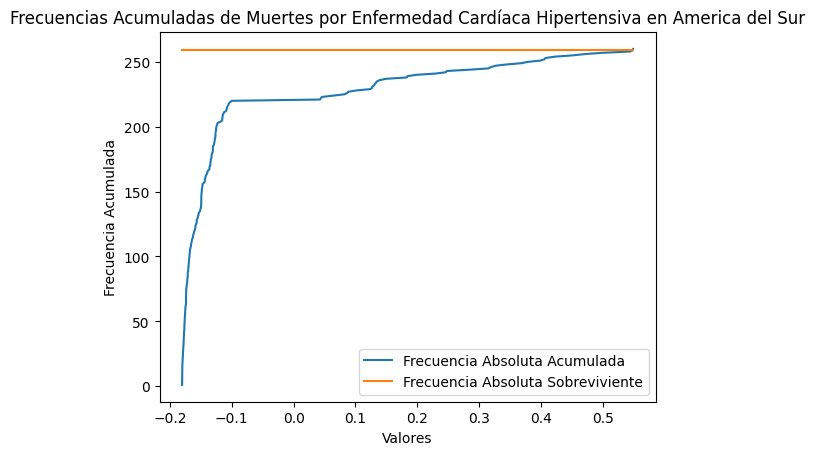

La Frecuencia Absoluta Complementaria por Muertes por Ictus Isquémico es:
 Deaths - Cause: Ischaemic stroke - Sex: Both sexes - Age group: ALLAges
-0.179007    259
-0.178948    259
-0.178941    259
-0.178940    259
-0.178930    259
            ... 
 0.283729    259
 0.287759    259
 0.293025    259
 0.293912    259
 0.306054    259
Name: count, Length: 260, dtype: int64
La Frecuencia Relativa Complementaria por Muertes por Ictus Isquémico es:
 Deaths - Cause: Ischaemic stroke - Sex: Both sexes - Age group: ALLAges
-0.179007    9.961538e-01
-0.178948    9.923077e-01
-0.178941    9.884615e-01
-0.178940    9.846154e-01
-0.178930    9.807692e-01
                 ...     
 0.283729    1.538462e-02
 0.287759    1.153846e-02
 0.293025    7.692308e-03
 0.293912    3.846154e-03
 0.306054    3.108624e-15
Name: count, Length: 260, dtype: float64


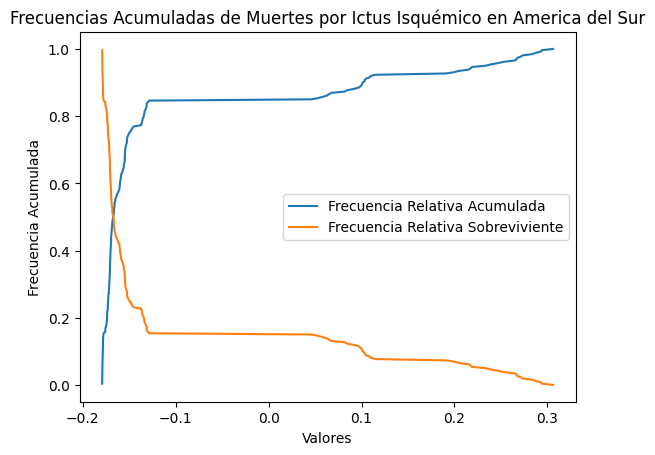

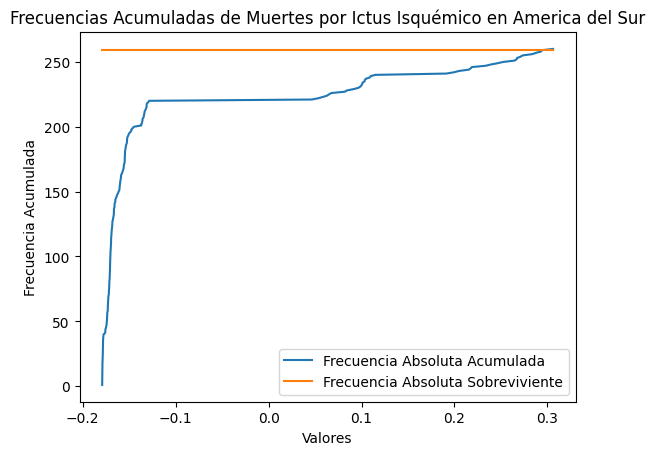

La Frecuencia Absoluta Complementaria por Muertes por Ictus Hemorrágico es:
 Deaths - Cause: Haemorrhagic stroke - Sex: Both sexes - Age group: ALLAges
-0.166870    259
-0.166860    259
-0.166853    259
-0.166845    259
-0.166832    259
            ... 
 0.156756    259
 0.160623    259
 0.160782    259
 0.163484    259
 0.163577    259
Name: count, Length: 260, dtype: int64
La Frecuencia Relativa Complementaria por Muertes por Ictus Hemorrágico es:
 Deaths - Cause: Haemorrhagic stroke - Sex: Both sexes - Age group: ALLAges
-0.166870    9.961538e-01
-0.166860    9.923077e-01
-0.166853    9.884615e-01
-0.166845    9.846154e-01
-0.166832    9.807692e-01
                 ...     
 0.156756    1.538462e-02
 0.160623    1.153846e-02
 0.160782    7.692308e-03
 0.163484    3.846154e-03
 0.163577    3.108624e-15
Name: count, Length: 260, dtype: float64


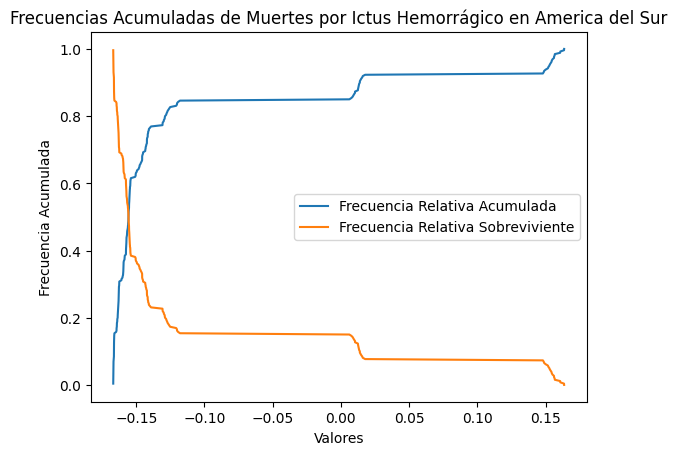

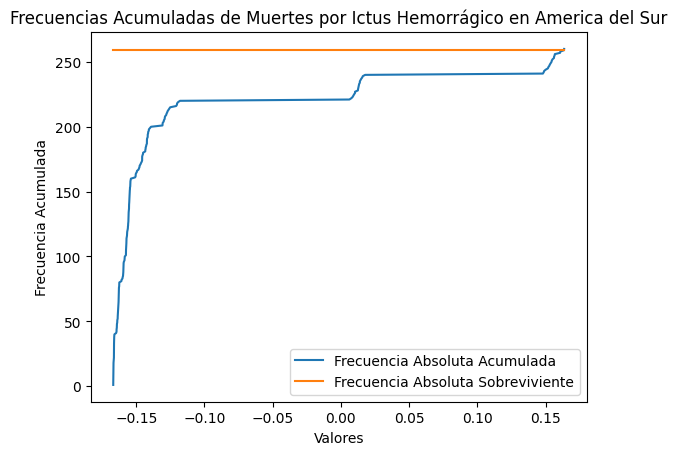

La Frecuencia Absoluta Complementaria por Muertes por Enfermedad Cardíaca Isquémica es:
 Deaths - Cause: Ischaemic heart disease - Sex: Both sexes - Age group: ALLAges
-0.183788    259
-0.183761    259
-0.183761    259
-0.183760    259
-0.183759    259
            ... 
 0.293382    259
 0.309018    259
 0.313121    259
 0.315098    259
 0.325397    259
Name: count, Length: 260, dtype: int64
La Frecuencia Relativa Complementaria por Muertes por Enfermedad Cardíaca Isquémica es:
 Deaths - Cause: Ischaemic heart disease - Sex: Both sexes - Age group: ALLAges
-0.183788    9.961538e-01
-0.183761    9.923077e-01
-0.183761    9.884615e-01
-0.183760    9.846154e-01
-0.183759    9.807692e-01
                 ...     
 0.293382    1.538462e-02
 0.309018    1.153846e-02
 0.313121    7.692308e-03
 0.315098    3.846154e-03
 0.325397    3.108624e-15
Name: count, Length: 260, dtype: float64


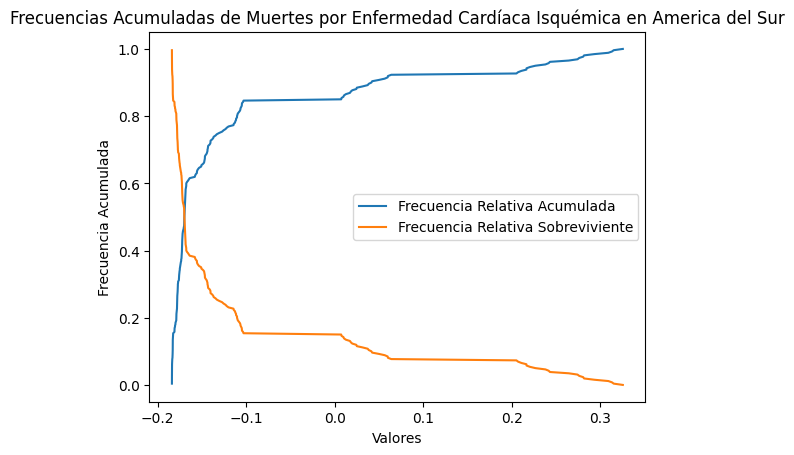

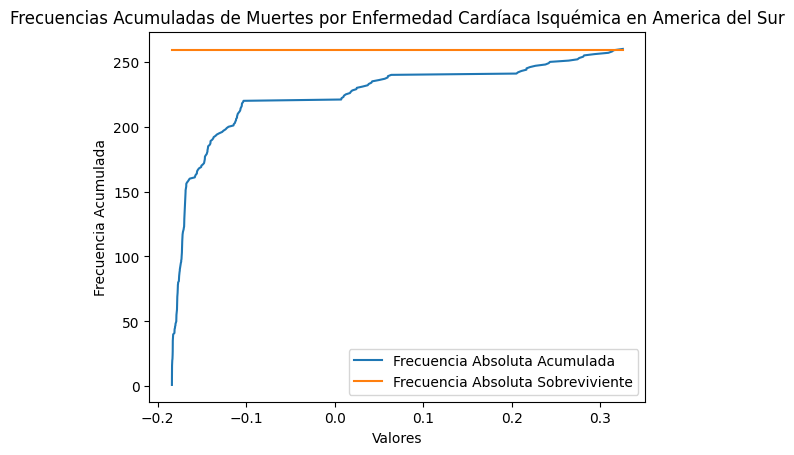

----------------------------------------------------------------------------------
Frecuencias Acumuladas de muertes por Enfermedades Cardiovasculares en Asia:
La Frecuencia Absoluta Complementaria por Muertes por Enfermedad Cardíaca Reumática es:
 Deaths - Cause: Rheumatic heart disease - Sex: Both sexes - Age group: ALLAges
-0.157568    939
-0.157545    939
-0.157542    939
-0.157541    939
-0.157540    939
            ... 
 8.487723    939
 8.684022    939
 8.823340    939
 8.892646    939
 8.954622    939
Name: count, Length: 929, dtype: int64
La Frecuencia Relativa Complementaria por Muertes por Enfermedad Cardíaca Reumática es:
 Deaths - Cause: Rheumatic heart disease - Sex: Both sexes - Age group: ALLAges
-0.157568    9.989362e-01
-0.157545    9.978723e-01
-0.157542    9.968085e-01
-0.157541    9.957447e-01
-0.157540    9.946809e-01
                 ...     
 8.487723    4.255319e-03
 8.684022    3.191489e-03
 8.823340    2.127660e-03
 8.892646    1.063830e-03
 8.954622   -7.771

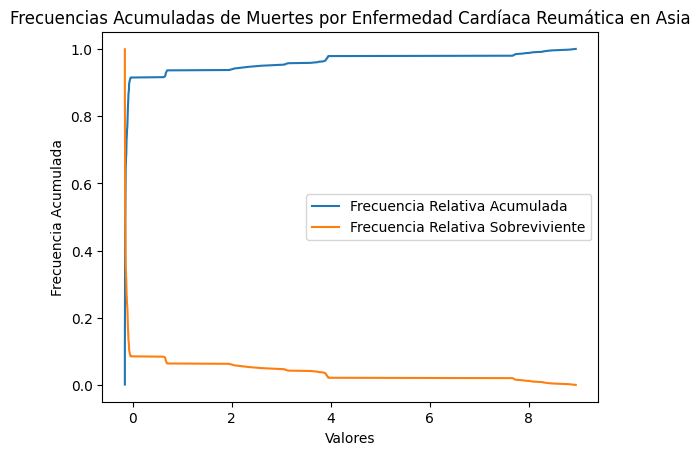

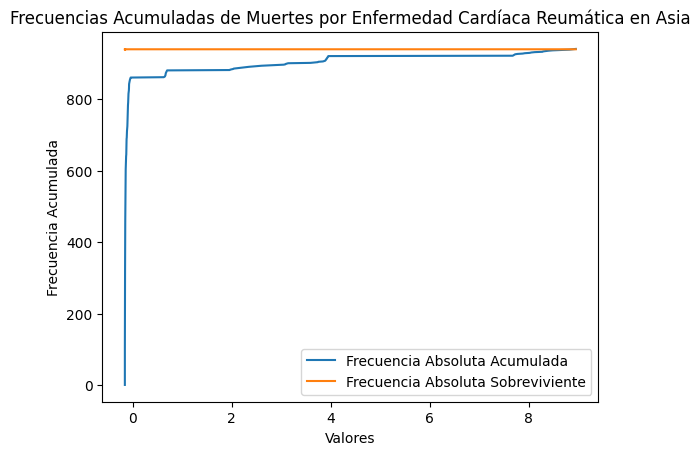

La Frecuencia Absoluta Complementaria por Muertes por Cardiomiopatía, Miocarditis y Endocarditis es:
 Deaths - Cause: Cardiomyopathy, myocarditis, endocarditis - Sex: Both sexes - Age group: ALLAges
-0.189137    939
-0.189134    939
-0.189131    939
-0.189127    939
-0.189125    939
            ... 
 3.033451    939
 3.102452    939
 3.155250    939
 3.208084    939
 3.257754    939
Name: count, Length: 936, dtype: int64
La Frecuencia Relativa Complementaria por Muertes por Cardiomiopatía, Miocarditis y Endocarditis es:
 Deaths - Cause: Cardiomyopathy, myocarditis, endocarditis - Sex: Both sexes - Age group: ALLAges
-0.189137    9.989362e-01
-0.189134    9.978723e-01
-0.189131    9.968085e-01
-0.189127    9.957447e-01
-0.189125    9.946809e-01
                 ...     
 3.033451    4.255319e-03
 3.102452    3.191489e-03
 3.155250    2.127660e-03
 3.208084    1.063830e-03
 3.257754   -7.993606e-15
Name: count, Length: 936, dtype: float64


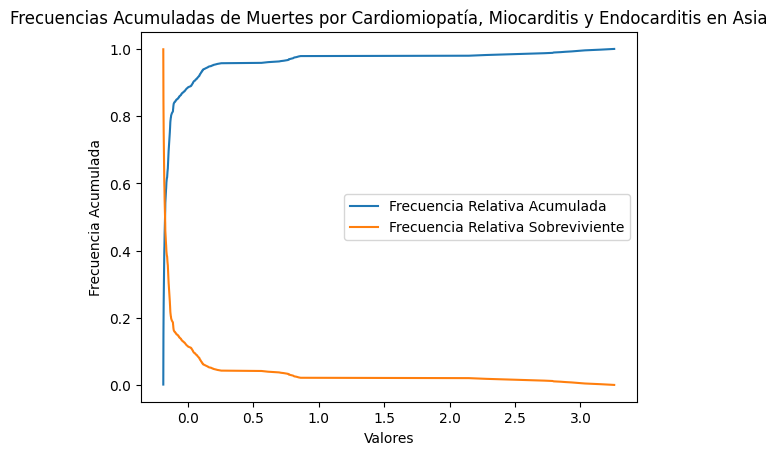

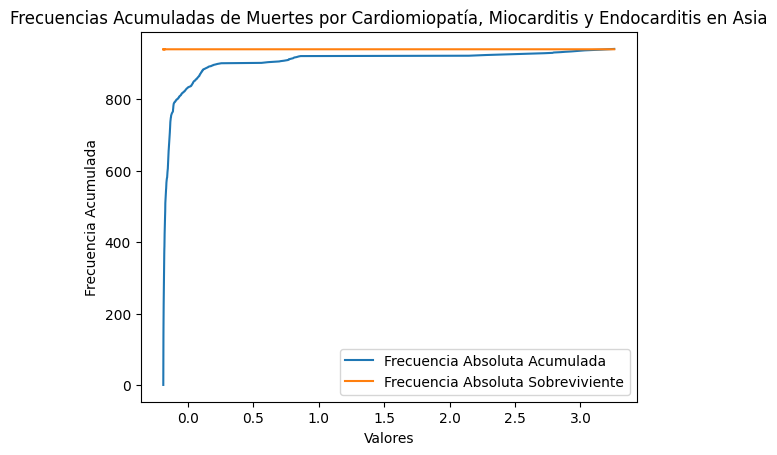

La Frecuencia Absoluta Complementaria por Muertes por Enfermedades Circulatorias es:
 Deaths - Cause: Other circulatory diseases - Sex: Both sexes - Age group: ALLAges
-0.191510    939
-0.191505    939
-0.191503    939
-0.191482    939
-0.191477    939
            ... 
 4.560314    939
 4.801751    939
 5.037440    939
 5.197655    939
 5.315324    939
Name: count, Length: 938, dtype: int64
La Frecuencia Relativa Complementaria por Muertes por Enfermedades Circulatorias es:
 Deaths - Cause: Other circulatory diseases - Sex: Both sexes - Age group: ALLAges
-0.191510    9.989362e-01
-0.191505    9.978723e-01
-0.191503    9.968085e-01
-0.191482    9.957447e-01
-0.191477    9.946809e-01
                 ...     
 4.560314    4.255319e-03
 4.801751    3.191489e-03
 5.037440    2.127660e-03
 5.197655    1.063830e-03
 5.315324   -7.549517e-15
Name: count, Length: 938, dtype: float64


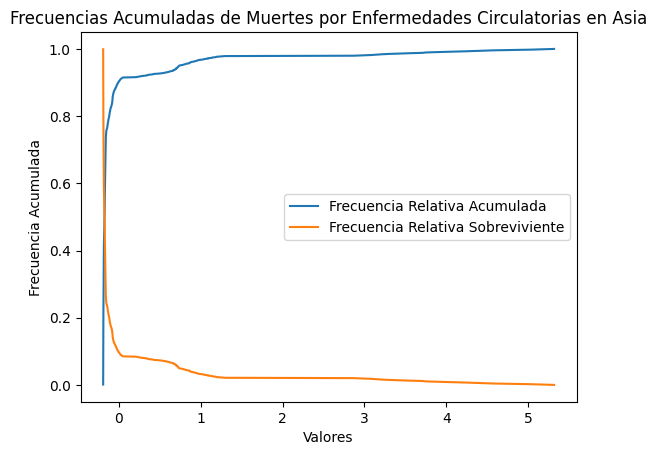

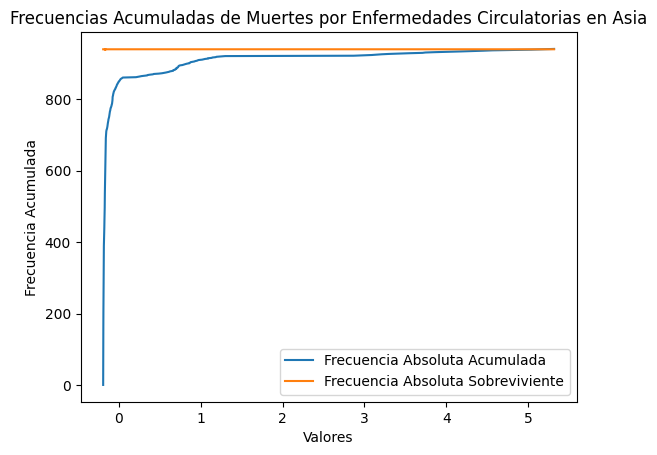

La Frecuencia Absoluta Complementaria por Muertes por Enfermedad Cardíaca Hipertensiva es:
 Deaths - Cause: Hypertensive heart disease - Sex: Both sexes - Age group: ALLAges
-0.180983    939
-0.180981    939
-0.180977    939
-0.180970    939
-0.180969    939
            ... 
 7.392716    939
 7.713370    939
 7.938586    939
 8.059726    939
 8.170555    939
Name: count, Length: 938, dtype: int64
La Frecuencia Relativa Complementaria por Muertes por Enfermedad Cardíaca Hipertensiva es:
 Deaths - Cause: Hypertensive heart disease - Sex: Both sexes - Age group: ALLAges
-0.180983    9.989362e-01
-0.180981    9.978723e-01
-0.180977    9.968085e-01
-0.180970    9.957447e-01
-0.180969    9.946809e-01
                 ...     
 7.392716    4.255319e-03
 7.713370    3.191489e-03
 7.938586    2.127660e-03
 8.059726    1.063830e-03
 8.170555   -7.771561e-15
Name: count, Length: 938, dtype: float64


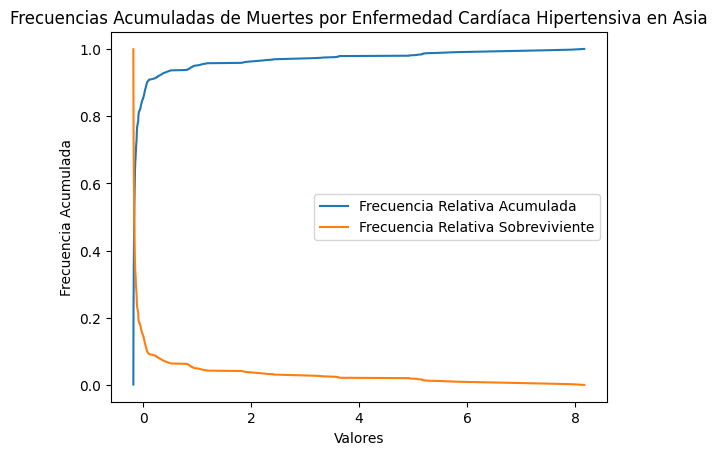

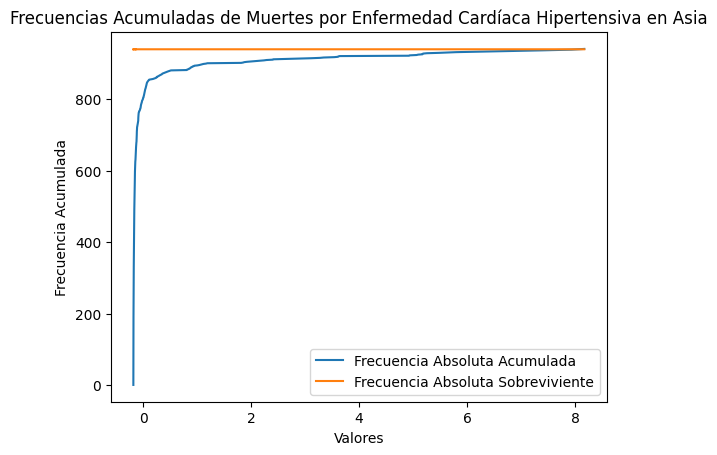

La Frecuencia Absoluta Complementaria por Muertes por Ictus Isquémico es:
 Deaths - Cause: Ischaemic stroke - Sex: Both sexes - Age group: ALLAges
-0.179511    939
-0.179506    939
-0.179499    939
-0.179486    939
-0.179484    939
            ... 
 6.843052    939
 7.116991    939
 7.378511    939
 7.591217    939
 7.793966    939
Name: count, Length: 939, dtype: int64
La Frecuencia Relativa Complementaria por Muertes por Ictus Isquémico es:
 Deaths - Cause: Ischaemic stroke - Sex: Both sexes - Age group: ALLAges
-0.179511    9.989362e-01
-0.179506    9.978723e-01
-0.179499    9.968085e-01
-0.179486    9.957447e-01
-0.179484    9.946809e-01
                 ...     
 6.843052    4.255319e-03
 7.116991    3.191489e-03
 7.378511    2.127660e-03
 7.591217    1.063830e-03
 7.793966   -7.771561e-15
Name: count, Length: 939, dtype: float64


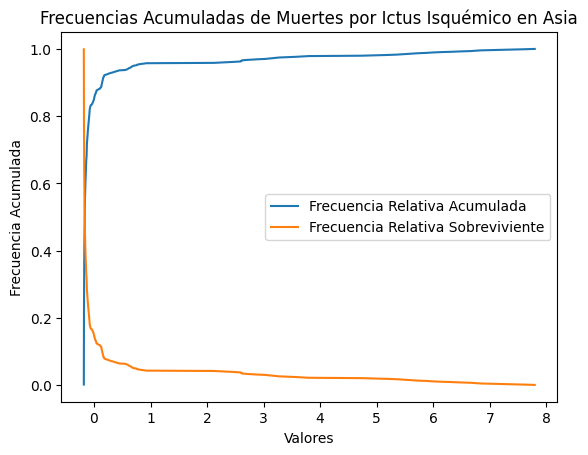

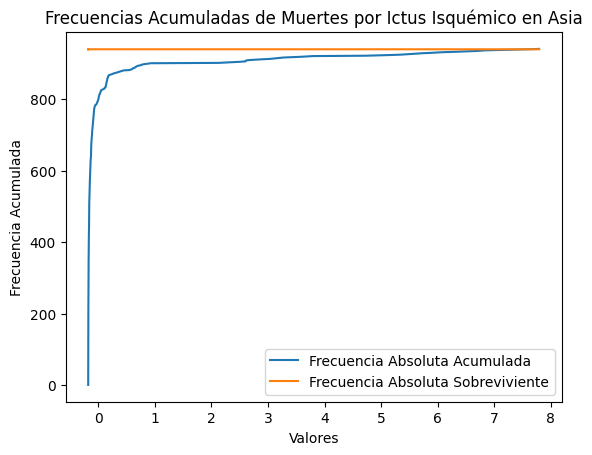

La Frecuencia Absoluta Complementaria por Muertes por Ictus Hemorrágico es:
 Deaths - Cause: Haemorrhagic stroke - Sex: Both sexes - Age group: ALLAges
-0.167532    939
-0.167528    939
-0.167526    939
-0.167525    939
-0.167519    939
            ... 
 7.740420    939
 7.749859    939
 7.763825    939
 7.795195    939
 7.911506    939
Name: count, Length: 939, dtype: int64
La Frecuencia Relativa Complementaria por Muertes por Ictus Hemorrágico es:
 Deaths - Cause: Haemorrhagic stroke - Sex: Both sexes - Age group: ALLAges
-0.167532    9.989362e-01
-0.167528    9.978723e-01
-0.167526    9.968085e-01
-0.167525    9.957447e-01
-0.167519    9.946809e-01
                 ...     
 7.740420    4.255319e-03
 7.749859    3.191489e-03
 7.763825    2.127660e-03
 7.795195    1.063830e-03
 7.911506   -7.771561e-15
Name: count, Length: 939, dtype: float64


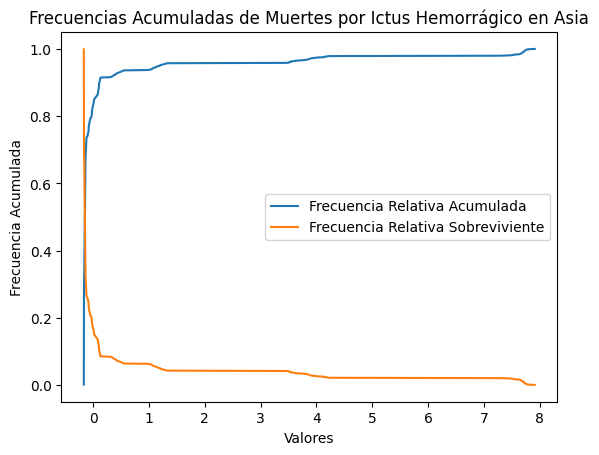

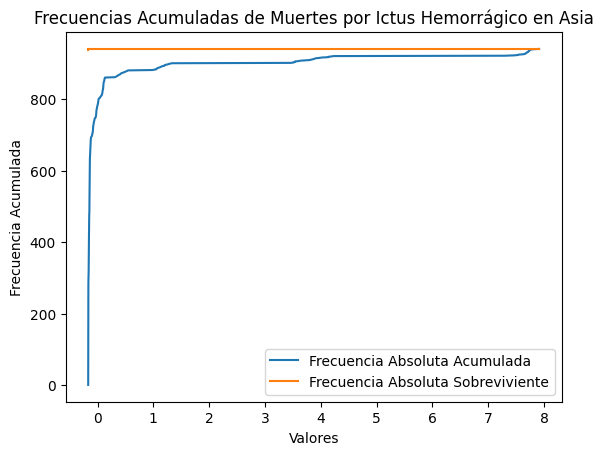

La Frecuencia Absoluta Complementaria por Muertes por Enfermedad Cardíaca Isquémica es:
 Deaths - Cause: Ischaemic heart disease - Sex: Both sexes - Age group: ALLAges
-0.184105    939
-0.184087    939
-0.184060    939
-0.184059    939
-0.184058    939
            ... 
 6.706150    939
 6.932718    939
 7.135996    939
 7.335131    939
 7.490590    939
Name: count, Length: 940, dtype: int64
La Frecuencia Relativa Complementaria por Muertes por Enfermedad Cardíaca Isquémica es:
 Deaths - Cause: Ischaemic heart disease - Sex: Both sexes - Age group: ALLAges
-0.184105    9.989362e-01
-0.184087    9.978723e-01
-0.184060    9.968085e-01
-0.184059    9.957447e-01
-0.184058    9.946809e-01
                 ...     
 6.706150    4.255319e-03
 6.932718    3.191489e-03
 7.135996    2.127660e-03
 7.335131    1.063830e-03
 7.490590   -7.771561e-15
Name: count, Length: 940, dtype: float64


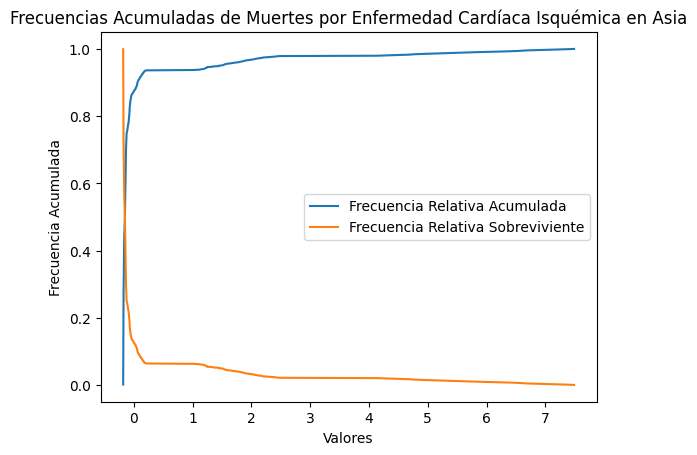

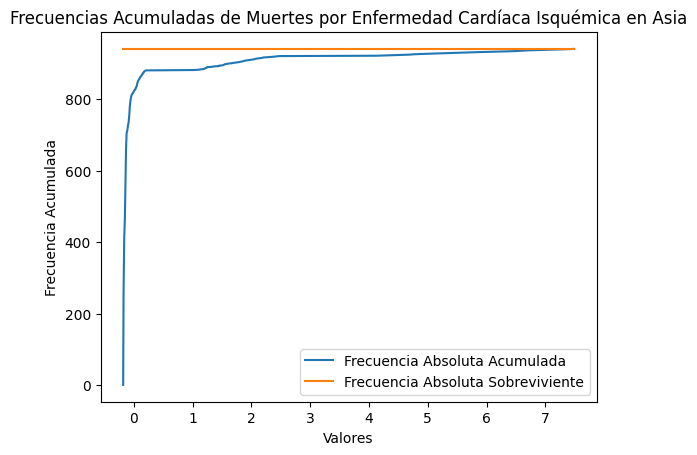

----------------------------------------------------------------------------------
Frecuencias Acumuladas de muertes por Enfermedades Cardiovasculares en Europa:
La Frecuencia Absoluta Complementaria por Muertes por Enfermedad Cardíaca Reumática es:
 Deaths - Cause: Rheumatic heart disease - Sex: Both sexes - Age group: ALLAges
-0.157634    799
-0.157624    799
-0.157623    799
-0.157622    799
-0.157612    799
            ... 
 0.599143    799
 0.646851    799
 0.652860    799
 0.663865    799
 0.714865    799
Name: count, Length: 783, dtype: int64
La Frecuencia Relativa Complementaria por Muertes por Enfermedad Cardíaca Reumática es:
 Deaths - Cause: Rheumatic heart disease - Sex: Both sexes - Age group: ALLAges
-0.157634    9.987500e-01
-0.157624    9.975000e-01
-0.157623    9.962500e-01
-0.157622    9.950000e-01
-0.157612    9.937500e-01
                 ...     
 0.599143    5.000000e-03
 0.646851    3.750000e-03
 0.652860    2.500000e-03
 0.663865    1.250000e-03
 0.714865    1.5

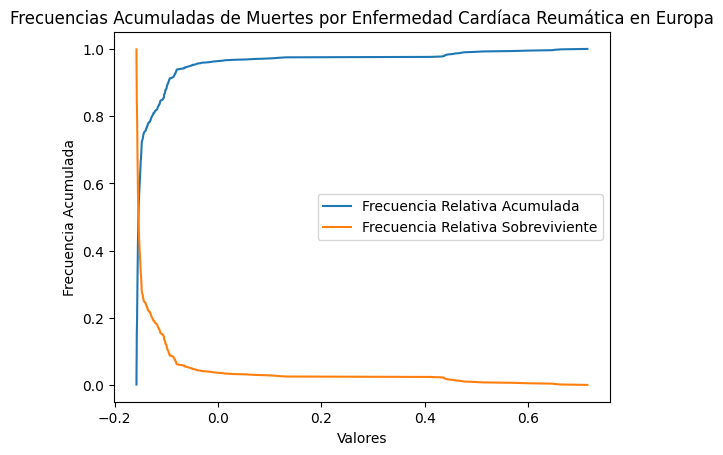

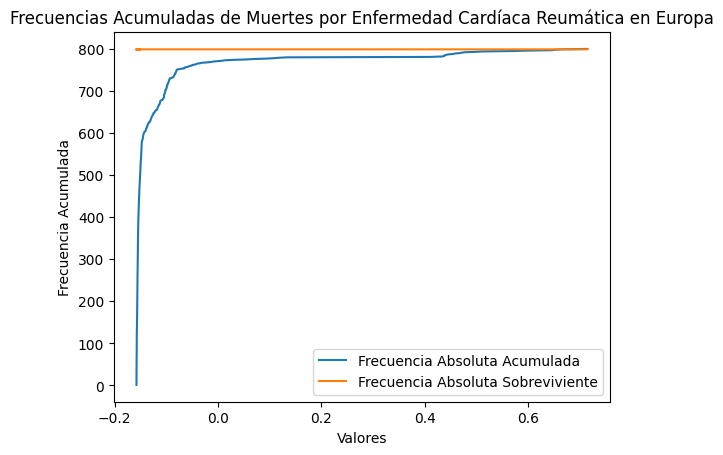

La Frecuencia Absoluta Complementaria por Muertes por Cardiomiopatía, Miocarditis y Endocarditis es:
 Deaths - Cause: Cardiomyopathy, myocarditis, endocarditis - Sex: Both sexes - Age group: ALLAges
-0.189041    799
-0.189019    799
-0.189016    799
-0.189005    799
-0.189002    799
            ... 
 5.665388    799
 5.836135    799
 5.845965    799
 5.853409    799
 5.991205    799
Name: count, Length: 799, dtype: int64
La Frecuencia Relativa Complementaria por Muertes por Cardiomiopatía, Miocarditis y Endocarditis es:
 Deaths - Cause: Cardiomyopathy, myocarditis, endocarditis - Sex: Both sexes - Age group: ALLAges
-0.189041    9.987500e-01
-0.189019    9.975000e-01
-0.189016    9.962500e-01
-0.189005    9.950000e-01
-0.189002    9.937500e-01
                 ...     
 5.665388    5.000000e-03
 5.836135    3.750000e-03
 5.845965    2.500000e-03
 5.853409    1.250000e-03
 5.991205    1.576517e-14
Name: count, Length: 799, dtype: float64


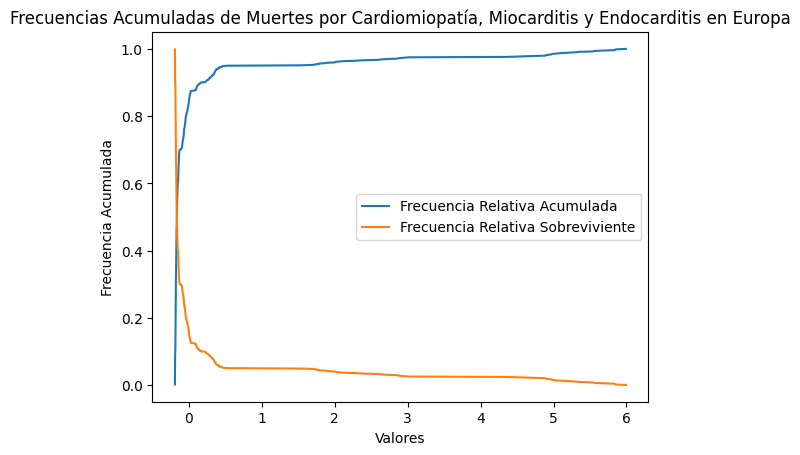

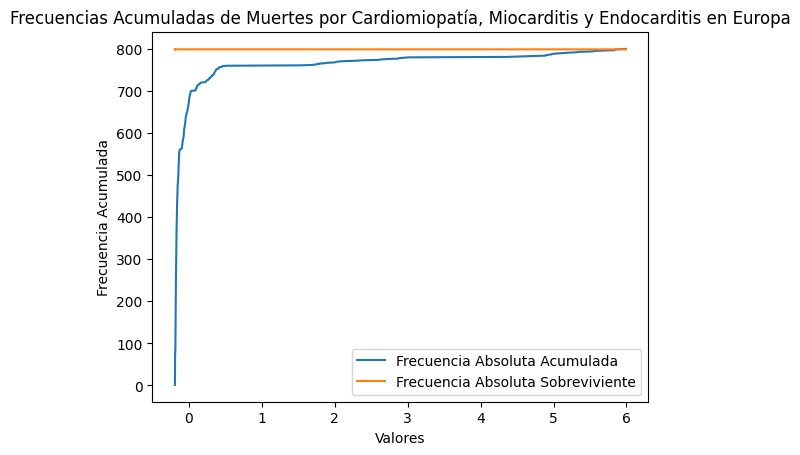

La Frecuencia Absoluta Complementaria por Muertes por Enfermedades Circulatorias es:
 Deaths - Cause: Other circulatory diseases - Sex: Both sexes - Age group: ALLAges
-0.190947    799
-0.190920    799
-0.190900    799
-0.190834    799
-0.190727    799
            ... 
 4.232024    799
 4.388285    799
 4.441143    799
 4.533261    799
 4.539361    799
Name: count, Length: 797, dtype: int64
La Frecuencia Relativa Complementaria por Muertes por Enfermedades Circulatorias es:
 Deaths - Cause: Other circulatory diseases - Sex: Both sexes - Age group: ALLAges
-0.190947    9.987500e-01
-0.190920    9.975000e-01
-0.190900    9.962500e-01
-0.190834    9.950000e-01
-0.190727    9.937500e-01
                 ...     
 4.232024    5.000000e-03
 4.388285    3.750000e-03
 4.441143    2.500000e-03
 4.533261    1.250000e-03
 4.539361    1.576517e-14
Name: count, Length: 797, dtype: float64


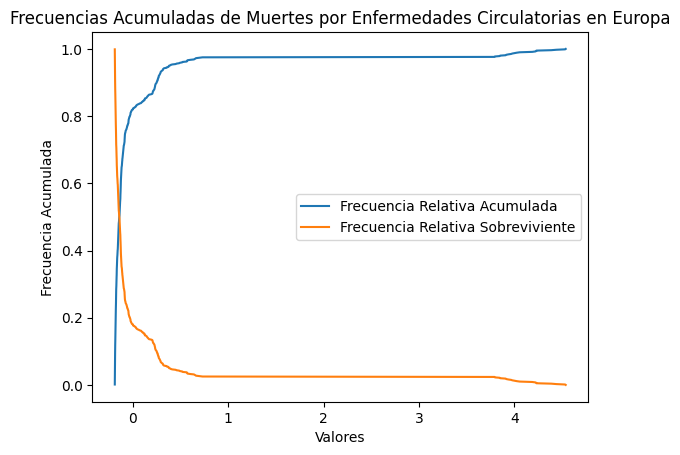

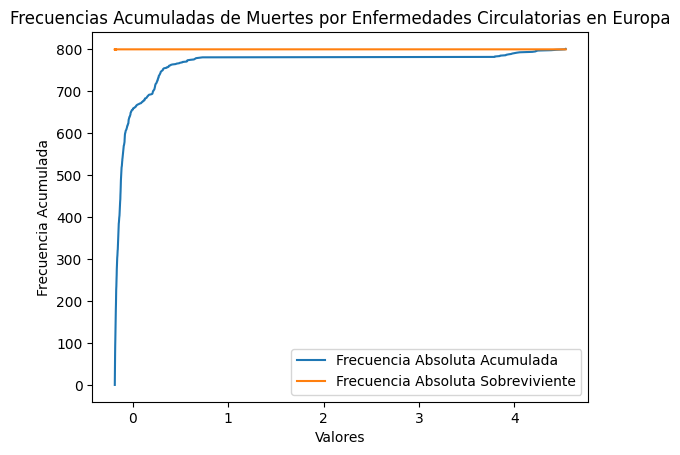

La Frecuencia Absoluta Complementaria por Muertes por Enfermedad Cardíaca Hipertensiva es:
 Deaths - Cause: Hypertensive heart disease - Sex: Both sexes - Age group: ALLAges
-0.180945    799
-0.180935    799
-0.180932    799
-0.180920    799
-0.180912    799
            ... 
 1.858711    799
 1.958052    799
 1.977970    799
 2.045636    799
 2.060574    799
Name: count, Length: 799, dtype: int64
La Frecuencia Relativa Complementaria por Muertes por Enfermedad Cardíaca Hipertensiva es:
 Deaths - Cause: Hypertensive heart disease - Sex: Both sexes - Age group: ALLAges
-0.180945    9.987500e-01
-0.180935    9.975000e-01
-0.180932    9.962500e-01
-0.180920    9.950000e-01
-0.180912    9.937500e-01
                 ...     
 1.858711    5.000000e-03
 1.958052    3.750000e-03
 1.977970    2.500000e-03
 2.045636    1.250000e-03
 2.060574    1.576517e-14
Name: count, Length: 799, dtype: float64


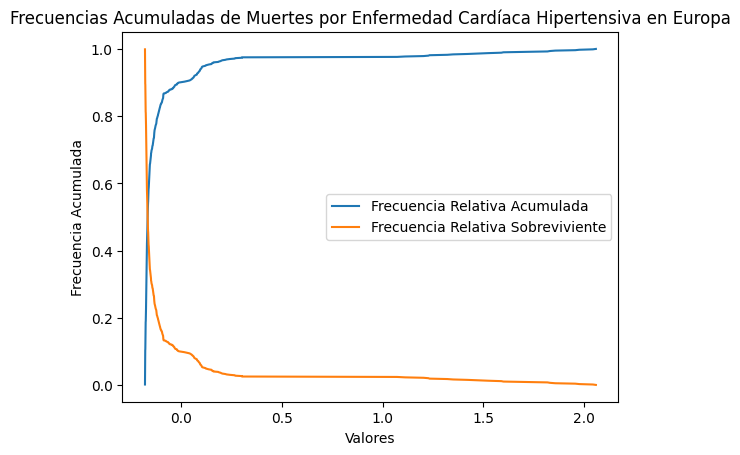

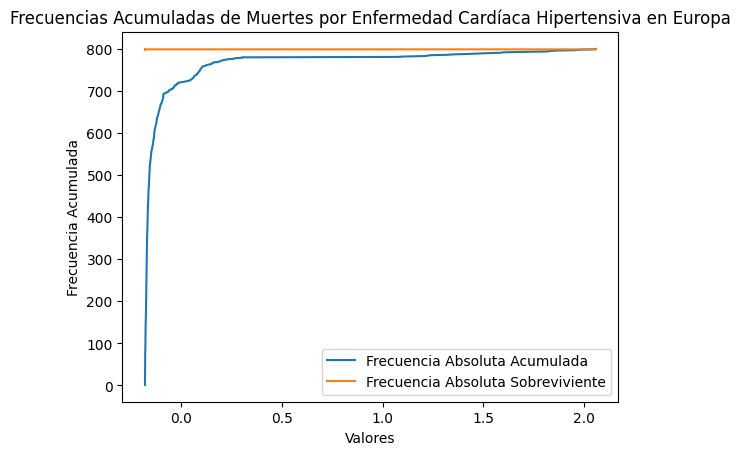

La Frecuencia Absoluta Complementaria por Muertes por Ictus Isquémico es:
 Deaths - Cause: Ischaemic stroke - Sex: Both sexes - Age group: ALLAges
-0.179292    799
-0.179284    799
-0.179279    799
-0.179278    799
-0.179276    799
            ... 
 3.458548    799
 3.603682    799
 3.619952    799
 3.679093    799
 3.729906    799
Name: count, Length: 799, dtype: int64
La Frecuencia Relativa Complementaria por Muertes por Ictus Isquémico es:
 Deaths - Cause: Ischaemic stroke - Sex: Both sexes - Age group: ALLAges
-0.179292    9.987500e-01
-0.179284    9.975000e-01
-0.179279    9.962500e-01
-0.179278    9.950000e-01
-0.179276    9.937500e-01
                 ...     
 3.458548    5.000000e-03
 3.603682    3.750000e-03
 3.619952    2.500000e-03
 3.679093    1.250000e-03
 3.729906    1.576517e-14
Name: count, Length: 799, dtype: float64


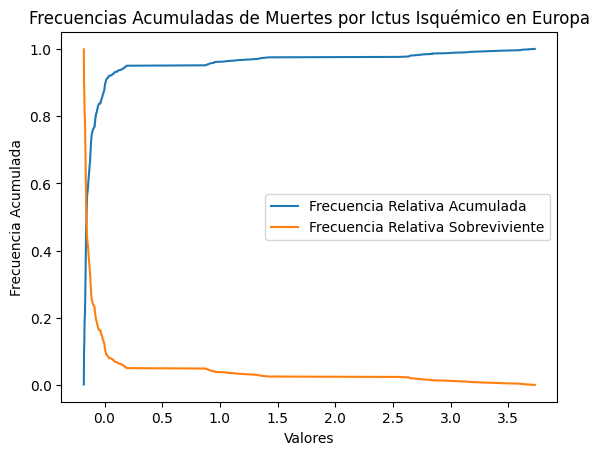

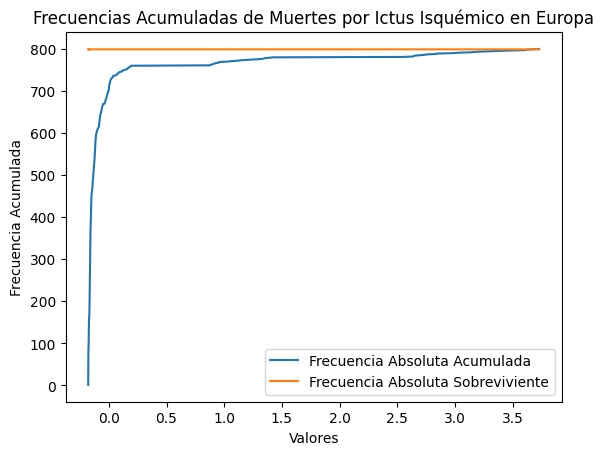

La Frecuencia Absoluta Complementaria por Muertes por Ictus Hemorrágico es:
 Deaths - Cause: Haemorrhagic stroke - Sex: Both sexes - Age group: ALLAges
-0.167562    799
-0.167559    799
-0.167559    799
-0.167554    799
-0.167552    799
            ... 
 1.031820    799
 1.066427    799
 1.068638    799
 1.088859    799
 1.097636    799
Name: count, Length: 800, dtype: int64
La Frecuencia Relativa Complementaria por Muertes por Ictus Hemorrágico es:
 Deaths - Cause: Haemorrhagic stroke - Sex: Both sexes - Age group: ALLAges
-0.167562    9.987500e-01
-0.167559    9.975000e-01
-0.167559    9.962500e-01
-0.167554    9.950000e-01
-0.167552    9.937500e-01
                 ...     
 1.031820    5.000000e-03
 1.066427    3.750000e-03
 1.068638    2.500000e-03
 1.088859    1.250000e-03
 1.097636    1.576517e-14
Name: count, Length: 800, dtype: float64


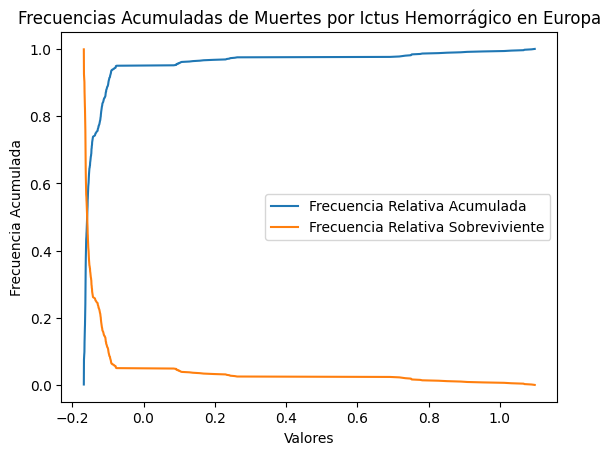

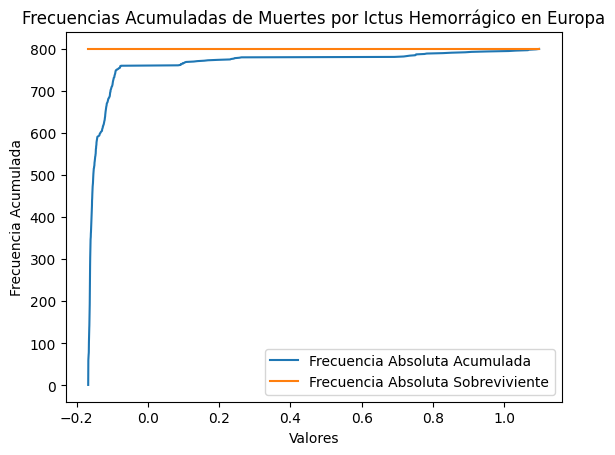

La Frecuencia Absoluta Complementaria por Muertes por Enfermedad Cardíaca Isquémica es:
 Deaths - Cause: Ischaemic heart disease - Sex: Both sexes - Age group: ALLAges
-0.183759    799
-0.183758    799
-0.183742    799
-0.183738    799
-0.183729    799
            ... 
 3.259792    799
 3.267359    799
 3.284078    799
 3.360220    799
 3.434178    799
Name: count, Length: 800, dtype: int64
La Frecuencia Relativa Complementaria por Muertes por Enfermedad Cardíaca Isquémica es:
 Deaths - Cause: Ischaemic heart disease - Sex: Both sexes - Age group: ALLAges
-0.183759    9.987500e-01
-0.183758    9.975000e-01
-0.183742    9.962500e-01
-0.183738    9.950000e-01
-0.183729    9.937500e-01
                 ...     
 3.259792    5.000000e-03
 3.267359    3.750000e-03
 3.284078    2.500000e-03
 3.360220    1.250000e-03
 3.434178    1.576517e-14
Name: count, Length: 800, dtype: float64


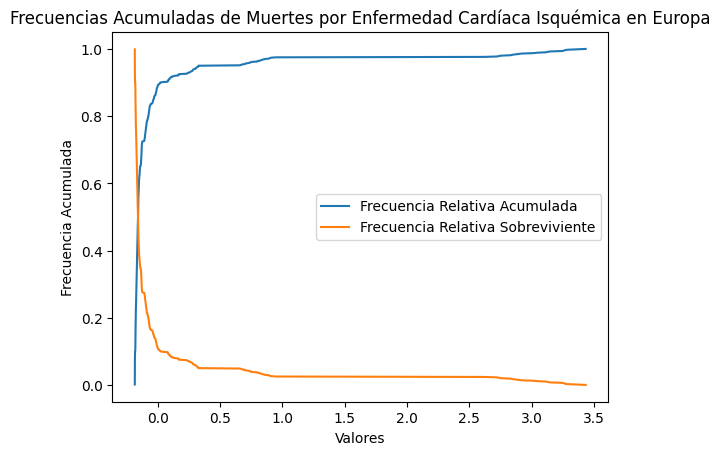

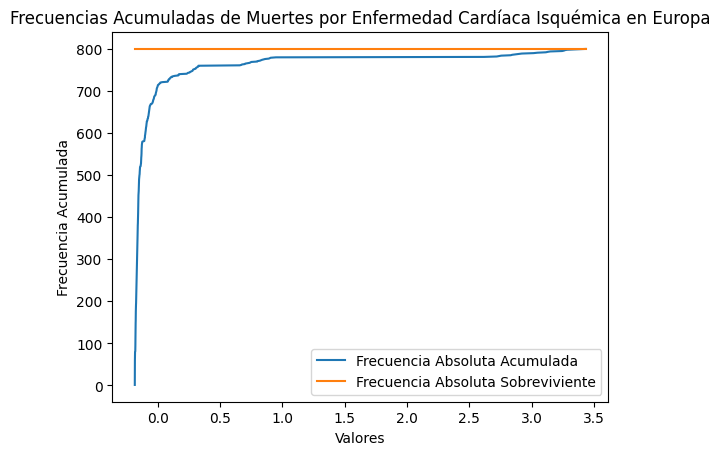

----------------------------------------------------------------------------------
Frecuencias Acumuladas de muertes por Enfermedades Cardiovasculares en Oceania:
La Frecuencia Absoluta Complementaria por Muertes por Enfermedad Cardíaca Reumática es:
 Deaths - Cause: Rheumatic heart disease - Sex: Both sexes - Age group: ALLAges
-0.157576    219
-0.157573    219
-0.157570    219
-0.157570    219
-0.157565    219
            ... 
-0.101739    219
-0.101411    219
-0.101060    219
-0.100431    219
-0.100331    219
Name: count, Length: 214, dtype: int64
La Frecuencia Relativa Complementaria por Muertes por Enfermedad Cardíaca Reumática es:
 Deaths - Cause: Rheumatic heart disease - Sex: Both sexes - Age group: ALLAges
-0.157576    9.954545e-01
-0.157573    9.909091e-01
-0.157570    9.863636e-01
-0.157570    9.818182e-01
-0.157565    9.772727e-01
                 ...     
-0.101739    1.818182e-02
-0.101411    1.363636e-02
-0.101060    9.090909e-03
-0.100431    4.545455e-03
-0.100331    4.

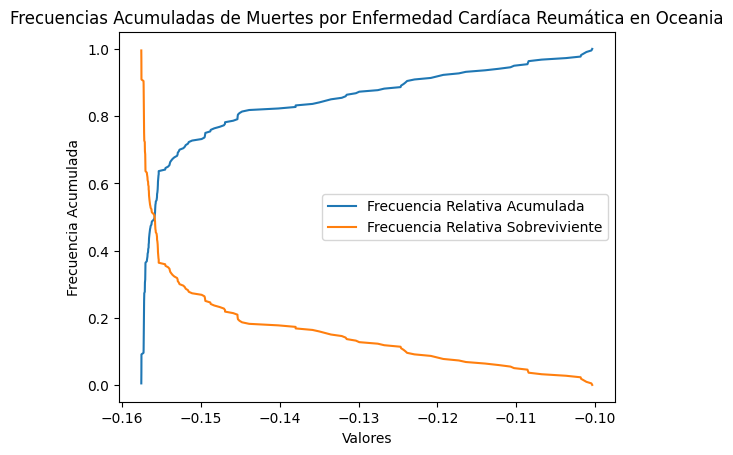

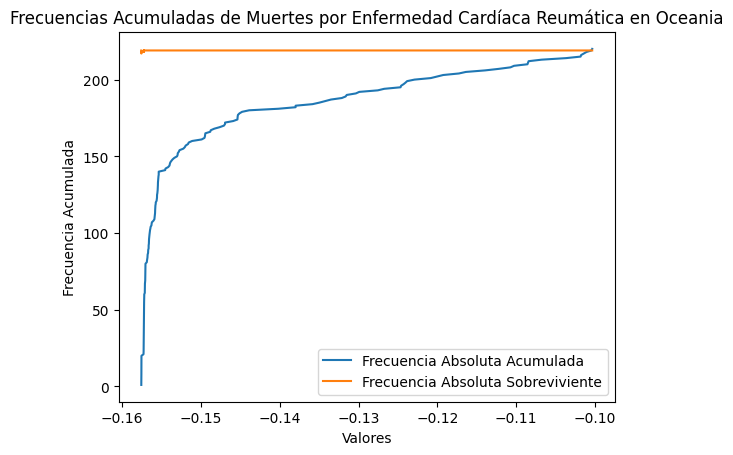

La Frecuencia Absoluta Complementaria por Muertes por Cardiomiopatía, Miocarditis y Endocarditis es:
 Deaths - Cause: Cardiomyopathy, myocarditis, endocarditis - Sex: Both sexes - Age group: ALLAges
-0.189191    219
-0.189189    219
-0.189188    218
-0.189186    219
-0.189185    219
            ... 
-0.113579    219
-0.111789    219
-0.111524    219
-0.110023    219
-0.110008    219
Name: count, Length: 212, dtype: int64
La Frecuencia Relativa Complementaria por Muertes por Cardiomiopatía, Miocarditis y Endocarditis es:
 Deaths - Cause: Cardiomyopathy, myocarditis, endocarditis - Sex: Both sexes - Age group: ALLAges
-0.189191    9.954545e-01
-0.189189    9.909091e-01
-0.189188    9.818182e-01
-0.189186    9.772727e-01
-0.189185    9.727273e-01
                 ...     
-0.113579    1.818182e-02
-0.111789    1.363636e-02
-0.111524    9.090909e-03
-0.110023    4.545455e-03
-0.110008    4.107825e-15
Name: count, Length: 212, dtype: float64


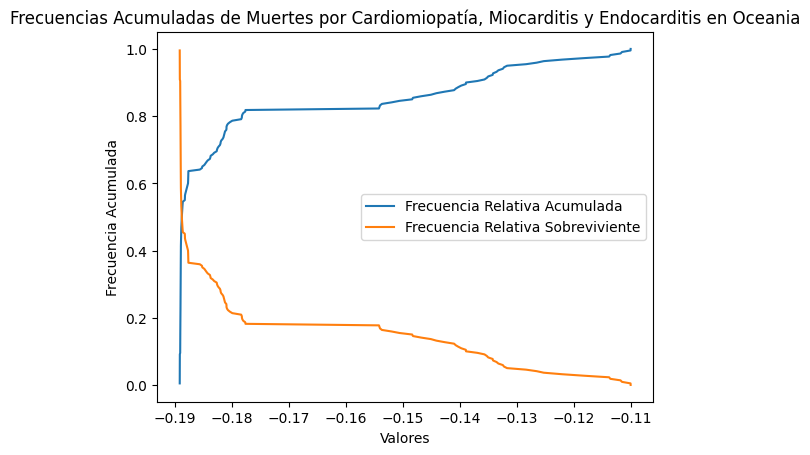

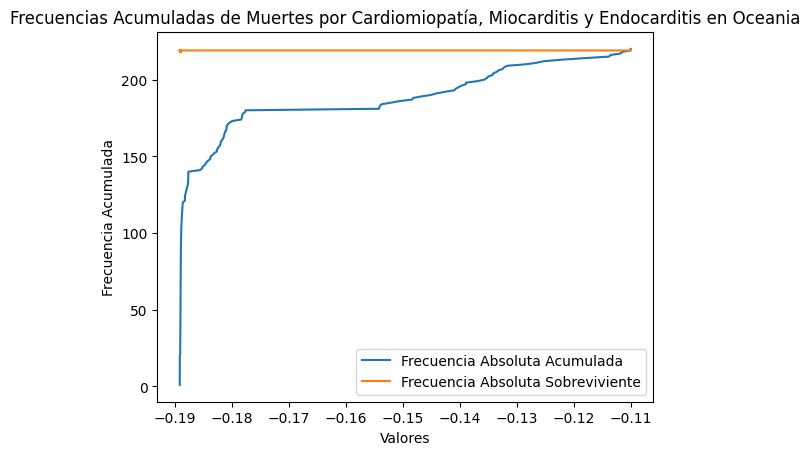

La Frecuencia Absoluta Complementaria por Muertes por Enfermedades Circulatorias es:
 Deaths - Cause: Other circulatory diseases - Sex: Both sexes - Age group: ALLAges
-0.191628    218
-0.191626    219
-0.191625    219
-0.191624    219
-0.191622    219
            ... 
-0.061009    219
-0.058516    219
-0.057676    219
-0.056901    219
-0.056837    219
Name: count, Length: 216, dtype: int64
La Frecuencia Relativa Complementaria por Muertes por Enfermedades Circulatorias es:
 Deaths - Cause: Other circulatory diseases - Sex: Both sexes - Age group: ALLAges
-0.191628    9.909091e-01
-0.191626    9.863636e-01
-0.191625    9.818182e-01
-0.191624    9.772727e-01
-0.191622    9.727273e-01
                 ...     
-0.061009    1.818182e-02
-0.058516    1.363636e-02
-0.057676    9.090909e-03
-0.056901    4.545455e-03
-0.056837    4.218847e-15
Name: count, Length: 216, dtype: float64


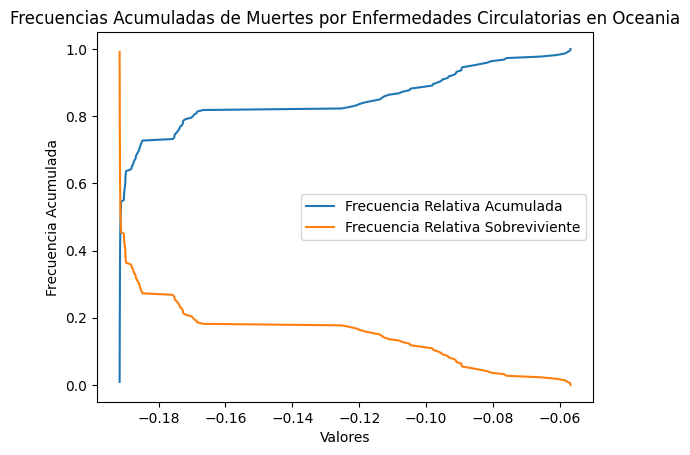

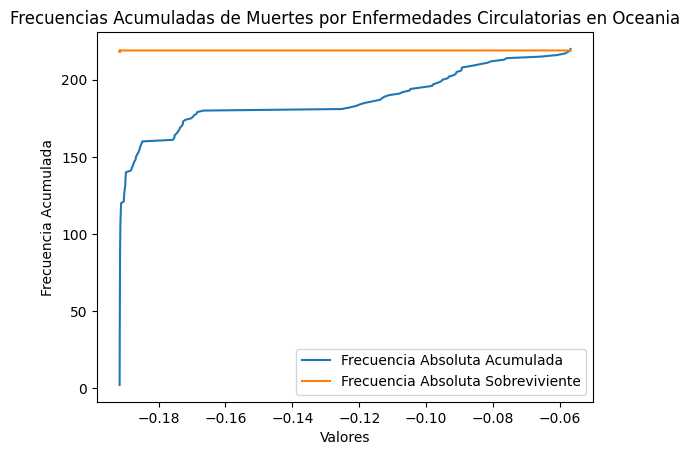

La Frecuencia Absoluta Complementaria por Muertes por Enfermedad Cardíaca Hipertensiva es:
 Deaths - Cause: Hypertensive heart disease - Sex: Both sexes - Age group: ALLAges
-0.181041    219
-0.181041    219
-0.181039    218
-0.181039    219
-0.181039    219
            ... 
-0.138750    219
-0.138346    219
-0.137691    219
-0.137360    219
-0.136525    219
Name: count, Length: 216, dtype: int64
La Frecuencia Relativa Complementaria por Muertes por Enfermedad Cardíaca Hipertensiva es:
 Deaths - Cause: Hypertensive heart disease - Sex: Both sexes - Age group: ALLAges
-0.181041    9.954545e-01
-0.181041    9.909091e-01
-0.181039    9.818182e-01
-0.181039    9.772727e-01
-0.181039    9.727273e-01
                 ...     
-0.138750    1.818182e-02
-0.138346    1.363636e-02
-0.137691    9.090909e-03
-0.137360    4.545455e-03
-0.136525    4.218847e-15
Name: count, Length: 216, dtype: float64


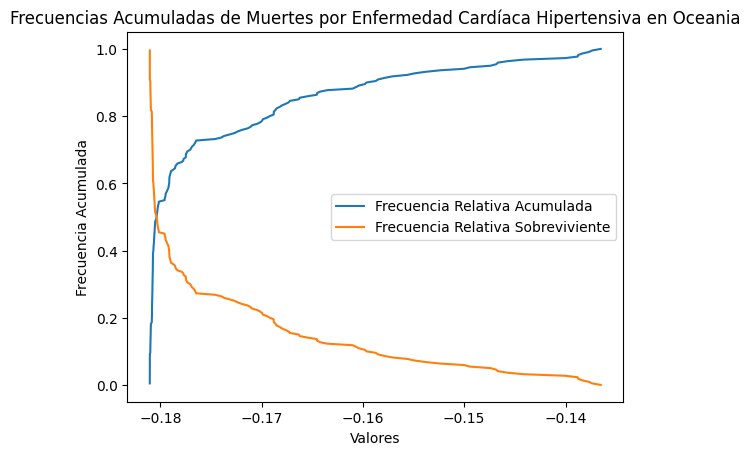

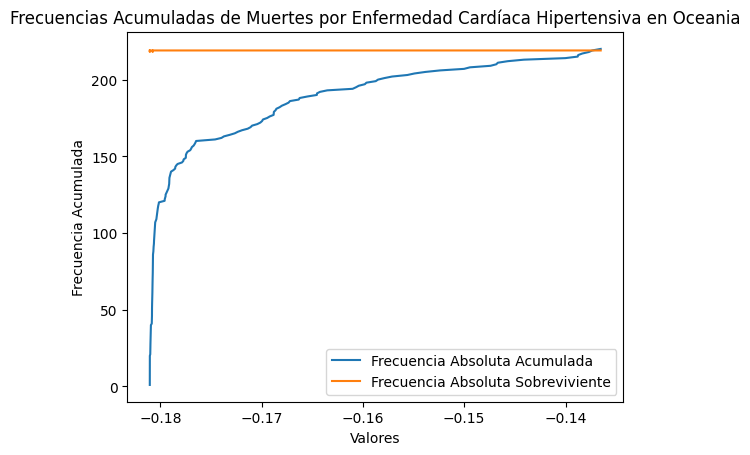

La Frecuencia Absoluta Complementaria por Muertes por Ictus Isquémico es:
 Deaths - Cause: Ischaemic stroke - Sex: Both sexes - Age group: ALLAges
-0.179604    219
-0.179604    219
-0.179602    219
-0.179601    219
-0.179601    218
            ... 
-0.134258    219
-0.134179    219
-0.134035    219
-0.134016    219
-0.133218    219
Name: count, Length: 218, dtype: int64
La Frecuencia Relativa Complementaria por Muertes por Ictus Isquémico es:
 Deaths - Cause: Ischaemic stroke - Sex: Both sexes - Age group: ALLAges
-0.179604    9.954545e-01
-0.179604    9.909091e-01
-0.179602    9.863636e-01
-0.179601    9.818182e-01
-0.179601    9.727273e-01
                 ...     
-0.134258    1.818182e-02
-0.134179    1.363636e-02
-0.134035    9.090909e-03
-0.134016    4.545455e-03
-0.133218    4.218847e-15
Name: count, Length: 218, dtype: float64


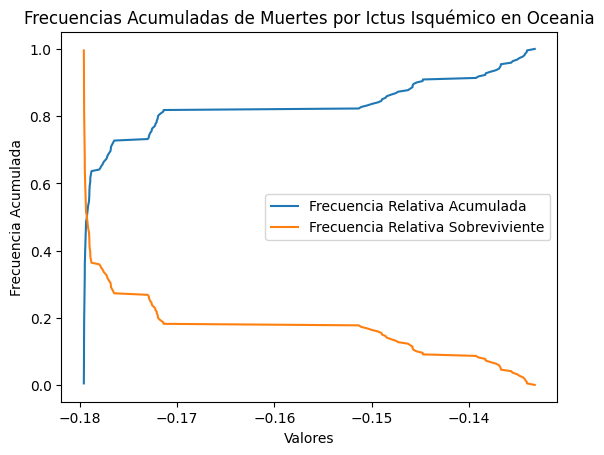

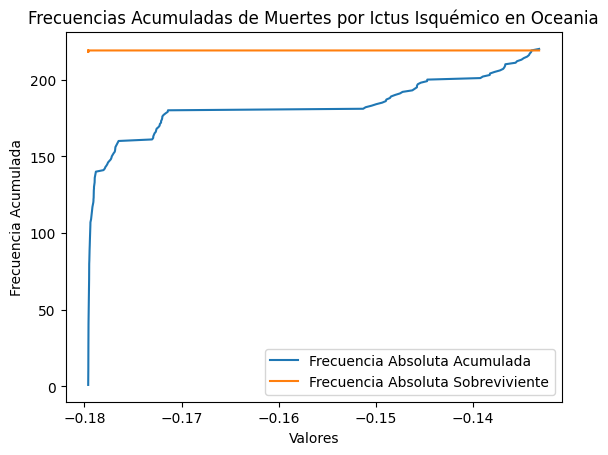

La Frecuencia Absoluta Complementaria por Muertes por Ictus Hemorrágico es:
 Deaths - Cause: Haemorrhagic stroke - Sex: Both sexes - Age group: ALLAges
-0.167612    219
-0.167610    219
-0.167608    219
-0.167607    219
-0.167607    219
            ... 
-0.133616    219
-0.133329    219
-0.133314    219
-0.133127    219
-0.132676    219
Name: count, Length: 219, dtype: int64
La Frecuencia Relativa Complementaria por Muertes por Ictus Hemorrágico es:
 Deaths - Cause: Haemorrhagic stroke - Sex: Both sexes - Age group: ALLAges
-0.167612    9.954545e-01
-0.167610    9.909091e-01
-0.167608    9.863636e-01
-0.167607    9.818182e-01
-0.167607    9.772727e-01
                 ...     
-0.133616    1.818182e-02
-0.133329    1.363636e-02
-0.133314    9.090909e-03
-0.133127    4.545455e-03
-0.132676    4.218847e-15
Name: count, Length: 219, dtype: float64


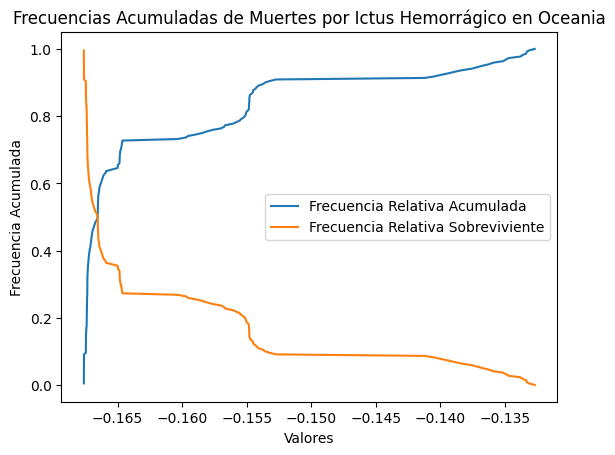

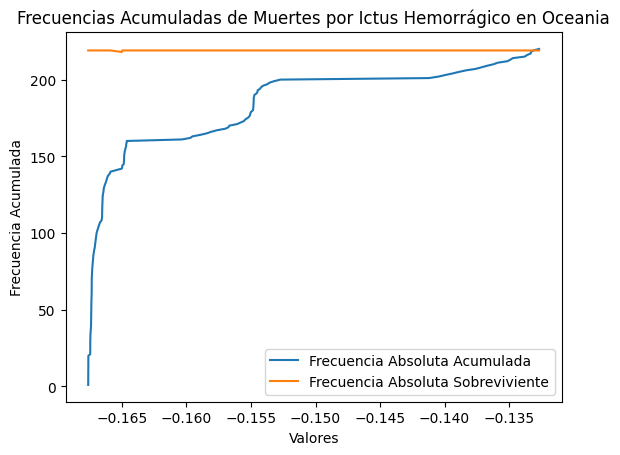

La Frecuencia Absoluta Complementaria por Muertes por Enfermedad Cardíaca Isquémica es:
 Deaths - Cause: Ischaemic heart disease - Sex: Both sexes - Age group: ALLAges
-0.184249    219
-0.184247    219
-0.184245    219
-0.184244    219
-0.184243    219
            ... 
-0.124665    219
-0.124218    219
-0.123945    219
-0.123669    219
-0.123455    219
Name: count, Length: 220, dtype: int64
La Frecuencia Relativa Complementaria por Muertes por Enfermedad Cardíaca Isquémica es:
 Deaths - Cause: Ischaemic heart disease - Sex: Both sexes - Age group: ALLAges
-0.184249    9.954545e-01
-0.184247    9.909091e-01
-0.184245    9.863636e-01
-0.184244    9.818182e-01
-0.184243    9.772727e-01
                 ...     
-0.124665    1.818182e-02
-0.124218    1.363636e-02
-0.123945    9.090909e-03
-0.123669    4.545455e-03
-0.123455    4.218847e-15
Name: count, Length: 220, dtype: float64


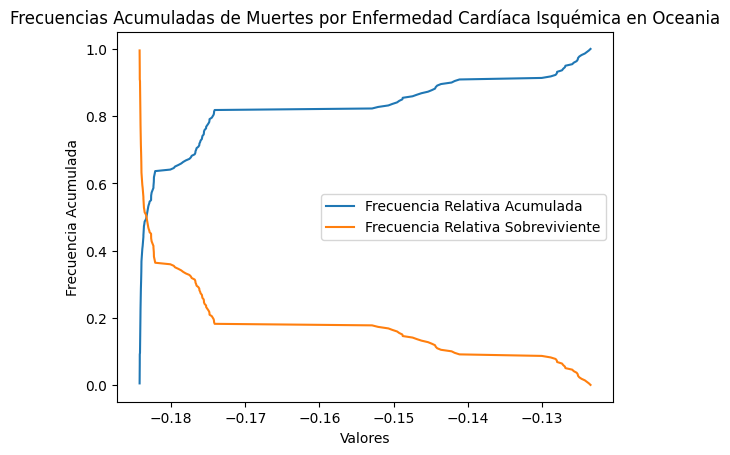

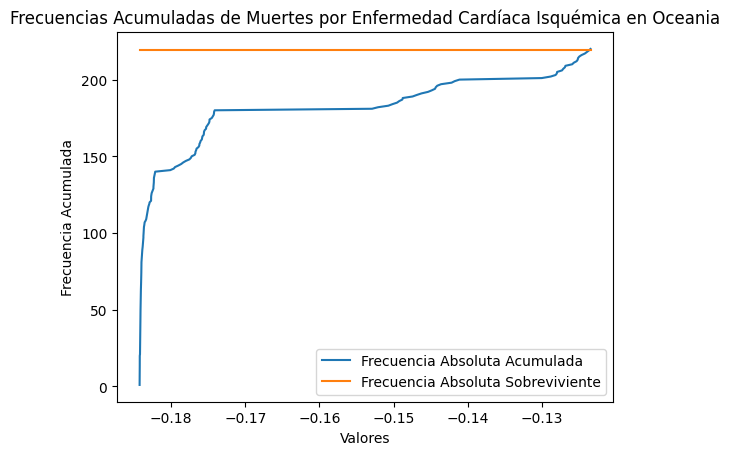

----------------------------------------------------------------------------------


In [ ]:
resultados = []

# Función para calcular la frecuencia absoluta de una serie de datos
def calcular_frecuencia_absoluta(data):
    return data.value_counts().sort_index()

# Iterar sobre los resultados
for continente, paises in continentes.items():
    df_continente = df[df['Entity'].isin(paises)]
    print(f"Frecuencias Acumuladas de muertes por Enfermedades Cardiovasculares en {continente}:")

    for patologia in patologias:
        data_patologia = df_continente[patologia]
        Fabs = calcular_frecuencia_absoluta(data_patologia)
        total_observaciones = len(data_patologia)

        # Calcular la frecuencia absoluta acumulada
        Fabs_acum = Fabs.cumsum()

        # Calcular la frecuencia relativa acumulada
        Frel_acum = Fabs / total_observaciones
        Frel_acum = Frel_acum.cumsum()

        # Calcular la frecuencia absoluta complementaria
        Fabs_complementaria = total_observaciones - Fabs

        # Calcular la frecuencia relativa complementaria
        Frel_complementaria = 1 - Frel_acum

        patologia_legible = reemplazar_texto(patologia)

        print(f"La Frecuencia Absoluta Complementaria por {patologia_legible} es:\n {Fabs_complementaria}")
        print(f"La Frecuencia Relativa Complementaria por {patologia_legible} es:\n {Frel_complementaria}")

        resultados.append({
            'Continente': continente,
            'Patologia': patologia_legible,
            'Frecuencia Absoluta': Fabs,
            'Frecuencia Absoluta Acumulada': Fabs_acum,
            'Frecuencia Absoluta Sobreviviente': Fabs_complementaria,
            'Frecuencia Relativa': Frel_acum,
            'Frecuencia Relativa Sobreviviente': Frel_complementaria
        })


        # Crear una nueva figura para cada combinación de enfermedad y continente
        plt.figure()
        plt.plot(Frel_acum.index, Frel_acum.values, label='Frecuencia Relativa Acumulada')
        plt.plot(Frel_complementaria.index, Frel_complementaria.values, label='Frecuencia Relativa Sobreviviente')
        plt.title(f'Frecuencias Acumuladas de {patologia_legible} en {continente}')
        plt.xlabel('Valores')
        plt.ylabel('Frecuencia Acumulada')
        plt.legend()
        plt.show()

        plt.figure()
        plt.plot(Fabs_acum.index, Fabs_acum.values, label='Frecuencia Absoluta Acumulada')
        plt.plot(Fabs_complementaria.index, Fabs_complementaria.values, label='Frecuencia Absoluta Sobreviviente')
        plt.title(f'Frecuencias Acumuladas de {patologia_legible} en {continente}')
        plt.xlabel('Valores')
        plt.ylabel('Frecuencia Acumulada')
        plt.legend()
        plt.show()

    print("----------------------------------------------------------------------------------")


### Año contra número de muertes

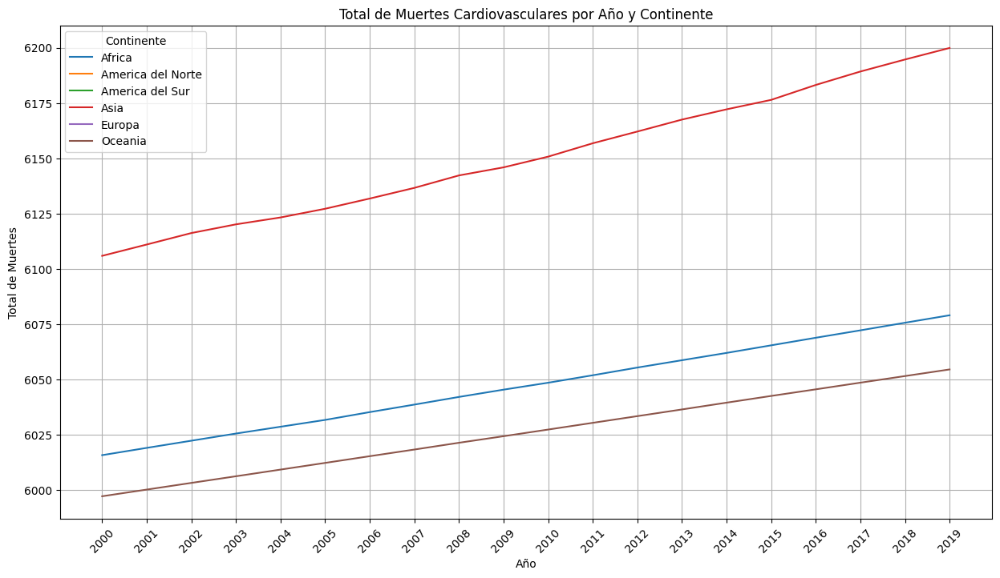

In [ ]:
# Crear una nueva columna para la suma de muertes por año
df['Total_deaths'] = df.iloc[:, 2:].sum(axis=1)

# Filtrar los datos para el rango de años del 2000 al 2019
df_filtrado = df[(df['Year'] >= 2000) & (df['Year'] <= 2019)]


# Calcular la suma total de muertes por año para cada continente
resultados = []

for continente in continentes:
    df_continente = df_filtrado[df_filtrado['Entity'] == continente]
    total_muertes_por_ano = df_continente.groupby('Year')['Total_deaths'].sum().reset_index()
    resultados.append({
        'Continente': continente,
        'Total_muertes_por_ano': total_muertes_por_ano
    })

# Graficar la suma total de muertes por año para cada continente
plt.figure(figsize=(15, 8))

for resultado in resultados:
    plt.plot(resultado['Total_muertes_por_ano']['Year'], resultado['Total_muertes_por_ano']['Total_deaths'], label=resultado['Continente'])

plt.title('Total de Muertes Cardiovasculares por Año y Continente')
plt.xlabel('Año')
plt.ylabel('Total de Muertes')
plt.legend(title='Continente')
plt.xticks(ticks=range(2000, 2020), rotation=45)
plt.grid(True)
plt.show()


# Funciones

## Función de densidad probabilidad

Densidad de probabilidad por Enfermedades Cardiovasculares en Africa
La densidad de probabilidad por Muertes por Enfermedad Cardíaca Reumática es:
20      20652.88
21      20340.27
22      20017.19
23      19723.10
24      19457.38
          ...   
3795      618.66
3796      597.51
3797      541.70
3798      545.40
3799      541.98
Name: Deaths - Cause: Rheumatic heart disease - Sex: Both sexes - Age group: ALLAges, Length: 1080, dtype: float64


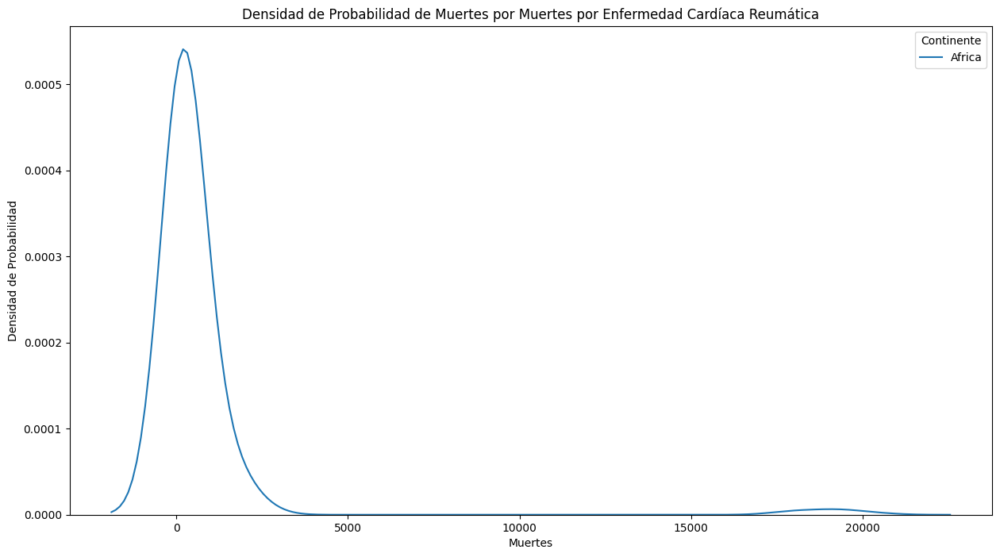

La densidad de probabilidad por Muertes por Cardiomiopatía, Miocarditis y Endocarditis es:
20      32611.670
21      32585.830
22      32576.389
23      32658.700
24      32853.600
          ...    
3795     1055.110
3796     1064.810
3797     1022.380
3798     1038.750
3799     1047.290
Name: Deaths - Cause: Cardiomyopathy, myocarditis, endocarditis - Sex: Both sexes - Age group: ALLAges, Length: 1080, dtype: float64


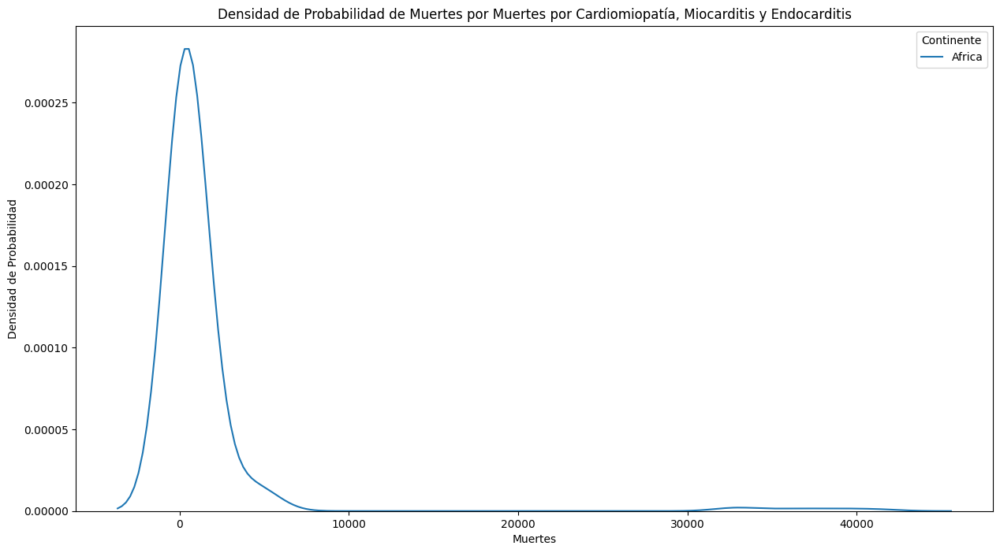

La densidad de probabilidad por Muertes por Enfermedades Circulatorias es:
20      60564.500
21      61688.790
22      62631.582
23      63377.430
24      63951.310
          ...    
3795     1052.810
3796     1038.830
3797      978.250
3798      969.450
3799      981.540
Name: Deaths - Cause: Other circulatory diseases - Sex: Both sexes - Age group: ALLAges, Length: 1080, dtype: float64


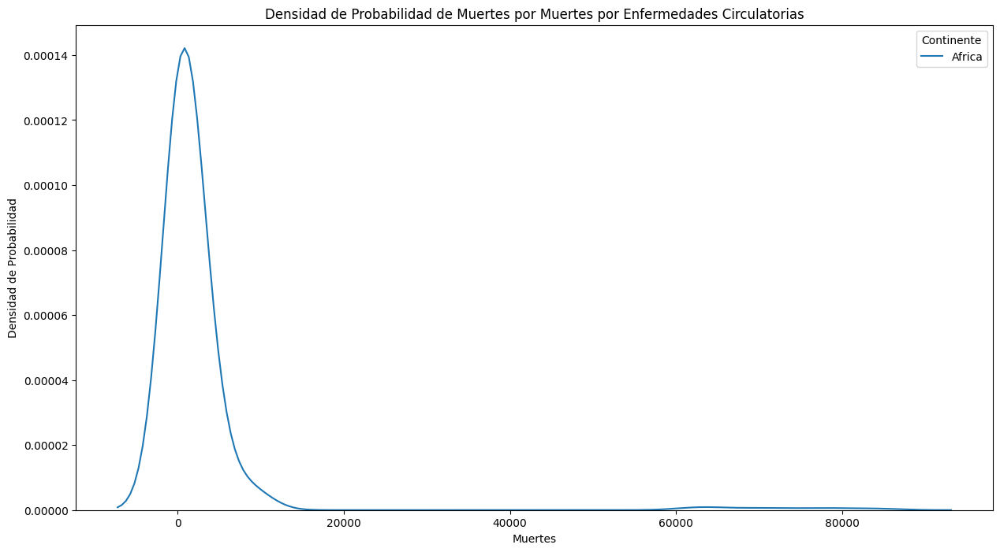

La densidad de probabilidad por Muertes por Enfermedad Cardíaca Hipertensiva es:
20      122396.990
21      125411.290
22      127943.695
23      130316.445
24      130757.390
           ...    
3795      1211.880
3796      1199.650
3797      1156.830
3798      1129.130
3799      1145.780
Name: Deaths - Cause: Hypertensive heart disease - Sex: Both sexes - Age group: ALLAges, Length: 1080, dtype: float64


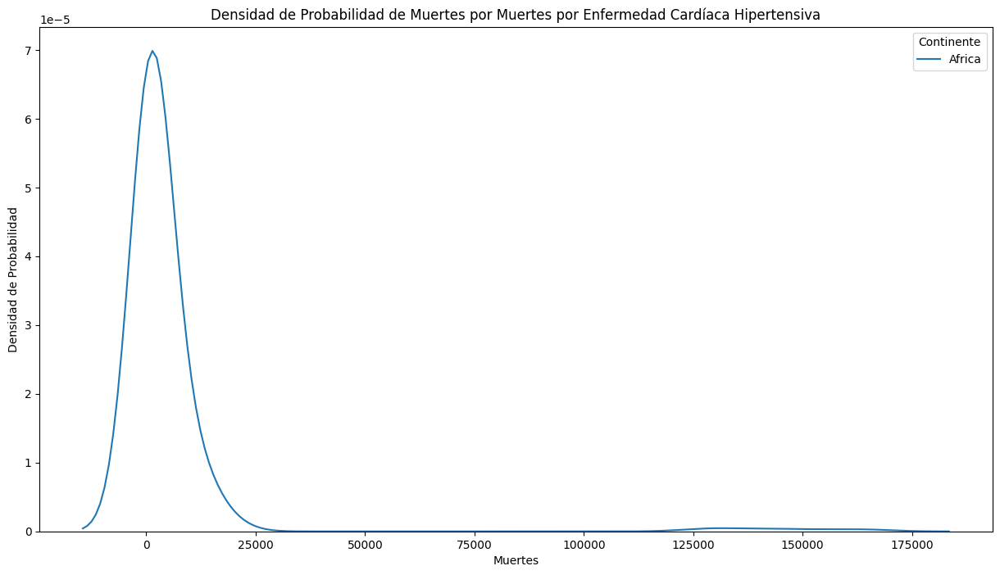

La densidad de probabilidad por Muertes por Ictus Isquémico es:
20      131442.28
21      138499.86
22      144517.90
23      149571.60
24      152024.19
          ...    
3795      2628.12
3796      2662.93
3797      2654.53
3798      2658.32
3799      2687.51
Name: Deaths - Cause: Ischaemic stroke - Sex: Both sexes - Age group: ALLAges, Length: 1080, dtype: float64


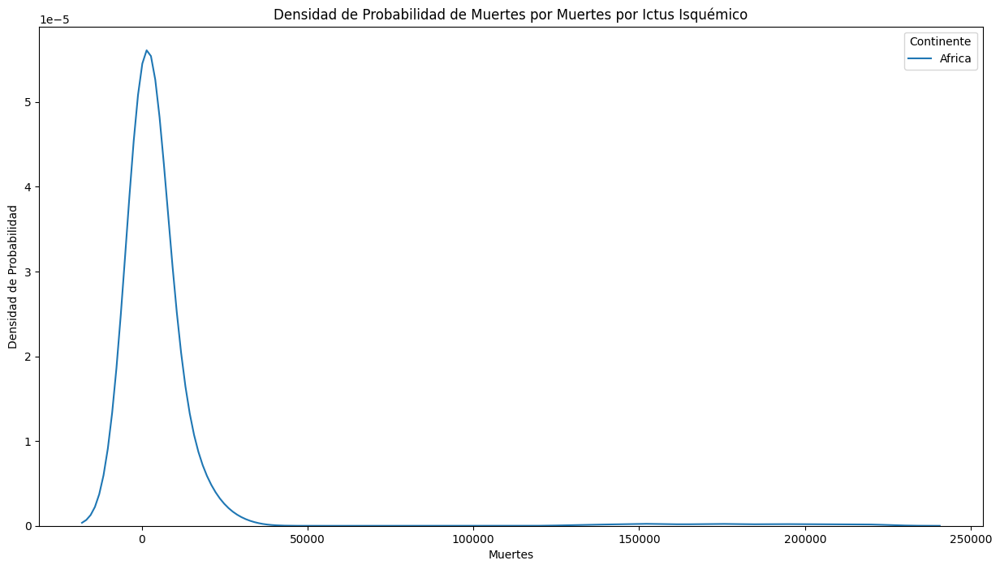

La densidad de probabilidad por Muertes por Ictus Hemorrágico es:
20      282707.80
21      282171.97
22      282108.34
23      282706.44
24      282320.30
          ...    
3795      2682.15
3796      2609.71
3797      2470.35
3798      2401.51
3799      2438.44
Name: Deaths - Cause: Haemorrhagic stroke - Sex: Both sexes - Age group: ALLAges, Length: 1080, dtype: float64


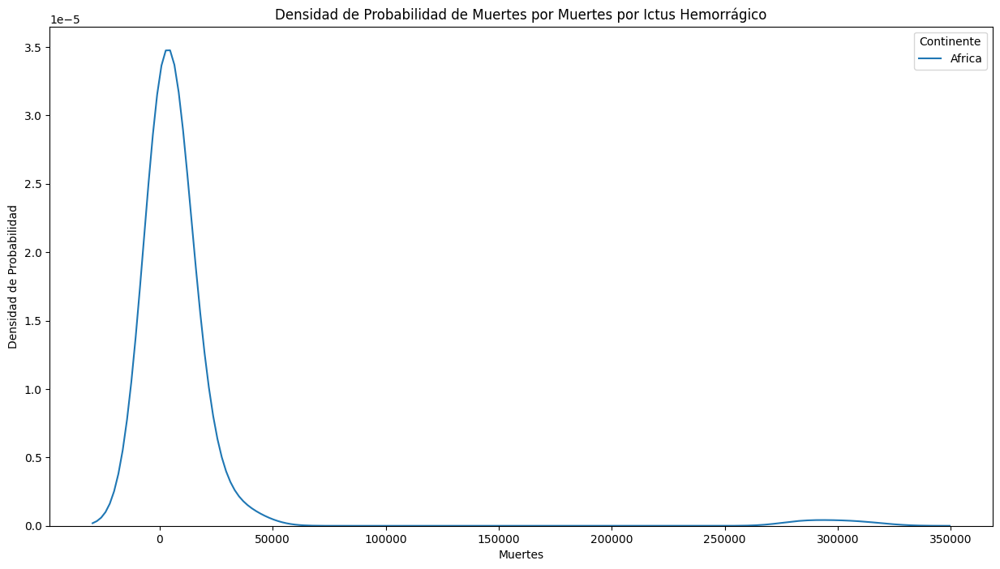

La densidad de probabilidad por Muertes por Enfermedad Cardíaca Isquémica es:
20      502657.47
21      519629.30
22      533255.90
23      547955.60
24      552138.44
          ...    
3795      8421.01
3796      8453.12
3797      8335.44
3798      8300.45
3799      8492.90
Name: Deaths - Cause: Ischaemic heart disease - Sex: Both sexes - Age group: ALLAges, Length: 1080, dtype: float64


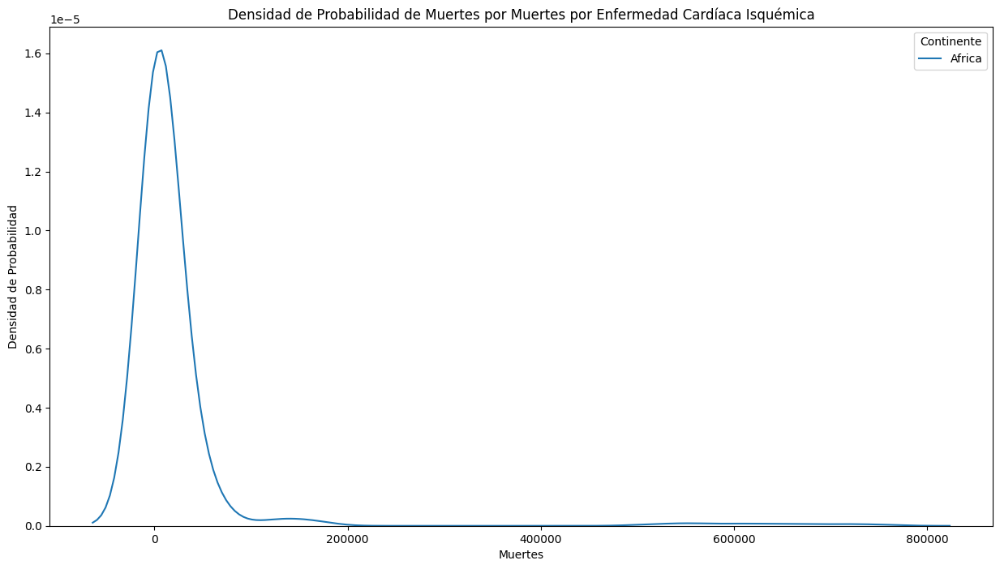

Densidad de probabilidad por Enfermedades Cardiovasculares en America del Norte
La densidad de probabilidad por Muertes por Enfermedad Cardíaca Reumática es:
100        0.19
101        0.67
102        1.00
103        0.31
104        0.26
         ...   
3615    3397.11
3616    3588.28
3617    3354.32
3618    3584.59
3619    3645.89
Name: Deaths - Cause: Rheumatic heart disease - Sex: Both sexes - Age group: ALLAges, Length: 440, dtype: float64


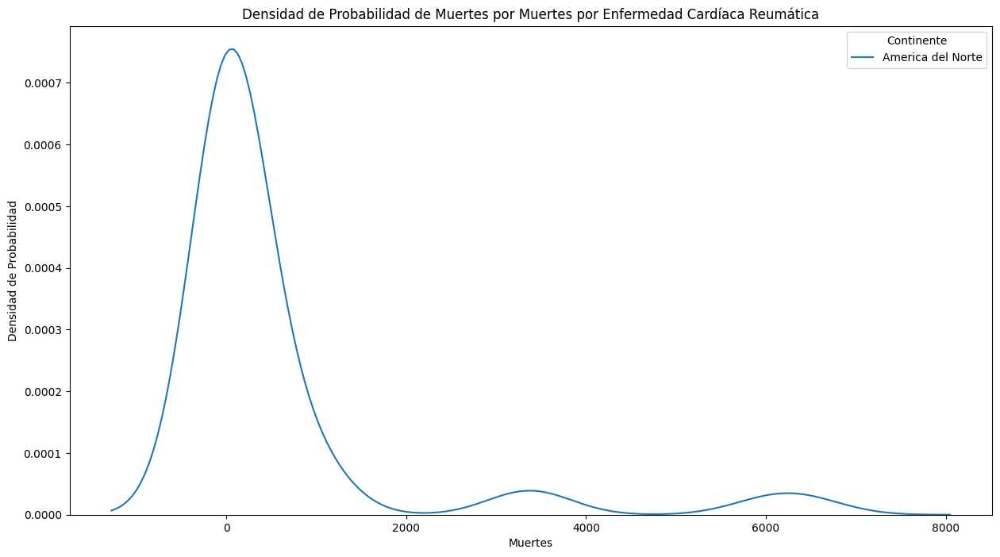

La densidad de probabilidad por Muertes por Cardiomiopatía, Miocarditis y Endocarditis es:
100         1.23
101         1.67
102         2.05
103         4.99
104         5.71
          ...   
3615    31910.80
3616    30750.40
3617    30142.95
3618    32018.99
3619    32529.12
Name: Deaths - Cause: Cardiomyopathy, myocarditis, endocarditis - Sex: Both sexes - Age group: ALLAges, Length: 440, dtype: float64


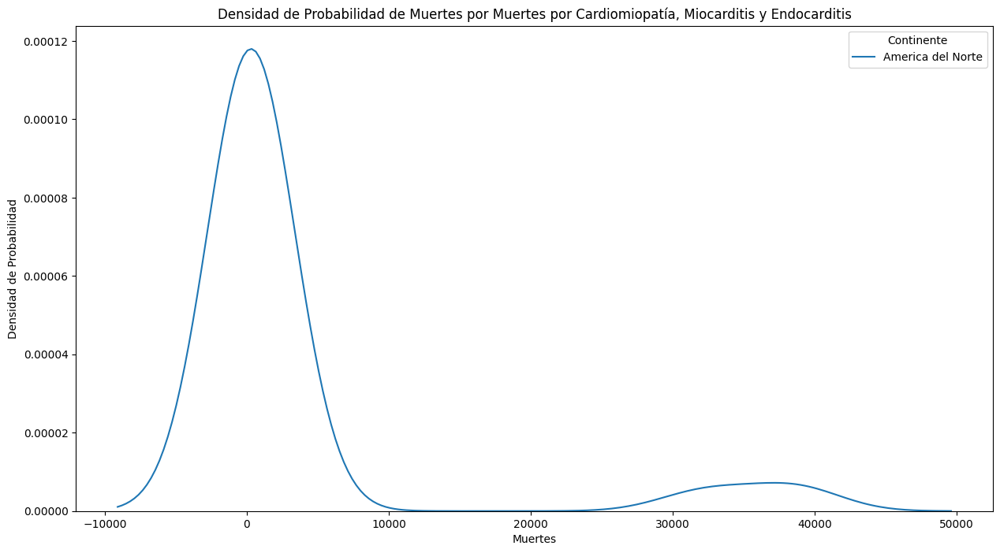

La densidad de probabilidad por Muertes por Enfermedades Circulatorias es:
100         14.52
101         17.67
102         20.69
103         18.76
104         20.30
          ...    
3615    100079.80
3616    101940.10
3617    103794.40
3618    105984.20
3619    107640.80
Name: Deaths - Cause: Other circulatory diseases - Sex: Both sexes - Age group: ALLAges, Length: 440, dtype: float64


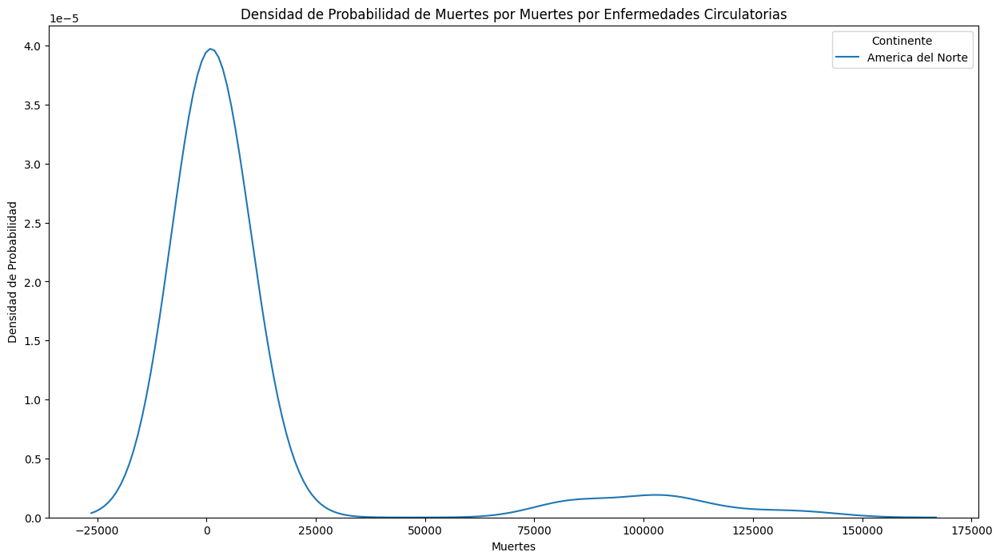

La densidad de probabilidad por Muertes por Enfermedad Cardíaca Hipertensiva es:
100        27.07
101        30.32
102        23.46
103        17.13
104        12.55
          ...   
3615    58328.66
3616    62002.93
3617    68116.05
3618    65009.12
3619    65960.50
Name: Deaths - Cause: Hypertensive heart disease - Sex: Both sexes - Age group: ALLAges, Length: 440, dtype: float64


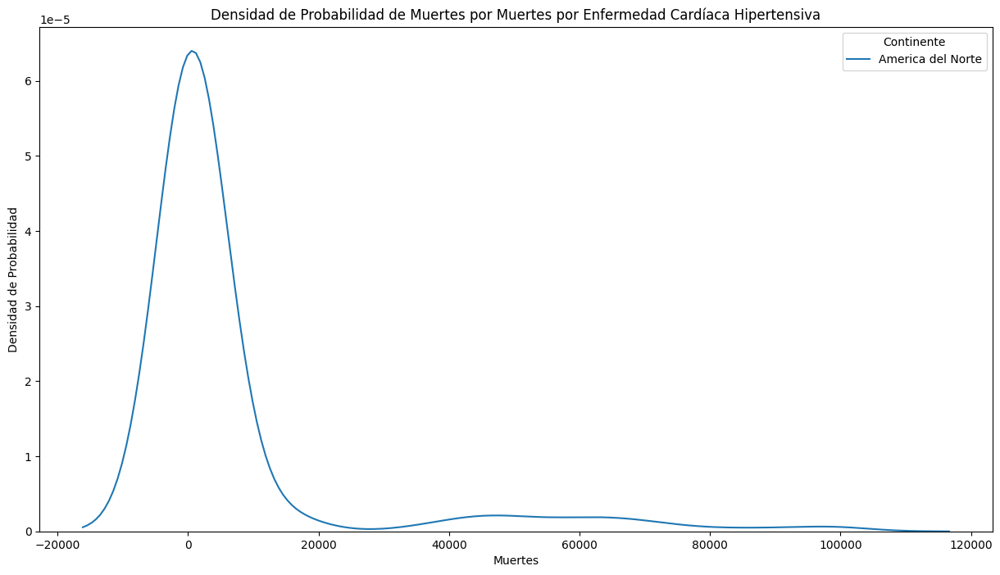

La densidad de probabilidad por Muertes por Ictus Isquémico es:
100        24.06
101        20.19
102        21.92
103        24.06
104        23.96
          ...   
3615    83047.94
3616    84145.59
3617    87077.19
3618    88582.26
3619    89926.86
Name: Deaths - Cause: Ischaemic stroke - Sex: Both sexes - Age group: ALLAges, Length: 440, dtype: float64


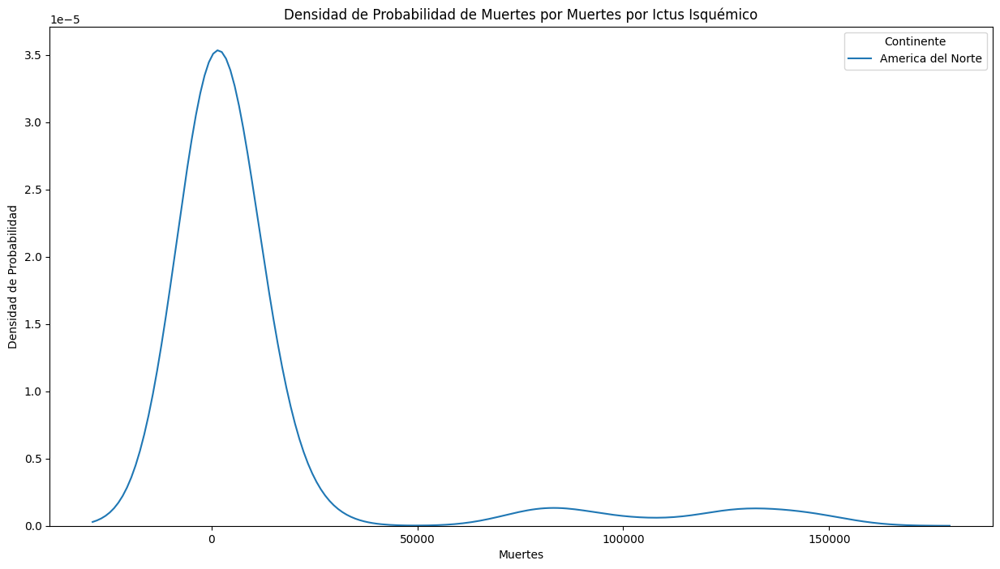

La densidad de probabilidad por Muertes por Ictus Hemorrágico es:
100        24.59
101        19.59
102        22.99
103        24.55
104        22.20
          ...   
3615    63627.42
3616    64971.26
3617    66686.48
3618    67416.48
3619    68593.05
Name: Deaths - Cause: Haemorrhagic stroke - Sex: Both sexes - Age group: ALLAges, Length: 440, dtype: float64


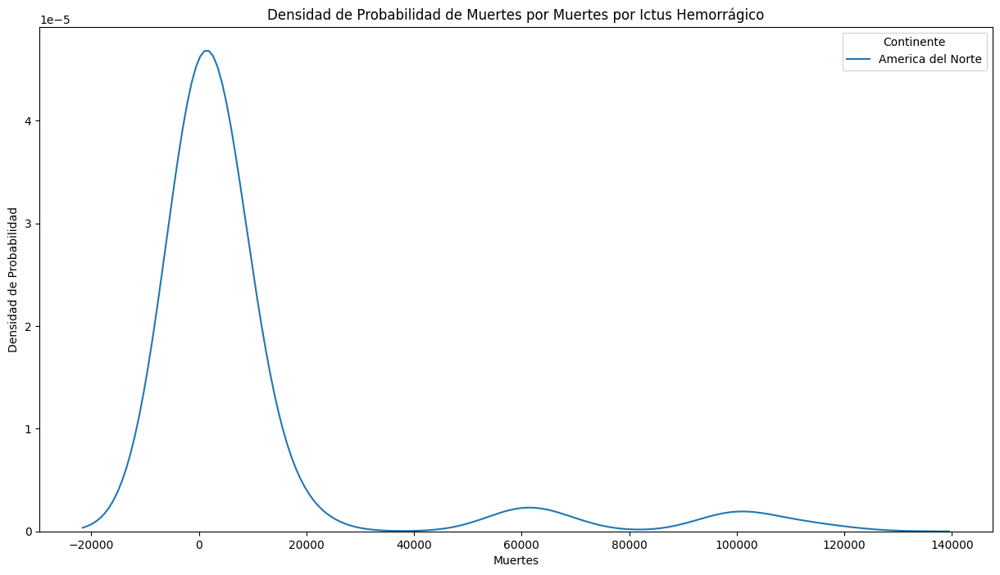

La densidad de probabilidad por Muertes por Enfermedad Cardíaca Isquémica es:
100         56.61
101         52.45
102         65.10
103         67.10
104         79.07
          ...    
3615    473809.30
3616    473622.90
3617    479159.60
3618    496312.30
3619    504903.90
Name: Deaths - Cause: Ischaemic heart disease - Sex: Both sexes - Age group: ALLAges, Length: 440, dtype: float64


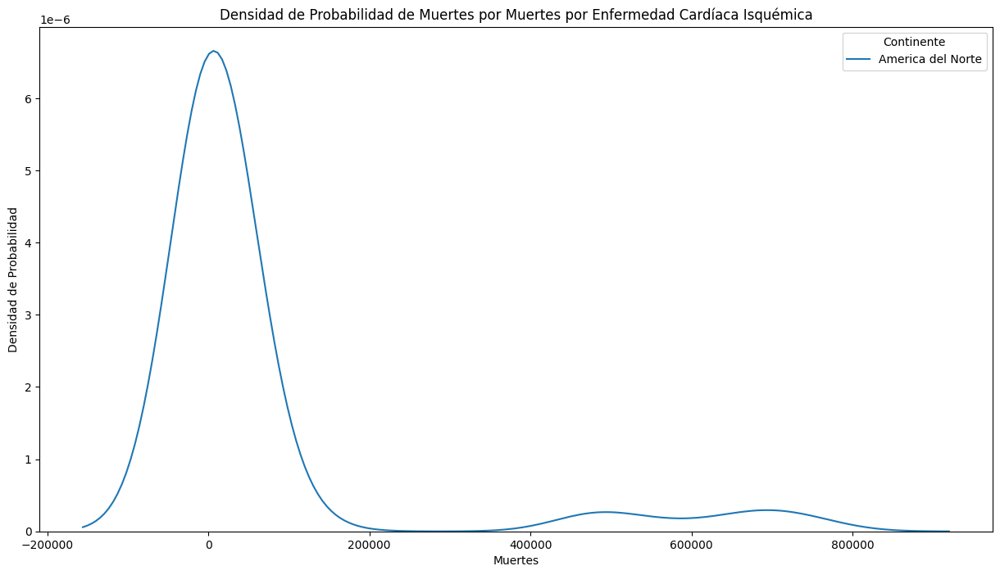

Densidad de probabilidad por Enfermedades Cardiovasculares en America del Sur
La densidad de probabilidad por Muertes por Enfermedad Cardíaca Reumática es:
120     264.02
121     249.08
122     254.66
123     265.29
124     173.33
         ...  
3695     82.53
3696     84.56
3697     82.57
3698     81.55
3699     80.08
Name: Deaths - Cause: Rheumatic heart disease - Sex: Both sexes - Age group: ALLAges, Length: 260, dtype: float64


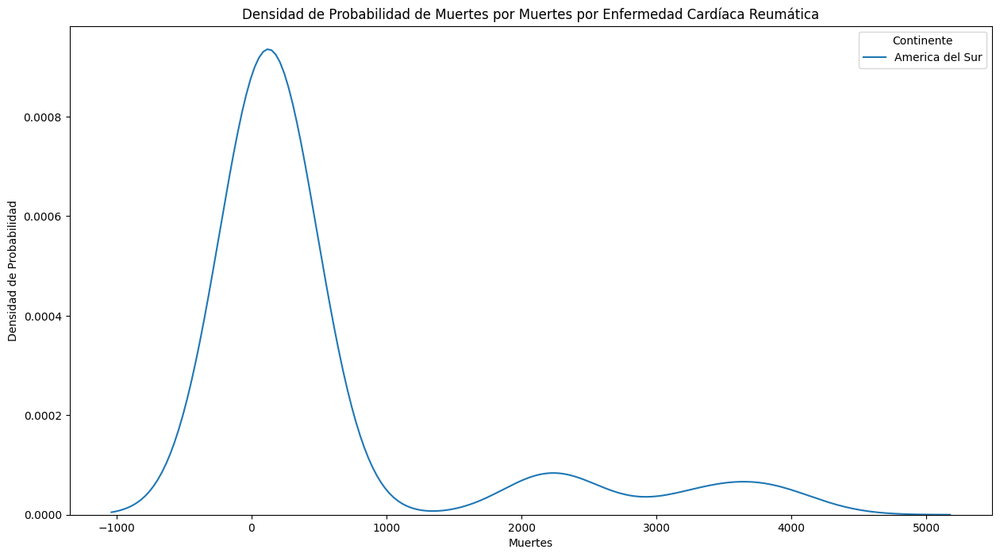

La densidad de probabilidad por Muertes por Cardiomiopatía, Miocarditis y Endocarditis es:
120     3537.31
121     3651.34
122     3946.22
123     4264.12
124     3979.79
         ...   
3695     587.39
3696     610.06
3697     611.49
3698     604.80
3699     598.96
Name: Deaths - Cause: Cardiomyopathy, myocarditis, endocarditis - Sex: Both sexes - Age group: ALLAges, Length: 260, dtype: float64


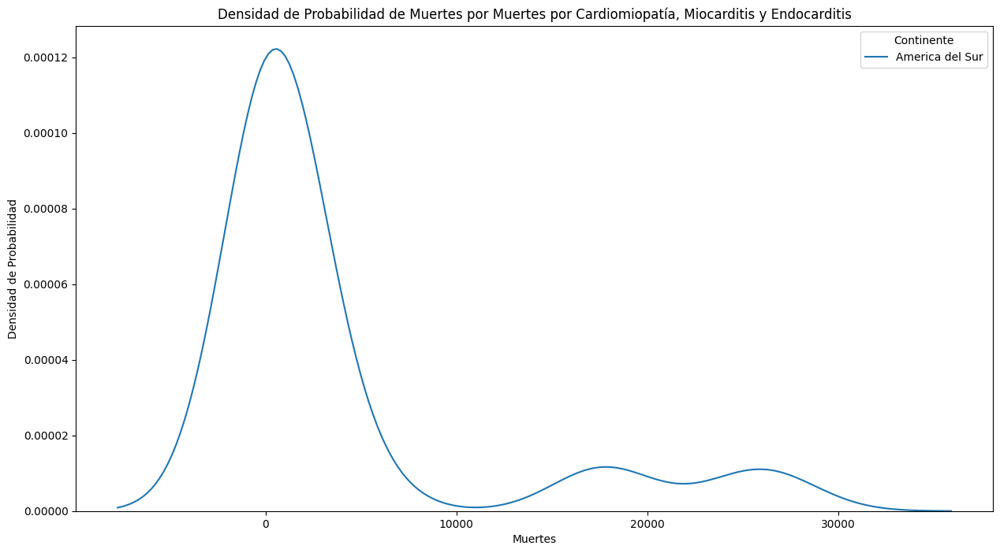

La densidad de probabilidad por Muertes por Enfermedades Circulatorias es:
120     6917.57
121     8067.32
122     8549.76
123     9381.15
124     9276.27
         ...   
3695    2053.34
3696    2124.63
3697    2139.70
3698    2128.79
3699    2121.15
Name: Deaths - Cause: Other circulatory diseases - Sex: Both sexes - Age group: ALLAges, Length: 260, dtype: float64


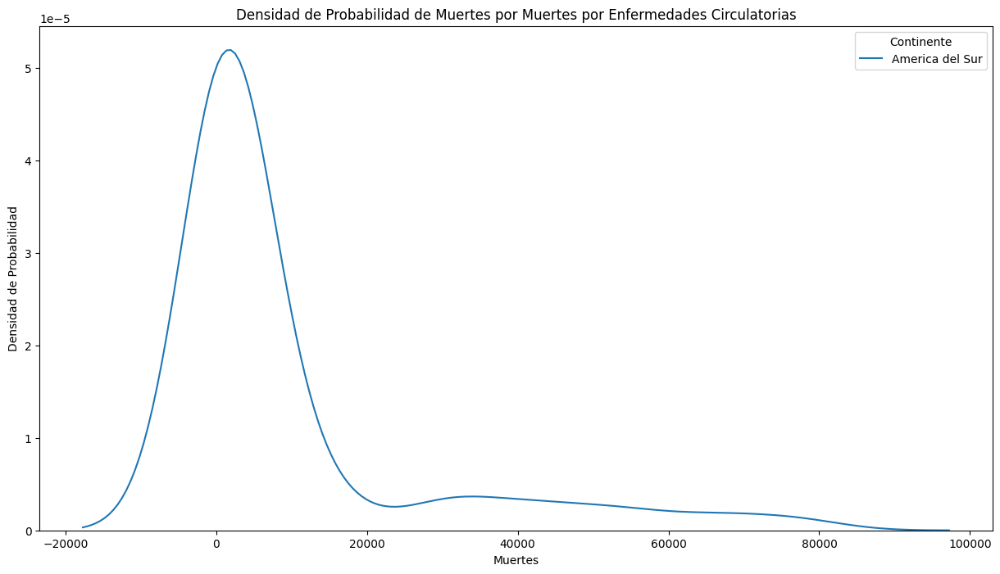

La densidad de probabilidad por Muertes por Enfermedad Cardíaca Hipertensiva es:
120     2066.29
121     2473.43
122     2398.08
123     2661.60
124     3018.21
         ...   
3695    5007.44
3696    5188.11
3697    5238.54
3698    5205.26
3699    5194.86
Name: Deaths - Cause: Hypertensive heart disease - Sex: Both sexes - Age group: ALLAges, Length: 260, dtype: float64


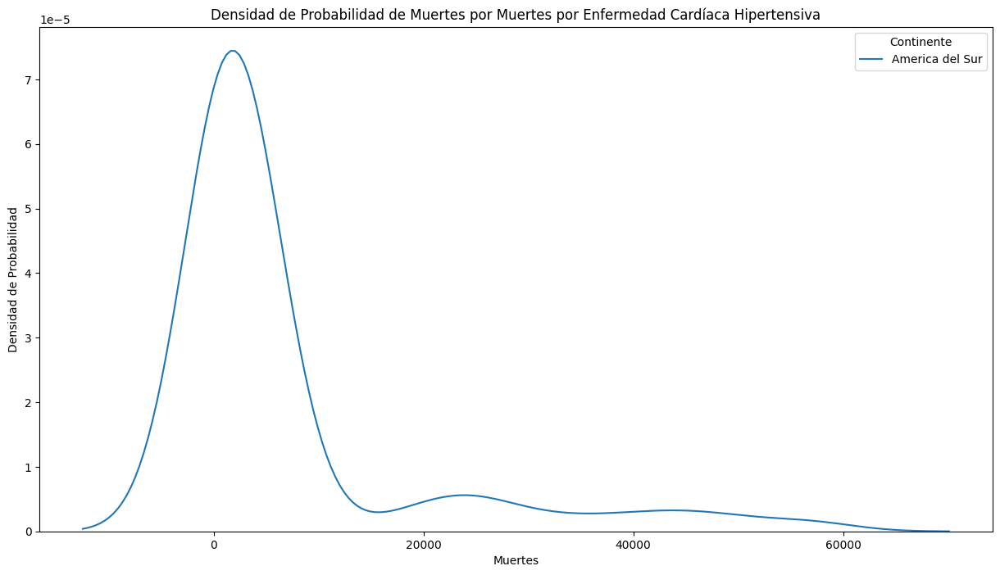

La densidad de probabilidad por Muertes por Ictus Isquémico es:
120     11517.59
121     11640.50
122     11652.65
123     12308.83
124     11664.33
          ...   
3695     5397.32
3696     5608.71
3697     5713.65
3698     5738.71
3699     5775.89
Name: Deaths - Cause: Ischaemic stroke - Sex: Both sexes - Age group: ALLAges, Length: 260, dtype: float64


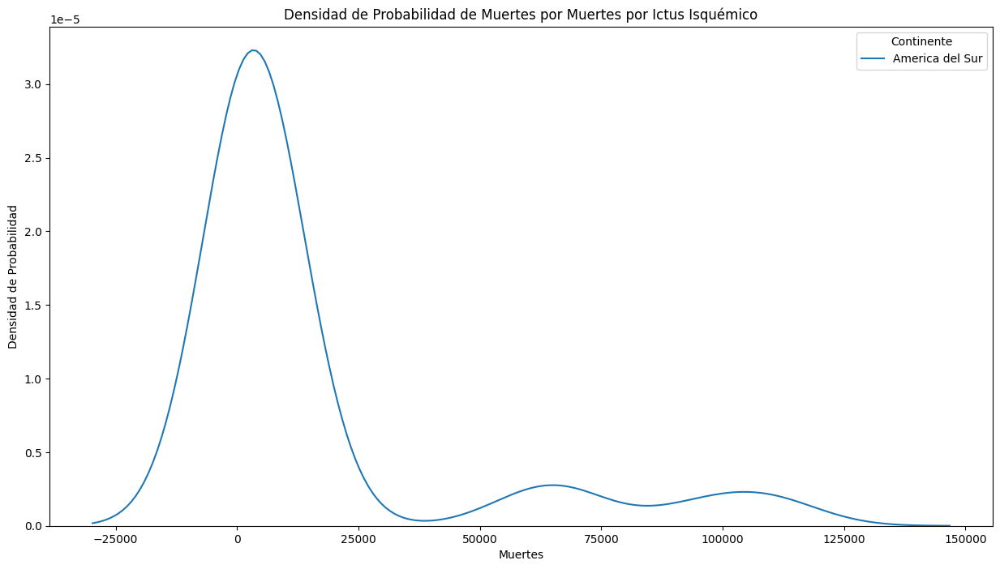

La densidad de probabilidad por Muertes por Ictus Hemorrágico es:
120     13713.93
121     13739.37
122     13959.81
123     14359.40
124     13550.70
          ...   
3695     6361.27
3696     6559.13
3697     6537.45
3698     6429.19
3699     6357.22
Name: Deaths - Cause: Haemorrhagic stroke - Sex: Both sexes - Age group: ALLAges, Length: 260, dtype: float64


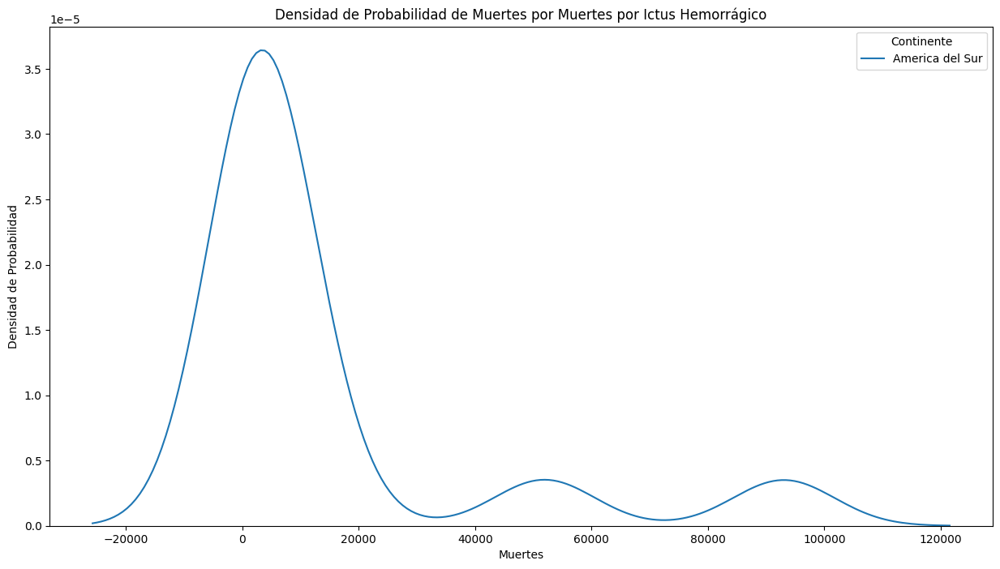

La densidad de probabilidad por Muertes por Enfermedad Cardíaca Isquémica es:
120     51997.87
121     52529.68
122     53034.82
123     51563.44
124     48716.47
          ...   
3695    26610.82
3696    27447.49
3697    27540.40
3698    27187.36
3699    26905.45
Name: Deaths - Cause: Ischaemic heart disease - Sex: Both sexes - Age group: ALLAges, Length: 260, dtype: float64


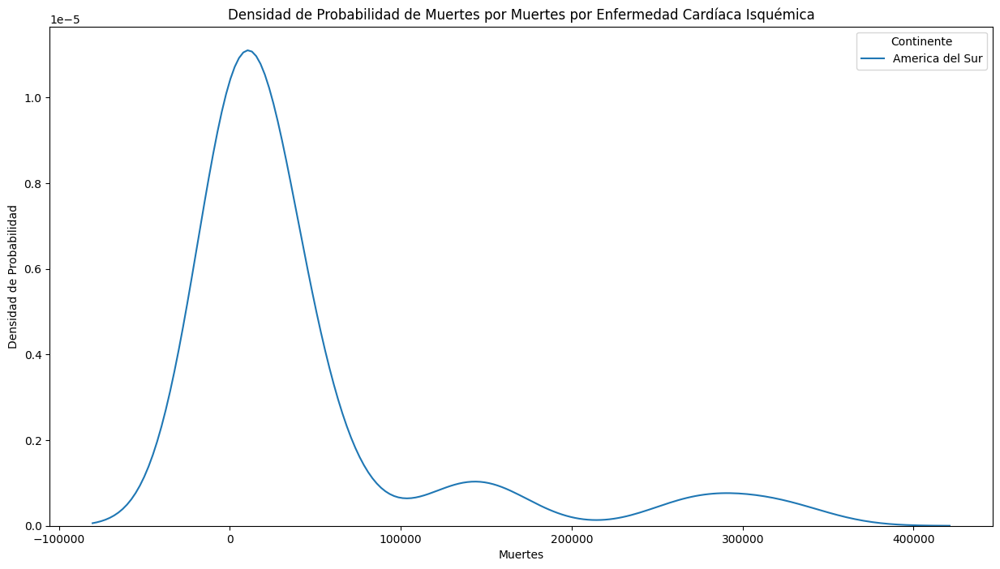

Densidad de probabilidad por Enfermedades Cardiovasculares en Asia
La densidad de probabilidad por Muertes por Enfermedad Cardíaca Reumática es:
0        937.89
1        964.80
2       1001.19
3       1034.15
4       1060.51
         ...   
3755     597.77
3756     605.58
3757     626.52
3758     692.15
3759     706.80
Name: Deaths - Cause: Rheumatic heart disease - Sex: Both sexes - Age group: ALLAges, Length: 940, dtype: float64


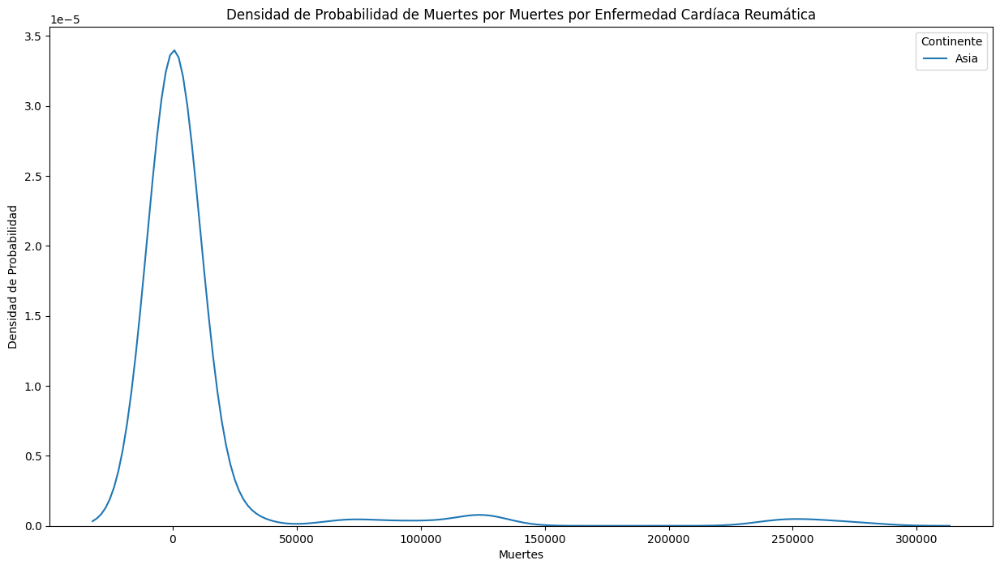

La densidad de probabilidad por Muertes por Cardiomiopatía, Miocarditis y Endocarditis es:
0       324.40
1       335.44
2       357.94
3       376.47
4       390.31
         ...  
3755    516.03
3756    524.74
3757    537.80
3758    561.97
3759    584.80
Name: Deaths - Cause: Cardiomyopathy, myocarditis, endocarditis - Sex: Both sexes - Age group: ALLAges, Length: 940, dtype: float64


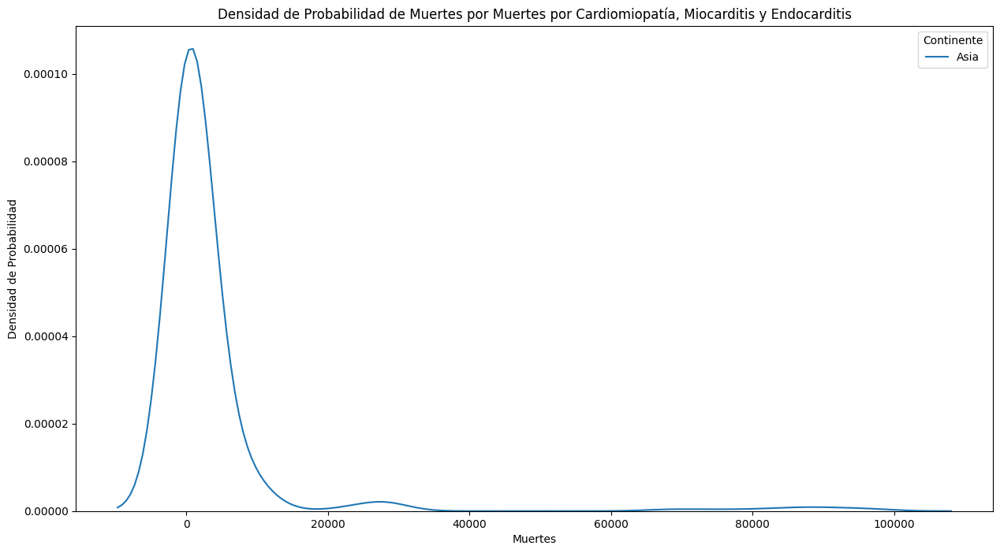

La densidad de probabilidad por Muertes por Enfermedades Circulatorias es:
0       1309.90
1       1400.22
2       1526.47
3       1632.92
4       1710.44
         ...   
3755    2043.96
3756    2082.75
3757    2144.71
3758    2252.61
3759    2331.54
Name: Deaths - Cause: Other circulatory diseases - Sex: Both sexes - Age group: ALLAges, Length: 940, dtype: float64


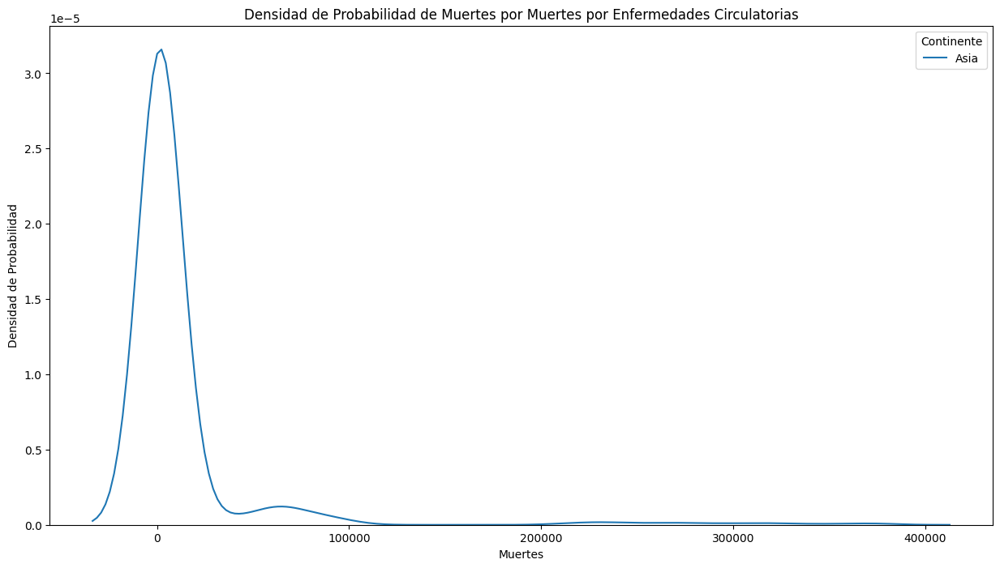

La densidad de probabilidad por Muertes por Enfermedad Cardíaca Hipertensiva es:
0       4362.82
1       4689.85
2       4959.86
3       5137.53
4       5347.03
         ...   
3755    4408.92
3756    4647.82
3757    4863.56
3758    5048.87
3759    5293.47
Name: Deaths - Cause: Hypertensive heart disease - Sex: Both sexes - Age group: ALLAges, Length: 940, dtype: float64


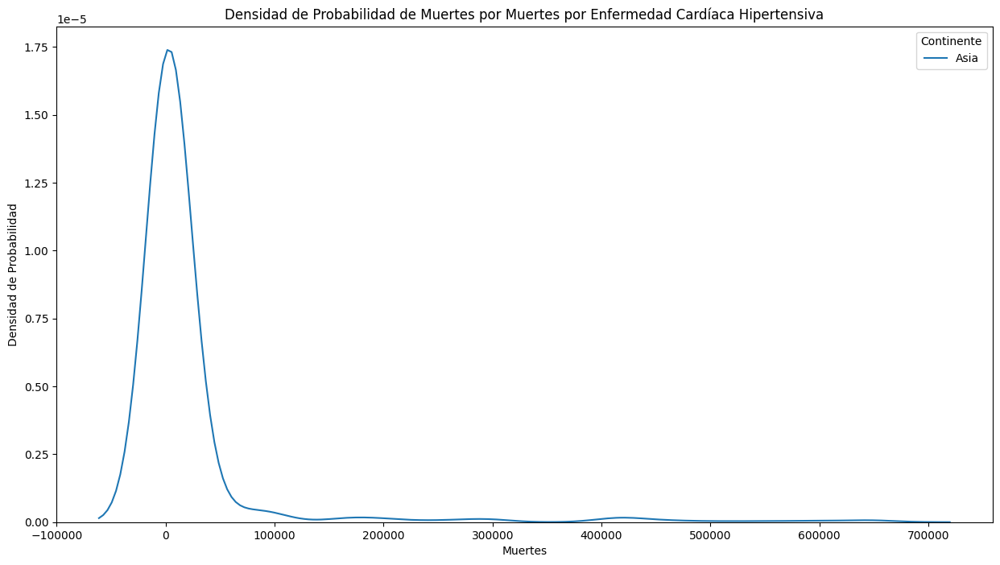

La densidad de probabilidad por Muertes por Ictus Isquémico es:
0       4197.22
1       4717.61
2       5202.52
3       5588.72
4       5946.04
         ...   
3755    6891.98
3756    7201.90
3757    7528.51
3758    7799.48
3759    8178.75
Name: Deaths - Cause: Ischaemic stroke - Sex: Both sexes - Age group: ALLAges, Length: 940, dtype: float64


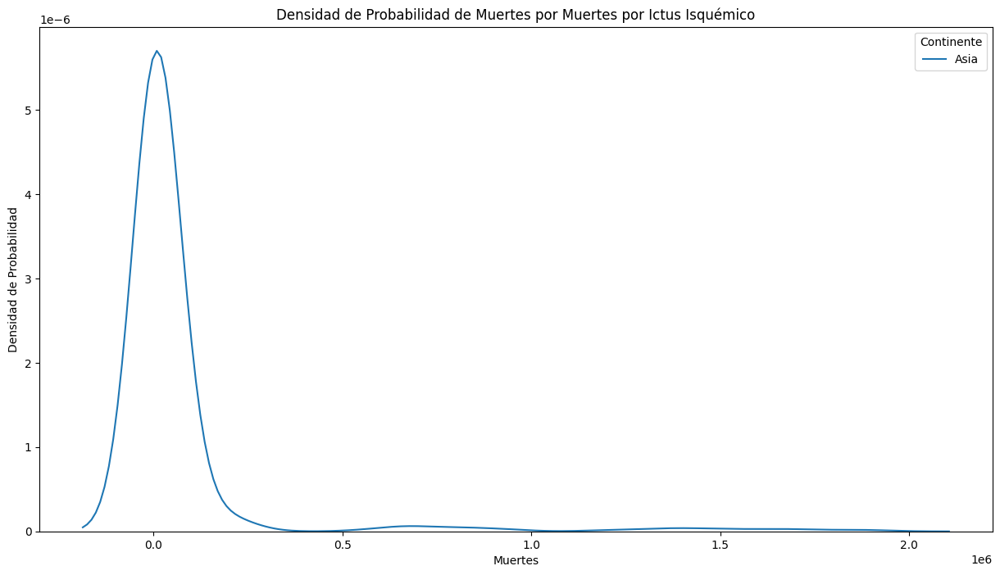

La densidad de probabilidad por Muertes por Ictus Hemorrágico es:
0       7968.33
1       8075.98
2       8157.79
3       8167.40
4       8272.00
         ...   
3755    4646.76
3756    4804.57
3757    4963.21
3758    5192.42
3759    5390.86
Name: Deaths - Cause: Haemorrhagic stroke - Sex: Both sexes - Age group: ALLAges, Length: 940, dtype: float64


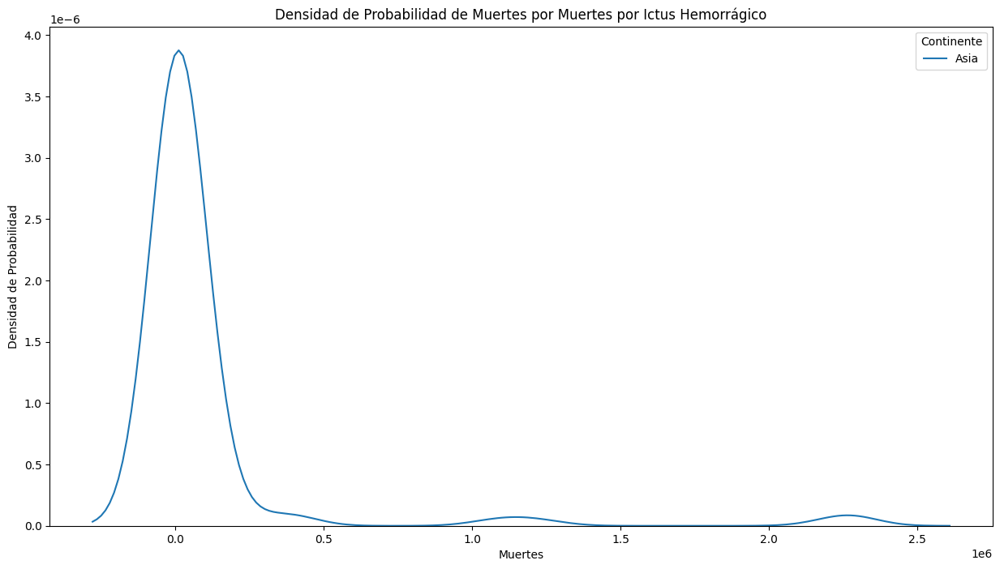

La densidad de probabilidad por Muertes por Enfermedad Cardíaca Isquémica es:
0       25605.56
1       26675.39
2       27652.28
3       28330.05
4       29223.66
          ...   
3755    25353.54
3756    26481.78
3757    27683.70
3758    28823.65
3759    30157.82
Name: Deaths - Cause: Ischaemic heart disease - Sex: Both sexes - Age group: ALLAges, Length: 940, dtype: float64


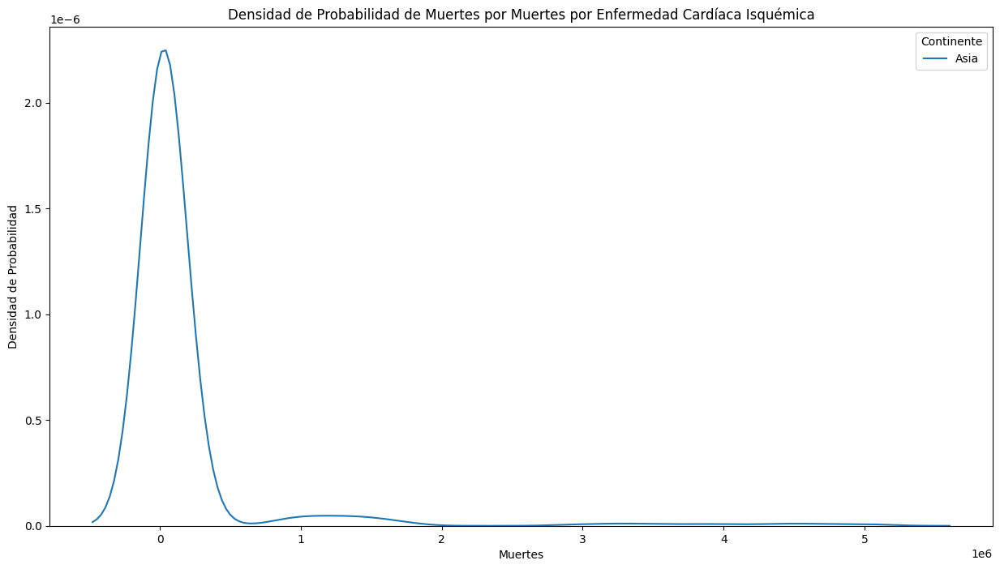

Densidad de probabilidad por Enfermedades Cardiovasculares en Europa
La densidad de probabilidad por Muertes por Enfermedad Cardíaca Reumática es:
40        64.12
41        48.90
42        50.01
43        52.42
44        49.51
         ...   
3595     981.36
3596    1002.91
3597     930.73
3598     904.52
3599     876.02
Name: Deaths - Cause: Rheumatic heart disease - Sex: Both sexes - Age group: ALLAges, Length: 800, dtype: float64


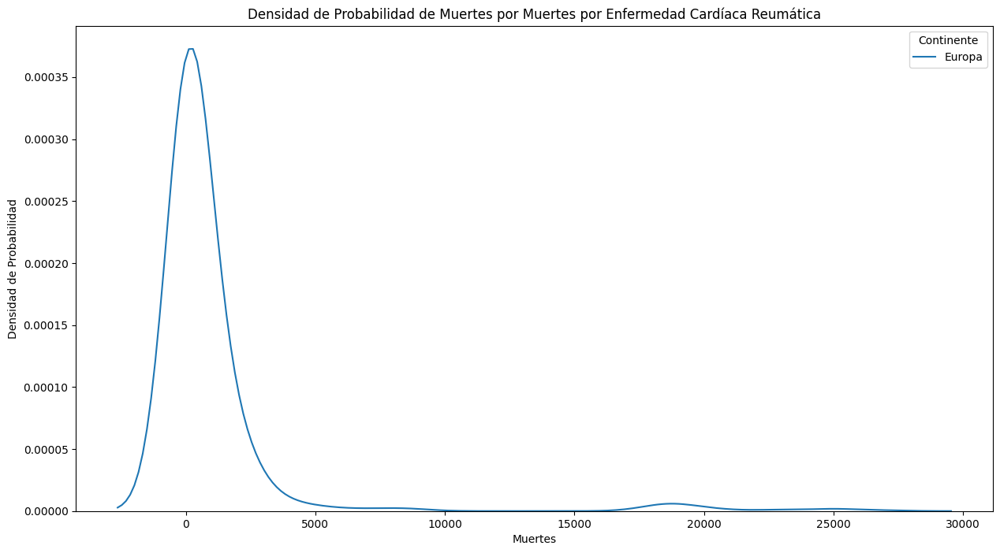

La densidad de probabilidad por Muertes por Cardiomiopatía, Miocarditis y Endocarditis es:
40       263.59
41       201.46
42       220.37
43       240.21
44       229.70
         ...   
3595    3579.22
3596    3485.36
3597    3278.61
3598    3207.43
3599    3126.40
Name: Deaths - Cause: Cardiomyopathy, myocarditis, endocarditis - Sex: Both sexes - Age group: ALLAges, Length: 800, dtype: float64


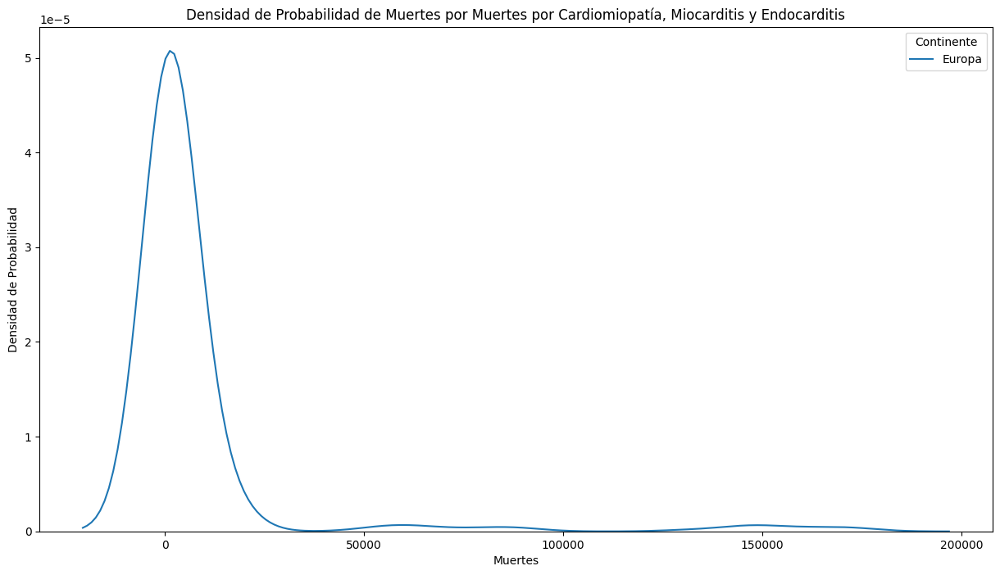

La densidad de probabilidad por Muertes por Enfermedades Circulatorias es:
40        406.86
41        328.42
42        382.49
43        441.83
44        442.73
          ...   
3595    30716.93
3596    31152.62
3597    28889.38
3598    28143.78
3599    27274.70
Name: Deaths - Cause: Other circulatory diseases - Sex: Both sexes - Age group: ALLAges, Length: 800, dtype: float64


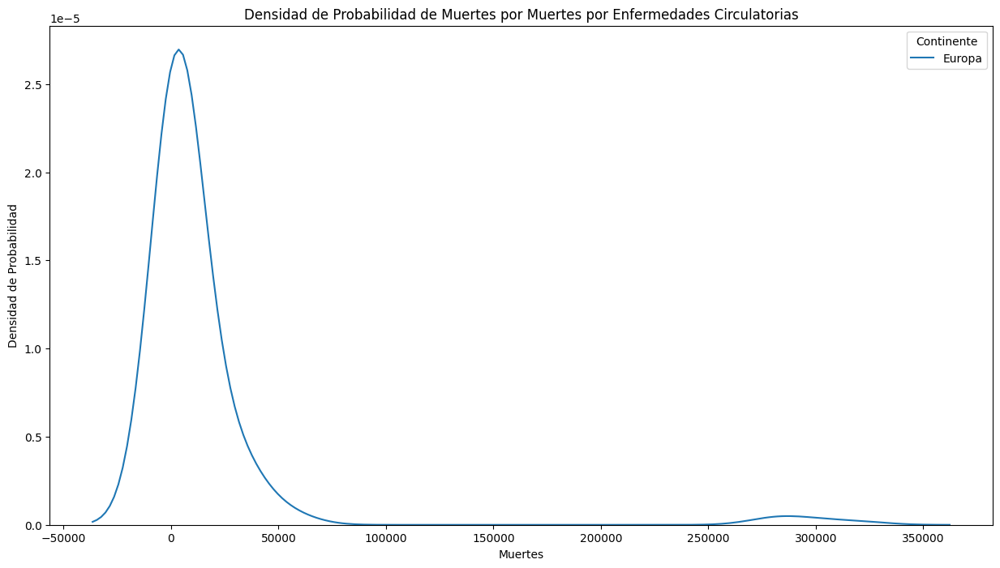

La densidad de probabilidad por Muertes por Enfermedad Cardíaca Hipertensiva es:
40       208.40
41       160.35
42       189.21
43       221.31
44       218.89
         ...   
3595    5789.40
3596    6073.66
3597    5516.05
3598    5374.24
3599    5208.09
Name: Deaths - Cause: Hypertensive heart disease - Sex: Both sexes - Age group: ALLAges, Length: 800, dtype: float64


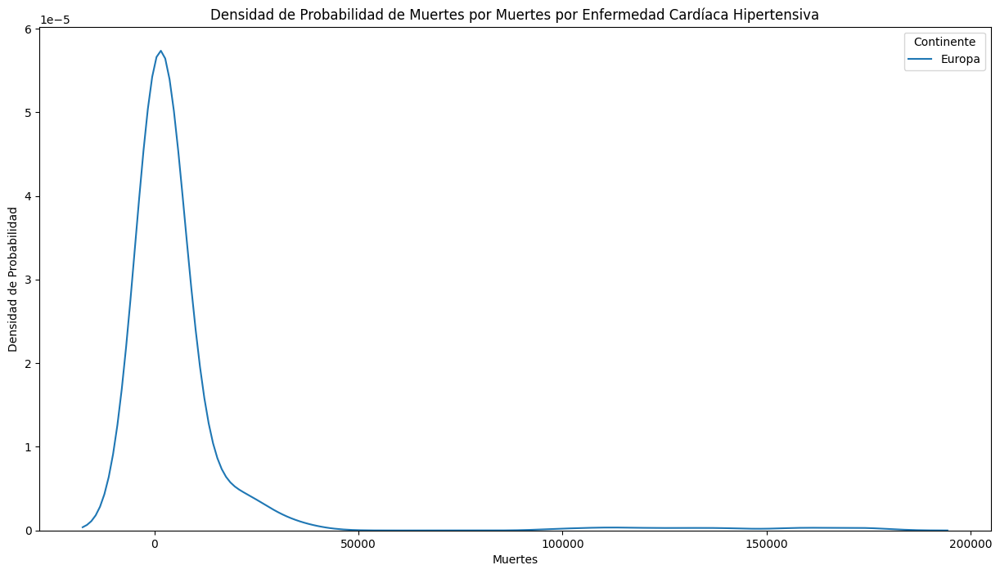

La densidad de probabilidad por Muertes por Ictus Isquémico es:
40        747.27
41        568.28
42        669.11
43        786.19
44        780.77
          ...   
3595    28333.98
3596    26448.40
3597    26003.04
3598    25458.24
3599    24638.81
Name: Deaths - Cause: Ischaemic stroke - Sex: Both sexes - Age group: ALLAges, Length: 800, dtype: float64


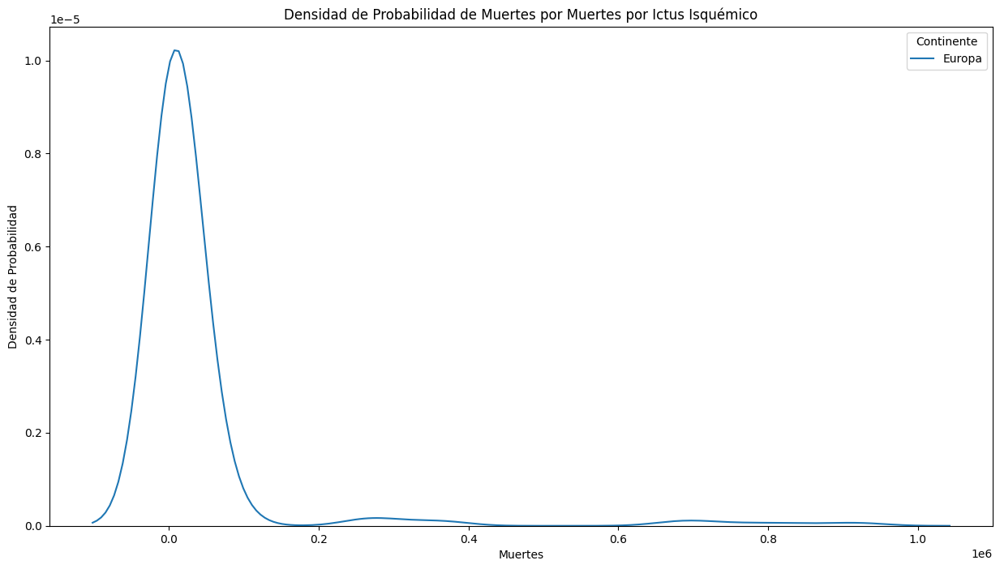

La densidad de probabilidad por Muertes por Ictus Hemorrágico es:
40       3612.82
41       2677.33
42       3088.17
43       3553.85
44       3429.42
          ...   
3595    14922.46
3596    14470.00
3597    13987.26
3598    13441.52
3599    12987.55
Name: Deaths - Cause: Haemorrhagic stroke - Sex: Both sexes - Age group: ALLAges, Length: 800, dtype: float64


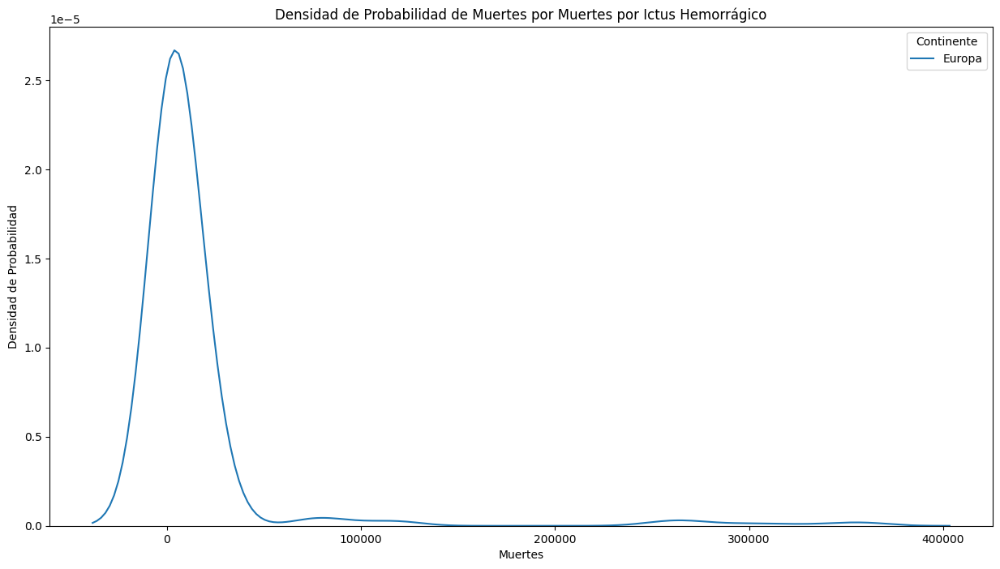

La densidad de probabilidad por Muertes por Enfermedad Cardíaca Isquémica es:
40       3971.24
41       3091.33
42       3608.55
43       4232.37
44       4201.29
          ...   
3595    80649.62
3596    77052.33
3597    75564.28
3598    73796.99
3599    71727.87
Name: Deaths - Cause: Ischaemic heart disease - Sex: Both sexes - Age group: ALLAges, Length: 800, dtype: float64


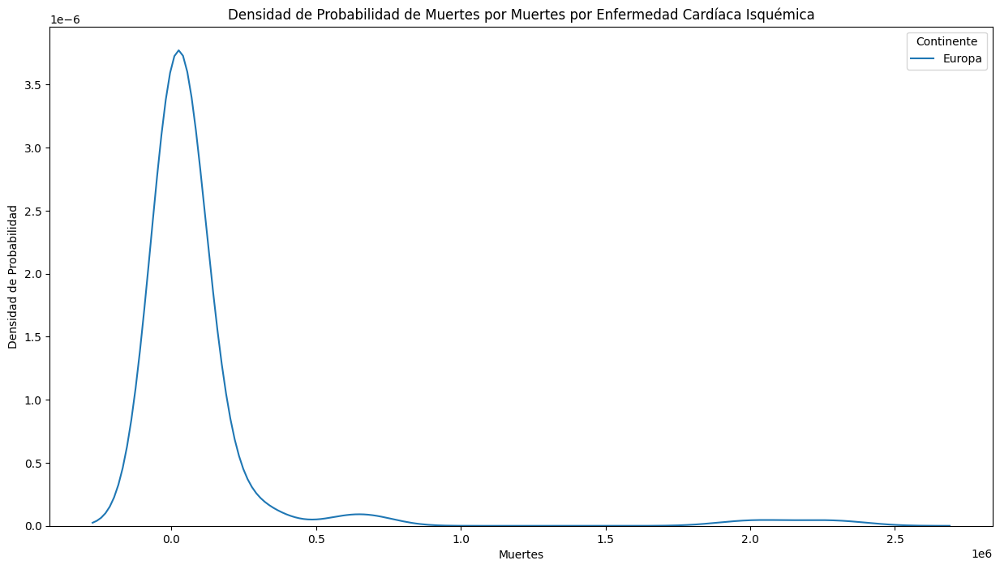

Densidad de probabilidad por Enfermedades Cardiovasculares en Oceania
La densidad de probabilidad por Muertes por Enfermedad Cardíaca Reumática es:
180     251.19
181     238.45
182     251.96
183     274.02
184     249.57
         ...  
3675     32.43
3676     32.92
3677     33.58
3678     34.22
3679     34.98
Name: Deaths - Cause: Rheumatic heart disease - Sex: Both sexes - Age group: ALLAges, Length: 220, dtype: float64


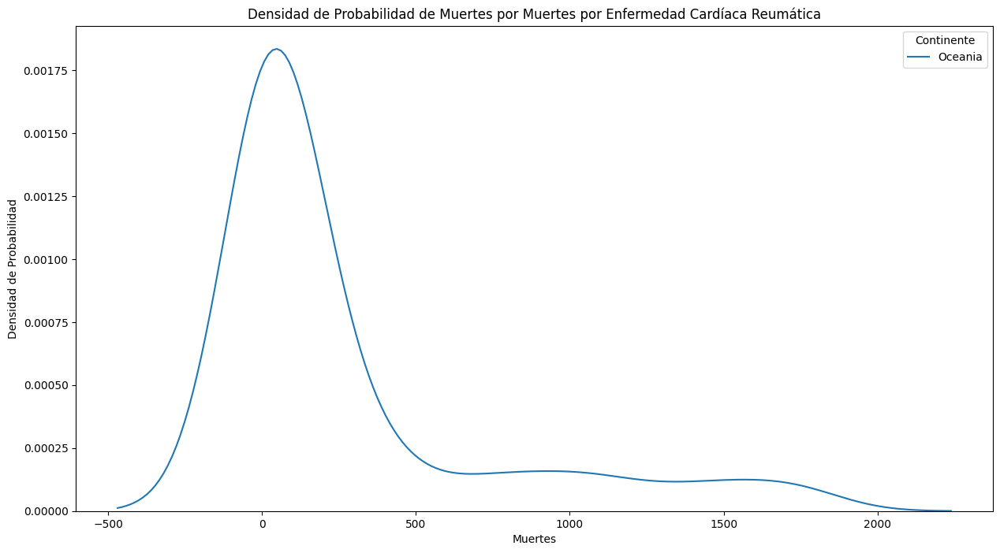

La densidad de probabilidad por Muertes por Cardiomiopatía, Miocarditis y Endocarditis es:
180     1005.01
181      999.62
182     1002.44
183     1014.58
184     1062.62
         ...   
3675       9.85
3676      10.14
3677      10.43
3678      10.77
3679      11.11
Name: Deaths - Cause: Cardiomyopathy, myocarditis, endocarditis - Sex: Both sexes - Age group: ALLAges, Length: 220, dtype: float64


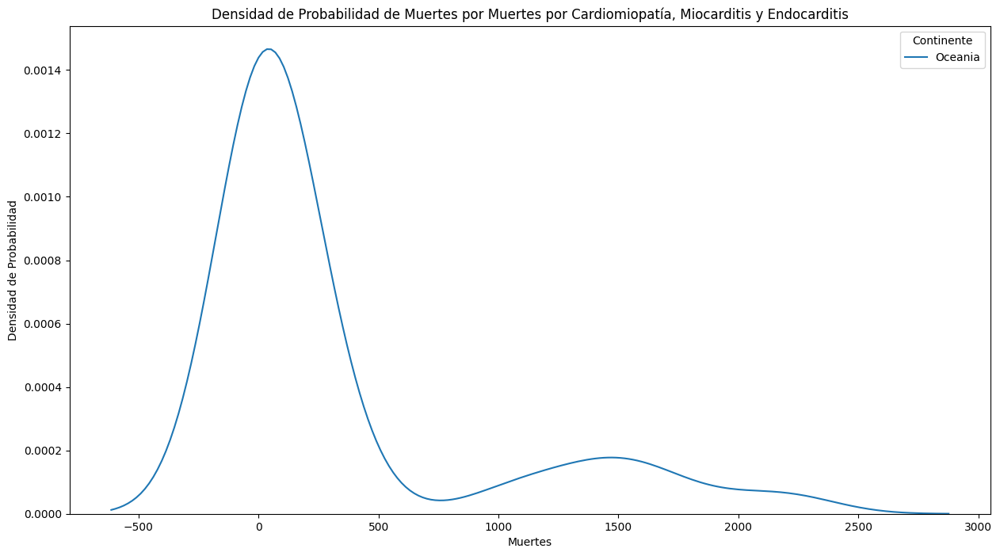

La densidad de probabilidad por Muertes por Enfermedades Circulatorias es:
180     4577.05
181     4738.92
182     4949.96
183     4874.57
184     5056.36
         ...   
3675      20.70
3676      21.38
3677      22.02
3678      22.61
3679      23.15
Name: Deaths - Cause: Other circulatory diseases - Sex: Both sexes - Age group: ALLAges, Length: 220, dtype: float64


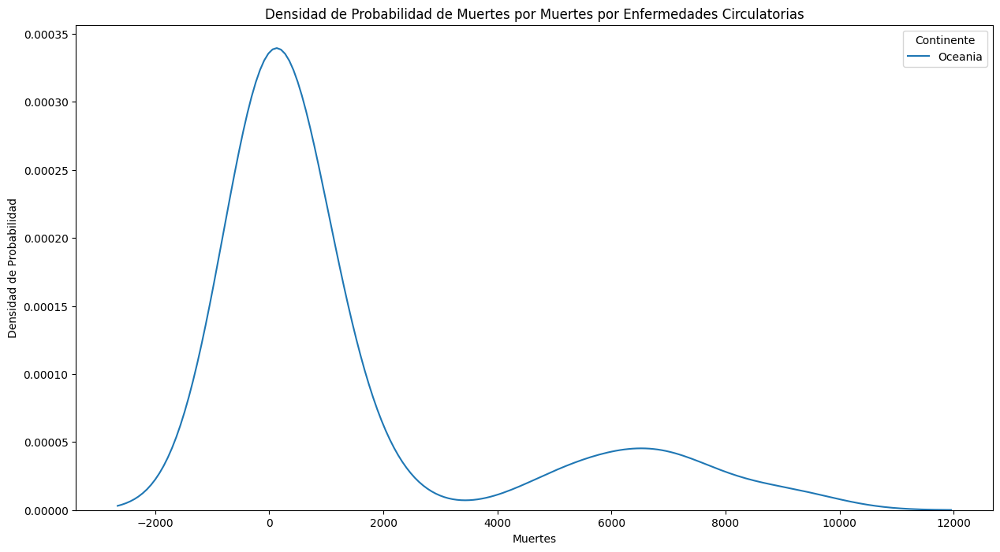

La densidad de probabilidad por Muertes por Enfermedad Cardíaca Hipertensiva es:
180     879.01
181     885.75
182     990.34
183     970.08
184     970.88
         ...  
3675     42.43
3676     43.72
3677     44.95
3678     45.99
3679     47.03
Name: Deaths - Cause: Hypertensive heart disease - Sex: Both sexes - Age group: ALLAges, Length: 220, dtype: float64


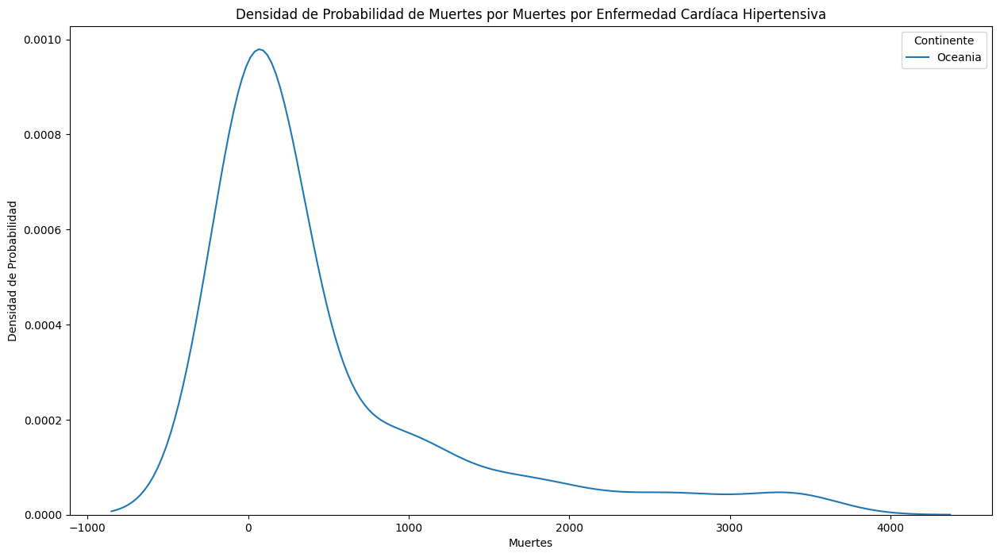

La densidad de probabilidad por Muertes por Ictus Isquémico es:
180     8405.65
181     8246.10
182     8400.48
183     8170.98
184     8149.62
         ...   
3675      63.51
3676      65.86
3677      67.92
3678      69.59
3679      70.83
Name: Deaths - Cause: Ischaemic stroke - Sex: Both sexes - Age group: ALLAges, Length: 220, dtype: float64


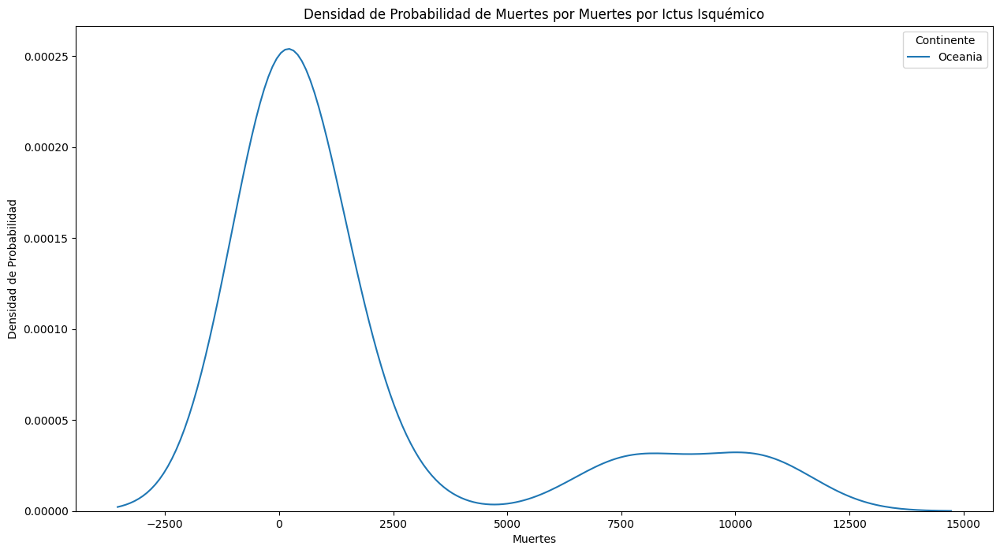

La densidad de probabilidad por Muertes por Ictus Hemorrágico es:
180     3670.72
181     3647.36
182     3729.11
183     3720.79
184     3724.21
         ...   
3675     198.97
3676     203.37
3677     208.05
3678     212.60
3679     217.54
Name: Deaths - Cause: Haemorrhagic stroke - Sex: Both sexes - Age group: ALLAges, Length: 220, dtype: float64


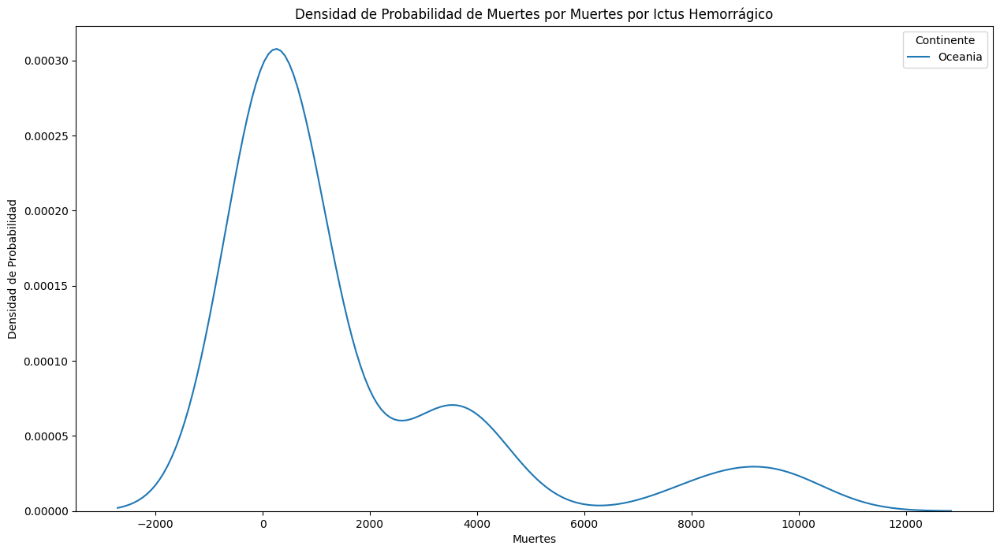

La densidad de probabilidad por Muertes por Enfermedad Cardíaca Isquémica es:
180     28874.76
181     28445.86
182     28166.92
183     27212.38
184     26672.40
          ...   
3675      405.43
3676      417.47
3677      429.95
3678      442.20
3679      454.20
Name: Deaths - Cause: Ischaemic heart disease - Sex: Both sexes - Age group: ALLAges, Length: 220, dtype: float64


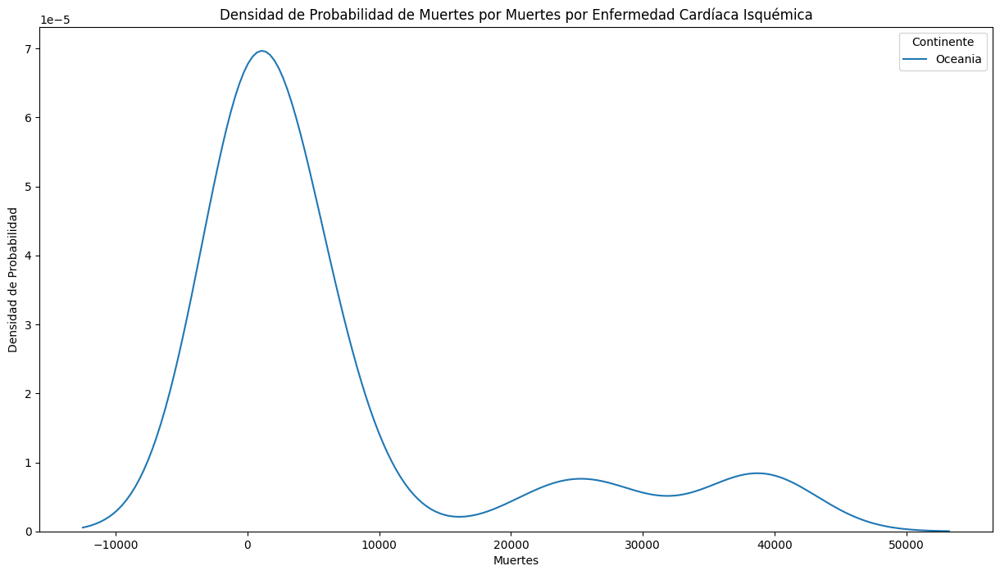

In [ ]:
# Calcular y graficar la densidad de probabilidad

# Calcular la densidad de probabilidad
def calcular_densidad_probabilidad(df, patologia):
    data_patologia = df[patologia].dropna()
    return data_patologia

for continente, paises in continentes.items():
    df_continente = df[df['Entity'].isin(paises)]
    print(f"Densidad de probabilidad por Enfermedades Cardiovasculares en {continente}")
    for patologia in patologias:
        FDP = calcular_densidad_probabilidad(df_continente, patologia)
        patologia_legible = reemplazar_texto(patologia)
        # Imprimir Densidad de Probabilidad
        print(f"La densidad de probabilidad por {patologia_legible} es:\n{FDP}")
        print("="*90)
        # Graficar la densidad
        plt.figure(figsize=(15, 8))
        sns.kdeplot(FDP, label=continente)
        plt.title(f'Densidad de Probabilidad de Muertes por {patologia_legible}')
        plt.xlabel('Muertes')
        plt.ylabel('Densidad de Probabilidad')
        plt.legend(title='Continente')
        plt.show()

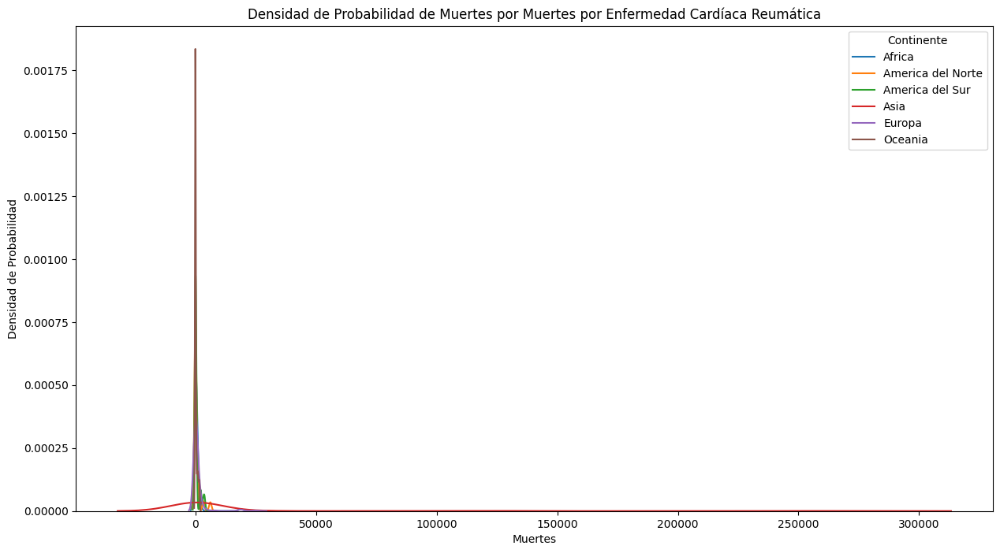

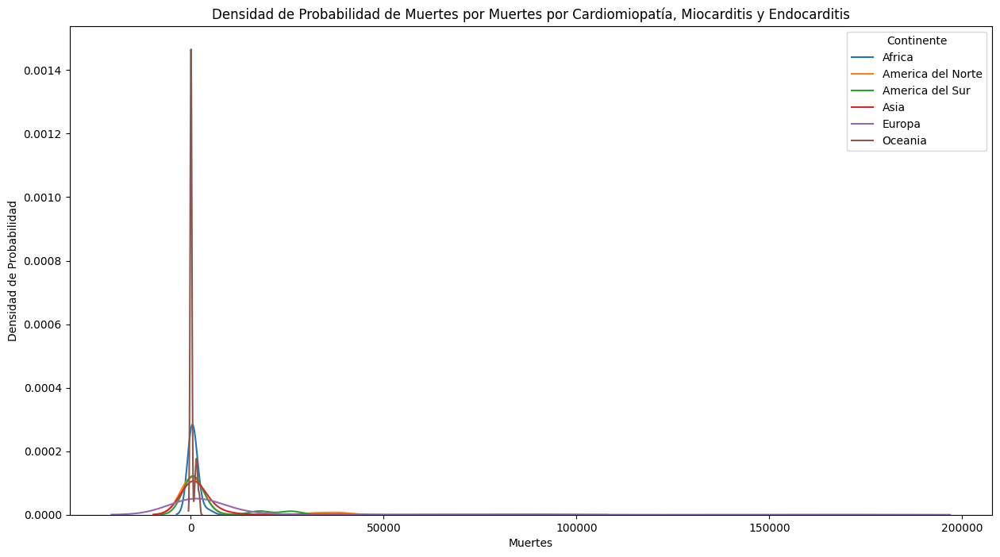

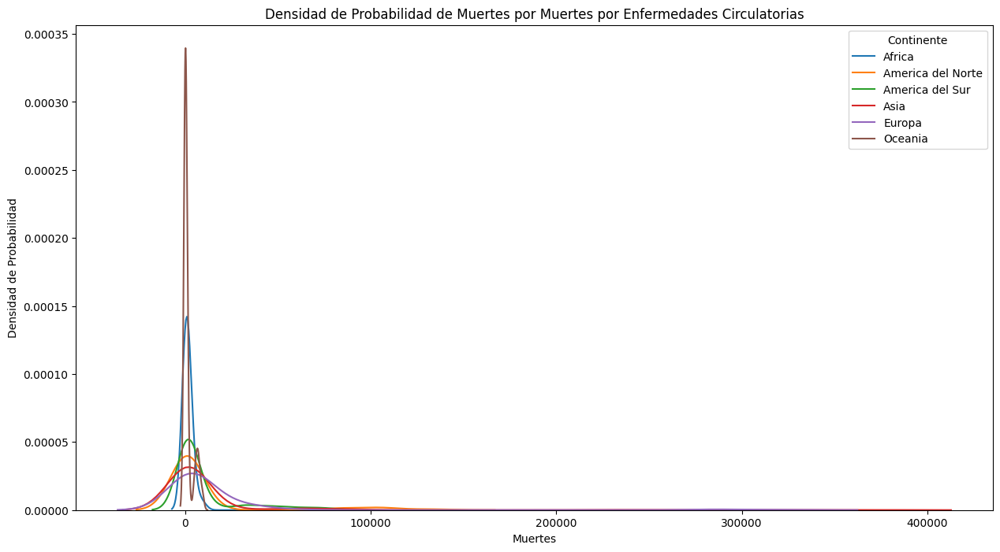

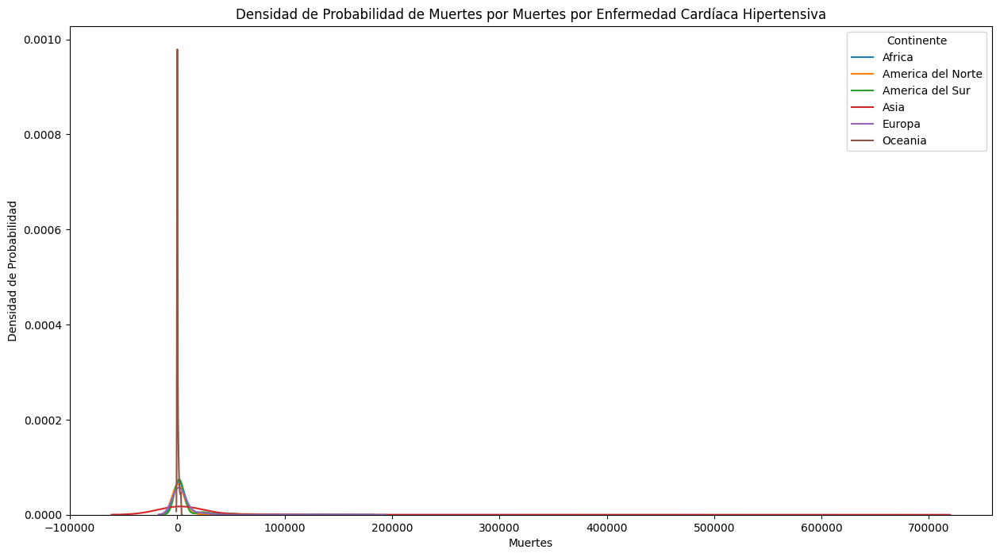

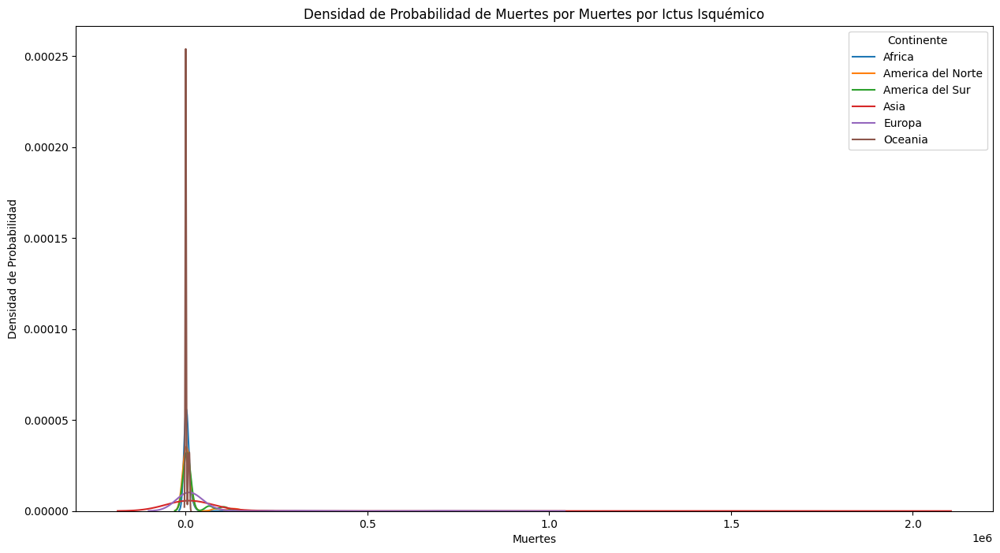

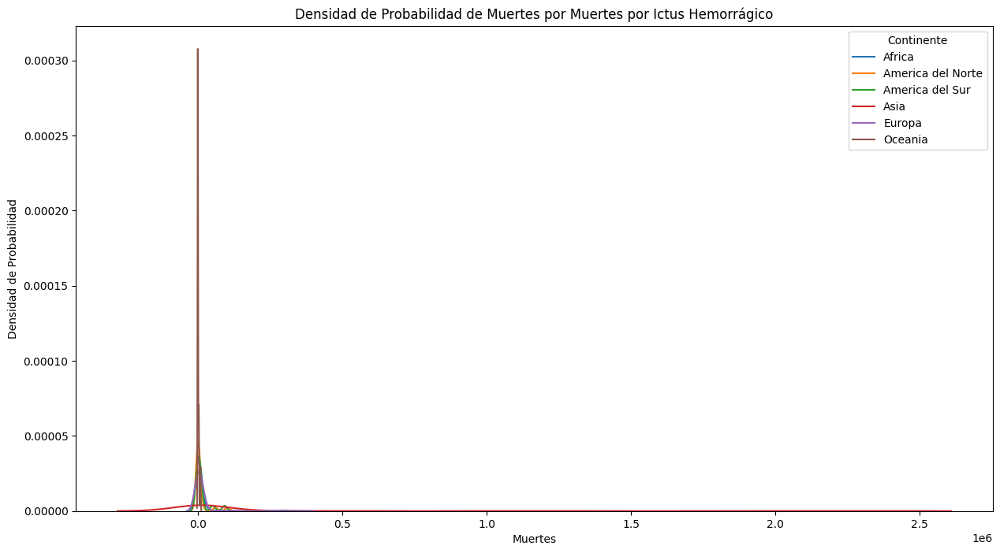

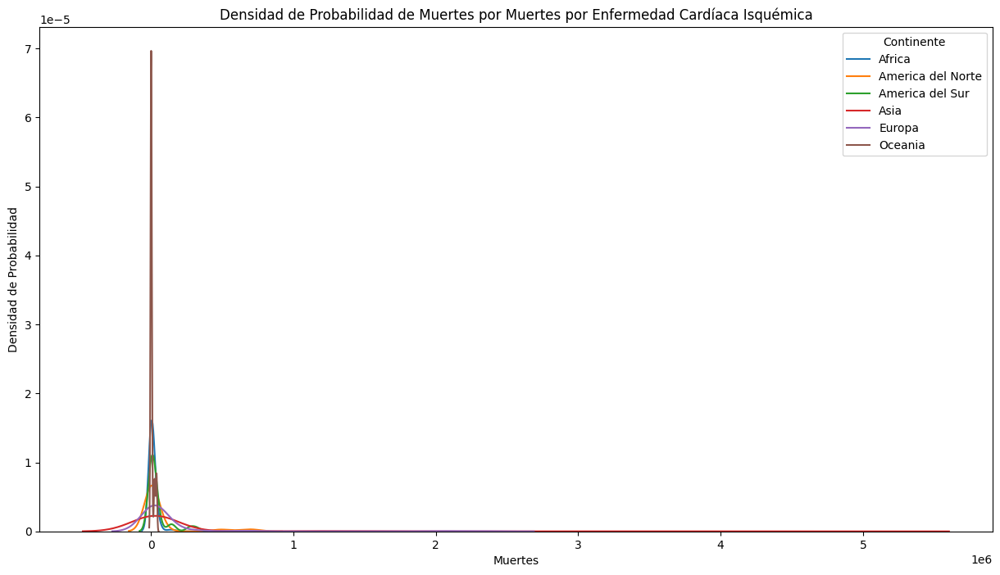

In [ ]:
# Calcular y graficar la densidad de probabilidad
for patologia in patologias:
    plt.figure(figsize=(15, 8))
    for continente, paises in continentes.items():
        df_continente = df[df['Entity'].isin(paises)]
        data_patologia = df_continente[patologia].dropna()  # Eliminar valores NaN
        
        # Graficar la densidad
        sns.kdeplot(data_patologia, label=continente)
        
    patologia_legible = reemplazar_texto(patologia)
    plt.title(f'Densidad de Probabilidad de Muertes por {patologia_legible}')
    plt.xlabel('Muertes')
    plt.ylabel('Densidad de Probabilidad')
    plt.legend(title='Continente')
    plt.show()

## Función de distribución de la muestra

Distribución acumulativa por Enfermedades Cardiovasculares en Africa
La CDF por Enfermedades Cardiovasculares es:
[0.00454545 0.00909091 0.01363636 0.01818182 0.02272727 0.02727273
 0.03181818 0.03636364 0.04090909 0.04545455 0.05       0.05454545
 0.05909091 0.06363636 0.06818182 0.07272727 0.07727273 0.08181818
 0.08636364 0.09090909 0.09545455 0.1        0.10454545 0.10909091
 0.11363636 0.11818182 0.12272727 0.12727273 0.13181818 0.13636364
 0.14090909 0.14545455 0.15       0.15454545 0.15909091 0.16363636
 0.16818182 0.17272727 0.17727273 0.18181818 0.18636364 0.19090909
 0.19545455 0.2        0.20454545 0.20909091 0.21363636 0.21818182
 0.22272727 0.22727273 0.23181818 0.23636364 0.24090909 0.24545455
 0.25       0.25454545 0.25909091 0.26363636 0.26818182 0.27272727
 0.27727273 0.28181818 0.28636364 0.29090909 0.29545455 0.3
 0.30454545 0.30909091 0.31363636 0.31818182 0.32272727 0.32727273
 0.33181818 0.33636364 0.34090909 0.34545455 0.35       0.35454545
 0.35909091 0.36363636

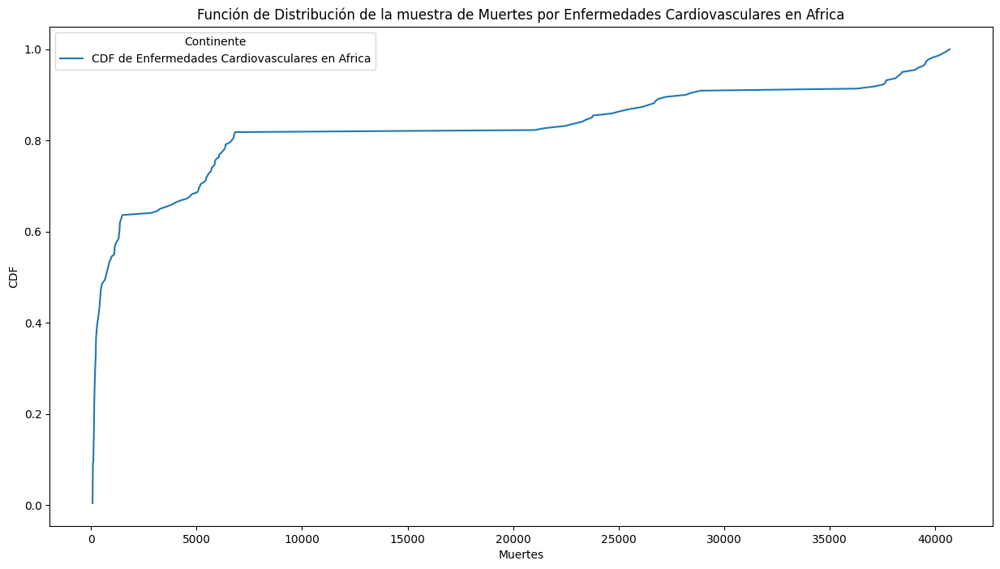

La CDF por Enfermedades Cardiovasculares es:
[0.00454545 0.00909091 0.01363636 0.01818182 0.02272727 0.02727273
 0.03181818 0.03636364 0.04090909 0.04545455 0.05       0.05454545
 0.05909091 0.06363636 0.06818182 0.07272727 0.07727273 0.08181818
 0.08636364 0.09090909 0.09545455 0.1        0.10454545 0.10909091
 0.11363636 0.11818182 0.12272727 0.12727273 0.13181818 0.13636364
 0.14090909 0.14545455 0.15       0.15454545 0.15909091 0.16363636
 0.16818182 0.17272727 0.17727273 0.18181818 0.18636364 0.19090909
 0.19545455 0.2        0.20454545 0.20909091 0.21363636 0.21818182
 0.22272727 0.22727273 0.23181818 0.23636364 0.24090909 0.24545455
 0.25       0.25454545 0.25909091 0.26363636 0.26818182 0.27272727
 0.27727273 0.28181818 0.28636364 0.29090909 0.29545455 0.3
 0.30454545 0.30909091 0.31363636 0.31818182 0.32272727 0.32727273
 0.33181818 0.33636364 0.34090909 0.34545455 0.35       0.35454545
 0.35909091 0.36363636 0.36818182 0.37272727 0.37727273 0.38181818
 0.38636364 0.39090909 0

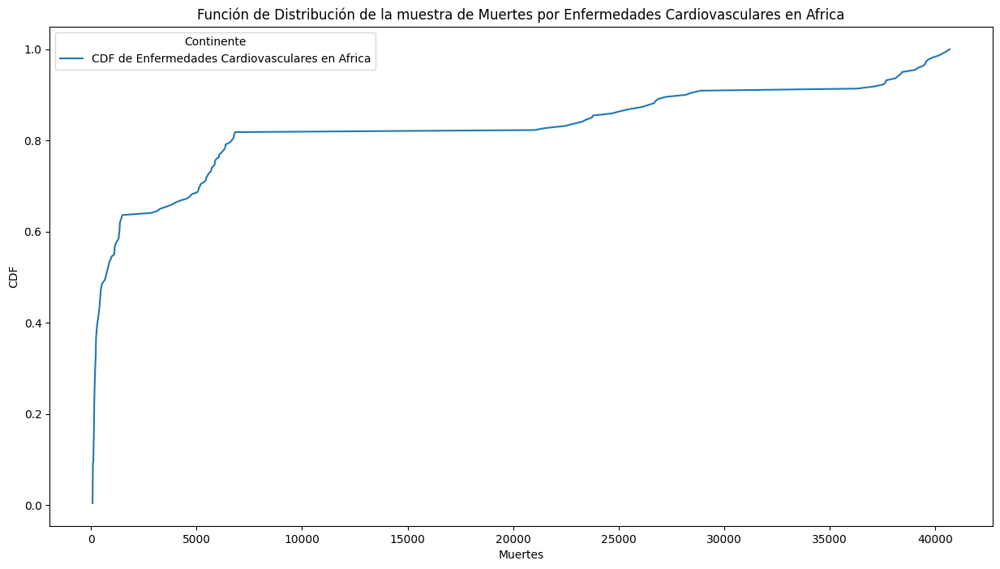

La CDF por Enfermedades Cardiovasculares es:
[0.00454545 0.00909091 0.01363636 0.01818182 0.02272727 0.02727273
 0.03181818 0.03636364 0.04090909 0.04545455 0.05       0.05454545
 0.05909091 0.06363636 0.06818182 0.07272727 0.07727273 0.08181818
 0.08636364 0.09090909 0.09545455 0.1        0.10454545 0.10909091
 0.11363636 0.11818182 0.12272727 0.12727273 0.13181818 0.13636364
 0.14090909 0.14545455 0.15       0.15454545 0.15909091 0.16363636
 0.16818182 0.17272727 0.17727273 0.18181818 0.18636364 0.19090909
 0.19545455 0.2        0.20454545 0.20909091 0.21363636 0.21818182
 0.22272727 0.22727273 0.23181818 0.23636364 0.24090909 0.24545455
 0.25       0.25454545 0.25909091 0.26363636 0.26818182 0.27272727
 0.27727273 0.28181818 0.28636364 0.29090909 0.29545455 0.3
 0.30454545 0.30909091 0.31363636 0.31818182 0.32272727 0.32727273
 0.33181818 0.33636364 0.34090909 0.34545455 0.35       0.35454545
 0.35909091 0.36363636 0.36818182 0.37272727 0.37727273 0.38181818
 0.38636364 0.39090909 0

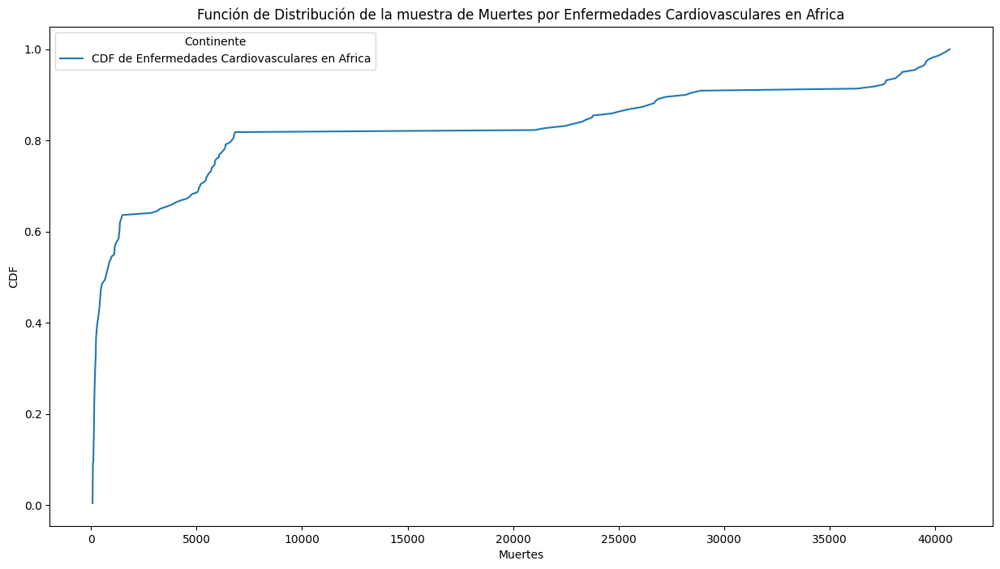

La CDF por Enfermedades Cardiovasculares es:
[0.00454545 0.00909091 0.01363636 0.01818182 0.02272727 0.02727273
 0.03181818 0.03636364 0.04090909 0.04545455 0.05       0.05454545
 0.05909091 0.06363636 0.06818182 0.07272727 0.07727273 0.08181818
 0.08636364 0.09090909 0.09545455 0.1        0.10454545 0.10909091
 0.11363636 0.11818182 0.12272727 0.12727273 0.13181818 0.13636364
 0.14090909 0.14545455 0.15       0.15454545 0.15909091 0.16363636
 0.16818182 0.17272727 0.17727273 0.18181818 0.18636364 0.19090909
 0.19545455 0.2        0.20454545 0.20909091 0.21363636 0.21818182
 0.22272727 0.22727273 0.23181818 0.23636364 0.24090909 0.24545455
 0.25       0.25454545 0.25909091 0.26363636 0.26818182 0.27272727
 0.27727273 0.28181818 0.28636364 0.29090909 0.29545455 0.3
 0.30454545 0.30909091 0.31363636 0.31818182 0.32272727 0.32727273
 0.33181818 0.33636364 0.34090909 0.34545455 0.35       0.35454545
 0.35909091 0.36363636 0.36818182 0.37272727 0.37727273 0.38181818
 0.38636364 0.39090909 0

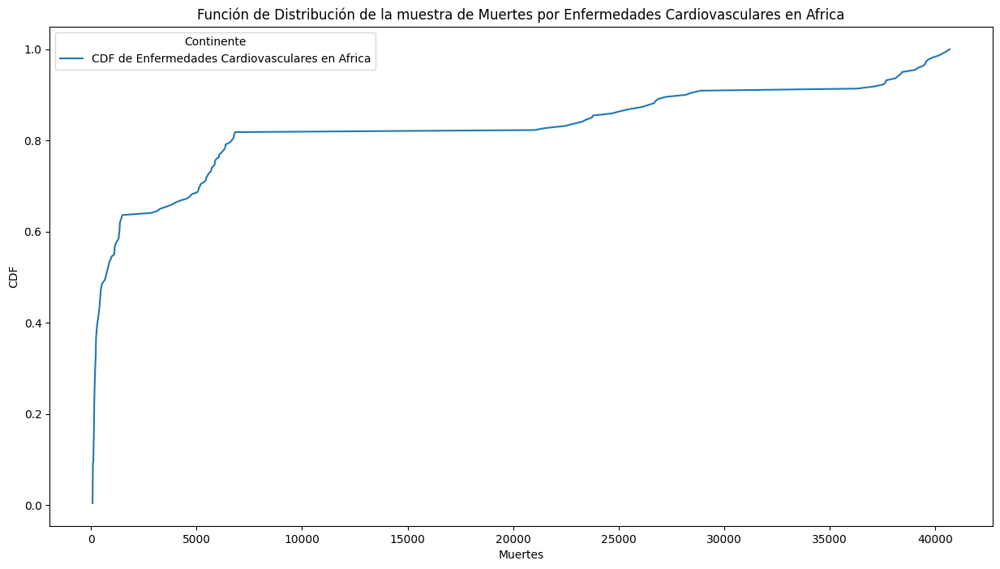

La CDF por Enfermedades Cardiovasculares es:
[0.00454545 0.00909091 0.01363636 0.01818182 0.02272727 0.02727273
 0.03181818 0.03636364 0.04090909 0.04545455 0.05       0.05454545
 0.05909091 0.06363636 0.06818182 0.07272727 0.07727273 0.08181818
 0.08636364 0.09090909 0.09545455 0.1        0.10454545 0.10909091
 0.11363636 0.11818182 0.12272727 0.12727273 0.13181818 0.13636364
 0.14090909 0.14545455 0.15       0.15454545 0.15909091 0.16363636
 0.16818182 0.17272727 0.17727273 0.18181818 0.18636364 0.19090909
 0.19545455 0.2        0.20454545 0.20909091 0.21363636 0.21818182
 0.22272727 0.22727273 0.23181818 0.23636364 0.24090909 0.24545455
 0.25       0.25454545 0.25909091 0.26363636 0.26818182 0.27272727
 0.27727273 0.28181818 0.28636364 0.29090909 0.29545455 0.3
 0.30454545 0.30909091 0.31363636 0.31818182 0.32272727 0.32727273
 0.33181818 0.33636364 0.34090909 0.34545455 0.35       0.35454545
 0.35909091 0.36363636 0.36818182 0.37272727 0.37727273 0.38181818
 0.38636364 0.39090909 0

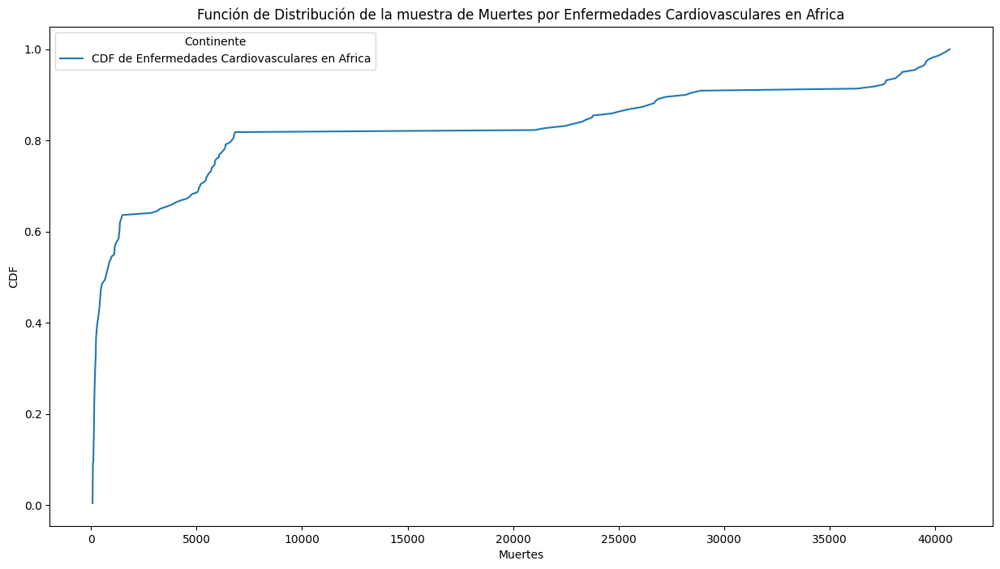

Distribución acumulativa por Enfermedades Cardiovasculares en Asia
La CDF por Enfermedades Cardiovasculares es:
[0.00454545 0.00909091 0.01363636 0.01818182 0.02272727 0.02727273
 0.03181818 0.03636364 0.04090909 0.04545455 0.05       0.05454545
 0.05909091 0.06363636 0.06818182 0.07272727 0.07727273 0.08181818
 0.08636364 0.09090909 0.09545455 0.1        0.10454545 0.10909091
 0.11363636 0.11818182 0.12272727 0.12727273 0.13181818 0.13636364
 0.14090909 0.14545455 0.15       0.15454545 0.15909091 0.16363636
 0.16818182 0.17272727 0.17727273 0.18181818 0.18636364 0.19090909
 0.19545455 0.2        0.20454545 0.20909091 0.21363636 0.21818182
 0.22272727 0.22727273 0.23181818 0.23636364 0.24090909 0.24545455
 0.25       0.25454545 0.25909091 0.26363636 0.26818182 0.27272727
 0.27727273 0.28181818 0.28636364 0.29090909 0.29545455 0.3
 0.30454545 0.30909091 0.31363636 0.31818182 0.32272727 0.32727273
 0.33181818 0.33636364 0.34090909 0.34545455 0.35       0.35454545
 0.35909091 0.36363636 0

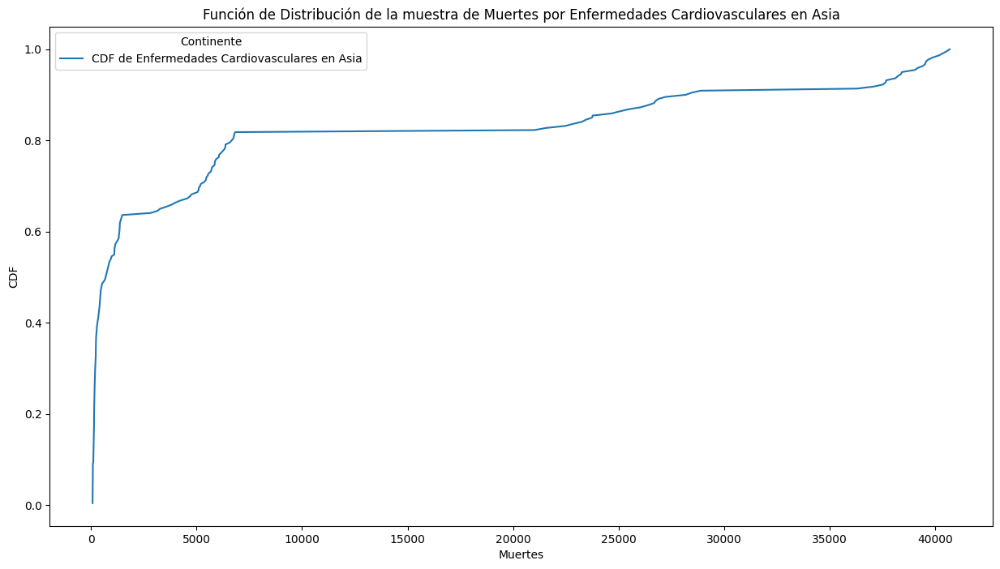

La CDF por Enfermedades Cardiovasculares es:
[0.00454545 0.00909091 0.01363636 0.01818182 0.02272727 0.02727273
 0.03181818 0.03636364 0.04090909 0.04545455 0.05       0.05454545
 0.05909091 0.06363636 0.06818182 0.07272727 0.07727273 0.08181818
 0.08636364 0.09090909 0.09545455 0.1        0.10454545 0.10909091
 0.11363636 0.11818182 0.12272727 0.12727273 0.13181818 0.13636364
 0.14090909 0.14545455 0.15       0.15454545 0.15909091 0.16363636
 0.16818182 0.17272727 0.17727273 0.18181818 0.18636364 0.19090909
 0.19545455 0.2        0.20454545 0.20909091 0.21363636 0.21818182
 0.22272727 0.22727273 0.23181818 0.23636364 0.24090909 0.24545455
 0.25       0.25454545 0.25909091 0.26363636 0.26818182 0.27272727
 0.27727273 0.28181818 0.28636364 0.29090909 0.29545455 0.3
 0.30454545 0.30909091 0.31363636 0.31818182 0.32272727 0.32727273
 0.33181818 0.33636364 0.34090909 0.34545455 0.35       0.35454545
 0.35909091 0.36363636 0.36818182 0.37272727 0.37727273 0.38181818
 0.38636364 0.39090909 0

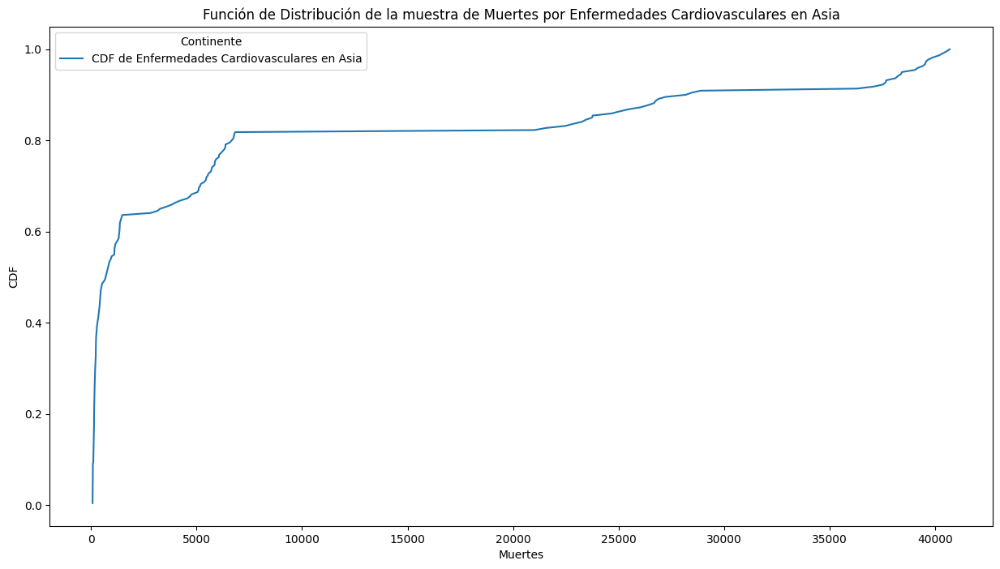

La CDF por Enfermedades Cardiovasculares es:
[0.00454545 0.00909091 0.01363636 0.01818182 0.02272727 0.02727273
 0.03181818 0.03636364 0.04090909 0.04545455 0.05       0.05454545
 0.05909091 0.06363636 0.06818182 0.07272727 0.07727273 0.08181818
 0.08636364 0.09090909 0.09545455 0.1        0.10454545 0.10909091
 0.11363636 0.11818182 0.12272727 0.12727273 0.13181818 0.13636364
 0.14090909 0.14545455 0.15       0.15454545 0.15909091 0.16363636
 0.16818182 0.17272727 0.17727273 0.18181818 0.18636364 0.19090909
 0.19545455 0.2        0.20454545 0.20909091 0.21363636 0.21818182
 0.22272727 0.22727273 0.23181818 0.23636364 0.24090909 0.24545455
 0.25       0.25454545 0.25909091 0.26363636 0.26818182 0.27272727
 0.27727273 0.28181818 0.28636364 0.29090909 0.29545455 0.3
 0.30454545 0.30909091 0.31363636 0.31818182 0.32272727 0.32727273
 0.33181818 0.33636364 0.34090909 0.34545455 0.35       0.35454545
 0.35909091 0.36363636 0.36818182 0.37272727 0.37727273 0.38181818
 0.38636364 0.39090909 0

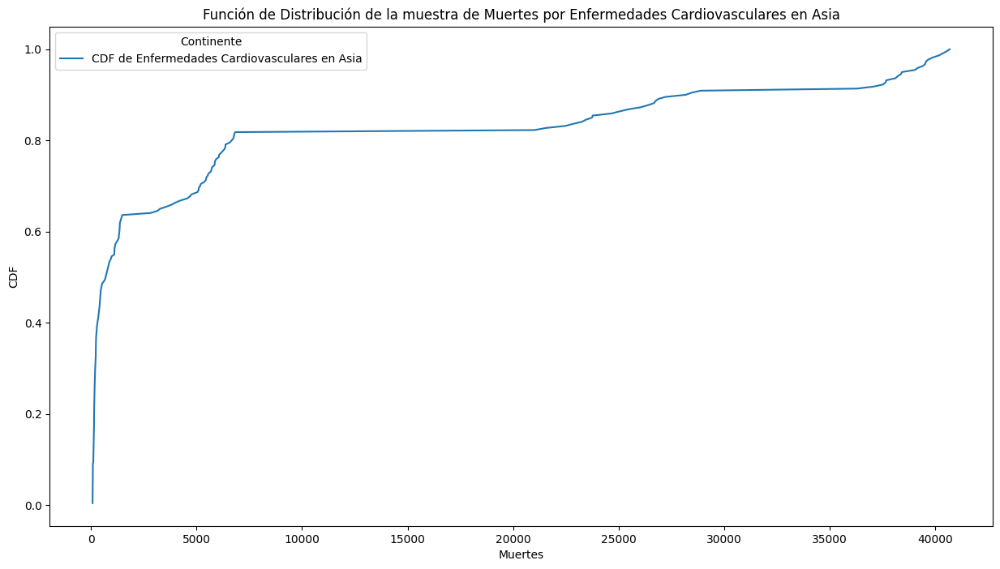

La CDF por Enfermedades Cardiovasculares es:
[0.00454545 0.00909091 0.01363636 0.01818182 0.02272727 0.02727273
 0.03181818 0.03636364 0.04090909 0.04545455 0.05       0.05454545
 0.05909091 0.06363636 0.06818182 0.07272727 0.07727273 0.08181818
 0.08636364 0.09090909 0.09545455 0.1        0.10454545 0.10909091
 0.11363636 0.11818182 0.12272727 0.12727273 0.13181818 0.13636364
 0.14090909 0.14545455 0.15       0.15454545 0.15909091 0.16363636
 0.16818182 0.17272727 0.17727273 0.18181818 0.18636364 0.19090909
 0.19545455 0.2        0.20454545 0.20909091 0.21363636 0.21818182
 0.22272727 0.22727273 0.23181818 0.23636364 0.24090909 0.24545455
 0.25       0.25454545 0.25909091 0.26363636 0.26818182 0.27272727
 0.27727273 0.28181818 0.28636364 0.29090909 0.29545455 0.3
 0.30454545 0.30909091 0.31363636 0.31818182 0.32272727 0.32727273
 0.33181818 0.33636364 0.34090909 0.34545455 0.35       0.35454545
 0.35909091 0.36363636 0.36818182 0.37272727 0.37727273 0.38181818
 0.38636364 0.39090909 0

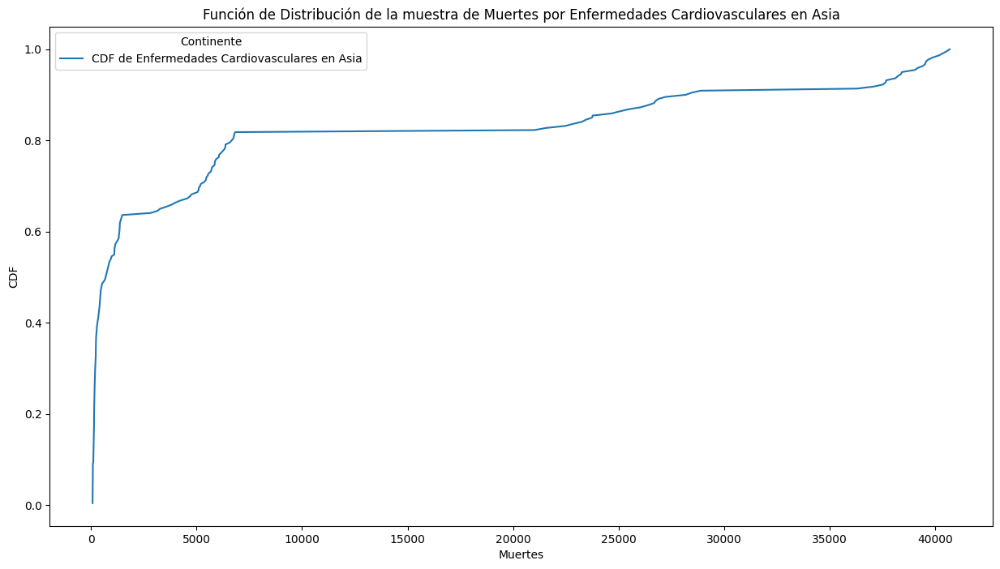

La CDF por Enfermedades Cardiovasculares es:
[0.00454545 0.00909091 0.01363636 0.01818182 0.02272727 0.02727273
 0.03181818 0.03636364 0.04090909 0.04545455 0.05       0.05454545
 0.05909091 0.06363636 0.06818182 0.07272727 0.07727273 0.08181818
 0.08636364 0.09090909 0.09545455 0.1        0.10454545 0.10909091
 0.11363636 0.11818182 0.12272727 0.12727273 0.13181818 0.13636364
 0.14090909 0.14545455 0.15       0.15454545 0.15909091 0.16363636
 0.16818182 0.17272727 0.17727273 0.18181818 0.18636364 0.19090909
 0.19545455 0.2        0.20454545 0.20909091 0.21363636 0.21818182
 0.22272727 0.22727273 0.23181818 0.23636364 0.24090909 0.24545455
 0.25       0.25454545 0.25909091 0.26363636 0.26818182 0.27272727
 0.27727273 0.28181818 0.28636364 0.29090909 0.29545455 0.3
 0.30454545 0.30909091 0.31363636 0.31818182 0.32272727 0.32727273
 0.33181818 0.33636364 0.34090909 0.34545455 0.35       0.35454545
 0.35909091 0.36363636 0.36818182 0.37272727 0.37727273 0.38181818
 0.38636364 0.39090909 0

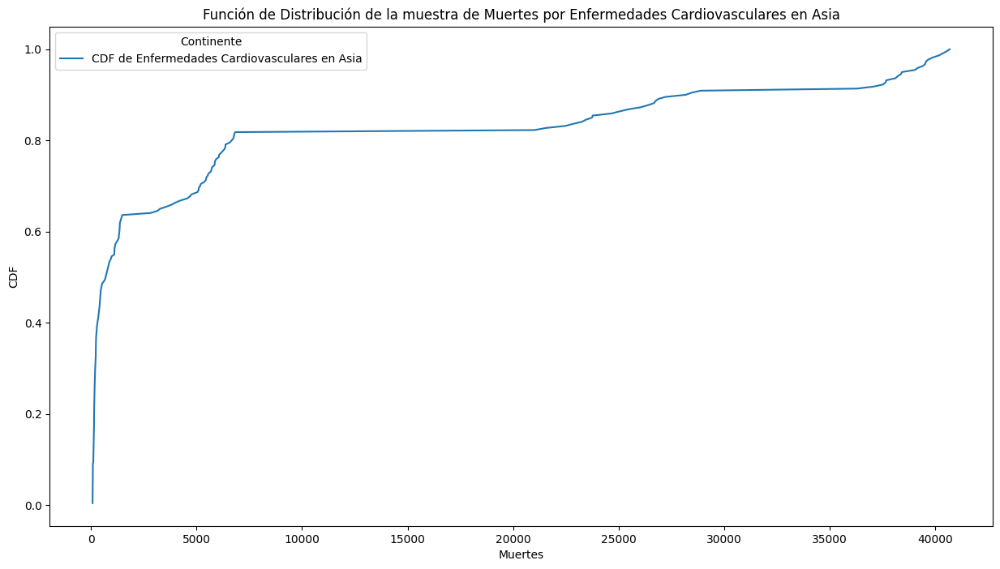

Distribución acumulativa por Enfermedades Cardiovasculares en Europe
La CDF por Enfermedades Cardiovasculares es:
[0.00454545 0.00909091 0.01363636 0.01818182 0.02272727 0.02727273
 0.03181818 0.03636364 0.04090909 0.04545455 0.05       0.05454545
 0.05909091 0.06363636 0.06818182 0.07272727 0.07727273 0.08181818
 0.08636364 0.09090909 0.09545455 0.1        0.10454545 0.10909091
 0.11363636 0.11818182 0.12272727 0.12727273 0.13181818 0.13636364
 0.14090909 0.14545455 0.15       0.15454545 0.15909091 0.16363636
 0.16818182 0.17272727 0.17727273 0.18181818 0.18636364 0.19090909
 0.19545455 0.2        0.20454545 0.20909091 0.21363636 0.21818182
 0.22272727 0.22727273 0.23181818 0.23636364 0.24090909 0.24545455
 0.25       0.25454545 0.25909091 0.26363636 0.26818182 0.27272727
 0.27727273 0.28181818 0.28636364 0.29090909 0.29545455 0.3
 0.30454545 0.30909091 0.31363636 0.31818182 0.32272727 0.32727273
 0.33181818 0.33636364 0.34090909 0.34545455 0.35       0.35454545
 0.35909091 0.36363636

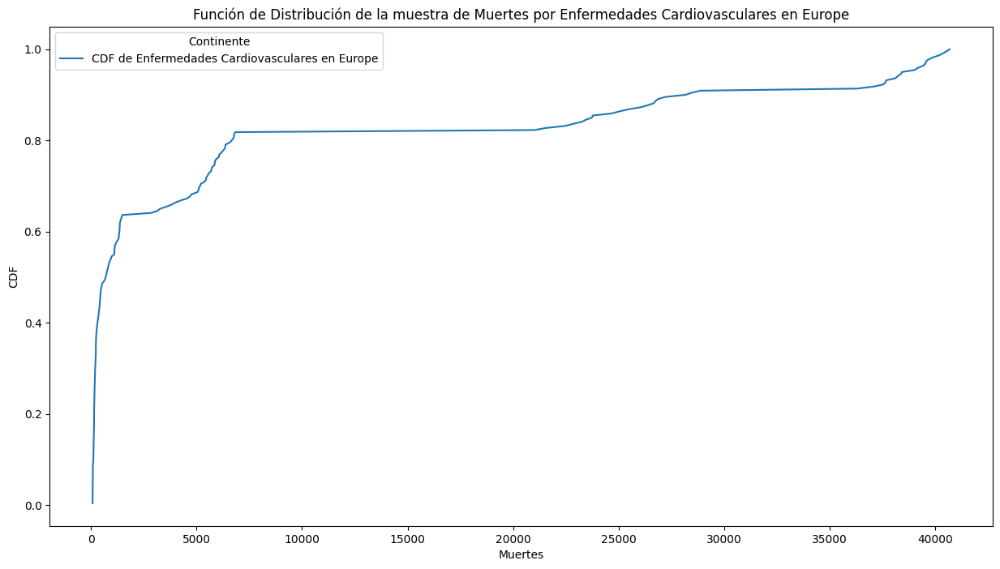

La CDF por Enfermedades Cardiovasculares es:
[0.00454545 0.00909091 0.01363636 0.01818182 0.02272727 0.02727273
 0.03181818 0.03636364 0.04090909 0.04545455 0.05       0.05454545
 0.05909091 0.06363636 0.06818182 0.07272727 0.07727273 0.08181818
 0.08636364 0.09090909 0.09545455 0.1        0.10454545 0.10909091
 0.11363636 0.11818182 0.12272727 0.12727273 0.13181818 0.13636364
 0.14090909 0.14545455 0.15       0.15454545 0.15909091 0.16363636
 0.16818182 0.17272727 0.17727273 0.18181818 0.18636364 0.19090909
 0.19545455 0.2        0.20454545 0.20909091 0.21363636 0.21818182
 0.22272727 0.22727273 0.23181818 0.23636364 0.24090909 0.24545455
 0.25       0.25454545 0.25909091 0.26363636 0.26818182 0.27272727
 0.27727273 0.28181818 0.28636364 0.29090909 0.29545455 0.3
 0.30454545 0.30909091 0.31363636 0.31818182 0.32272727 0.32727273
 0.33181818 0.33636364 0.34090909 0.34545455 0.35       0.35454545
 0.35909091 0.36363636 0.36818182 0.37272727 0.37727273 0.38181818
 0.38636364 0.39090909 0

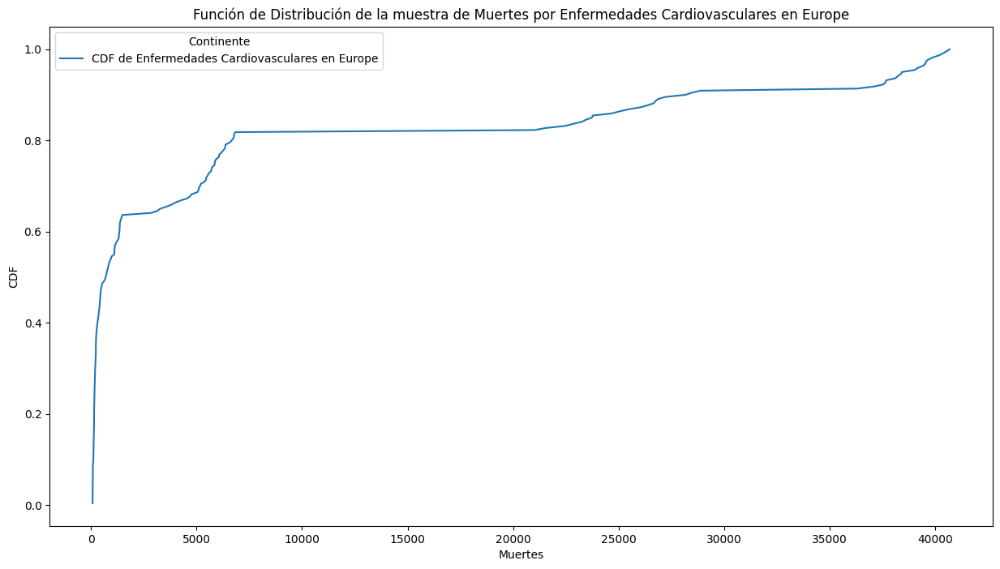

La CDF por Enfermedades Cardiovasculares es:
[0.00454545 0.00909091 0.01363636 0.01818182 0.02272727 0.02727273
 0.03181818 0.03636364 0.04090909 0.04545455 0.05       0.05454545
 0.05909091 0.06363636 0.06818182 0.07272727 0.07727273 0.08181818
 0.08636364 0.09090909 0.09545455 0.1        0.10454545 0.10909091
 0.11363636 0.11818182 0.12272727 0.12727273 0.13181818 0.13636364
 0.14090909 0.14545455 0.15       0.15454545 0.15909091 0.16363636
 0.16818182 0.17272727 0.17727273 0.18181818 0.18636364 0.19090909
 0.19545455 0.2        0.20454545 0.20909091 0.21363636 0.21818182
 0.22272727 0.22727273 0.23181818 0.23636364 0.24090909 0.24545455
 0.25       0.25454545 0.25909091 0.26363636 0.26818182 0.27272727
 0.27727273 0.28181818 0.28636364 0.29090909 0.29545455 0.3
 0.30454545 0.30909091 0.31363636 0.31818182 0.32272727 0.32727273
 0.33181818 0.33636364 0.34090909 0.34545455 0.35       0.35454545
 0.35909091 0.36363636 0.36818182 0.37272727 0.37727273 0.38181818
 0.38636364 0.39090909 0

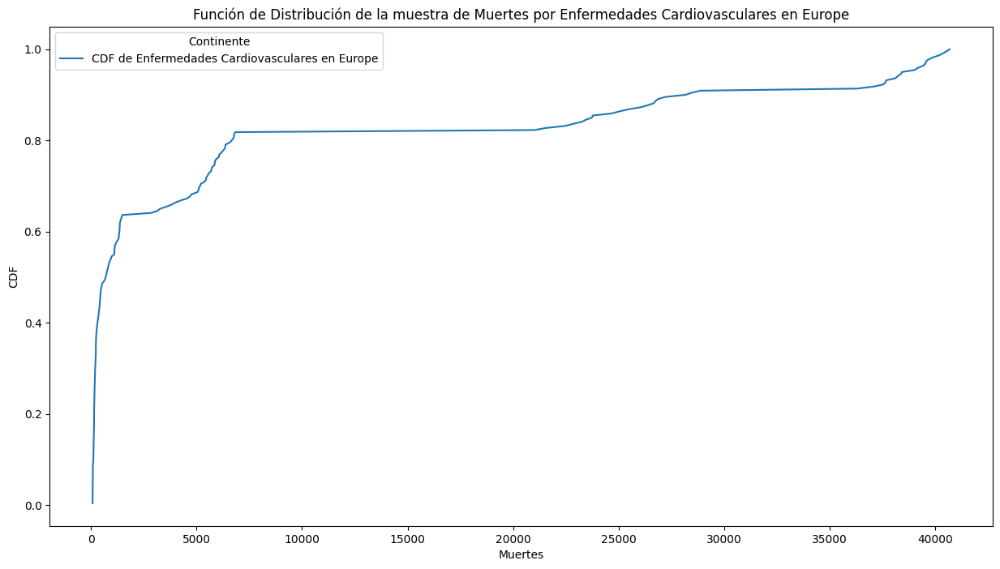

La CDF por Enfermedades Cardiovasculares es:
[0.00454545 0.00909091 0.01363636 0.01818182 0.02272727 0.02727273
 0.03181818 0.03636364 0.04090909 0.04545455 0.05       0.05454545
 0.05909091 0.06363636 0.06818182 0.07272727 0.07727273 0.08181818
 0.08636364 0.09090909 0.09545455 0.1        0.10454545 0.10909091
 0.11363636 0.11818182 0.12272727 0.12727273 0.13181818 0.13636364
 0.14090909 0.14545455 0.15       0.15454545 0.15909091 0.16363636
 0.16818182 0.17272727 0.17727273 0.18181818 0.18636364 0.19090909
 0.19545455 0.2        0.20454545 0.20909091 0.21363636 0.21818182
 0.22272727 0.22727273 0.23181818 0.23636364 0.24090909 0.24545455
 0.25       0.25454545 0.25909091 0.26363636 0.26818182 0.27272727
 0.27727273 0.28181818 0.28636364 0.29090909 0.29545455 0.3
 0.30454545 0.30909091 0.31363636 0.31818182 0.32272727 0.32727273
 0.33181818 0.33636364 0.34090909 0.34545455 0.35       0.35454545
 0.35909091 0.36363636 0.36818182 0.37272727 0.37727273 0.38181818
 0.38636364 0.39090909 0

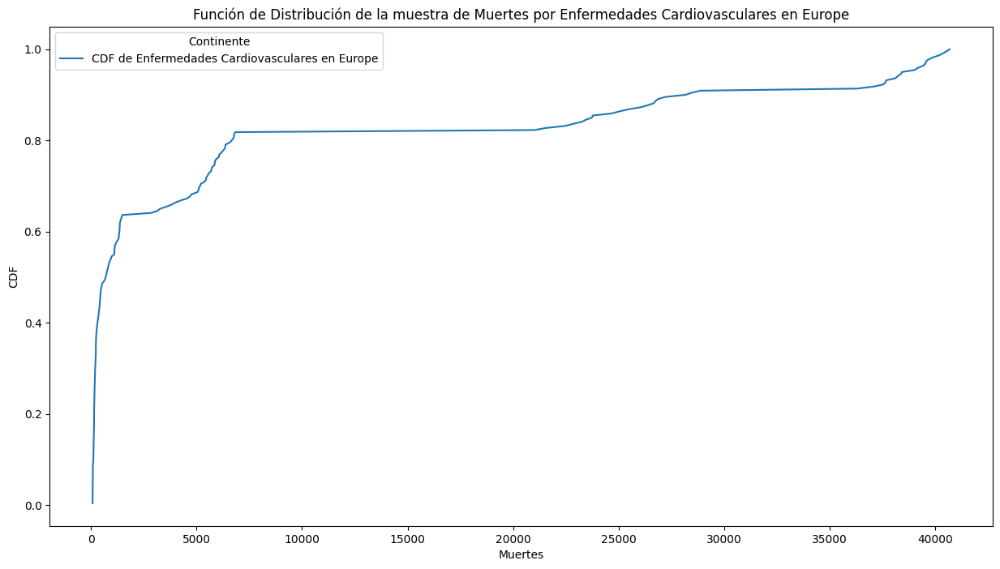

La CDF por Enfermedades Cardiovasculares es:
[0.00454545 0.00909091 0.01363636 0.01818182 0.02272727 0.02727273
 0.03181818 0.03636364 0.04090909 0.04545455 0.05       0.05454545
 0.05909091 0.06363636 0.06818182 0.07272727 0.07727273 0.08181818
 0.08636364 0.09090909 0.09545455 0.1        0.10454545 0.10909091
 0.11363636 0.11818182 0.12272727 0.12727273 0.13181818 0.13636364
 0.14090909 0.14545455 0.15       0.15454545 0.15909091 0.16363636
 0.16818182 0.17272727 0.17727273 0.18181818 0.18636364 0.19090909
 0.19545455 0.2        0.20454545 0.20909091 0.21363636 0.21818182
 0.22272727 0.22727273 0.23181818 0.23636364 0.24090909 0.24545455
 0.25       0.25454545 0.25909091 0.26363636 0.26818182 0.27272727
 0.27727273 0.28181818 0.28636364 0.29090909 0.29545455 0.3
 0.30454545 0.30909091 0.31363636 0.31818182 0.32272727 0.32727273
 0.33181818 0.33636364 0.34090909 0.34545455 0.35       0.35454545
 0.35909091 0.36363636 0.36818182 0.37272727 0.37727273 0.38181818
 0.38636364 0.39090909 0

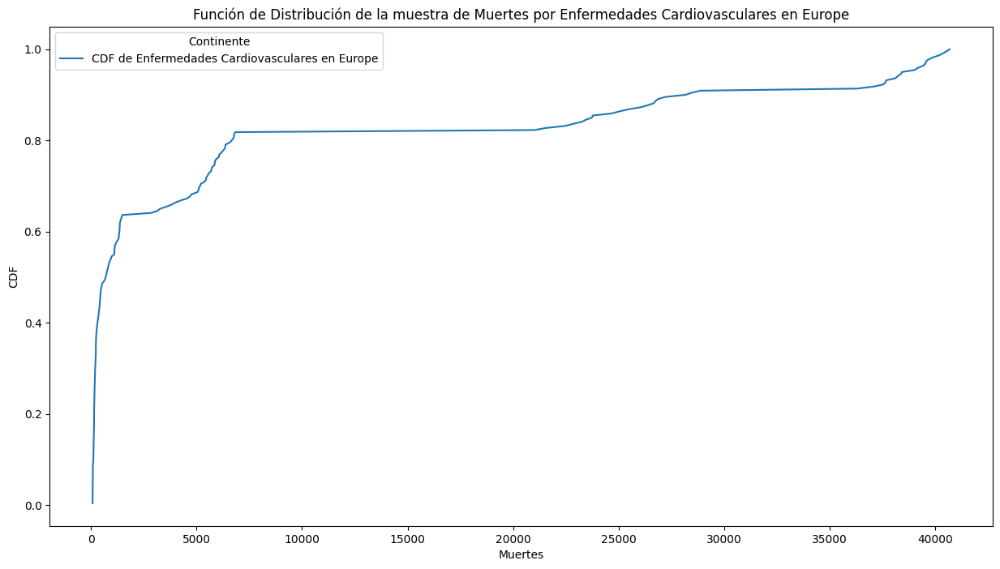

Distribución acumulativa por Enfermedades Cardiovasculares en North America
La CDF por Enfermedades Cardiovasculares es:
[0.00454545 0.00909091 0.01363636 0.01818182 0.02272727 0.02727273
 0.03181818 0.03636364 0.04090909 0.04545455 0.05       0.05454545
 0.05909091 0.06363636 0.06818182 0.07272727 0.07727273 0.08181818
 0.08636364 0.09090909 0.09545455 0.1        0.10454545 0.10909091
 0.11363636 0.11818182 0.12272727 0.12727273 0.13181818 0.13636364
 0.14090909 0.14545455 0.15       0.15454545 0.15909091 0.16363636
 0.16818182 0.17272727 0.17727273 0.18181818 0.18636364 0.19090909
 0.19545455 0.2        0.20454545 0.20909091 0.21363636 0.21818182
 0.22272727 0.22727273 0.23181818 0.23636364 0.24090909 0.24545455
 0.25       0.25454545 0.25909091 0.26363636 0.26818182 0.27272727
 0.27727273 0.28181818 0.28636364 0.29090909 0.29545455 0.3
 0.30454545 0.30909091 0.31363636 0.31818182 0.32272727 0.32727273
 0.33181818 0.33636364 0.34090909 0.34545455 0.35       0.35454545
 0.35909091 0.3

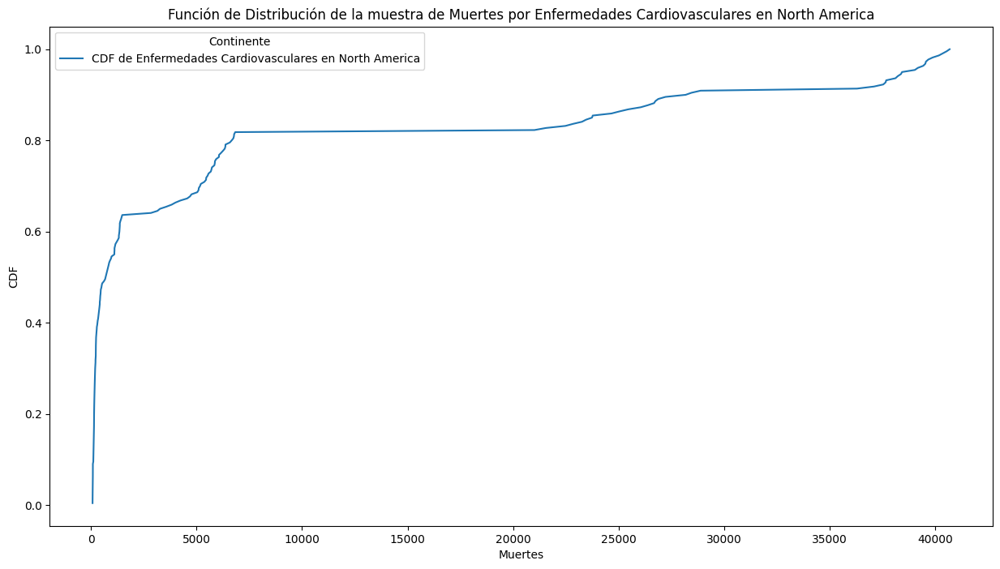

La CDF por Enfermedades Cardiovasculares es:
[0.00454545 0.00909091 0.01363636 0.01818182 0.02272727 0.02727273
 0.03181818 0.03636364 0.04090909 0.04545455 0.05       0.05454545
 0.05909091 0.06363636 0.06818182 0.07272727 0.07727273 0.08181818
 0.08636364 0.09090909 0.09545455 0.1        0.10454545 0.10909091
 0.11363636 0.11818182 0.12272727 0.12727273 0.13181818 0.13636364
 0.14090909 0.14545455 0.15       0.15454545 0.15909091 0.16363636
 0.16818182 0.17272727 0.17727273 0.18181818 0.18636364 0.19090909
 0.19545455 0.2        0.20454545 0.20909091 0.21363636 0.21818182
 0.22272727 0.22727273 0.23181818 0.23636364 0.24090909 0.24545455
 0.25       0.25454545 0.25909091 0.26363636 0.26818182 0.27272727
 0.27727273 0.28181818 0.28636364 0.29090909 0.29545455 0.3
 0.30454545 0.30909091 0.31363636 0.31818182 0.32272727 0.32727273
 0.33181818 0.33636364 0.34090909 0.34545455 0.35       0.35454545
 0.35909091 0.36363636 0.36818182 0.37272727 0.37727273 0.38181818
 0.38636364 0.39090909 0

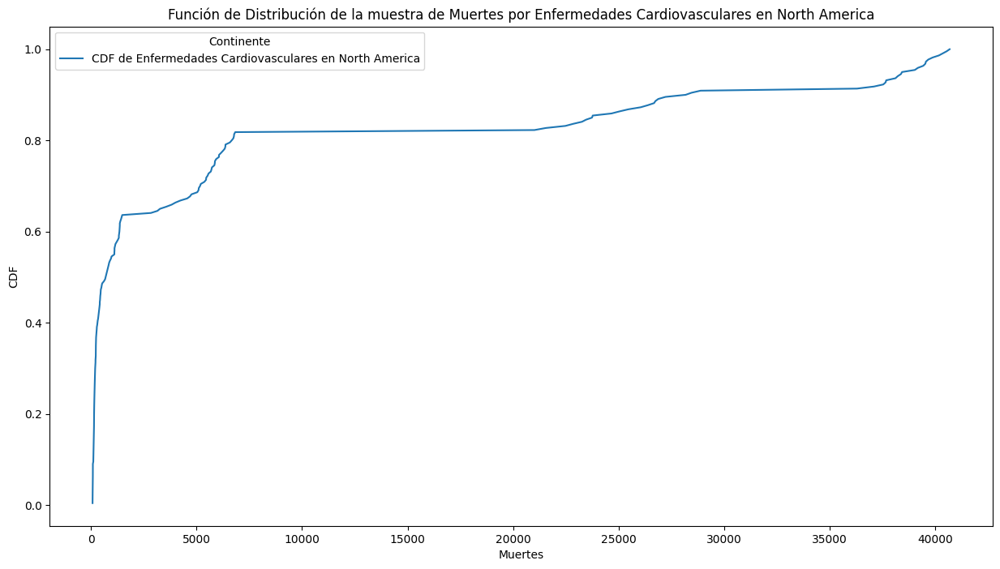

La CDF por Enfermedades Cardiovasculares es:
[0.00454545 0.00909091 0.01363636 0.01818182 0.02272727 0.02727273
 0.03181818 0.03636364 0.04090909 0.04545455 0.05       0.05454545
 0.05909091 0.06363636 0.06818182 0.07272727 0.07727273 0.08181818
 0.08636364 0.09090909 0.09545455 0.1        0.10454545 0.10909091
 0.11363636 0.11818182 0.12272727 0.12727273 0.13181818 0.13636364
 0.14090909 0.14545455 0.15       0.15454545 0.15909091 0.16363636
 0.16818182 0.17272727 0.17727273 0.18181818 0.18636364 0.19090909
 0.19545455 0.2        0.20454545 0.20909091 0.21363636 0.21818182
 0.22272727 0.22727273 0.23181818 0.23636364 0.24090909 0.24545455
 0.25       0.25454545 0.25909091 0.26363636 0.26818182 0.27272727
 0.27727273 0.28181818 0.28636364 0.29090909 0.29545455 0.3
 0.30454545 0.30909091 0.31363636 0.31818182 0.32272727 0.32727273
 0.33181818 0.33636364 0.34090909 0.34545455 0.35       0.35454545
 0.35909091 0.36363636 0.36818182 0.37272727 0.37727273 0.38181818
 0.38636364 0.39090909 0

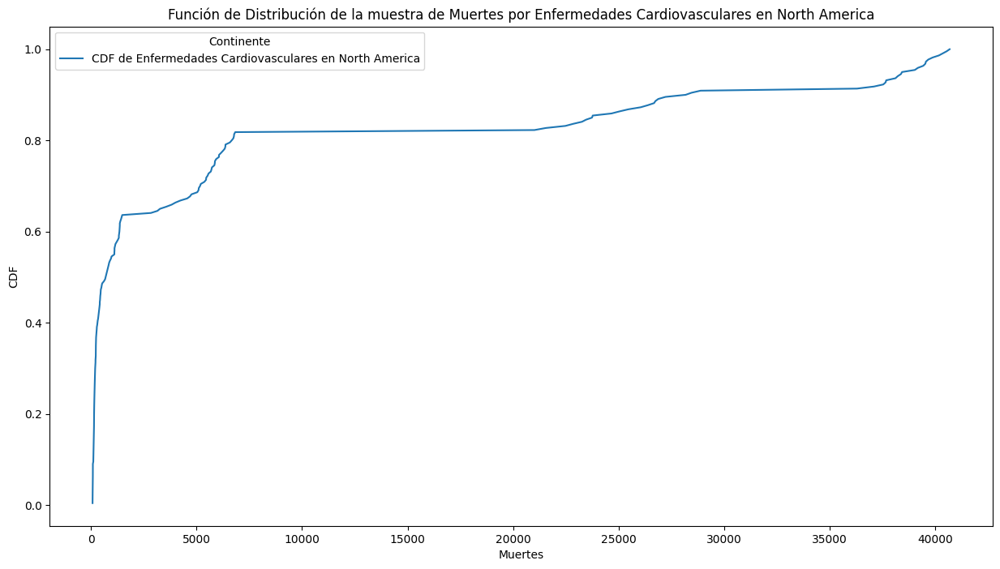

La CDF por Enfermedades Cardiovasculares es:
[0.00454545 0.00909091 0.01363636 0.01818182 0.02272727 0.02727273
 0.03181818 0.03636364 0.04090909 0.04545455 0.05       0.05454545
 0.05909091 0.06363636 0.06818182 0.07272727 0.07727273 0.08181818
 0.08636364 0.09090909 0.09545455 0.1        0.10454545 0.10909091
 0.11363636 0.11818182 0.12272727 0.12727273 0.13181818 0.13636364
 0.14090909 0.14545455 0.15       0.15454545 0.15909091 0.16363636
 0.16818182 0.17272727 0.17727273 0.18181818 0.18636364 0.19090909
 0.19545455 0.2        0.20454545 0.20909091 0.21363636 0.21818182
 0.22272727 0.22727273 0.23181818 0.23636364 0.24090909 0.24545455
 0.25       0.25454545 0.25909091 0.26363636 0.26818182 0.27272727
 0.27727273 0.28181818 0.28636364 0.29090909 0.29545455 0.3
 0.30454545 0.30909091 0.31363636 0.31818182 0.32272727 0.32727273
 0.33181818 0.33636364 0.34090909 0.34545455 0.35       0.35454545
 0.35909091 0.36363636 0.36818182 0.37272727 0.37727273 0.38181818
 0.38636364 0.39090909 0

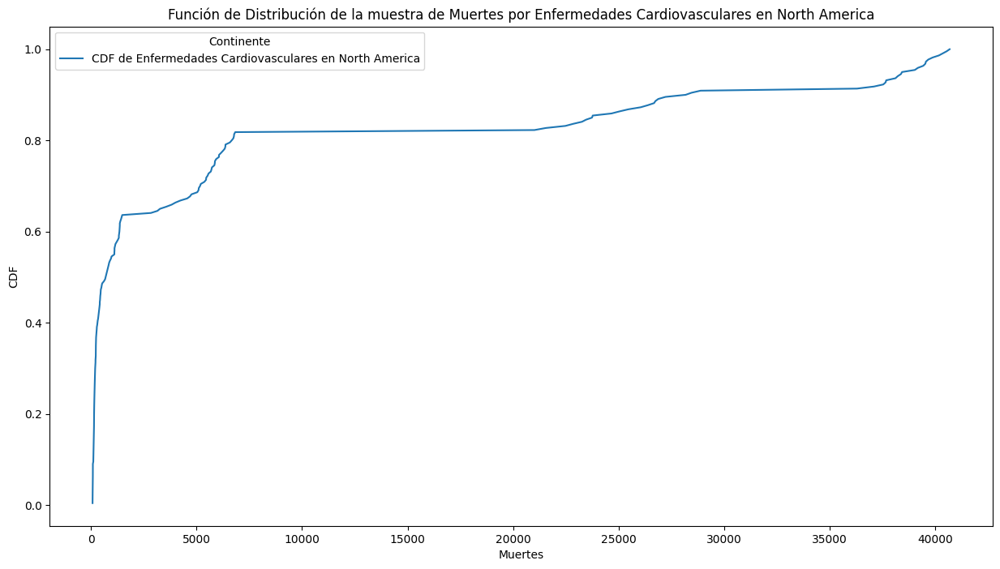

La CDF por Enfermedades Cardiovasculares es:
[0.00454545 0.00909091 0.01363636 0.01818182 0.02272727 0.02727273
 0.03181818 0.03636364 0.04090909 0.04545455 0.05       0.05454545
 0.05909091 0.06363636 0.06818182 0.07272727 0.07727273 0.08181818
 0.08636364 0.09090909 0.09545455 0.1        0.10454545 0.10909091
 0.11363636 0.11818182 0.12272727 0.12727273 0.13181818 0.13636364
 0.14090909 0.14545455 0.15       0.15454545 0.15909091 0.16363636
 0.16818182 0.17272727 0.17727273 0.18181818 0.18636364 0.19090909
 0.19545455 0.2        0.20454545 0.20909091 0.21363636 0.21818182
 0.22272727 0.22727273 0.23181818 0.23636364 0.24090909 0.24545455
 0.25       0.25454545 0.25909091 0.26363636 0.26818182 0.27272727
 0.27727273 0.28181818 0.28636364 0.29090909 0.29545455 0.3
 0.30454545 0.30909091 0.31363636 0.31818182 0.32272727 0.32727273
 0.33181818 0.33636364 0.34090909 0.34545455 0.35       0.35454545
 0.35909091 0.36363636 0.36818182 0.37272727 0.37727273 0.38181818
 0.38636364 0.39090909 0

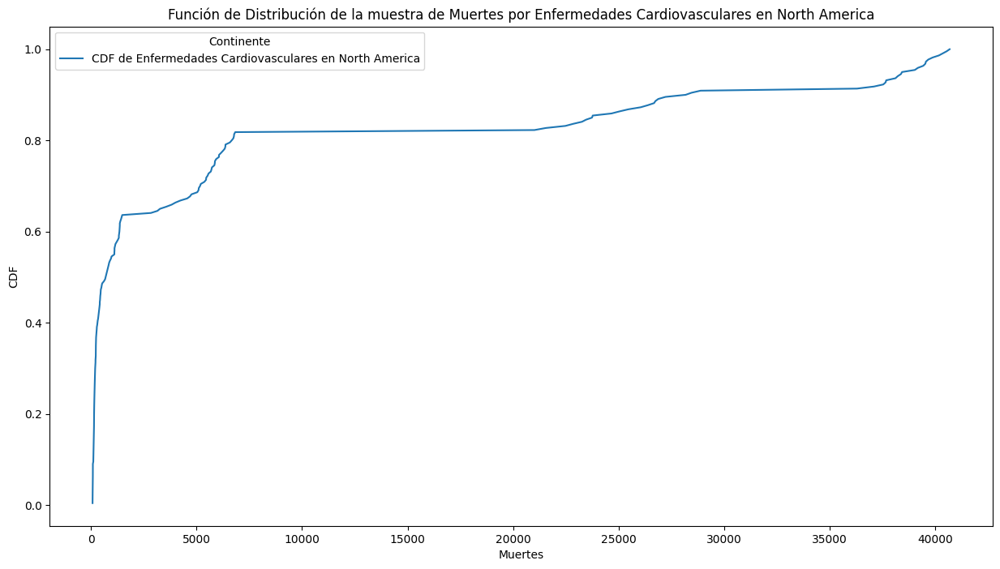

Distribución acumulativa por Enfermedades Cardiovasculares en South America
La CDF por Enfermedades Cardiovasculares es:
[0.00454545 0.00909091 0.01363636 0.01818182 0.02272727 0.02727273
 0.03181818 0.03636364 0.04090909 0.04545455 0.05       0.05454545
 0.05909091 0.06363636 0.06818182 0.07272727 0.07727273 0.08181818
 0.08636364 0.09090909 0.09545455 0.1        0.10454545 0.10909091
 0.11363636 0.11818182 0.12272727 0.12727273 0.13181818 0.13636364
 0.14090909 0.14545455 0.15       0.15454545 0.15909091 0.16363636
 0.16818182 0.17272727 0.17727273 0.18181818 0.18636364 0.19090909
 0.19545455 0.2        0.20454545 0.20909091 0.21363636 0.21818182
 0.22272727 0.22727273 0.23181818 0.23636364 0.24090909 0.24545455
 0.25       0.25454545 0.25909091 0.26363636 0.26818182 0.27272727
 0.27727273 0.28181818 0.28636364 0.29090909 0.29545455 0.3
 0.30454545 0.30909091 0.31363636 0.31818182 0.32272727 0.32727273
 0.33181818 0.33636364 0.34090909 0.34545455 0.35       0.35454545
 0.35909091 0.3

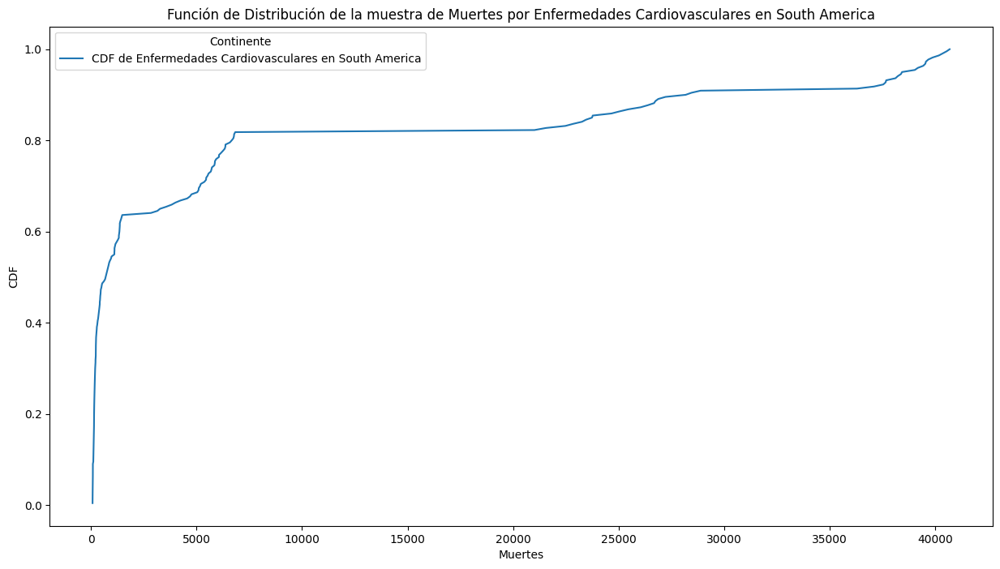

La CDF por Enfermedades Cardiovasculares es:
[0.00454545 0.00909091 0.01363636 0.01818182 0.02272727 0.02727273
 0.03181818 0.03636364 0.04090909 0.04545455 0.05       0.05454545
 0.05909091 0.06363636 0.06818182 0.07272727 0.07727273 0.08181818
 0.08636364 0.09090909 0.09545455 0.1        0.10454545 0.10909091
 0.11363636 0.11818182 0.12272727 0.12727273 0.13181818 0.13636364
 0.14090909 0.14545455 0.15       0.15454545 0.15909091 0.16363636
 0.16818182 0.17272727 0.17727273 0.18181818 0.18636364 0.19090909
 0.19545455 0.2        0.20454545 0.20909091 0.21363636 0.21818182
 0.22272727 0.22727273 0.23181818 0.23636364 0.24090909 0.24545455
 0.25       0.25454545 0.25909091 0.26363636 0.26818182 0.27272727
 0.27727273 0.28181818 0.28636364 0.29090909 0.29545455 0.3
 0.30454545 0.30909091 0.31363636 0.31818182 0.32272727 0.32727273
 0.33181818 0.33636364 0.34090909 0.34545455 0.35       0.35454545
 0.35909091 0.36363636 0.36818182 0.37272727 0.37727273 0.38181818
 0.38636364 0.39090909 0

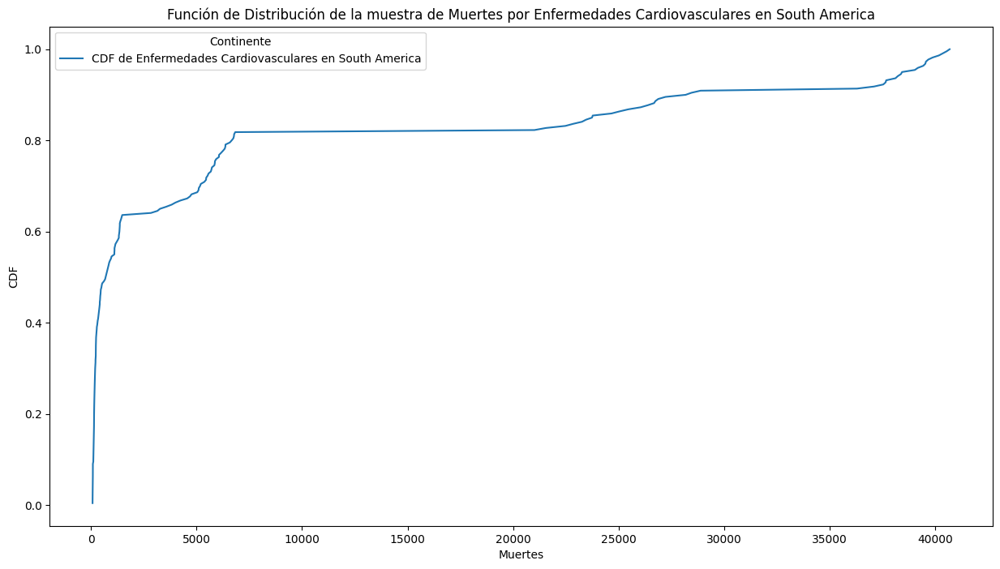

La CDF por Enfermedades Cardiovasculares es:
[0.00454545 0.00909091 0.01363636 0.01818182 0.02272727 0.02727273
 0.03181818 0.03636364 0.04090909 0.04545455 0.05       0.05454545
 0.05909091 0.06363636 0.06818182 0.07272727 0.07727273 0.08181818
 0.08636364 0.09090909 0.09545455 0.1        0.10454545 0.10909091
 0.11363636 0.11818182 0.12272727 0.12727273 0.13181818 0.13636364
 0.14090909 0.14545455 0.15       0.15454545 0.15909091 0.16363636
 0.16818182 0.17272727 0.17727273 0.18181818 0.18636364 0.19090909
 0.19545455 0.2        0.20454545 0.20909091 0.21363636 0.21818182
 0.22272727 0.22727273 0.23181818 0.23636364 0.24090909 0.24545455
 0.25       0.25454545 0.25909091 0.26363636 0.26818182 0.27272727
 0.27727273 0.28181818 0.28636364 0.29090909 0.29545455 0.3
 0.30454545 0.30909091 0.31363636 0.31818182 0.32272727 0.32727273
 0.33181818 0.33636364 0.34090909 0.34545455 0.35       0.35454545
 0.35909091 0.36363636 0.36818182 0.37272727 0.37727273 0.38181818
 0.38636364 0.39090909 0

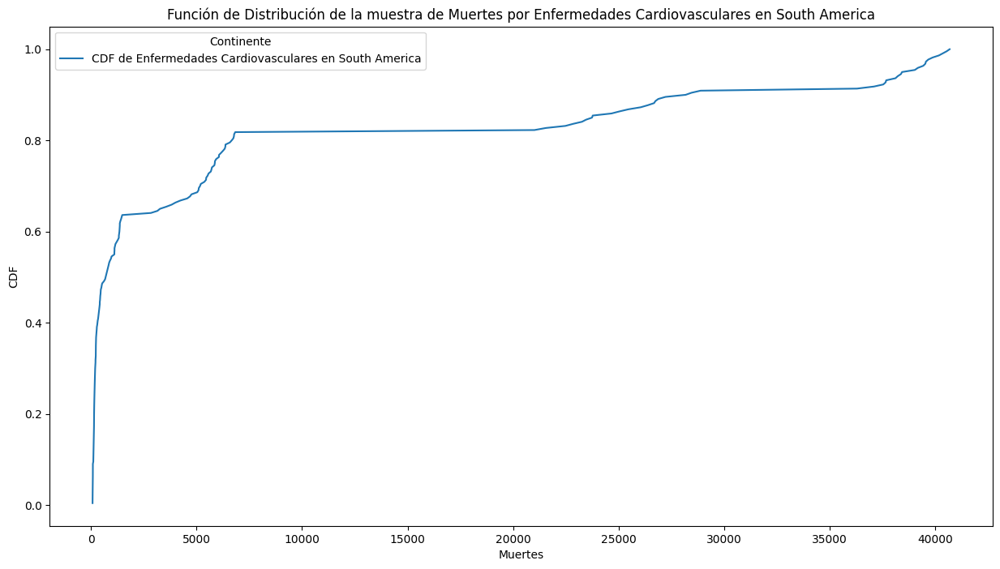

La CDF por Enfermedades Cardiovasculares es:
[0.00454545 0.00909091 0.01363636 0.01818182 0.02272727 0.02727273
 0.03181818 0.03636364 0.04090909 0.04545455 0.05       0.05454545
 0.05909091 0.06363636 0.06818182 0.07272727 0.07727273 0.08181818
 0.08636364 0.09090909 0.09545455 0.1        0.10454545 0.10909091
 0.11363636 0.11818182 0.12272727 0.12727273 0.13181818 0.13636364
 0.14090909 0.14545455 0.15       0.15454545 0.15909091 0.16363636
 0.16818182 0.17272727 0.17727273 0.18181818 0.18636364 0.19090909
 0.19545455 0.2        0.20454545 0.20909091 0.21363636 0.21818182
 0.22272727 0.22727273 0.23181818 0.23636364 0.24090909 0.24545455
 0.25       0.25454545 0.25909091 0.26363636 0.26818182 0.27272727
 0.27727273 0.28181818 0.28636364 0.29090909 0.29545455 0.3
 0.30454545 0.30909091 0.31363636 0.31818182 0.32272727 0.32727273
 0.33181818 0.33636364 0.34090909 0.34545455 0.35       0.35454545
 0.35909091 0.36363636 0.36818182 0.37272727 0.37727273 0.38181818
 0.38636364 0.39090909 0

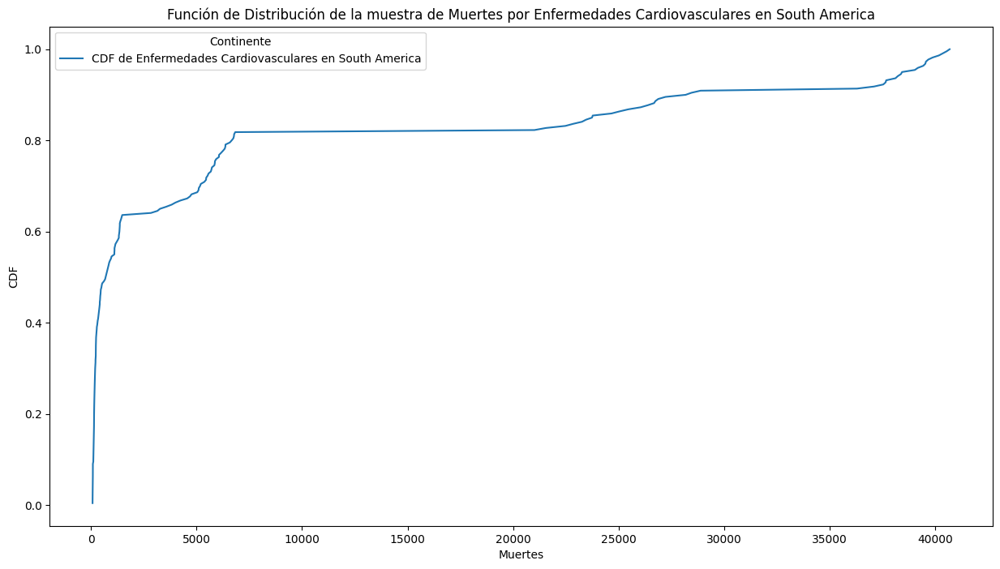

La CDF por Enfermedades Cardiovasculares es:
[0.00454545 0.00909091 0.01363636 0.01818182 0.02272727 0.02727273
 0.03181818 0.03636364 0.04090909 0.04545455 0.05       0.05454545
 0.05909091 0.06363636 0.06818182 0.07272727 0.07727273 0.08181818
 0.08636364 0.09090909 0.09545455 0.1        0.10454545 0.10909091
 0.11363636 0.11818182 0.12272727 0.12727273 0.13181818 0.13636364
 0.14090909 0.14545455 0.15       0.15454545 0.15909091 0.16363636
 0.16818182 0.17272727 0.17727273 0.18181818 0.18636364 0.19090909
 0.19545455 0.2        0.20454545 0.20909091 0.21363636 0.21818182
 0.22272727 0.22727273 0.23181818 0.23636364 0.24090909 0.24545455
 0.25       0.25454545 0.25909091 0.26363636 0.26818182 0.27272727
 0.27727273 0.28181818 0.28636364 0.29090909 0.29545455 0.3
 0.30454545 0.30909091 0.31363636 0.31818182 0.32272727 0.32727273
 0.33181818 0.33636364 0.34090909 0.34545455 0.35       0.35454545
 0.35909091 0.36363636 0.36818182 0.37272727 0.37727273 0.38181818
 0.38636364 0.39090909 0

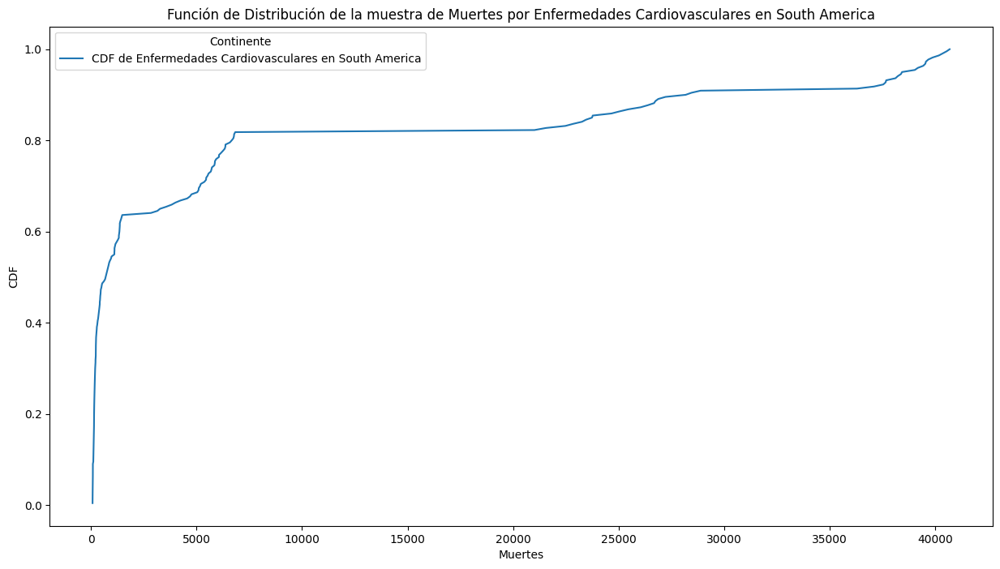

In [ ]:
# Calcular la función de distribución de la muestra
def calcular_cdf(FDP):
    valores_ordenados = np.sort(FDP)
    cdf = np.arange(1, len(valores_ordenados) + 1) / len(valores_ordenados)
    return valores_ordenados, cdf

for continente, paises in continentes.items():
    df_continente = df[df['Entity'].isin(paises)]
    print(f"Distribución acumulativa por Enfermedades Cardiovasculares en {continente}")
    for patologia in patologias:
        # Calcular e imprimir CDF
        valores_ordenados, cdf = calcular_cdf(FDP)
        print(f"La CDF por {patologia_legible} es:\n{cdf}")
        print("----------------------------------------------------------------------------------")
        
        plt.figure(figsize=(15, 8))
        plt.plot(valores_ordenados, cdf, label=f'CDF de {patologia_legible} en {continente}')
        plt.title(f'Función de Distribución de la muestra de Muertes por {patologia_legible} en {continente}')
        plt.xlabel('Muertes')
        plt.ylabel('CDF')
        plt.legend(title='Continente')
        plt.show()
        

## Función de densidad de probabilidad teórica

Densidad de probabilidad por Enfermedades Cardiovasculares en Africa
La densidad de probabilidad por Muertes por Enfermedad Cardíaca Reumática es:
(695.2907416666666, 2553.8927530788687)


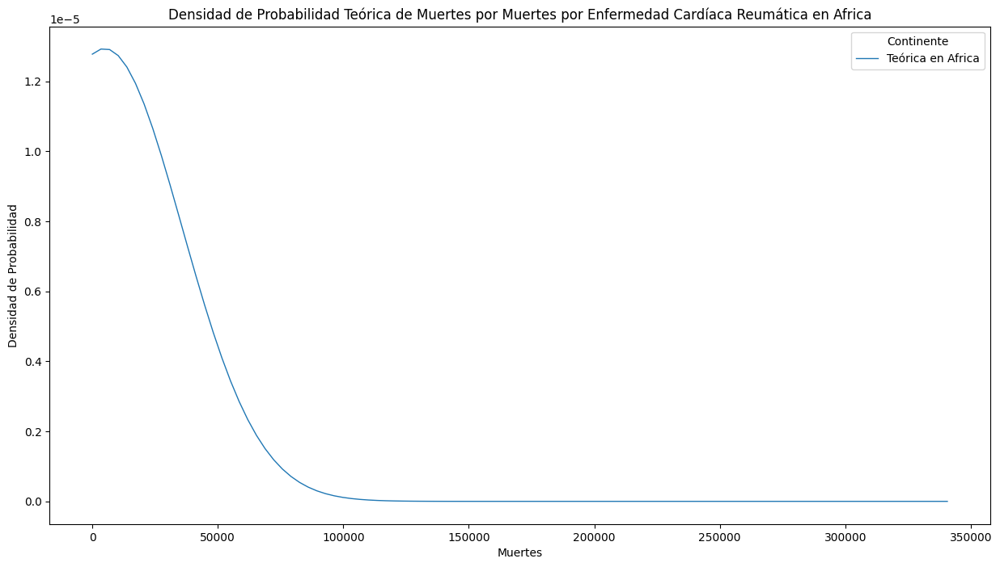

La densidad de probabilidad por Muertes por Cardiomiopatía, Miocarditis y Endocarditis es:
(1334.9662305555557, 4948.268206693669)


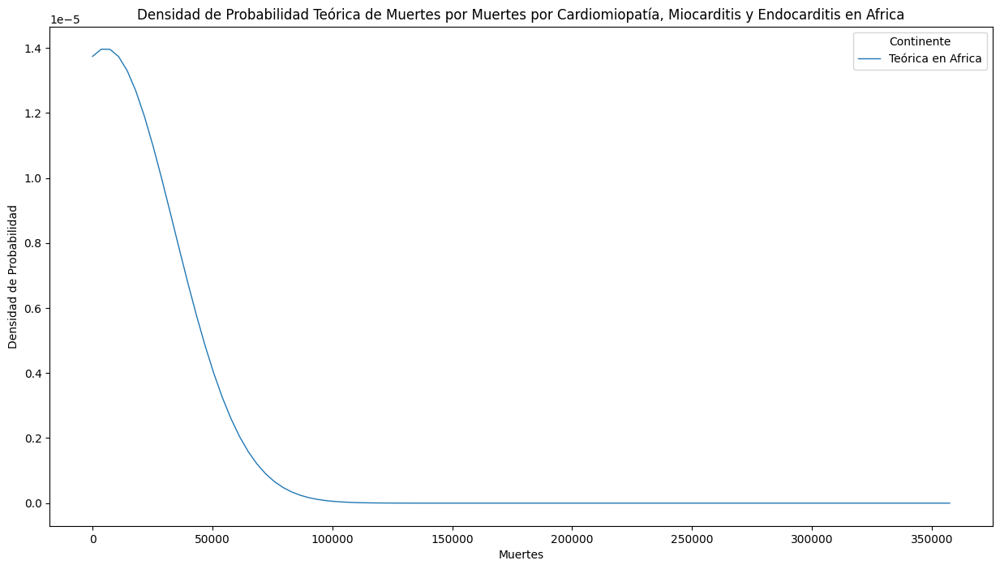

La densidad de probabilidad por Muertes por Enfermedades Circulatorias es:
(2629.5956462962963, 9754.930564334583)


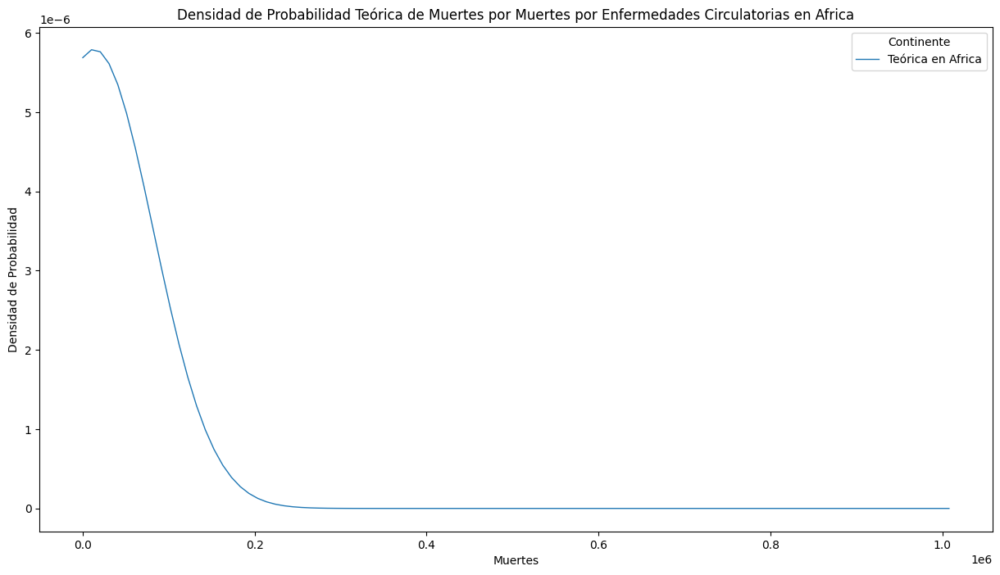

La densidad de probabilidad por Muertes por Enfermedad Cardíaca Hipertensiva es:
(5296.967296296296, 19523.698056505284)


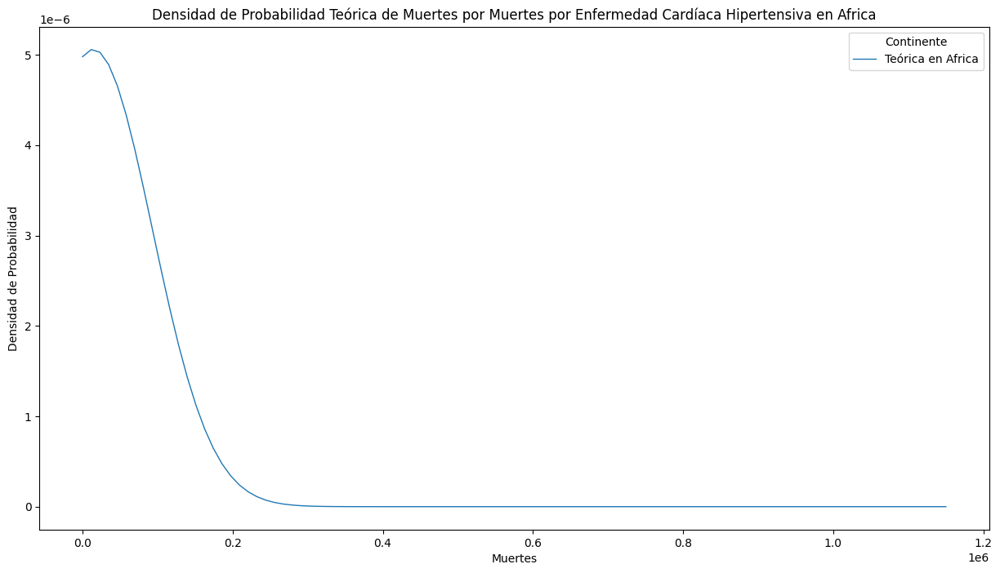

La densidad de probabilidad por Muertes por Ictus Isquémico es:
(6525.879962962963, 24275.76307770034)


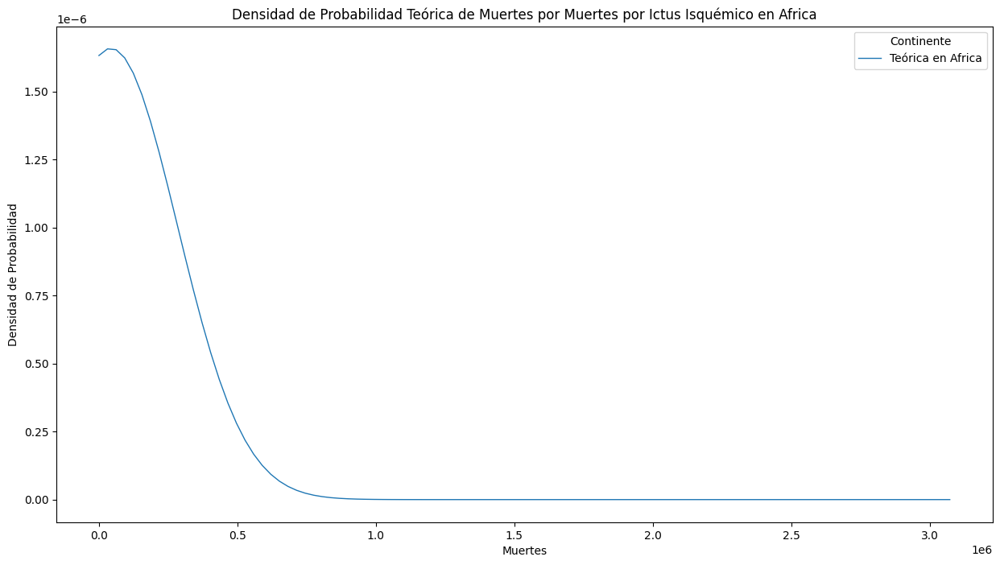

La densidad de probabilidad por Muertes por Ictus Hemorrágico es:
(10844.348324074075, 39984.93196650453)


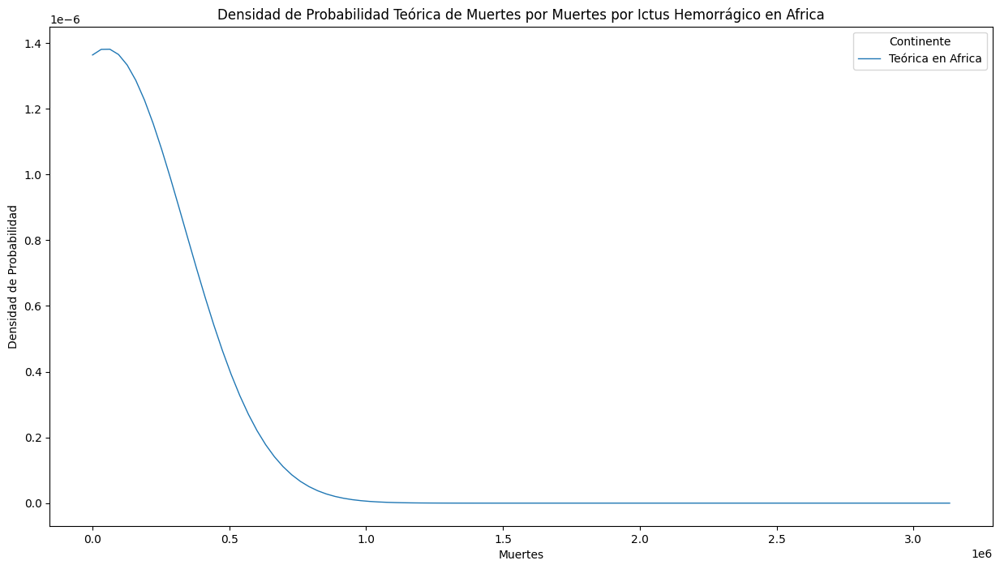

La densidad de probabilidad por Muertes por Enfermedad Cardíaca Isquémica es:
(22916.073101851853, 86116.19476933702)


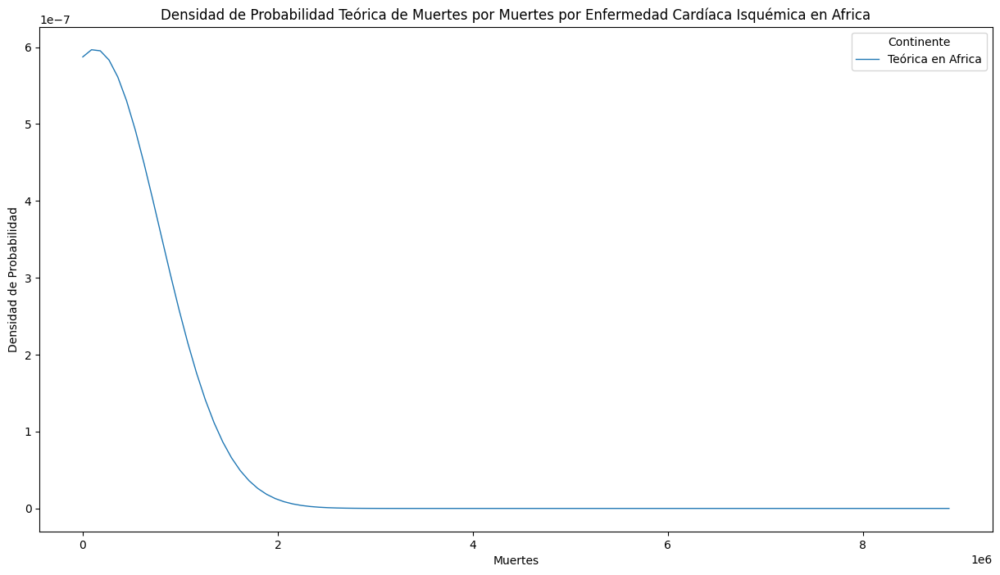

Densidad de probabilidad por Enfermedades Cardiovasculares en America del Norte
La densidad de probabilidad por Muertes por Enfermedad Cardíaca Reumática es:
(567.6289115909091, 1436.8451596787072)


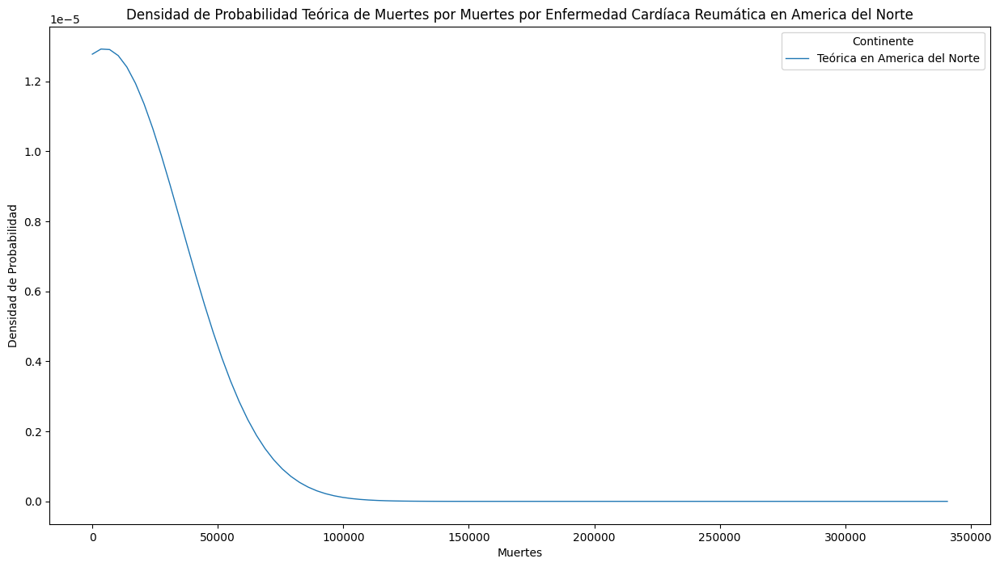

La densidad de probabilidad por Muertes por Cardiomiopatía, Miocarditis y Endocarditis es:
(3528.6015749999992, 10239.822402327323)


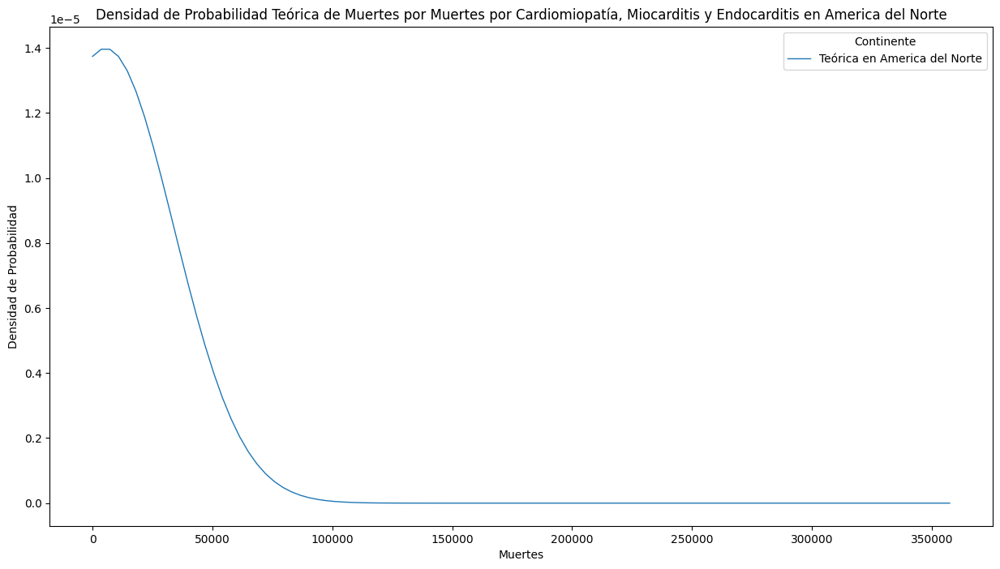

La densidad de probabilidad por Muertes por Enfermedades Circulatorias es:
(10489.266377272728, 29674.912636008805)


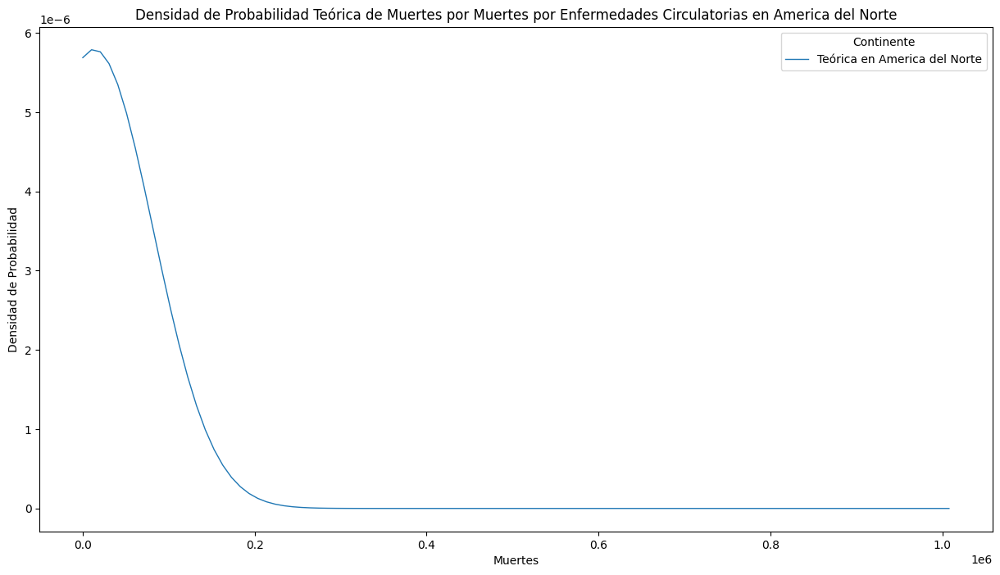

La densidad de probabilidad por Muertes por Enfermedad Cardíaca Hipertensiva es:
(6588.228811363637, 18156.521970258826)


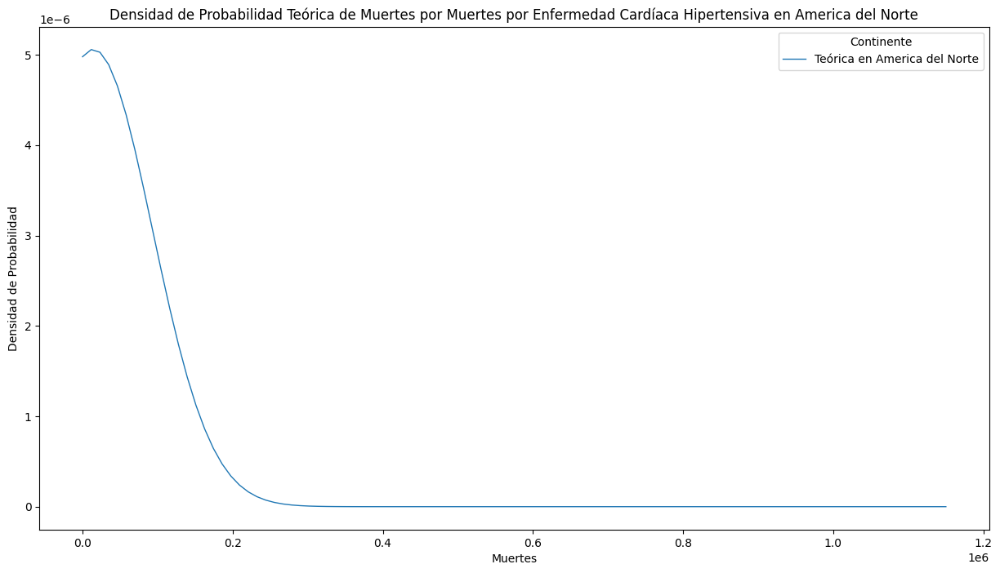

La densidad de probabilidad por Muertes por Ictus Isquémico es:
(12268.663827272727, 32454.877805423588)


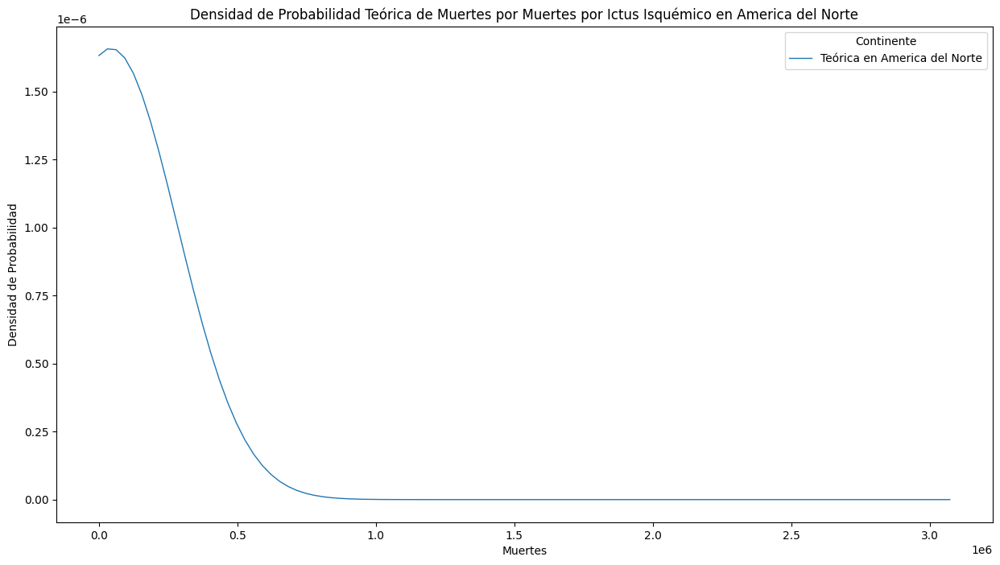

La densidad de probabilidad por Muertes por Ictus Hemorrágico es:
(9423.106956818181, 24286.682012829126)


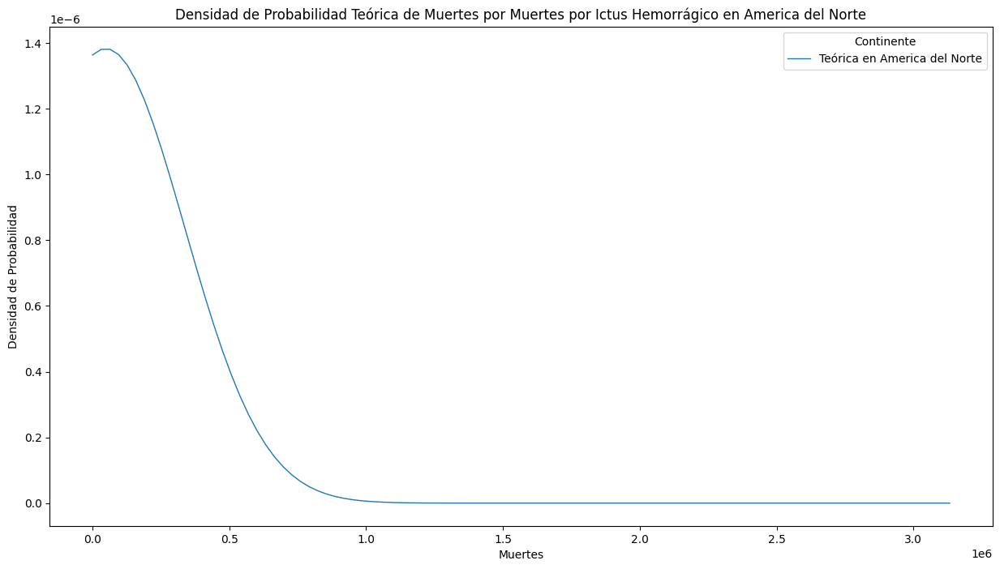

La densidad de probabilidad por Muertes por Enfermedad Cardíaca Isquémica es:
(63887.88268181818, 175317.2289144048)


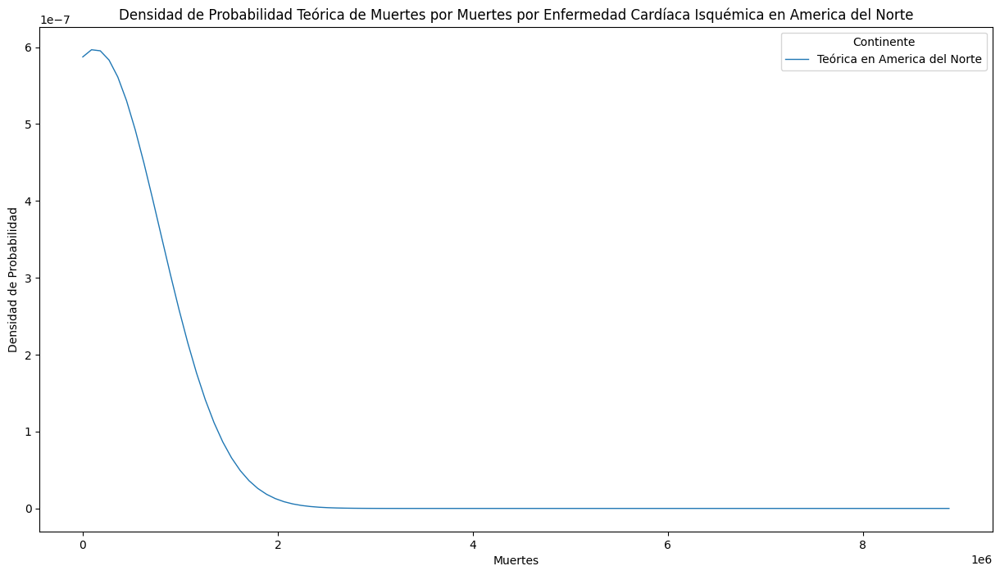

Densidad de probabilidad por Enfermedades Cardiovasculares en America del Sur
La densidad de probabilidad por Muertes por Enfermedad Cardíaca Reumática es:
(557.4066938461539, 1054.3435040715408)


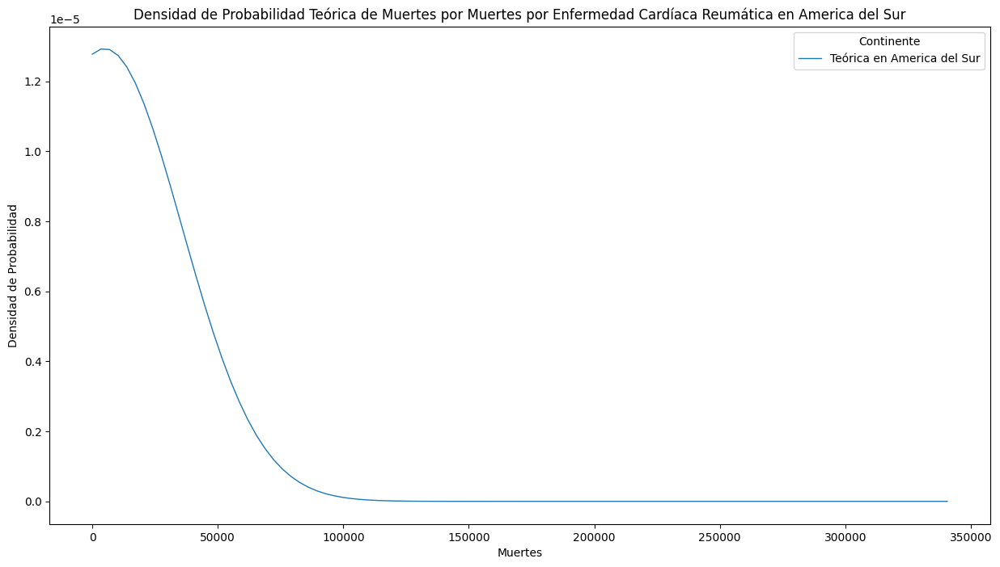

La densidad de probabilidad por Muertes por Cardiomiopatía, Miocarditis y Endocarditis es:
(3993.1508153846157, 7855.3652268629085)


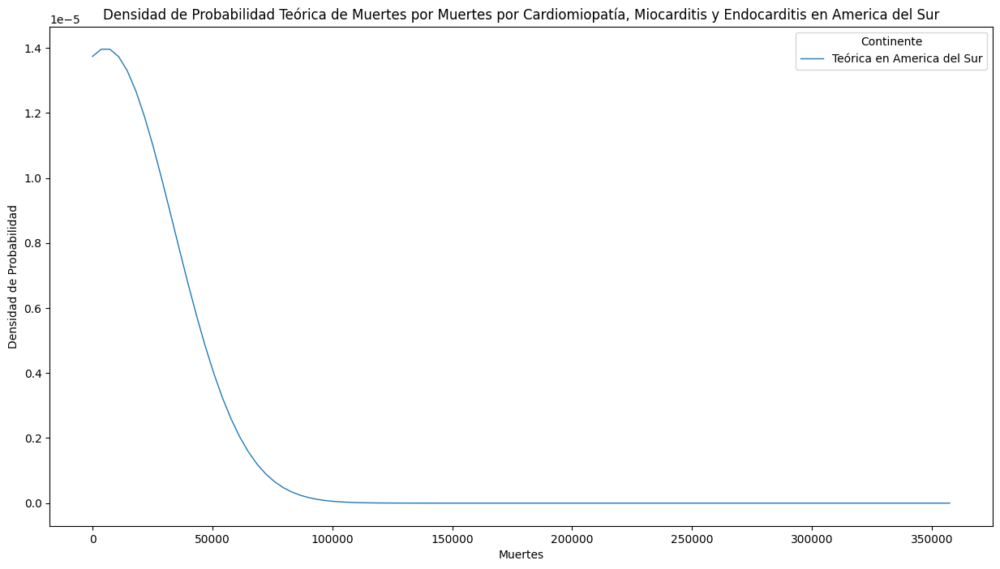

La densidad de probabilidad por Muertes por Enfermedades Circulatorias es:
(9494.685046153845, 17945.00039161945)


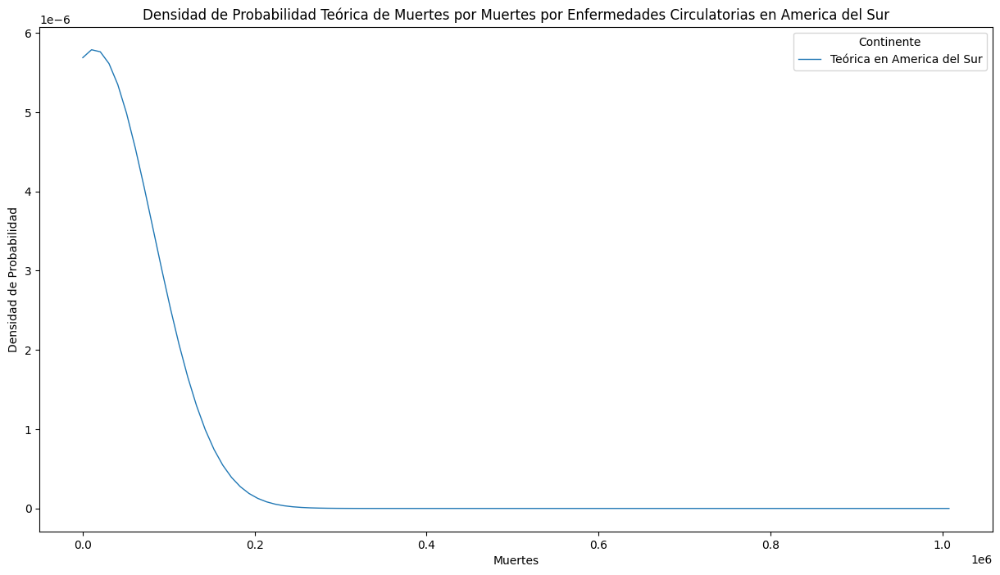

La densidad de probabilidad por Muertes por Enfermedad Cardíaca Hipertensiva es:
(6899.7429, 12675.080912195825)


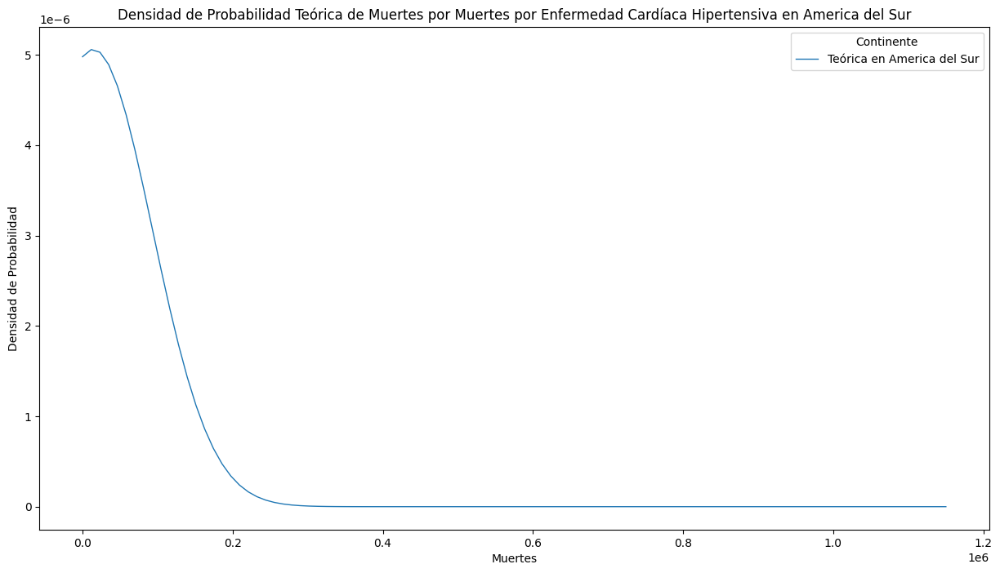

La densidad de probabilidad por Muertes por Ictus Isquémico es:
(15947.590834615386, 30273.193386921914)


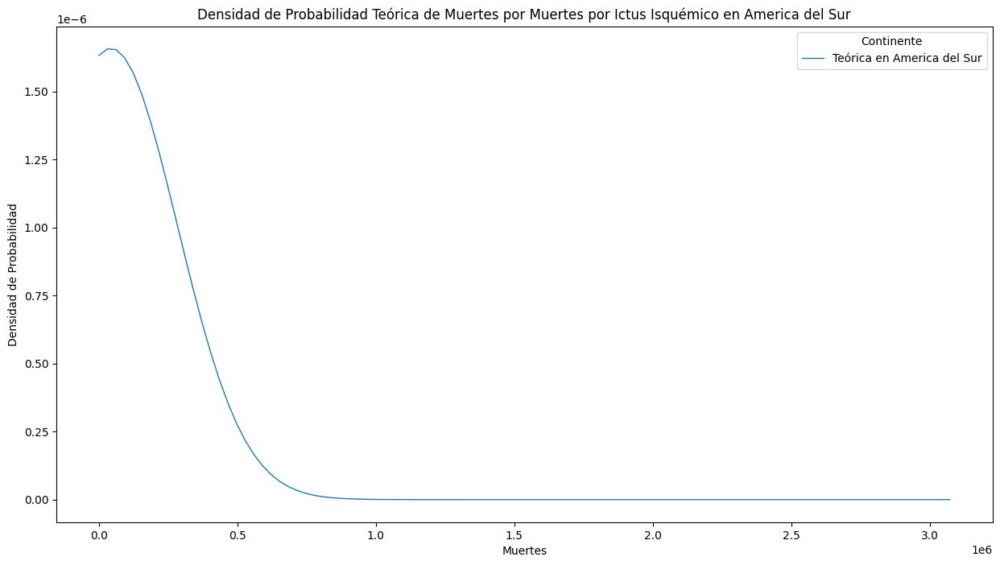

La densidad de probabilidad por Muertes por Ictus Hemorrágico es:
(14315.283415384616, 26269.856215474847)


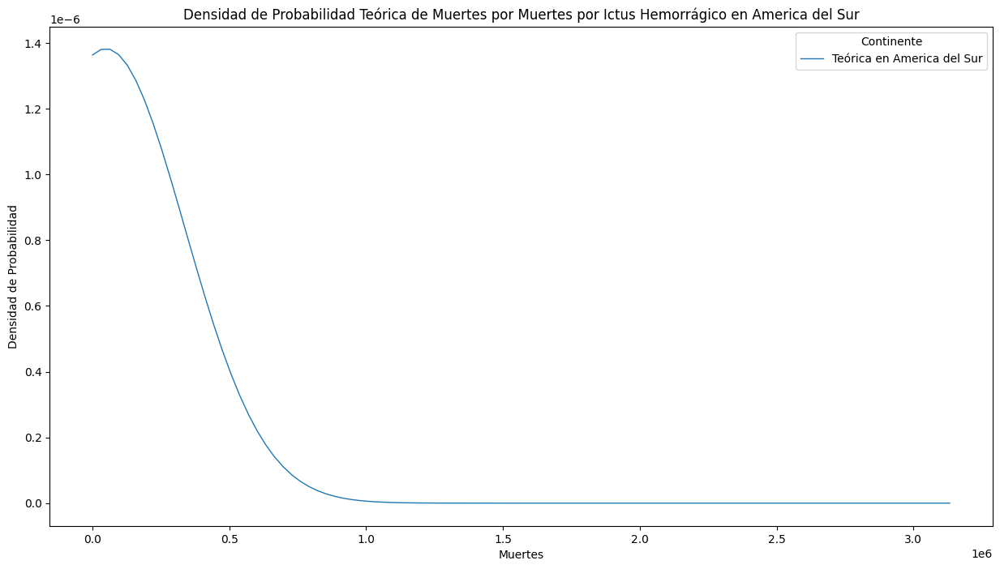

La densidad de probabilidad por Muertes por Enfermedad Cardíaca Isquémica es:
(45442.8591923077, 81627.86271752833)


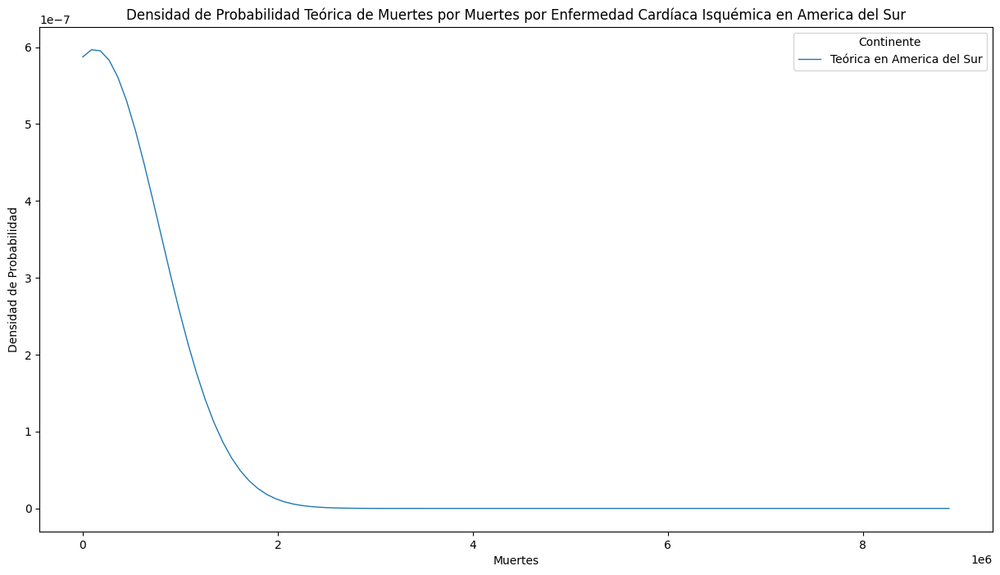

Densidad de probabilidad por Enfermedades Cardiovasculares en Asia
La densidad de probabilidad por Muertes por Enfermedad Cardíaca Reumática es:
(10926.722861702128, 42168.82038329492)


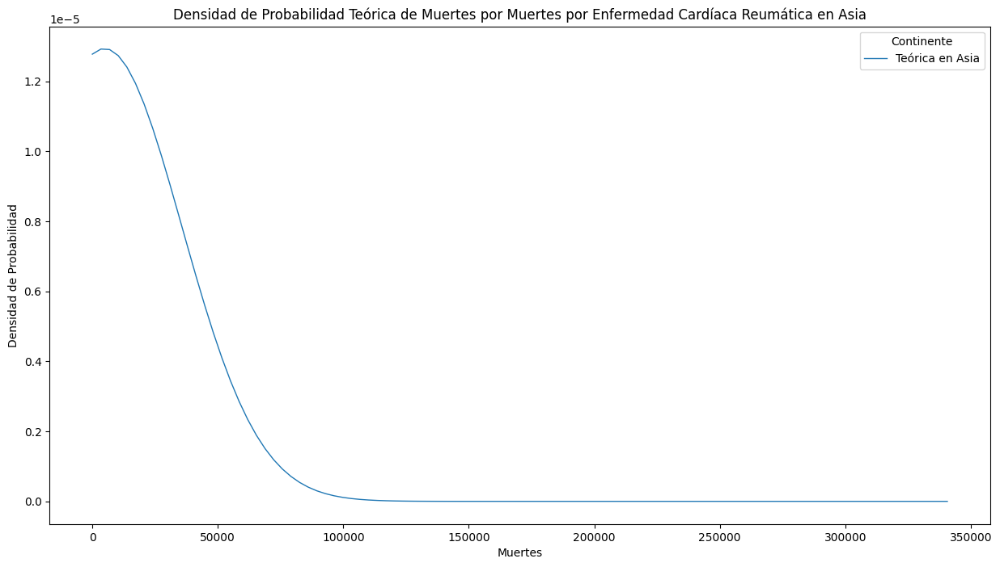

La densidad de probabilidad por Muertes por Cardiomiopatía, Miocarditis y Endocarditis es:
(3559.5303989361705, 12734.601229700465)


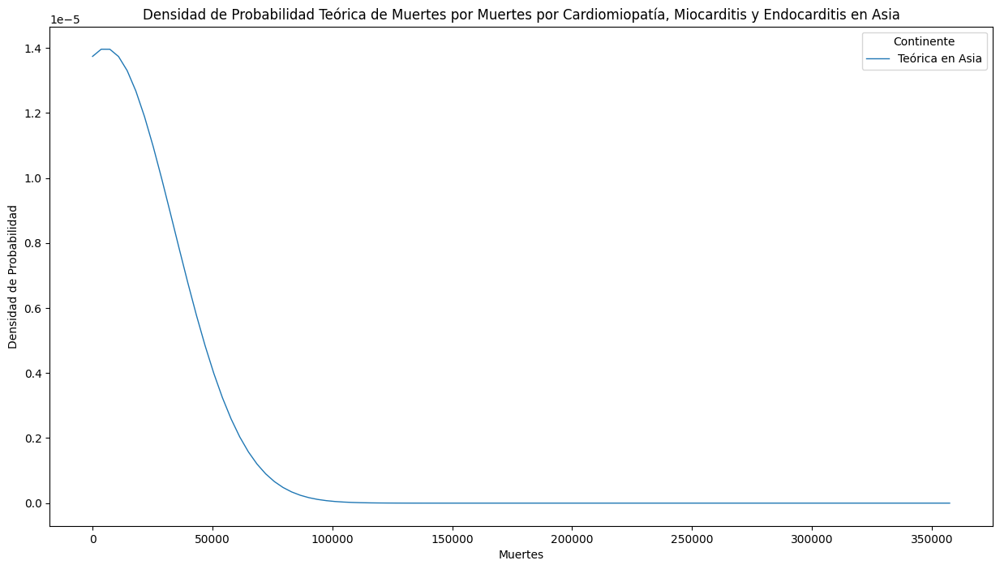

La densidad de probabilidad por Muertes por Enfermedades Circulatorias es:
(11967.89370212766, 43973.33682524771)


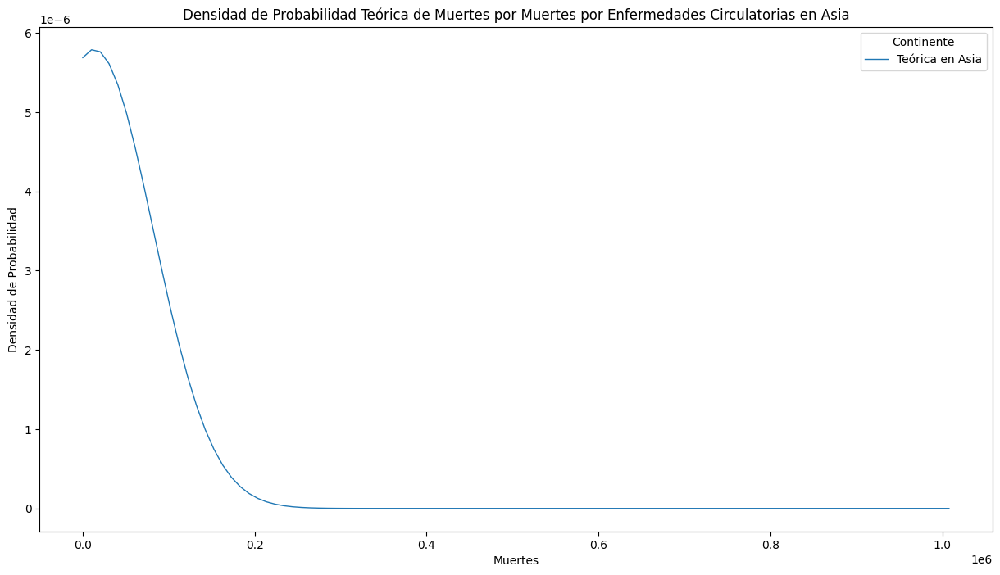

La densidad de probabilidad por Muertes por Enfermedad Cardíaca Hipertensiva es:
(21147.484595744678, 80289.84377455947)


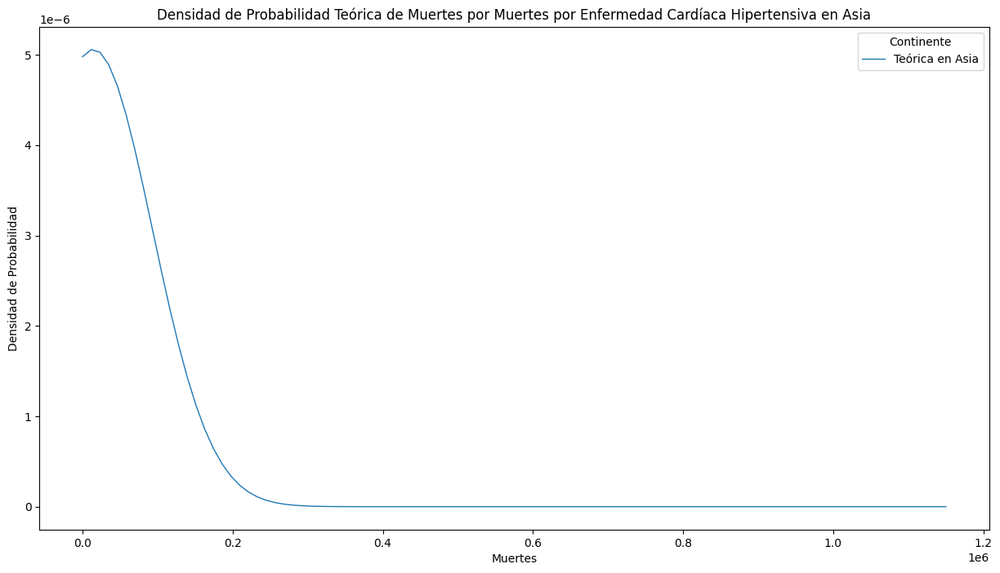

La densidad de probabilidad por Muertes por Ictus Isquémico es:
(64640.36261702128, 245210.81797569175)


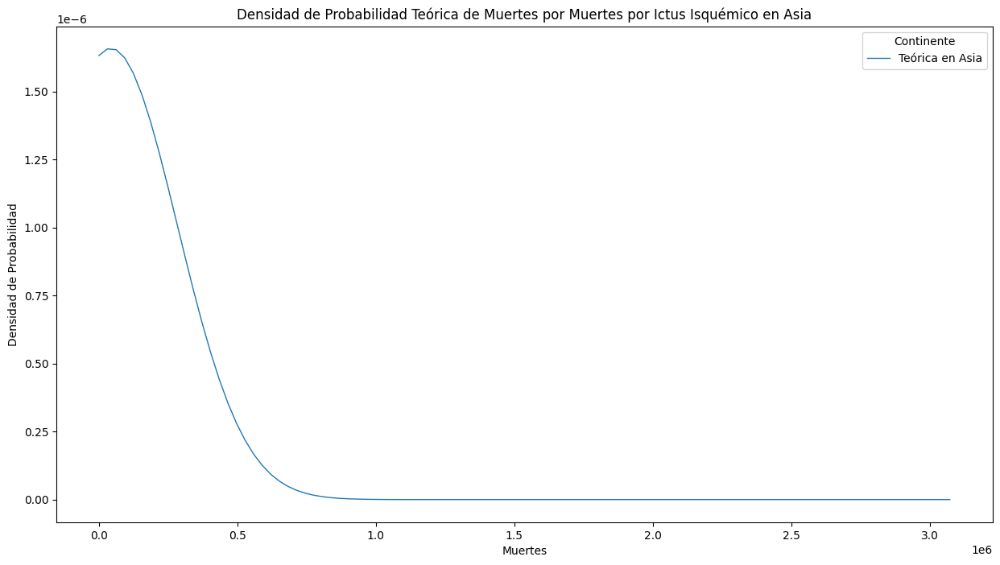

La densidad de probabilidad por Muertes por Ictus Hemorrágico es:
(95936.68921276595, 363478.0651168609)


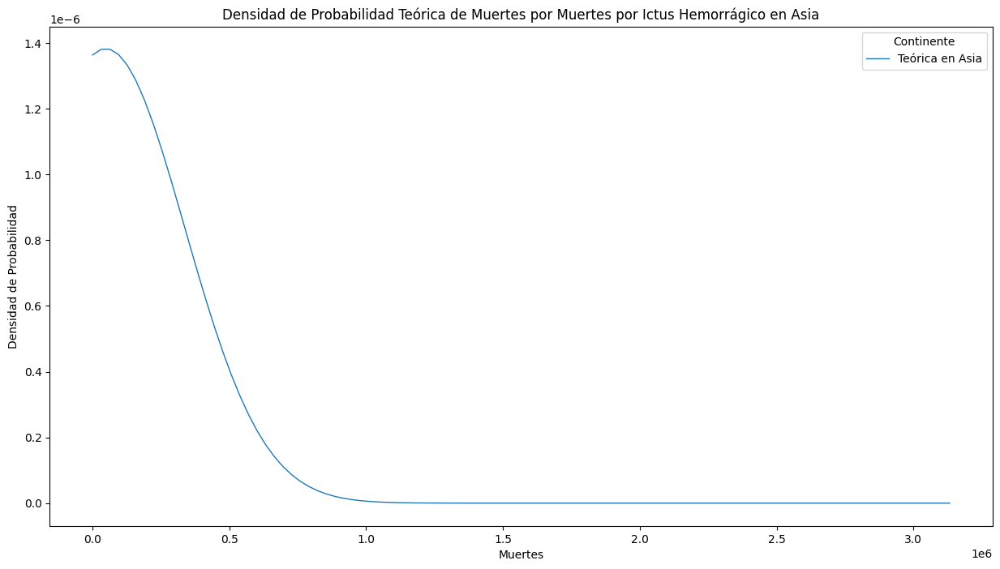

La densidad de probabilidad por Muertes por Enfermedad Cardíaca Isquémica es:
(168501.3214893617, 627718.7373810454)


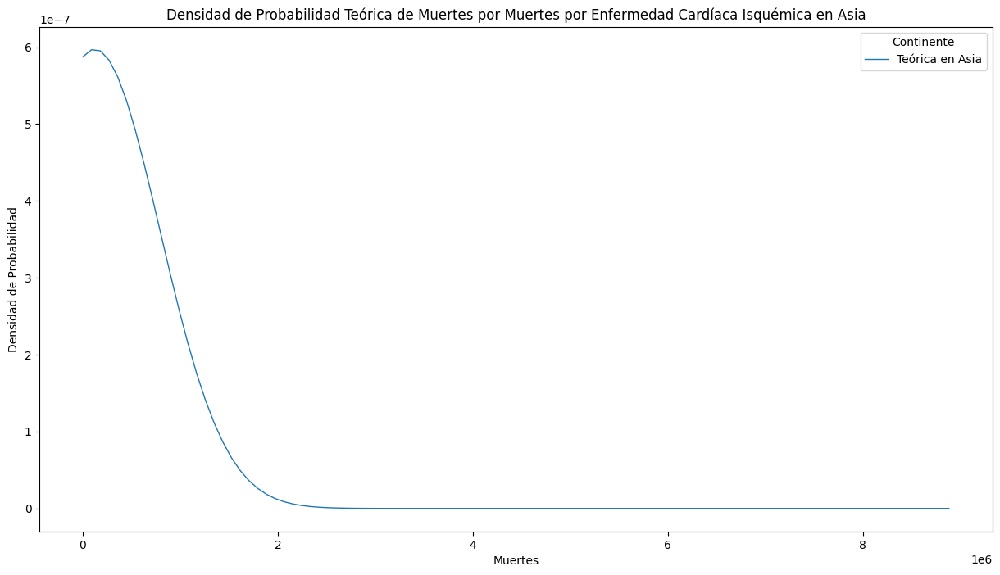

Densidad de probabilidad por Enfermedades Cardiovasculares en Europa
La densidad de probabilidad por Muertes por Enfermedad Cardíaca Reumática es:
(1031.65173, 3336.93423263621)


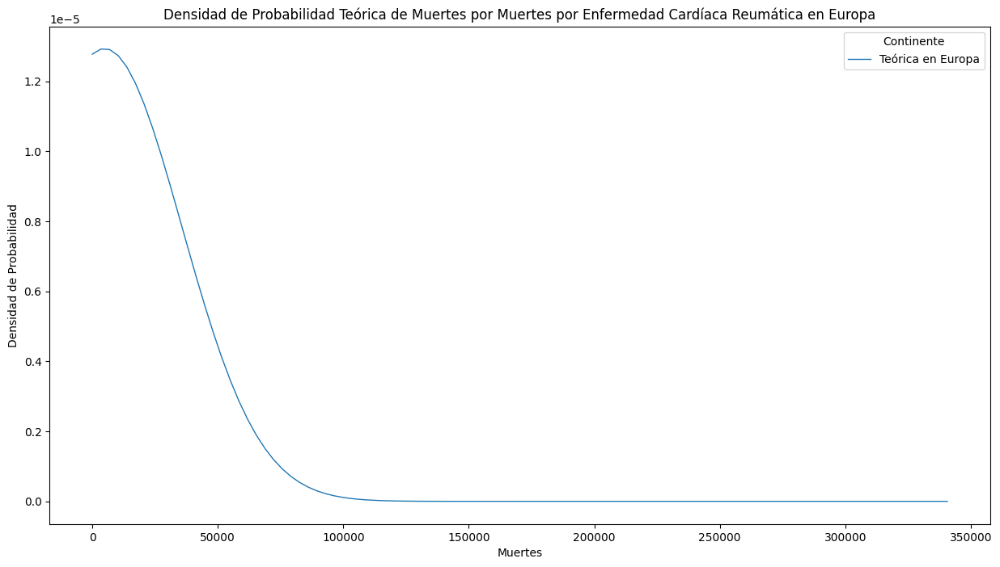

La densidad de probabilidad por Muertes por Cardiomiopatía, Miocarditis y Endocarditis es:
(7720.51135, 26133.211786777607)


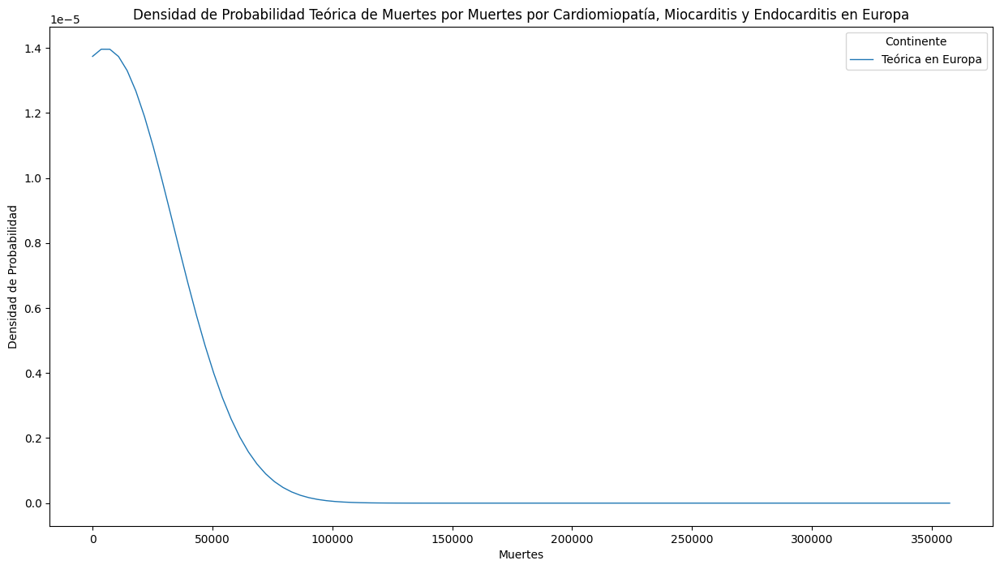

La densidad de probabilidad por Muertes por Enfermedades Circulatorias es:
(14744.563287500001, 46358.65041796922)


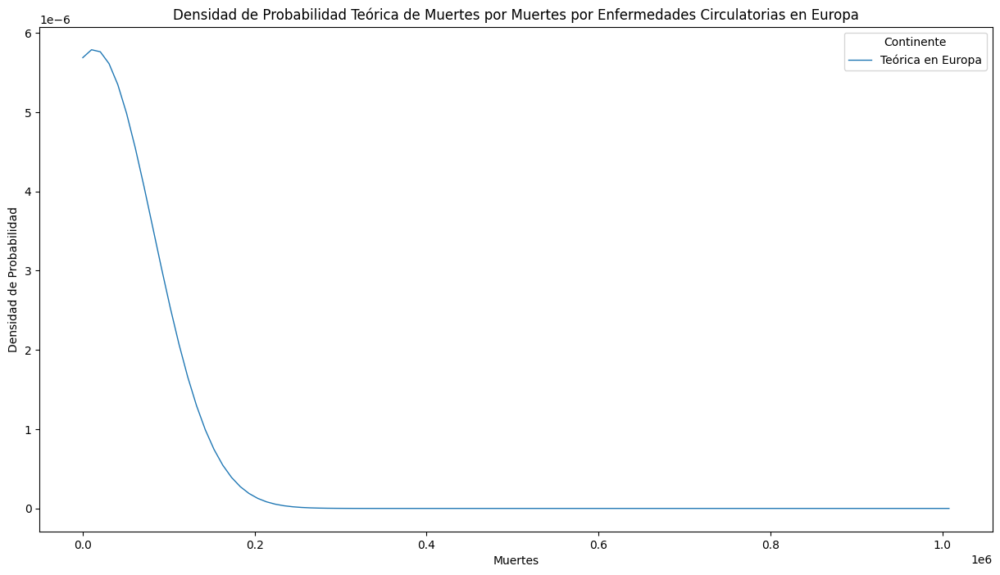

La densidad de probabilidad por Muertes por Enfermedad Cardíaca Hipertensiva es:
(6901.512475, 22277.2616932219)


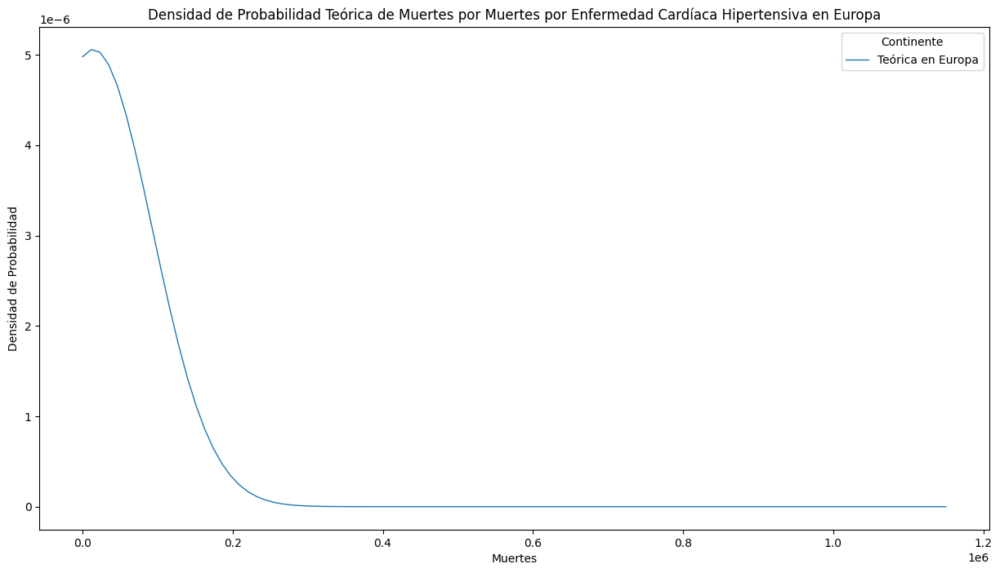

La densidad de probabilidad por Muertes por Ictus Isquémico es:
(39087.7288875, 129563.17259516314)


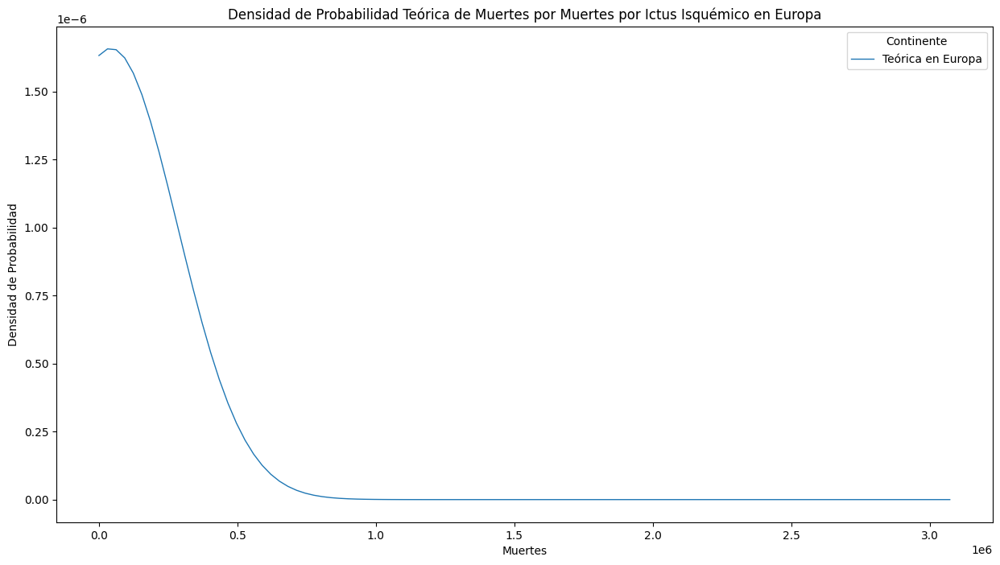

La densidad de probabilidad por Muertes por Ictus Hemorrágico es:
(15018.937725, 48647.424241853354)


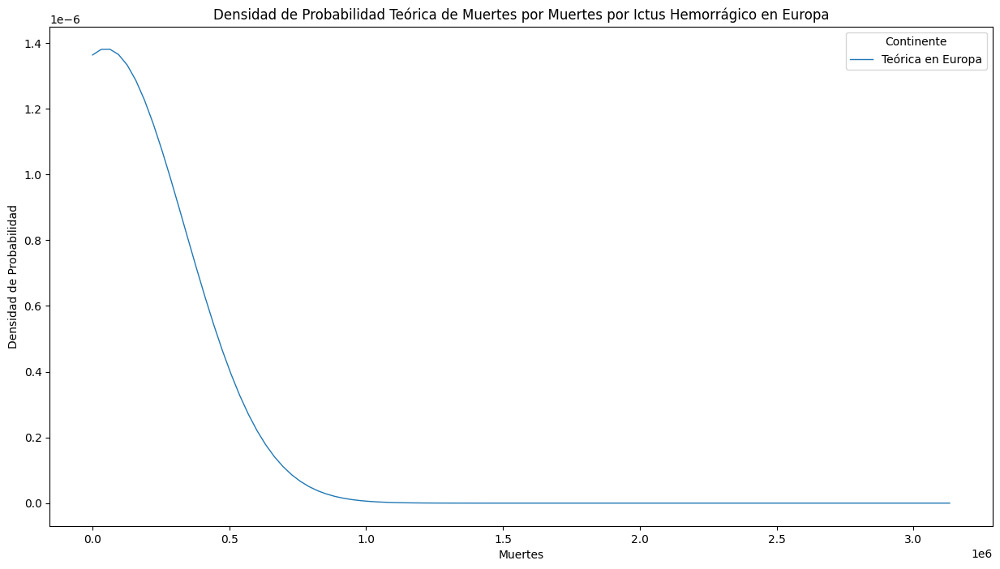

La densidad de probabilidad por Muertes por Enfermedad Cardíaca Isquémica es:
(107147.1270625, 345900.6150029066)


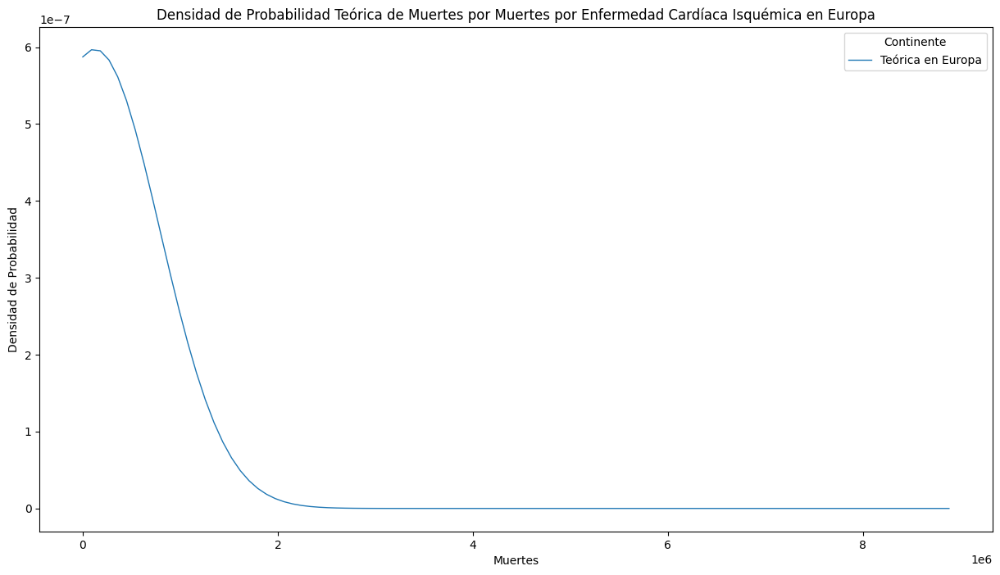

Densidad de probabilidad por Enfermedades Cardiovasculares en Oceania
La densidad de probabilidad por Muertes por Enfermedad Cardíaca Reumática es:
(271.8251813636364, 460.7085263667545)


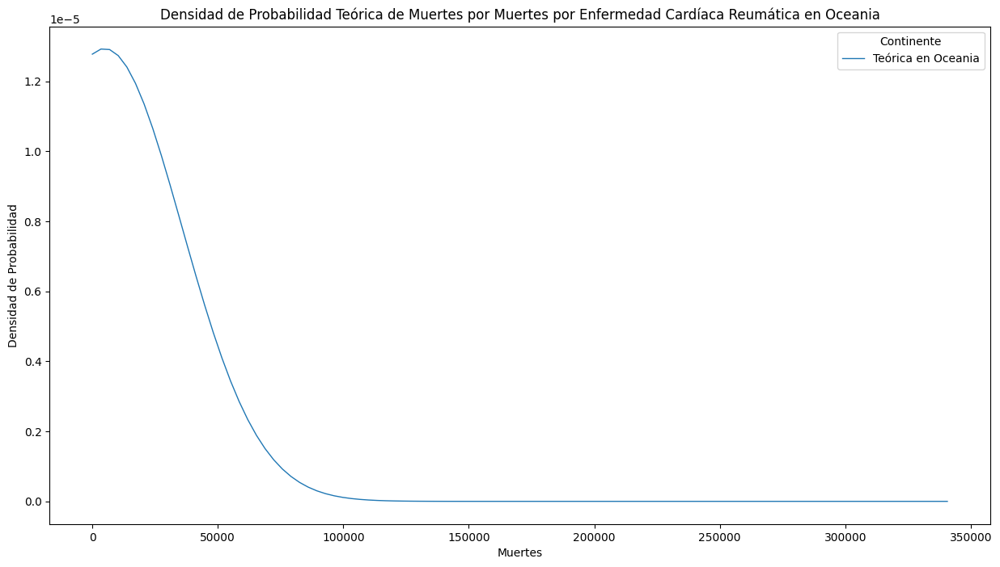

La densidad de probabilidad por Muertes por Cardiomiopatía, Miocarditis y Endocarditis es:
(327.3867259090909, 602.4697700811586)


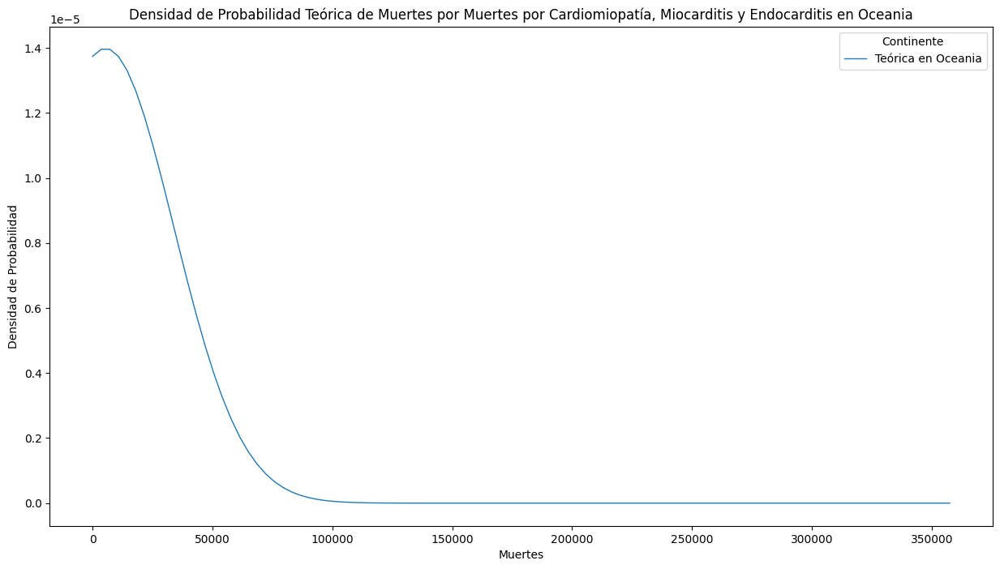

La densidad de probabilidad por Muertes por Enfermedades Circulatorias es:
(1397.2931809090908, 2608.1030313971733)


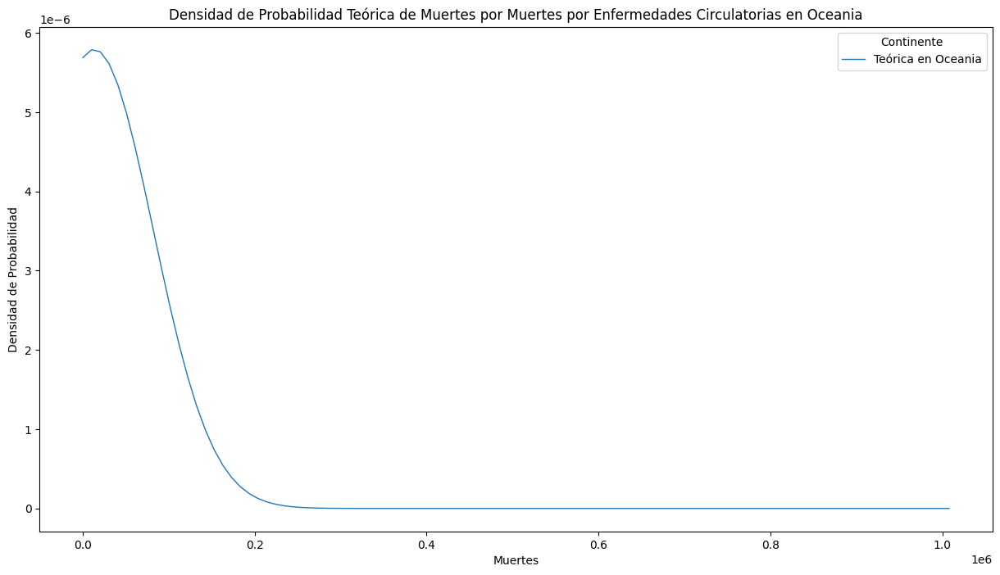

La densidad de probabilidad por Muertes por Enfermedad Cardíaca Hipertensiva es:
(496.46036181818187, 836.9911953650172)


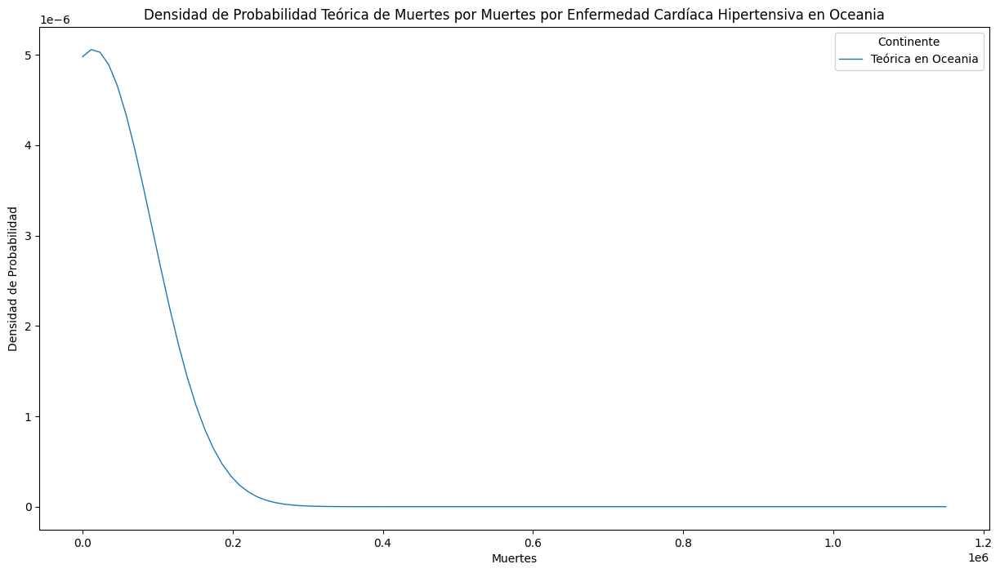

La densidad de probabilidad por Muertes por Ictus Isquémico es:
(1905.1367363636361, 3476.464988387733)


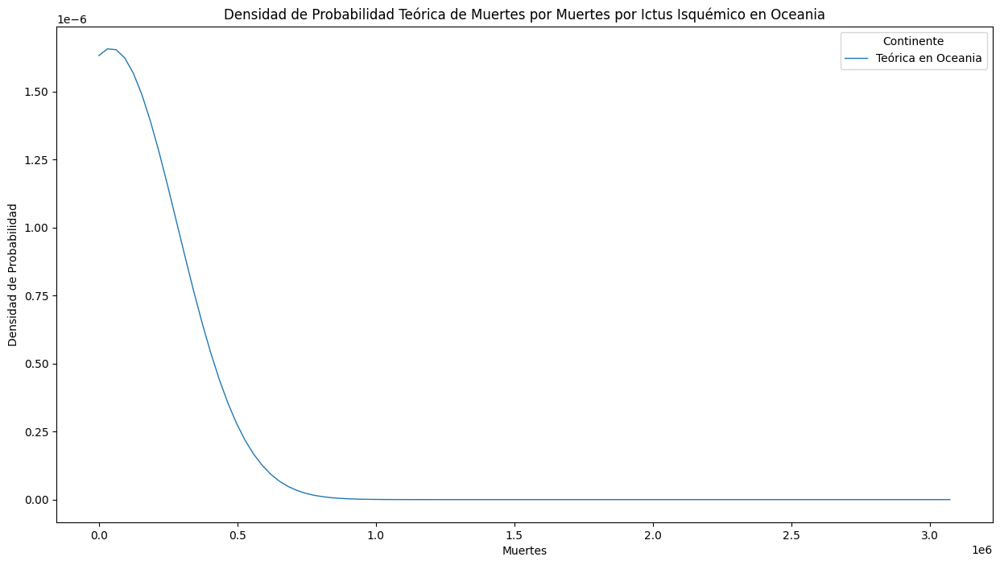

La densidad de probabilidad por Muertes por Ictus Hemorrágico es:
(1646.7172745454543, 2676.895770256292)


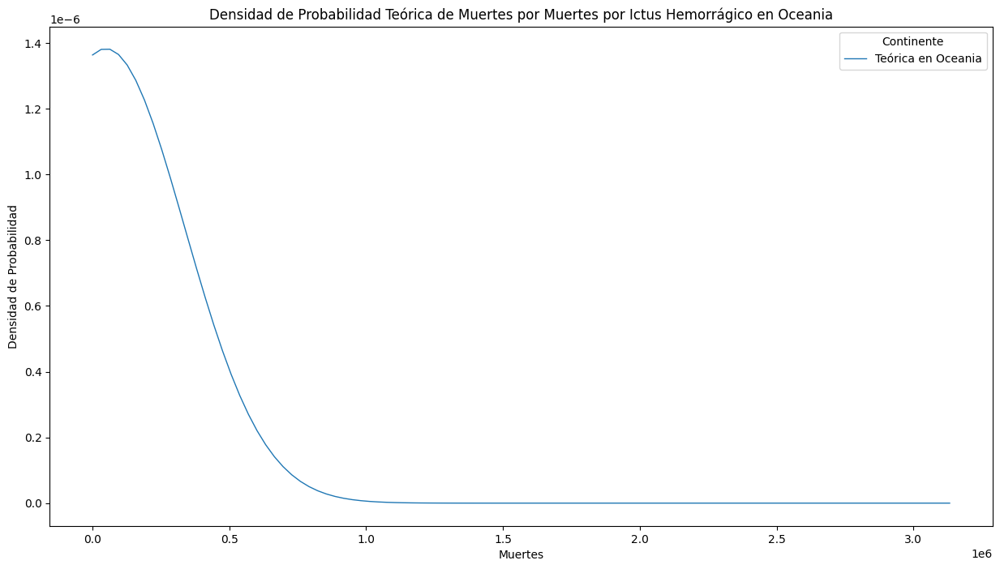

La densidad de probabilidad por Muertes por Enfermedad Cardíaca Isquémica es:
(7065.691745454545, 12293.066750028387)


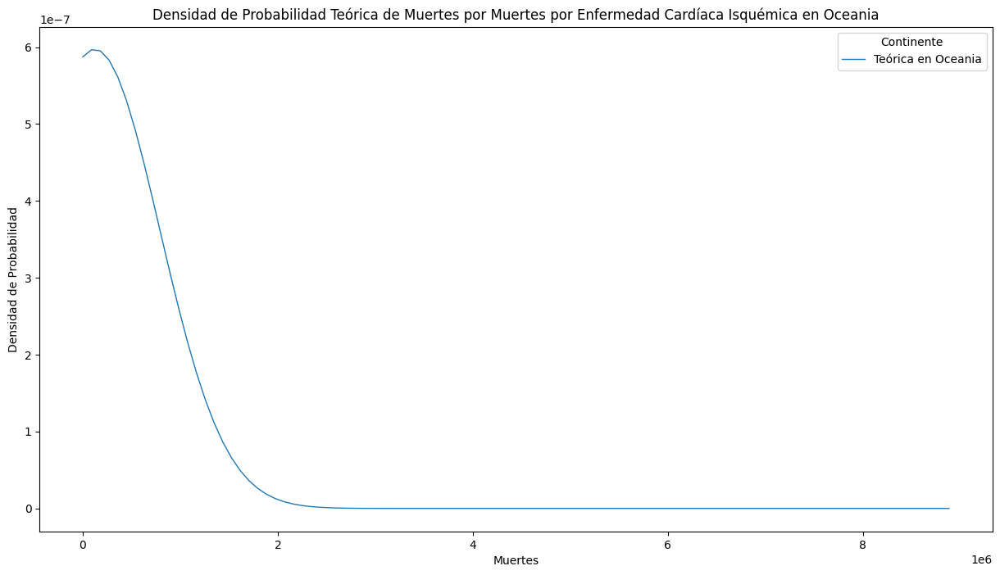

In [ ]:
# Calcular la densidad de probabilidad teórica
def calcular_densidad_probabilidad_teorica(df, patologia):
    data_patologia = df[patologia].dropna()
    mu, std = stats.norm.fit(data_patologia)
    return mu, std

for continente, paises in continentes.items():
    df_continente = df[df['Entity'].isin(paises)]
    print(f"Densidad de probabilidad por Enfermedades Cardiovasculares en {continente}")
    for patologia in patologias:
        FDPT = calcular_densidad_probabilidad_teorica(df_continente, patologia)
        patologia_legible = reemplazar_texto(patologia)
        # Graficar la densidad teórica
        print(f"La densidad de probabilidad por {patologia_legible} es:\n{FDPT}")
        print("="*90)
        
        data_patologia = df[patologia].dropna()
        mu, std = calcular_densidad_probabilidad_teorica(df, patologia)
        
        # Crear un rango de valores para x
        xmin, xmax = data_patologia.min(), data_patologia.max()
        x = np.linspace(xmin, xmax, 100)
        
        # Calcular la PDF teórica
        p = stats.norm.pdf(x, mu, std)
        # Graficar la PDF teórica
        plt.figure(figsize=(15, 8))
        plt.plot(x, p, linewidth=1, label=f'Teórica en {continente}')
        plt.title(f'Densidad de Probabilidad Teórica de Muertes por {patologia_legible} en {continente}')
        plt.xlabel('Muertes')
        plt.ylabel('Densidad de Probabilidad')
        plt.legend(title='Continente')
        plt.show()

## Comparación entre función de distribución de la muestra y la teórica

Densidad de probabilidad por Enfermedades Cardiovasculares en Africa


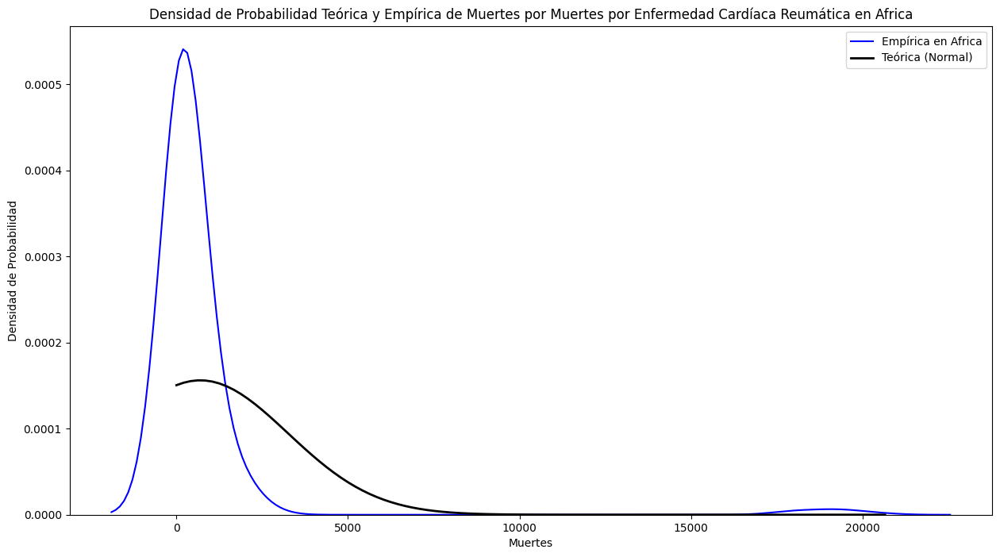

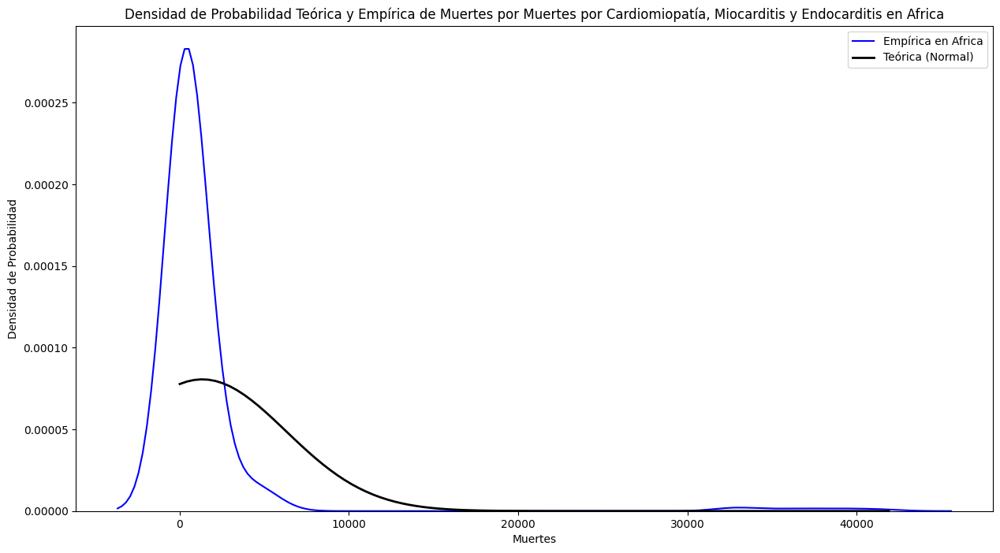

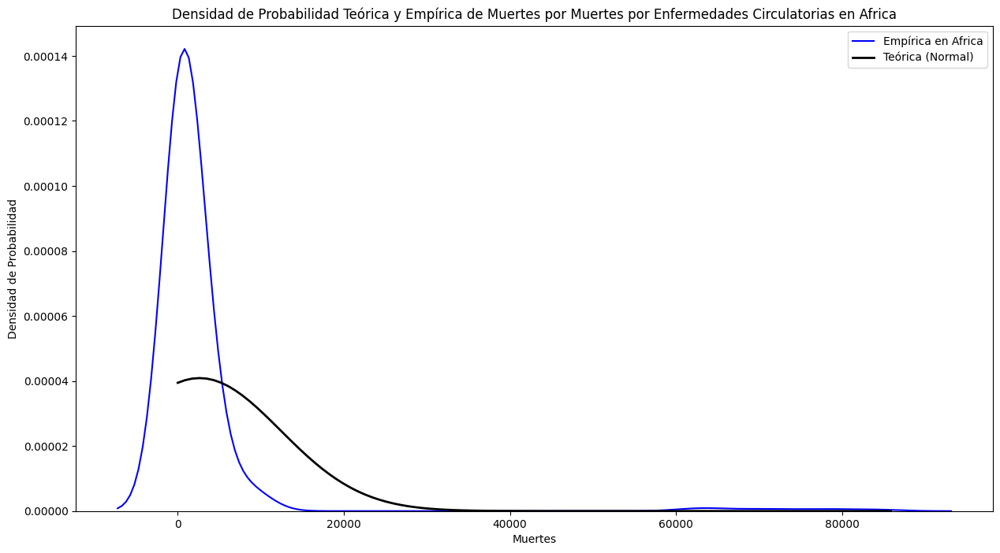

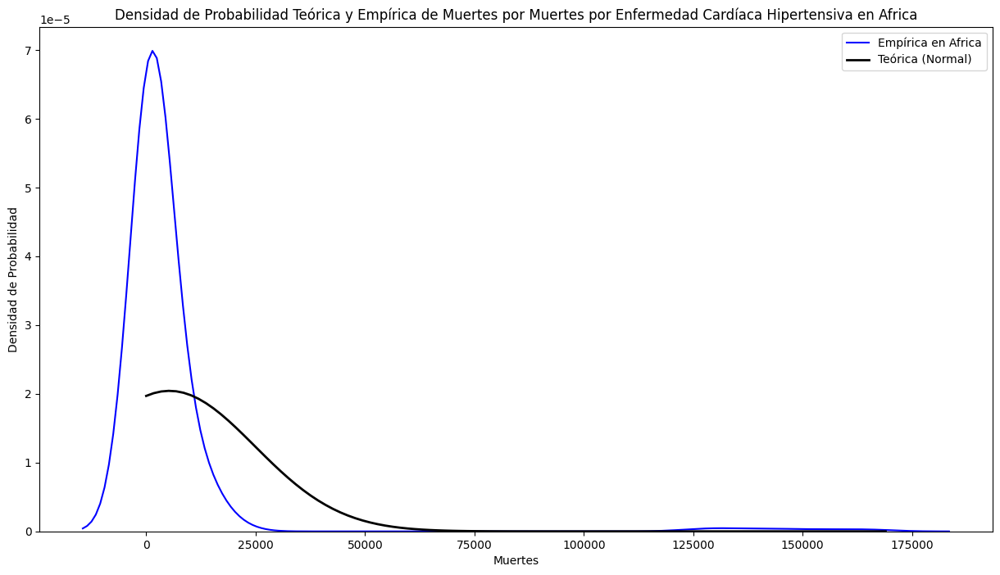

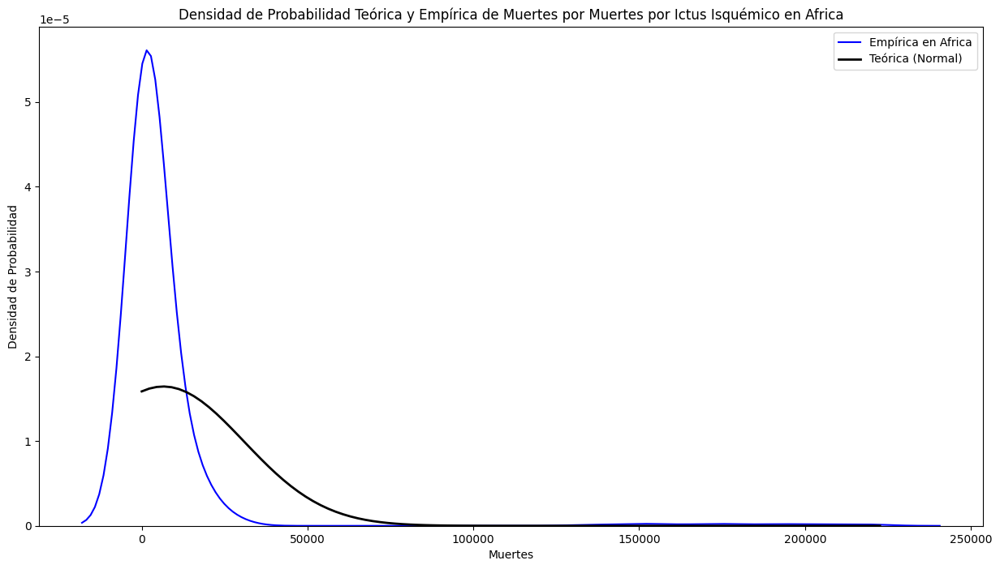

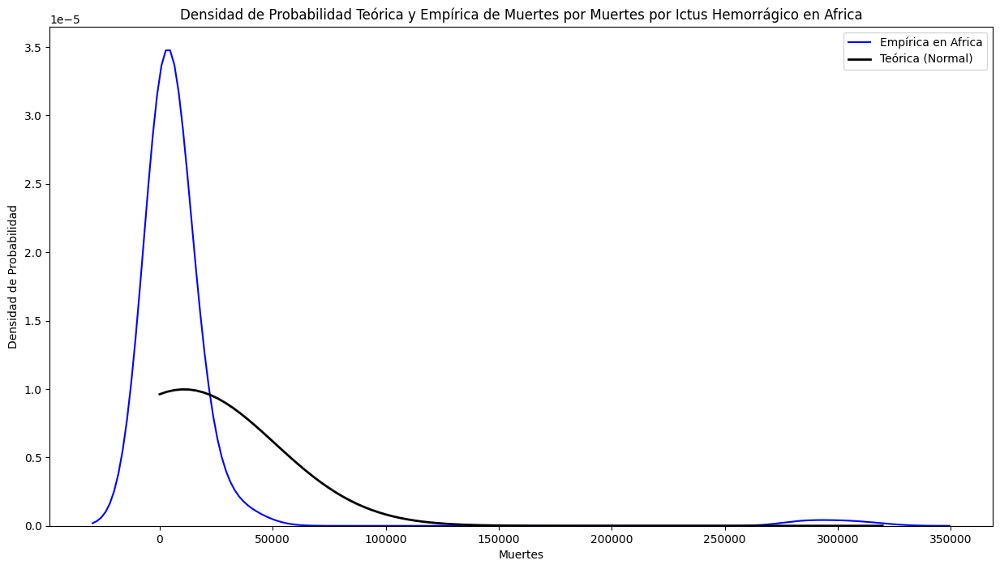

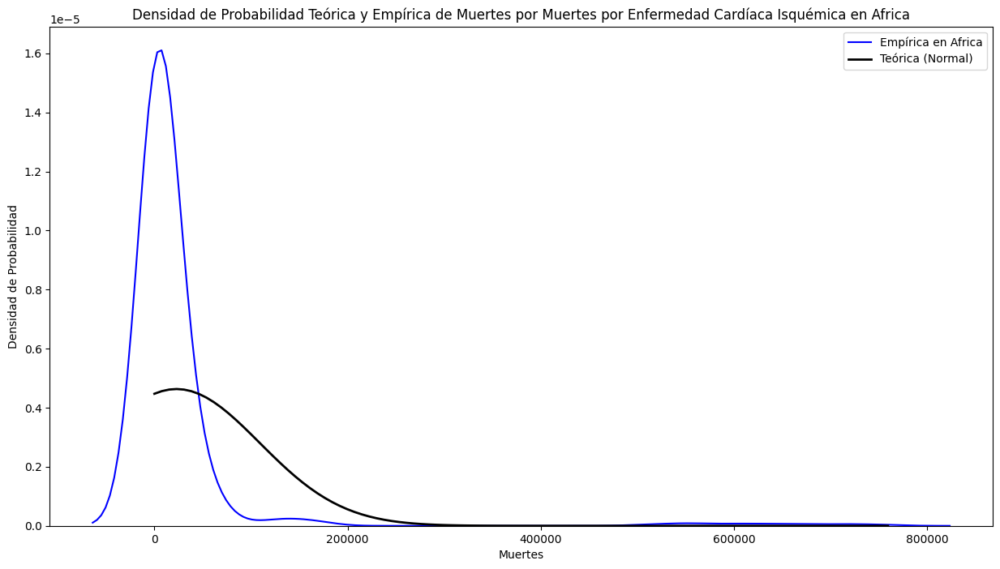

Densidad de probabilidad por Enfermedades Cardiovasculares en America del Norte


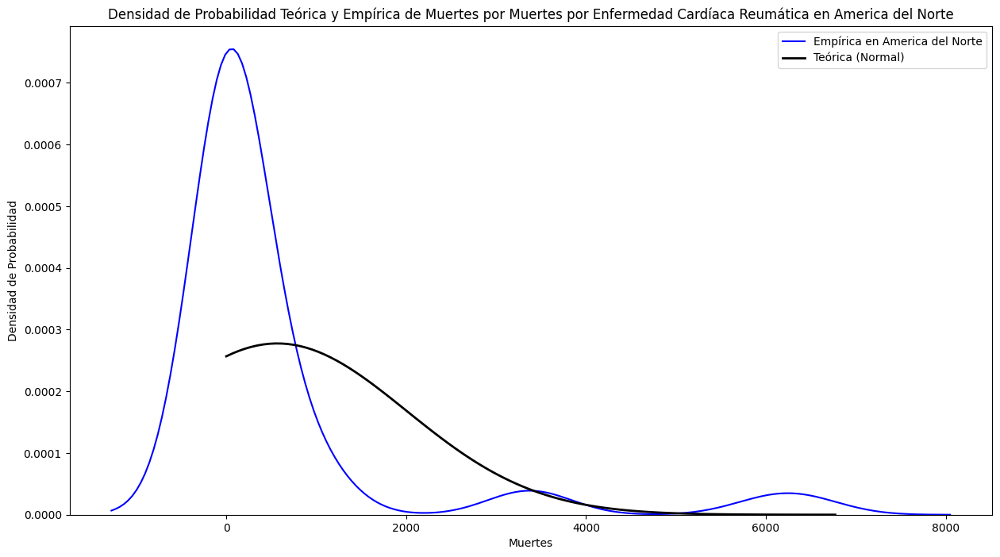

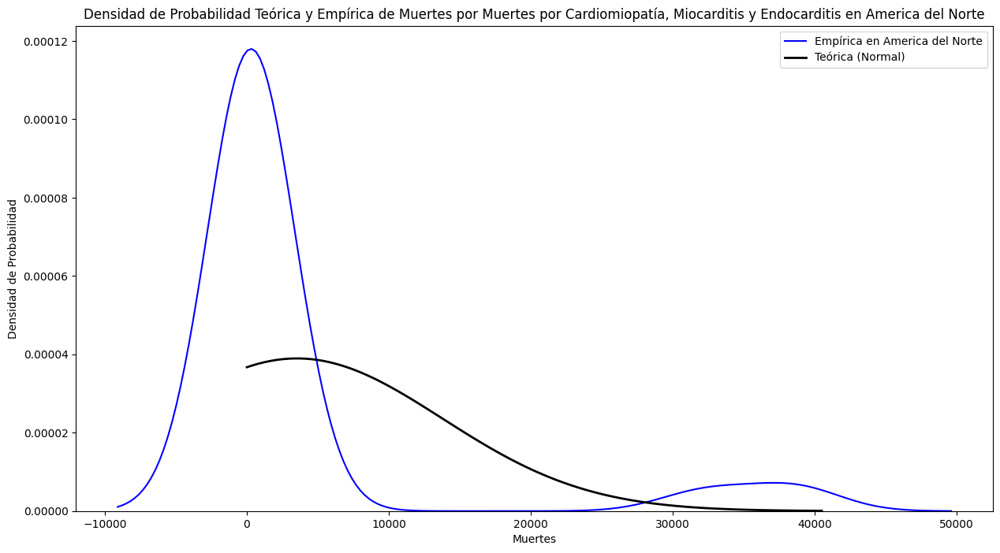

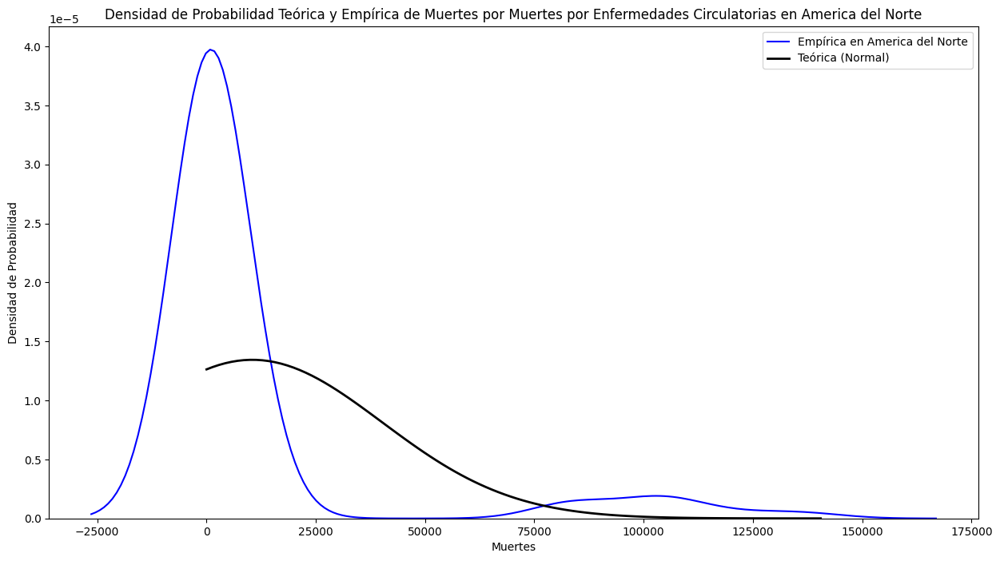

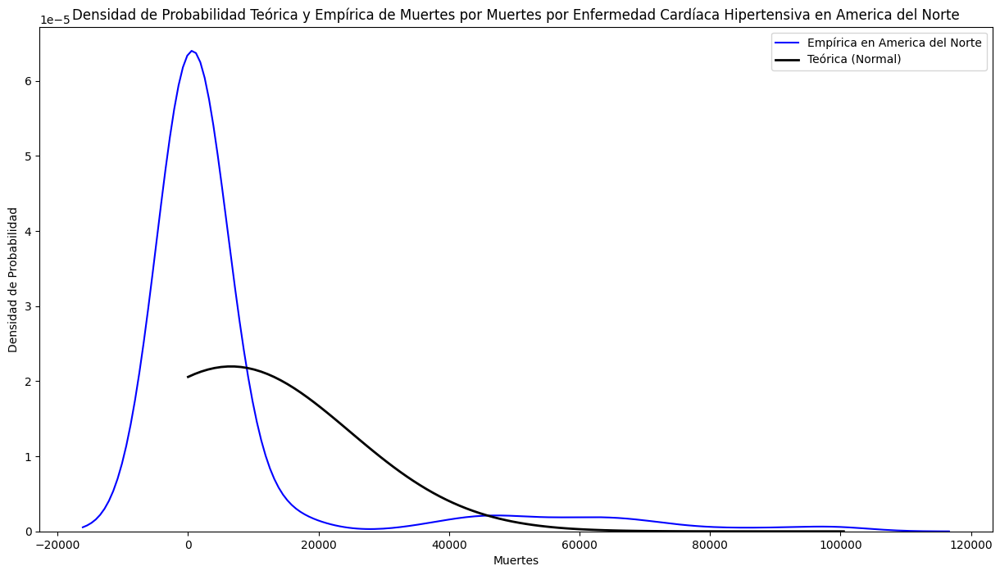

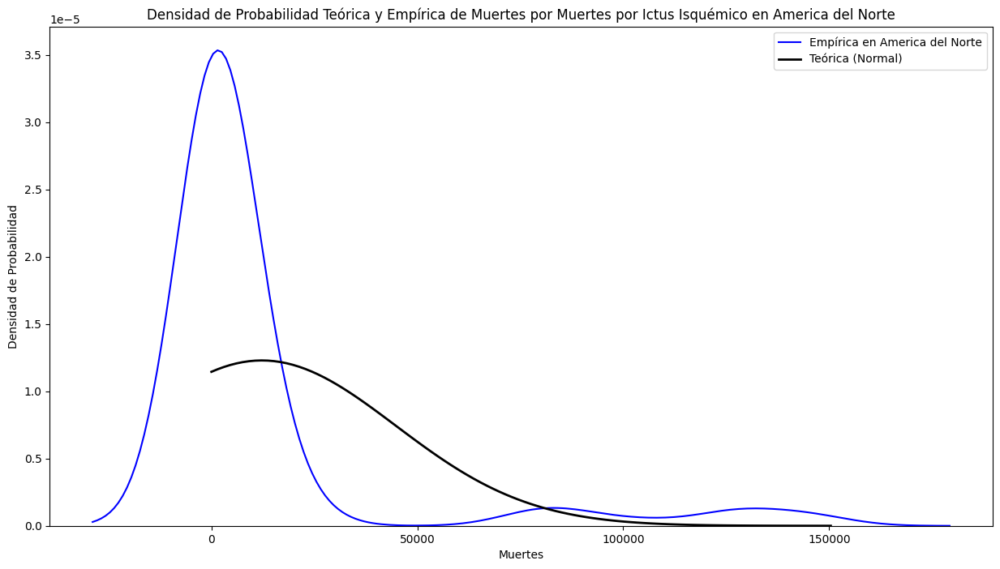

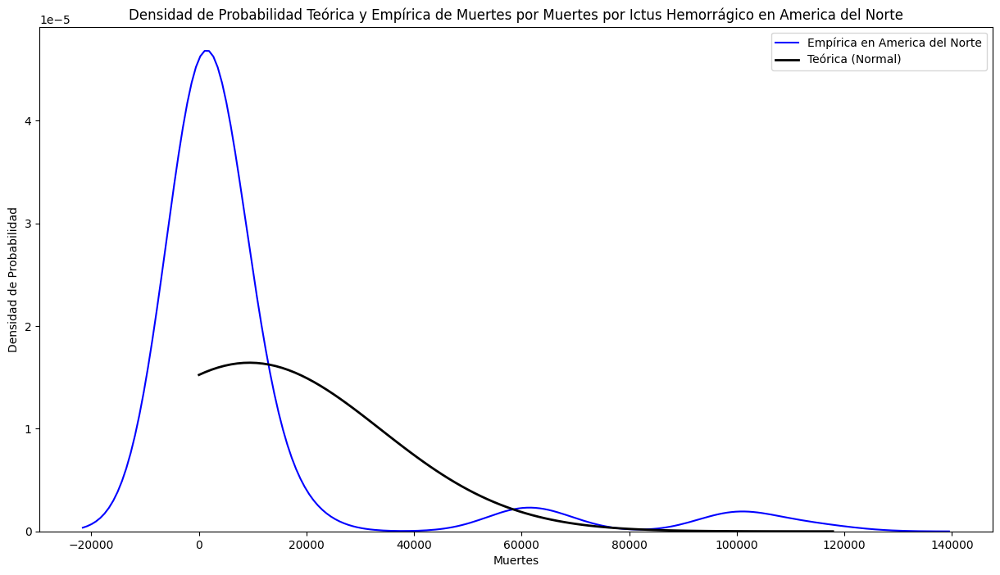

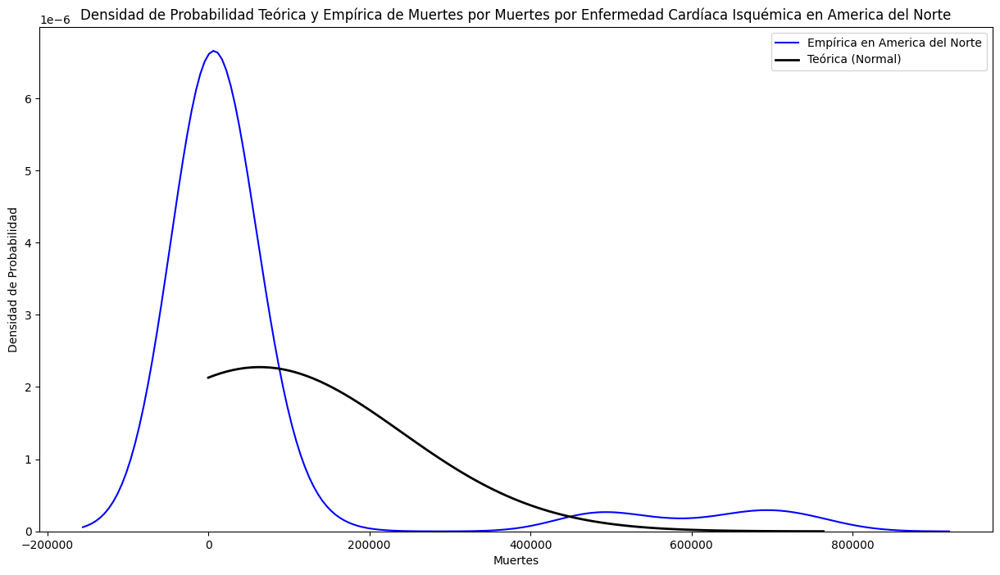

Densidad de probabilidad por Enfermedades Cardiovasculares en America del Sur


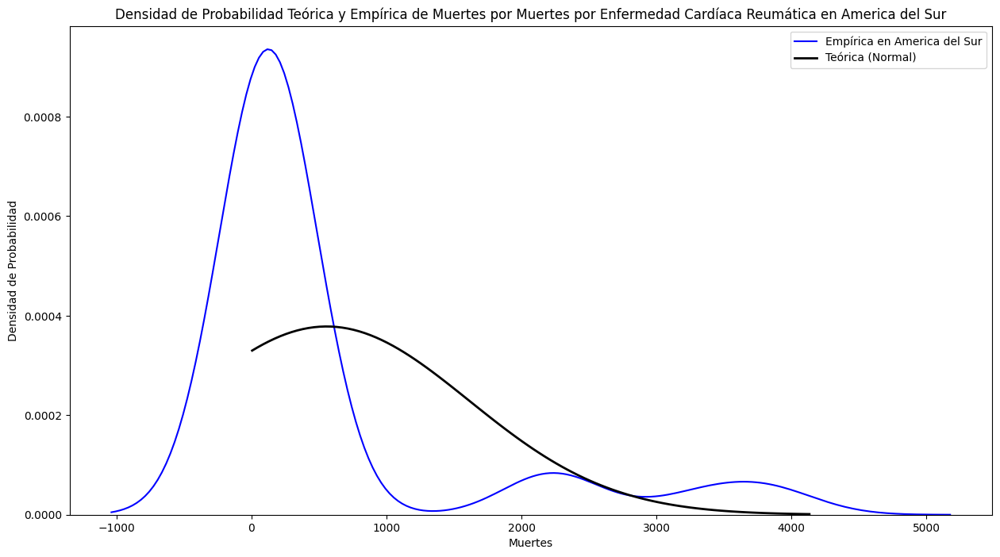

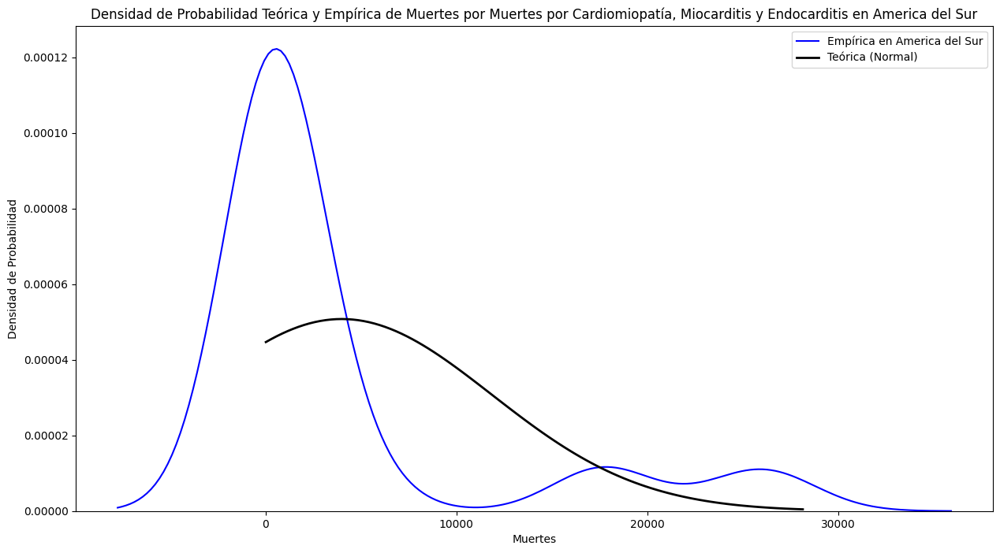

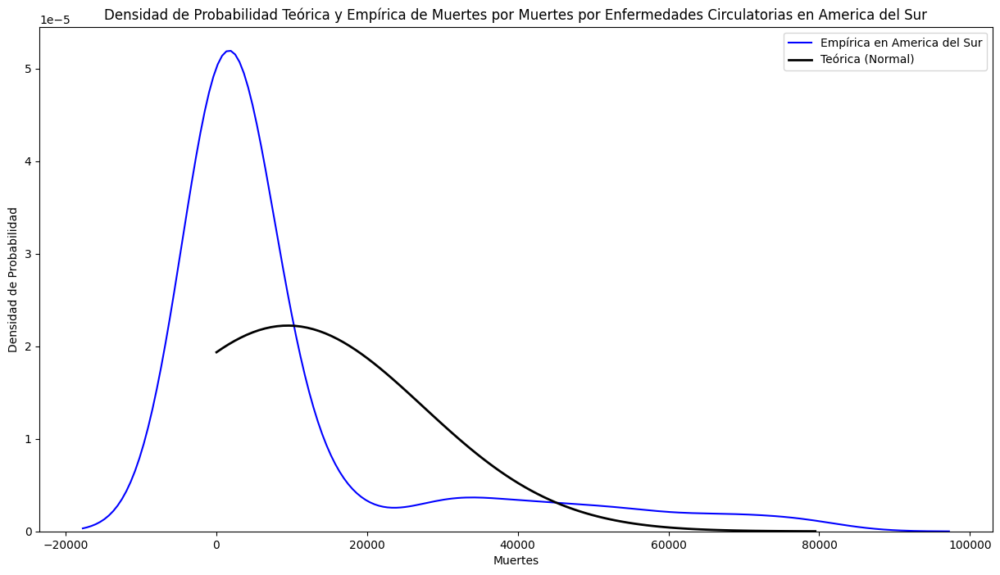

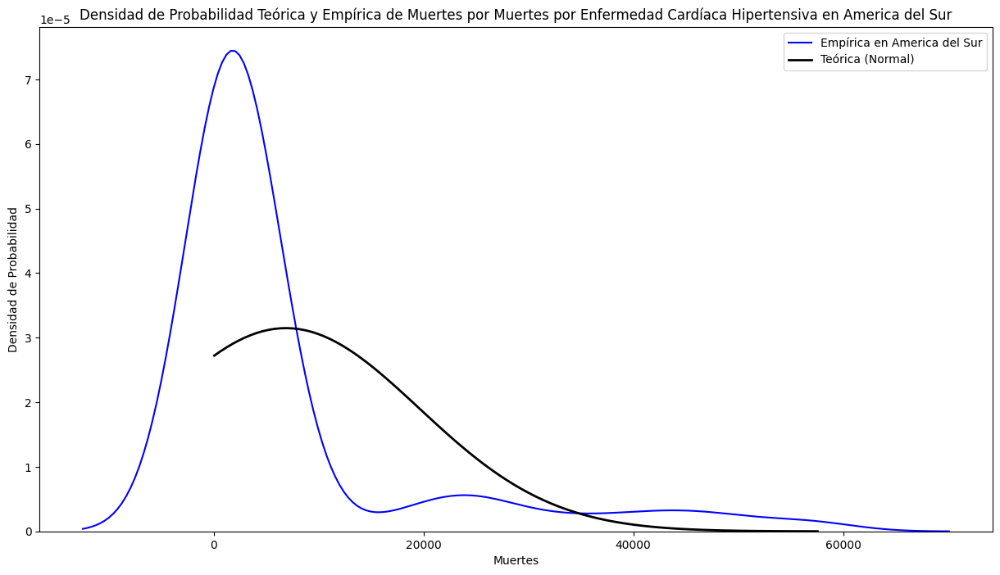

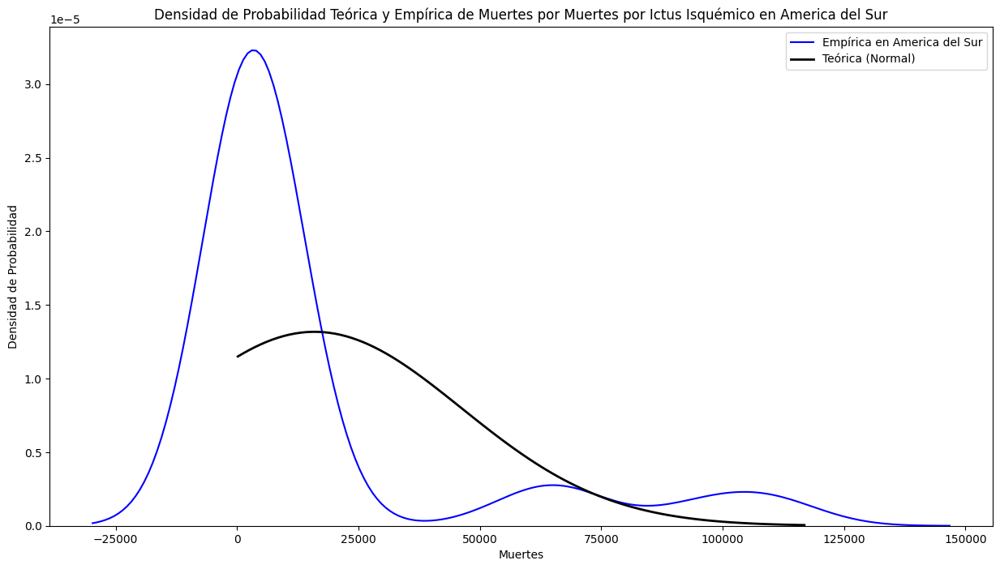

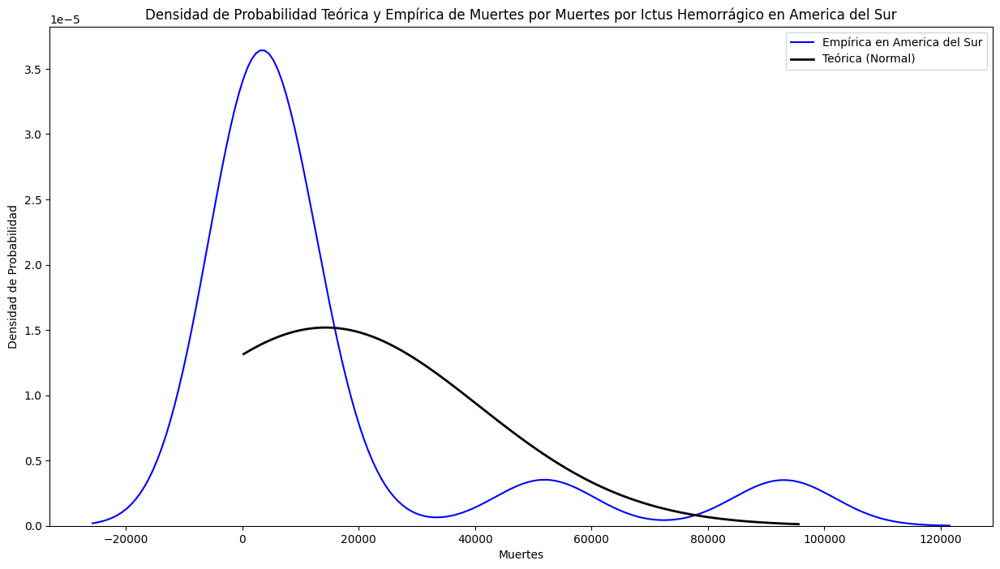

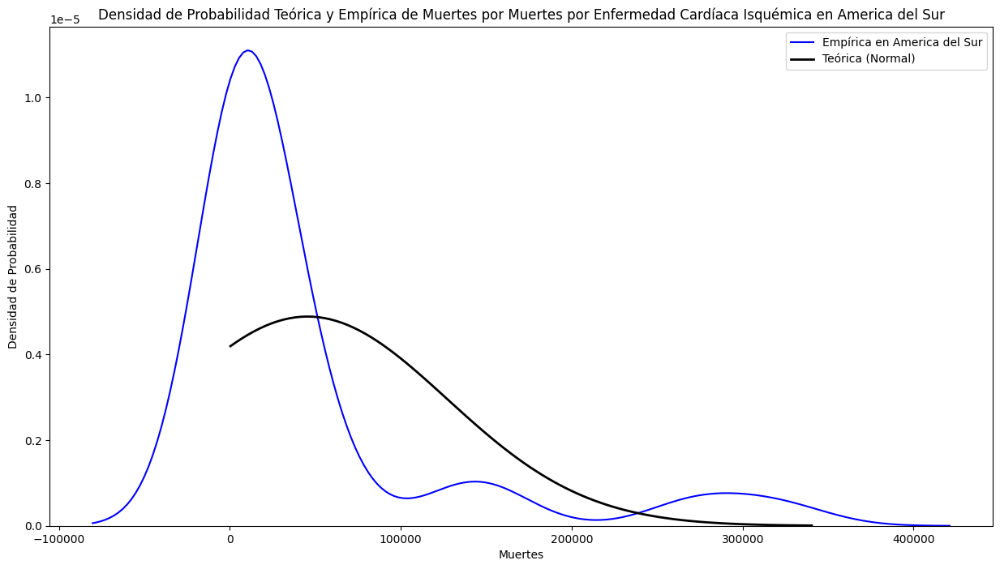

Densidad de probabilidad por Enfermedades Cardiovasculares en Asia


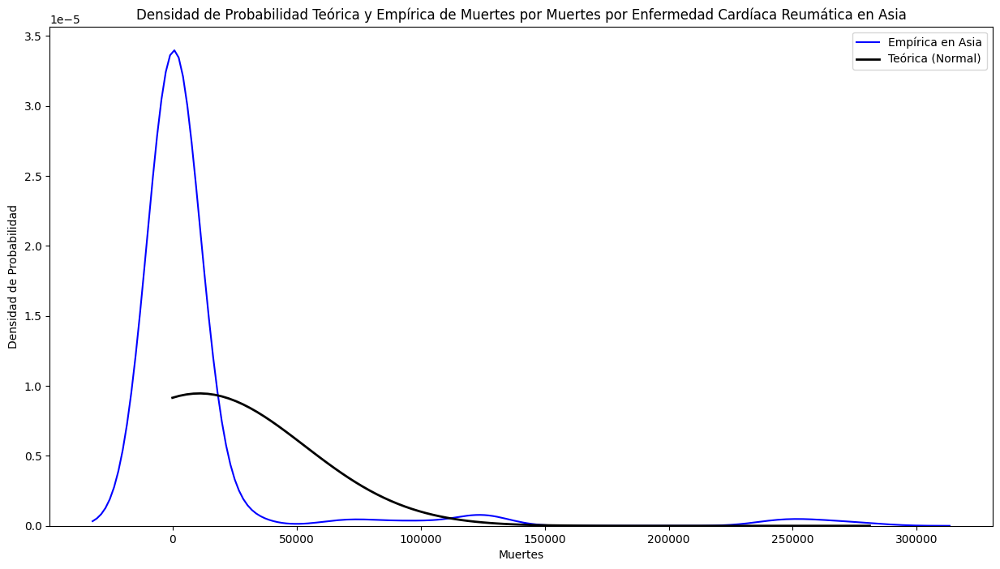

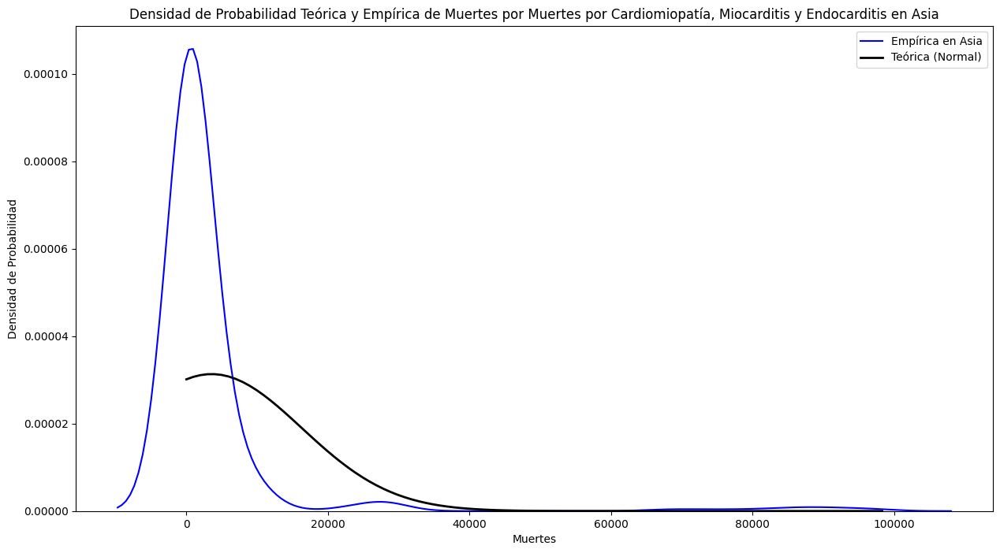

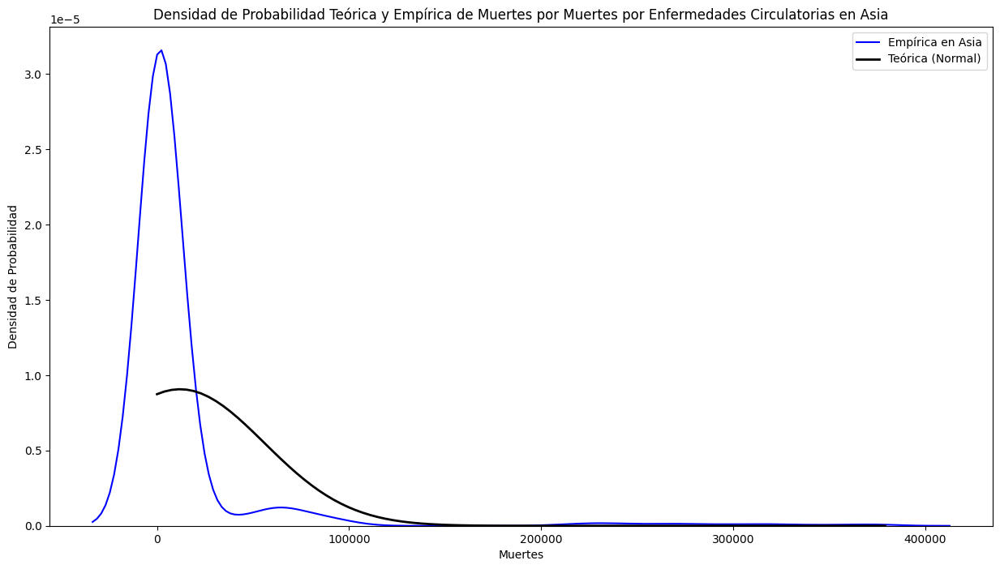

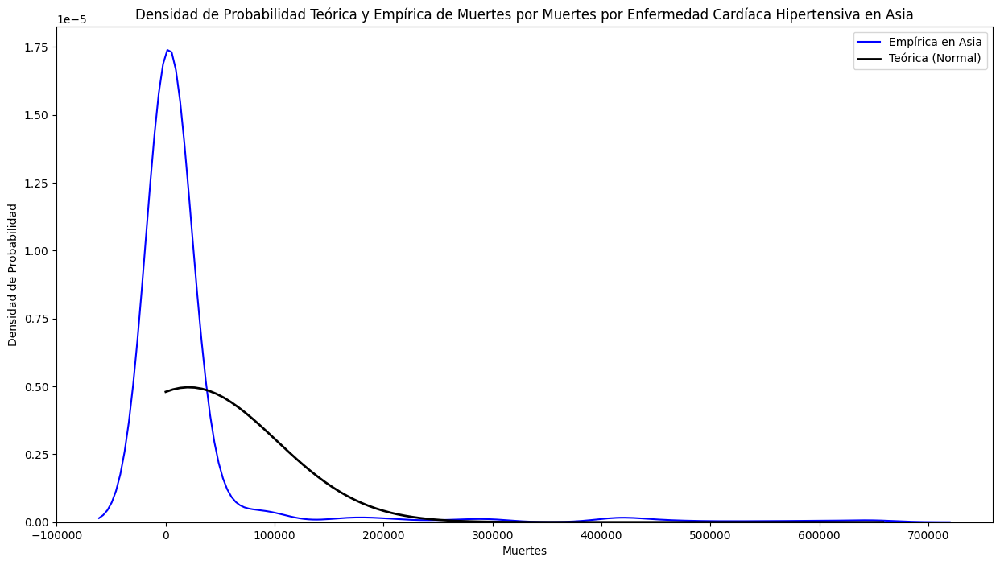

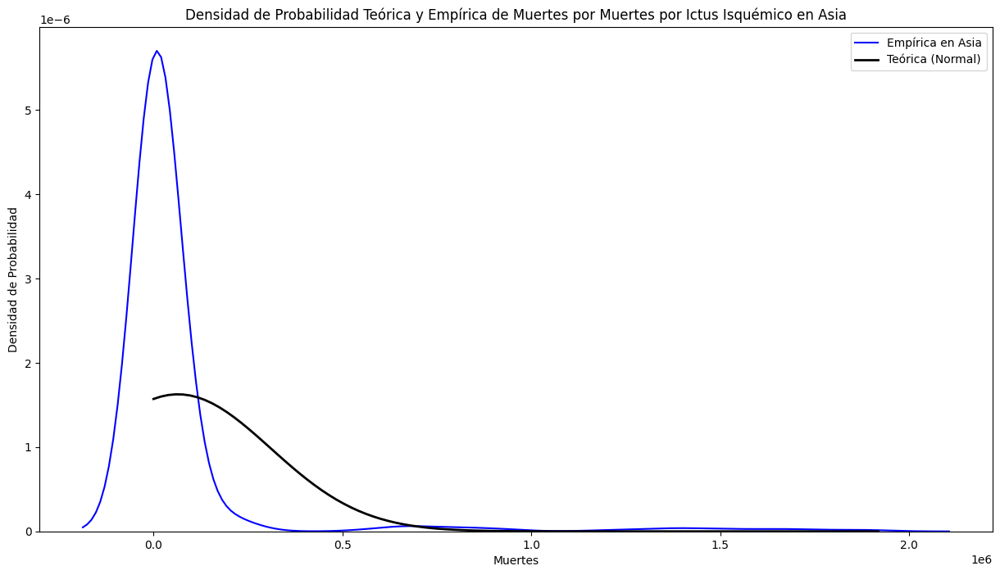

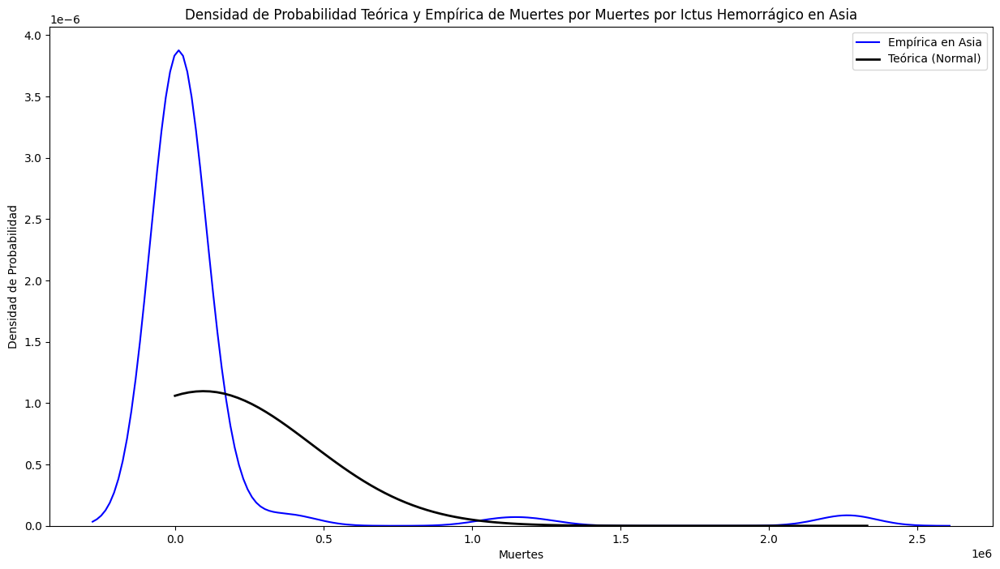

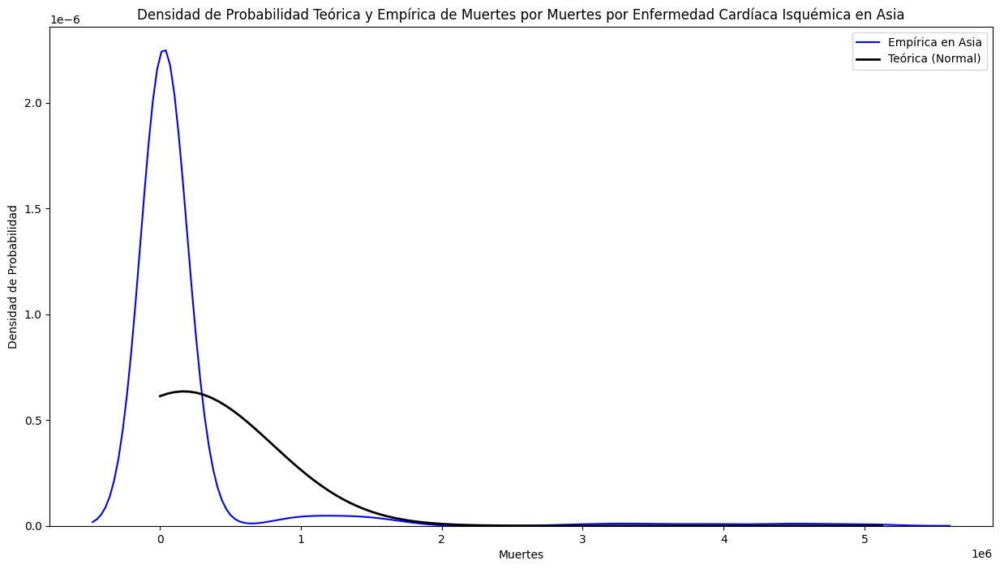

Densidad de probabilidad por Enfermedades Cardiovasculares en Europa


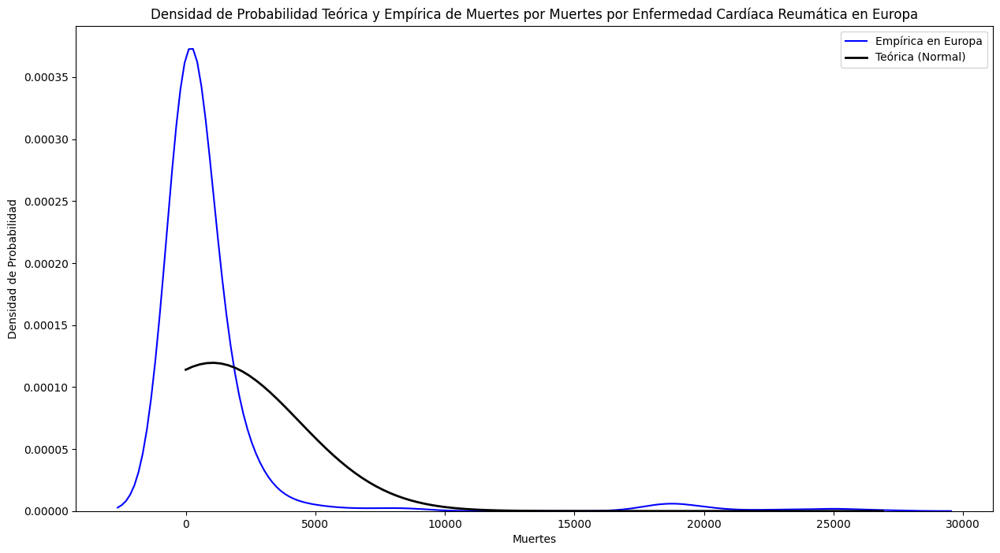

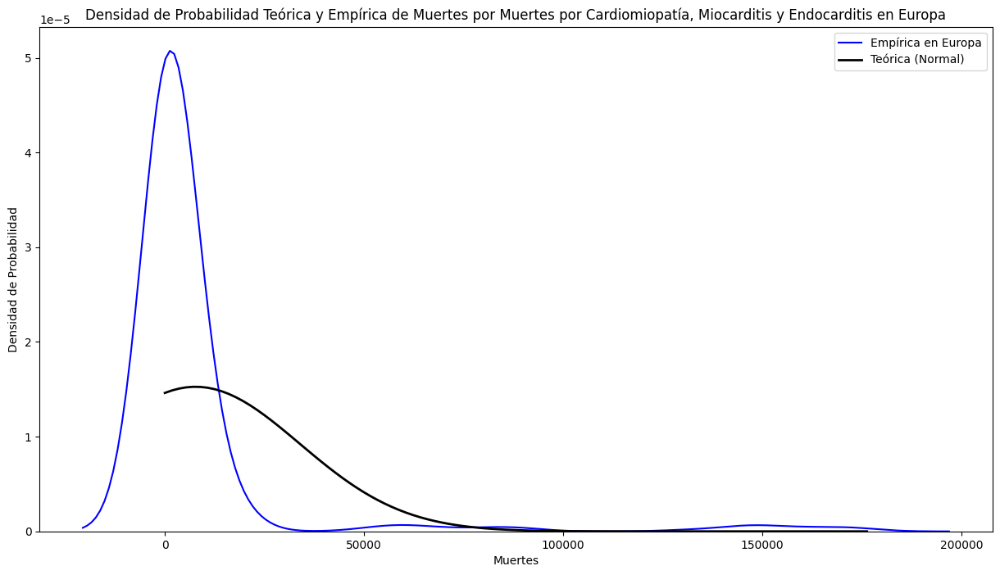

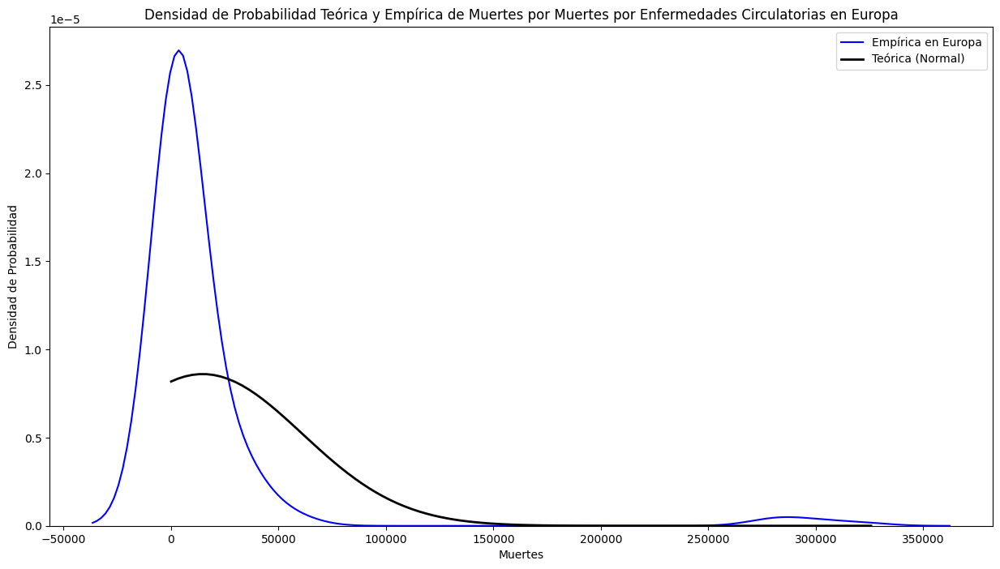

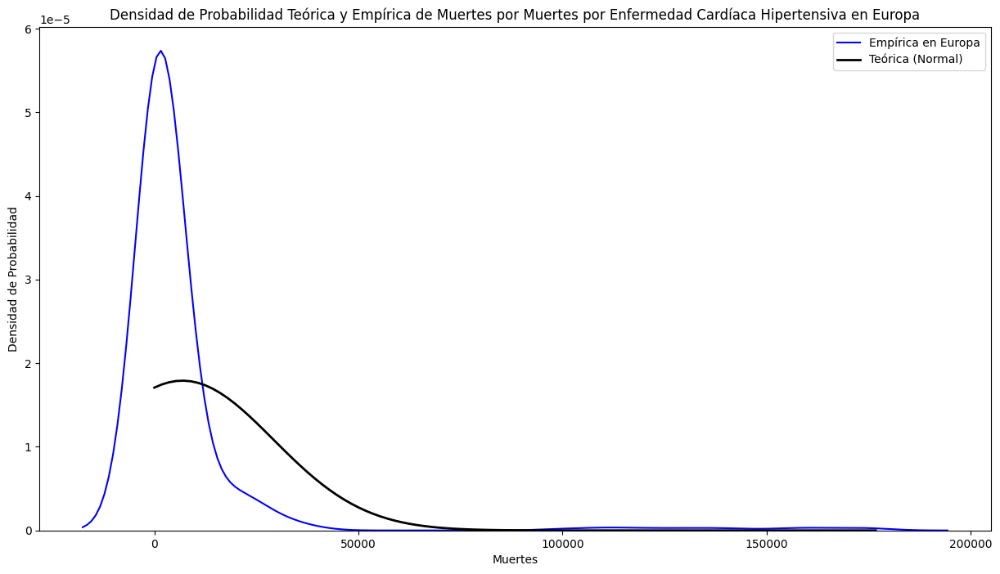

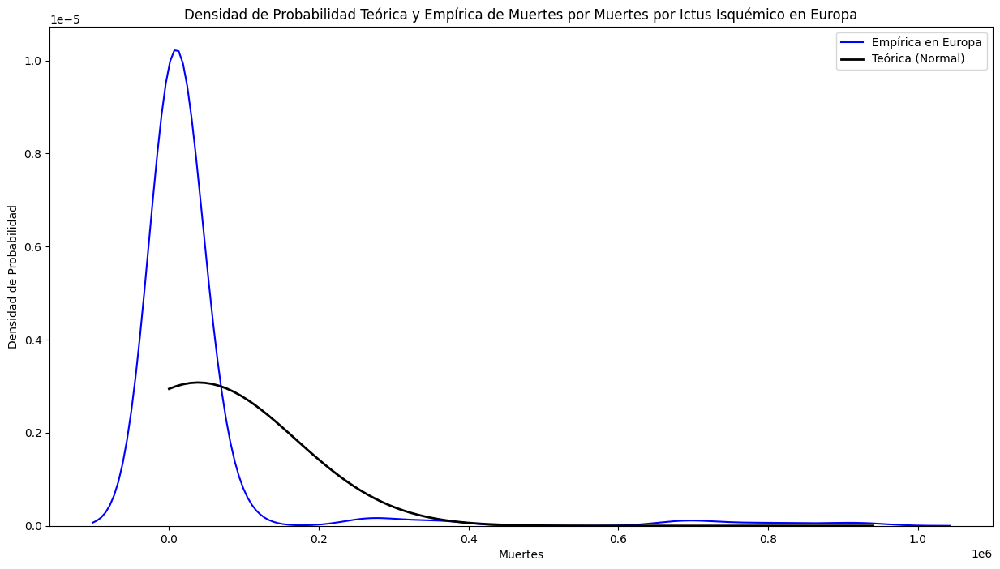

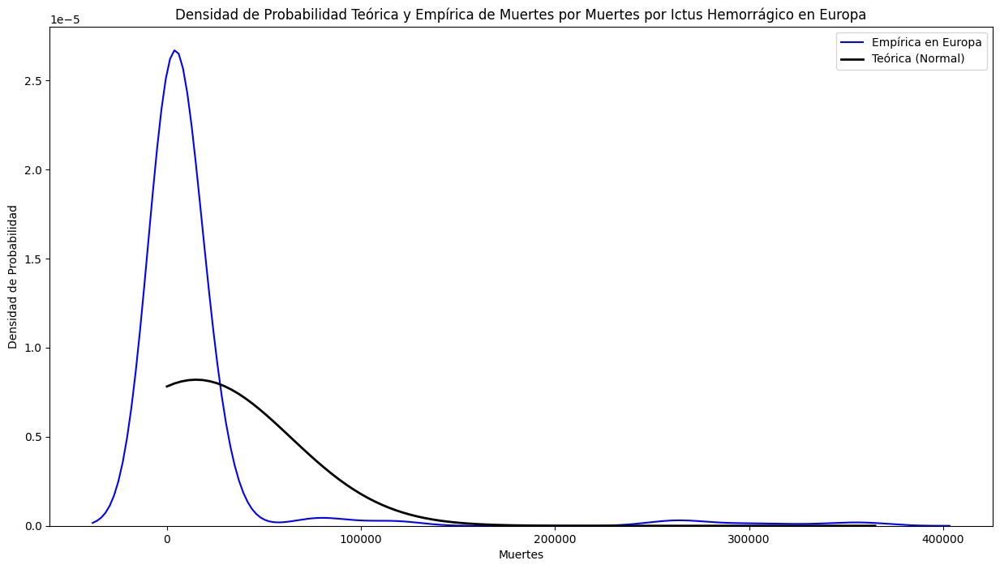

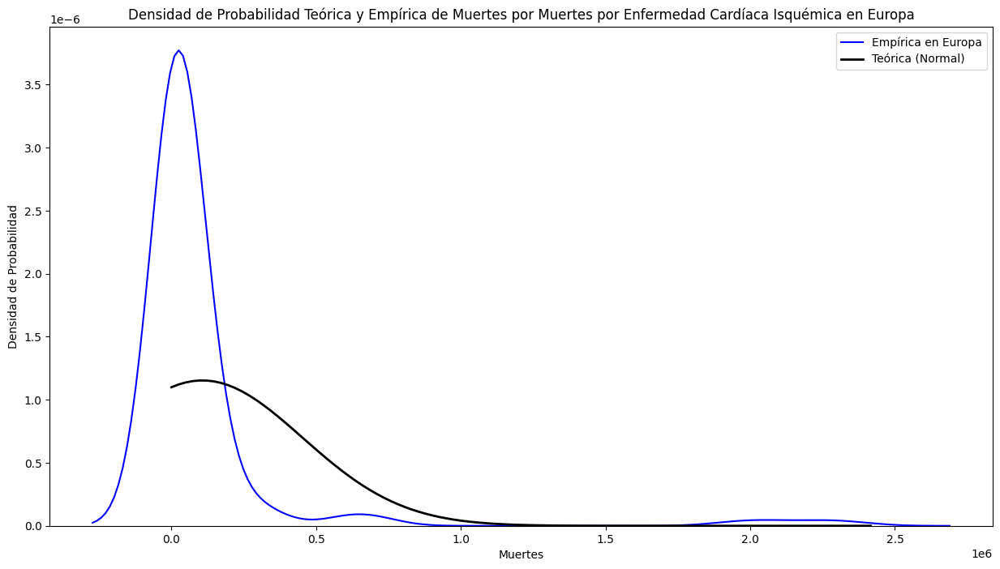

Densidad de probabilidad por Enfermedades Cardiovasculares en Oceania


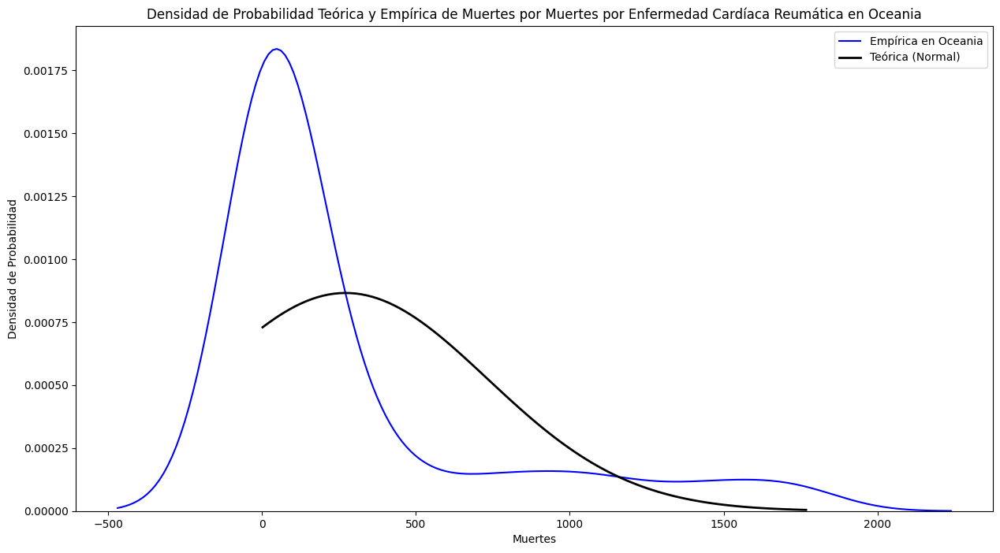

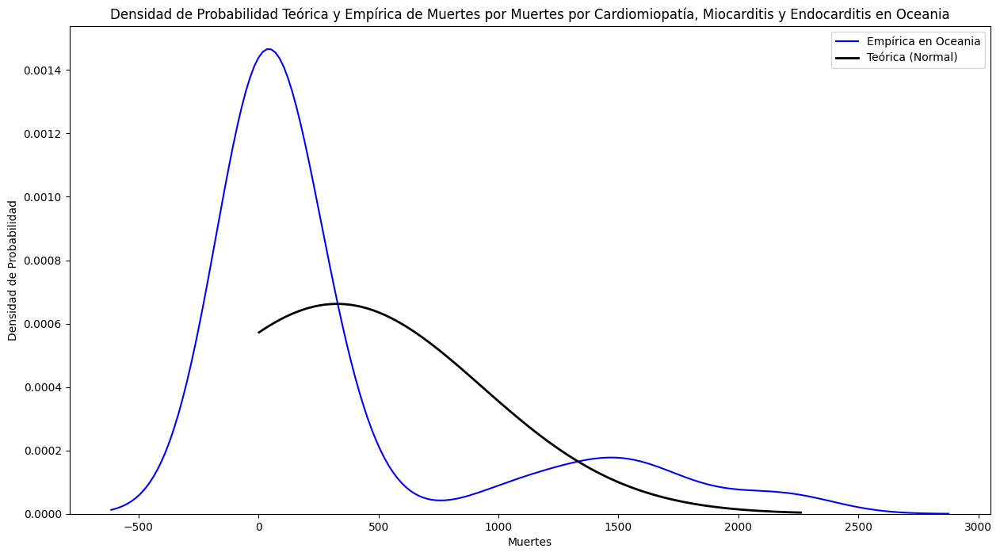

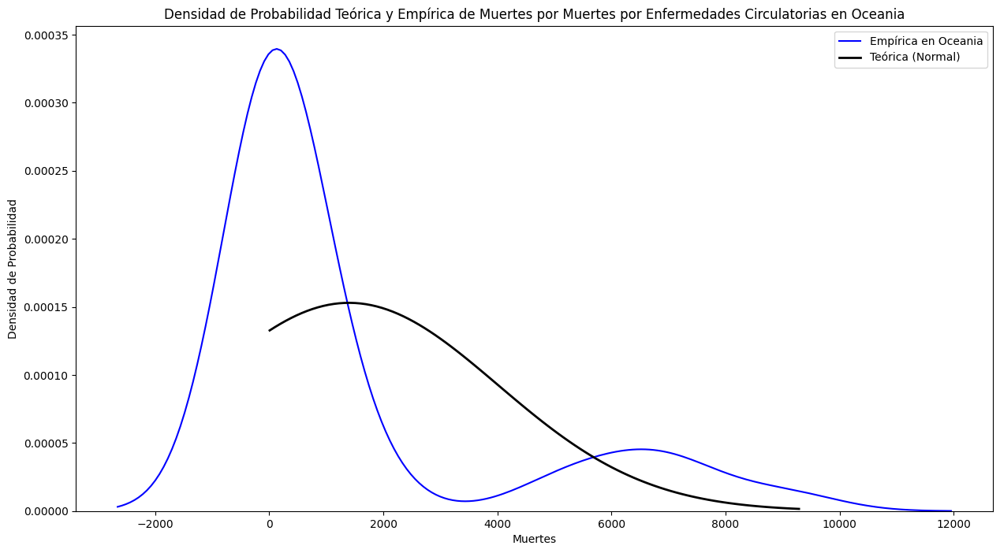

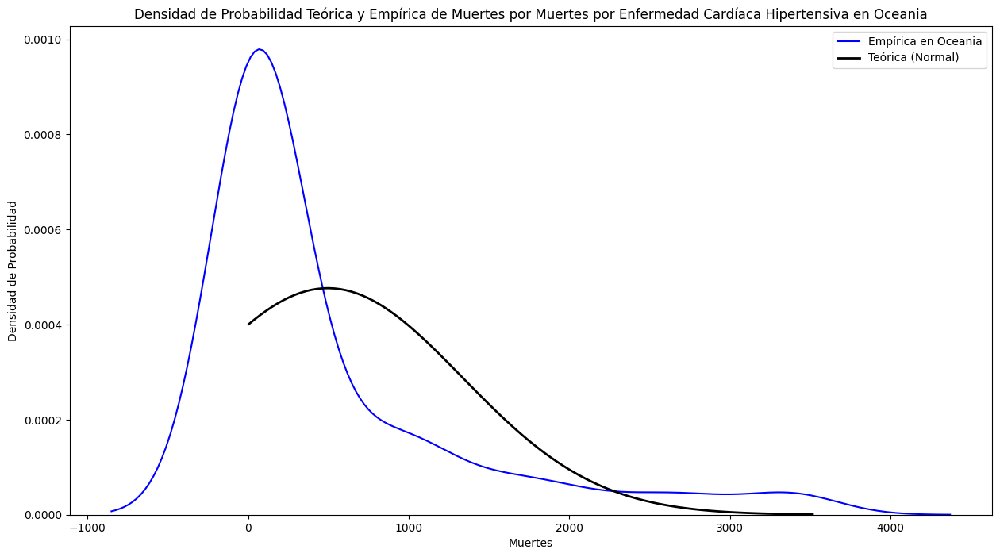

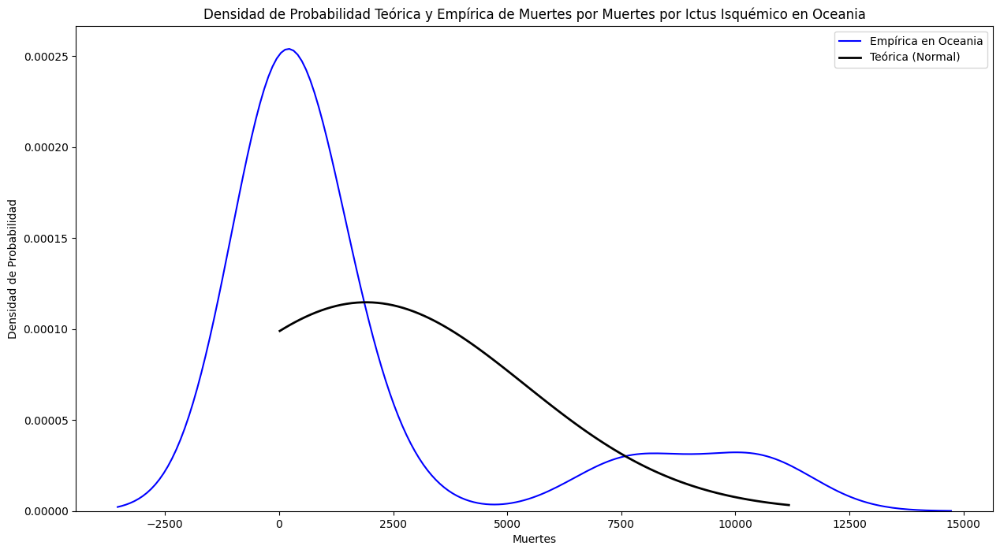

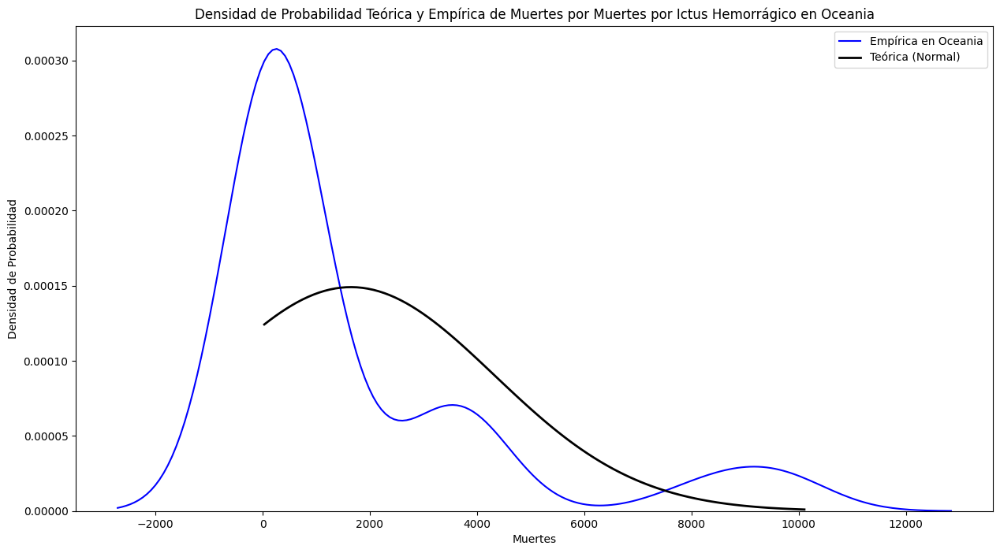

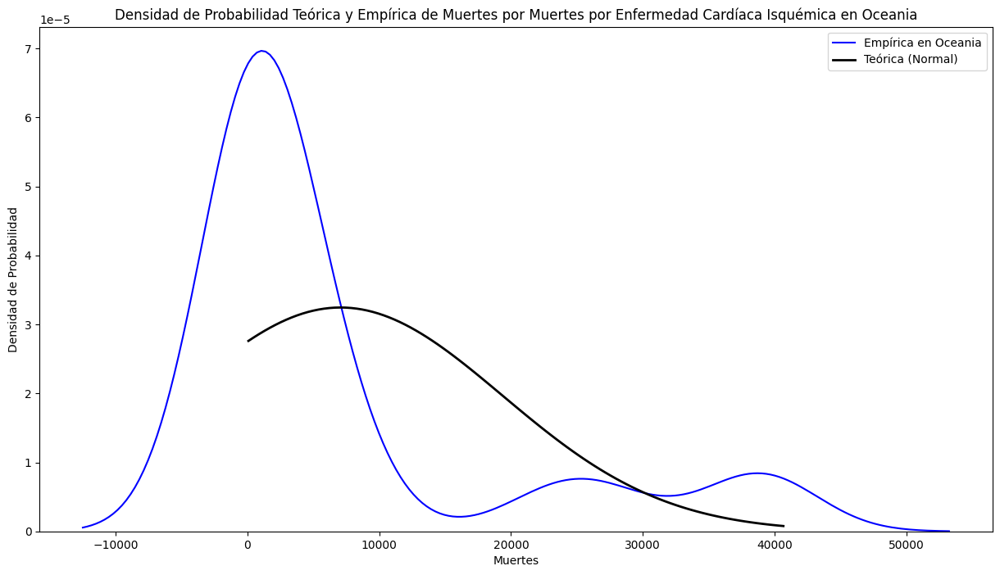

In [227]:
# Calcular la densidad de probabilidad teórica
def calcular_densidad_probabilidad_teorica(df, patologia):
    data_patologia = df[patologia].dropna()
    mu, std = stats.norm.fit(data_patologia)
    return mu, std

# Graficar la densidad de probabilidad teórica
def graficar_pdf_teorica(df, patologia, continente):
    data_patologia = df[patologia].dropna()
    mu, std = calcular_densidad_probabilidad_teorica(df, patologia)
    
    # Crear un rango de valores para x
    xmin, xmax = data_patologia.min(), data_patologia.max()
    x = np.linspace(xmin, xmax, 100)
    
    # Calcular la PDF teórica
    p = stats.norm.pdf(x, mu, std)
    
    # Graficar la PDF teórica y la empírica
    plt.figure(figsize=(15, 8))
    sns.kdeplot(data_patologia, label=f'Empírica en {continente}', color='blue')
    plt.plot(x, p, 'k', linewidth=2, label='Teórica (Normal)')
    plt.title(f'Densidad de Probabilidad Teórica y Empírica de Muertes por {patologia_legible} en {continente}')
    plt.xlabel('Muertes')
    plt.ylabel('Densidad de Probabilidad')
    plt.legend()
    plt.show()

for continente, paises in continentes.items():
    df_continente = df[df['Entity'].isin(paises)]
    print(f"Densidad de probabilidad por Enfermedades Cardiovasculares en {continente}")
    for patologia in patologias:
        patologia_legible = reemplazar_texto(patologia)
        # Graficar la densidad teórica y empírica
        graficar_pdf_teorica(df_continente, patologia, continente)

# Determinaciones

## Primeros tres momentos

Momentos para las muertes por enfermedades cardiovasculares en Africa
Para Muertes por Enfermedad Cardíaca Reumática:
Media: 695.2907416666666
Varianza: 6522368.194228765
Sesgo: 6.812073813175804
Para Muertes por Cardiomiopatía, Miocarditis y Endocarditis:
Media: 1334.9662305555557
Varianza: 24485358.245375372
Sesgo: 6.801526284441501
Para Muertes por Enfermedades Circulatorias:
Media: 2629.5956462962963
Varianza: 95158670.31498903
Sesgo: 6.881096546397012
Para Muertes por Enfermedad Cardíaca Hipertensiva:
Media: 5296.967296296296
Varianza: 381174785.8015882
Sesgo: 6.838792597838829
Para Muertes por Ictus Isquémico:
Media: 6525.879962962963
Varianza: 589312673.0046391
Sesgo: 6.941764356025917
Para Muertes por Ictus Hemorrágico:
Media: 10844.348324074075
Varianza: 1598794784.3659961
Sesgo: 6.8183403647643726
Para Muertes por Enfermedad Cardíaca Isquémica:
Media: 22916.073101851853
Varianza: 7415999001.550389
Sesgo: 6.6298986496515155


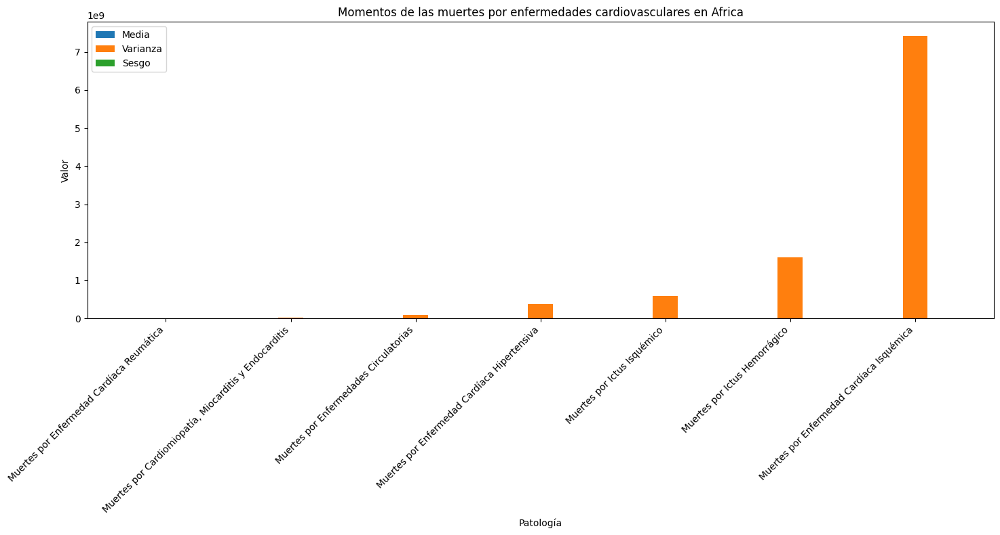

Momentos para las muertes por enfermedades cardiovasculares en America del Norte
Para Muertes por Enfermedad Cardíaca Reumática:
Media: 567.6289115909091
Varianza: 2064524.0128921298
Sesgo: 3.1279254301590766
Para Muertes por Cardiomiopatía, Miocarditis y Endocarditis:
Media: 3528.6015749999992
Varianza: 104853962.83120452
Sesgo: 2.883780842503068
Para Muertes por Enfermedades Circulatorias:
Media: 10489.266377272728
Varianza: 880600439.9547551
Sesgo: 2.97627948918127
Para Muertes por Enfermedad Cardíaca Hipertensiva:
Media: 6588.228811363637
Varianza: 329659290.0564914
Sesgo: 3.2328371708536228
Para Muertes por Ictus Isquémico:
Media: 12268.663827272727
Varianza: 1053319093.3649766
Sesgo: 3.055429484632576
Para Muertes por Ictus Hemorrágico:
Media: 9423.106956818181
Varianza: 589842923.1922778
Sesgo: 3.116313004930891
Para Muertes por Enfermedad Cardíaca Isquémica:
Media: 63887.88268181818
Varianza: 30736130754.22582
Sesgo: 2.955653017236642


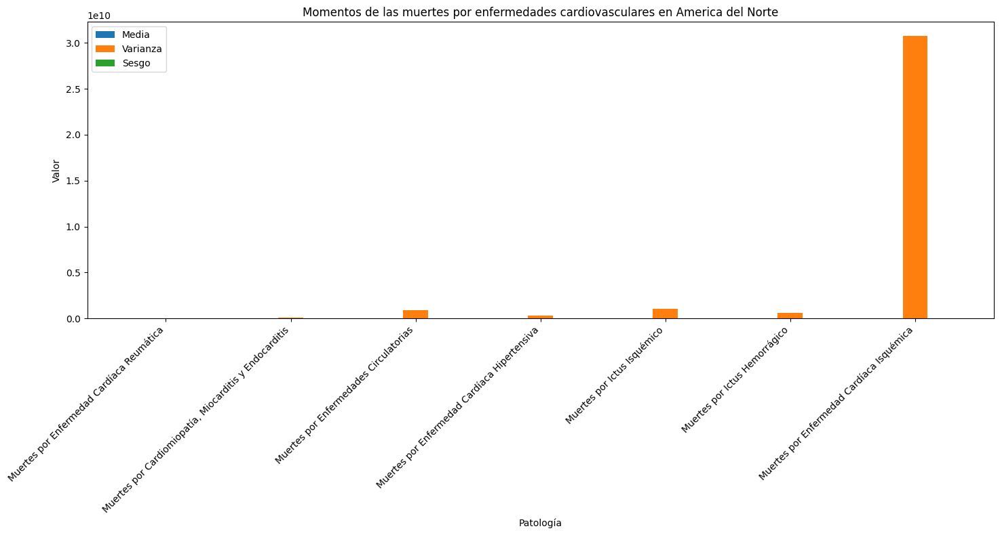

Momentos para las muertes por enfermedades cardiovasculares en America del Sur
Para Muertes por Enfermedad Cardíaca Reumática:
Media: 557.4066938461539
Varianza: 1111640.2245778553
Sesgo: 2.1861464938498303
Para Muertes por Cardiomiopatía, Miocarditis y Endocarditis:
Media: 3993.1508153846157
Varianza: 61706762.84740695
Sesgo: 2.0317228133038063
Para Muertes por Enfermedades Circulatorias:
Media: 9494.685046153845
Varianza: 322023039.0552223
Sesgo: 2.3105249550119957
Para Muertes por Enfermedad Cardíaca Hipertensiva:
Media: 6899.7429
Varianza: 160657676.13071093
Sesgo: 2.4508933957603642
Para Muertes por Ictus Isquémico:
Media: 15947.590834615386
Varianza: 916466237.8419727
Sesgo: 2.1746053340883953
Para Muertes por Ictus Hemorrágico:
Media: 14315.283415384616
Varianza: 690105345.5817225
Sesgo: 2.228766358649378
Para Muertes por Enfermedad Cardíaca Isquémica:
Media: 45442.8591923077
Varianza: 6663107971.831652
Sesgo: 2.3490705514632153


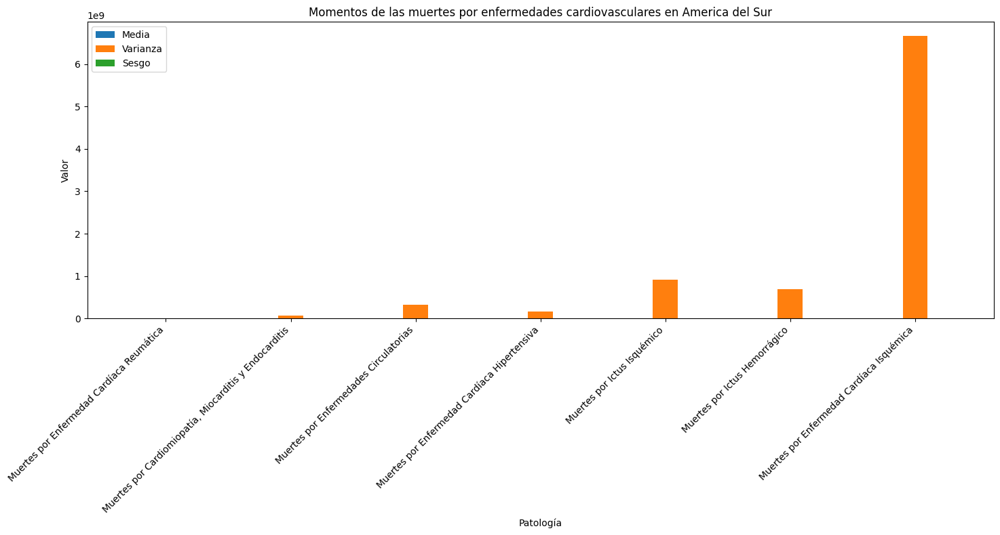

Momentos para las muertes por enfermedades cardiovasculares en Asia
Para Muertes por Enfermedad Cardíaca Reumática:
Media: 10926.722861702128
Varianza: 1778209412.5185895
Sesgo: 4.773089587314836
Para Muertes por Cardiomiopatía, Miocarditis y Endocarditis:
Media: 3559.5303989361705
Varianza: 162170068.4794886
Sesgo: 5.7771730689452685
Para Muertes por Enfermedades Circulatorias:
Media: 11967.89370212766
Varianza: 1933654351.5466864
Sesgo: 5.75228599744891
Para Muertes por Enfermedad Cardíaca Hipertensiva:
Media: 21147.484595744678
Varianza: 6446459013.343166
Sesgo: 5.483265169494541
Para Muertes por Ictus Isquémico:
Media: 64640.36261702128
Varianza: 60128345252.30783
Sesgo: 5.289504916329435
Para Muertes por Ictus Hemorrágico:
Media: 95936.68921276595
Varianza: 132116303821.09695
Sesgo: 5.02451469519539
Para Muertes por Enfermedad Cardíaca Isquémica:
Media: 168501.3214893617
Varianza: 394030813259.25385
Sesgo: 5.52710869355686


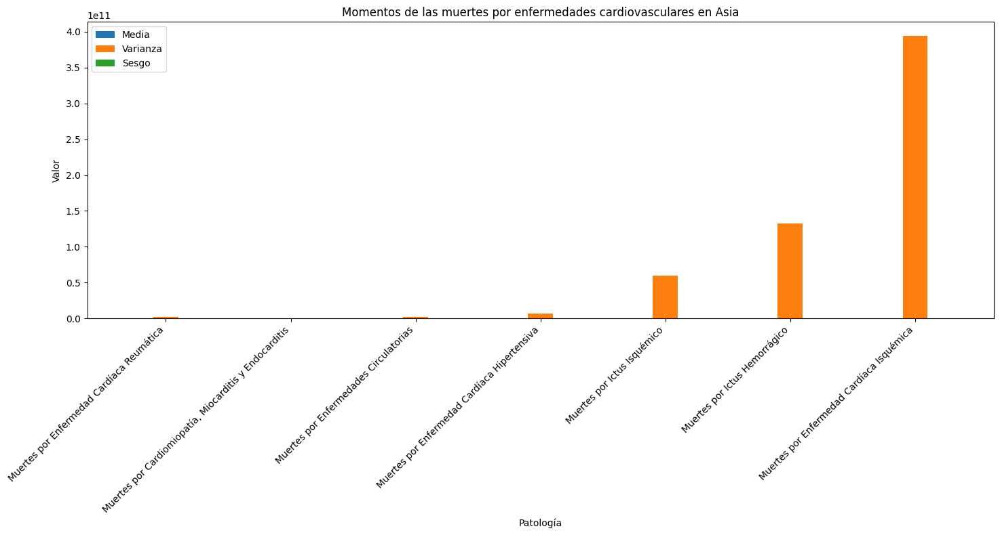

Momentos para las muertes por enfermedades cardiovasculares en Europa
Para Muertes por Enfermedad Cardíaca Reumática:
Media: 1031.65173
Varianza: 11135130.07293941
Sesgo: 5.4770023968595565
Para Muertes por Cardiomiopatía, Miocarditis y Endocarditis:
Media: 7720.51135
Varianza: 682944758.292572
Sesgo: 4.889682828310057
Para Muertes por Enfermedades Circulatorias:
Media: 14744.563287500001
Varianza: 2149124468.575478
Sesgo: 5.583149121221579
Para Muertes por Enfermedad Cardíaca Hipertensiva:
Media: 6901.512475
Varianza: 496276388.54829186
Sesgo: 5.683342450912456
Para Muertes por Ictus Isquémico:
Media: 39087.7288875
Varianza: 16786615692.924034
Sesgo: 5.162651130021468
Para Muertes por Ictus Hemorrágico:
Media: 15018.937725
Varianza: 2366571885.3668613
Sesgo: 5.465142507149118
Para Muertes por Enfermedad Cardíaca Isquémica:
Media: 107147.1270625
Varianza: 119647235459.389
Sesgo: 5.281670460411995


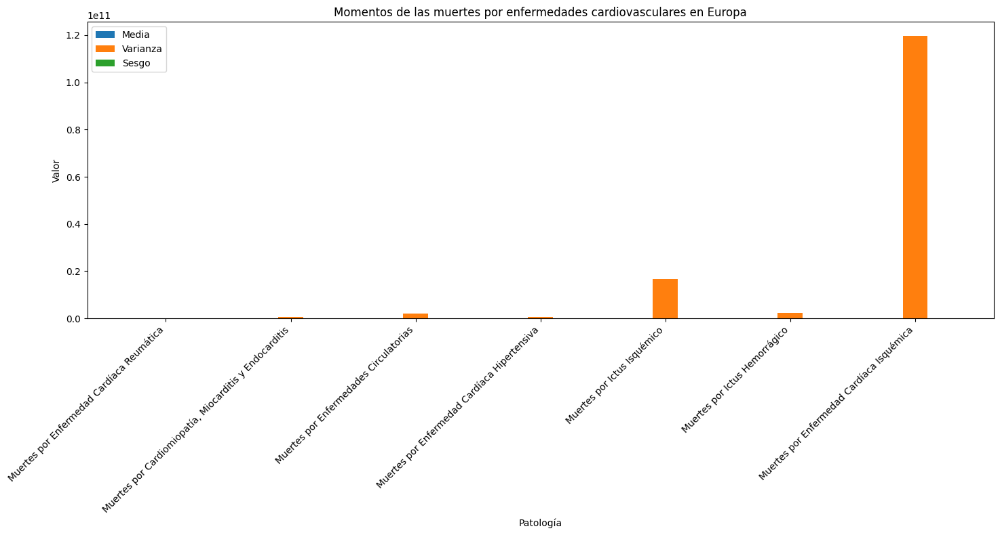

Momentos para las muertes por enfermedades cardiovasculares en Oceania
Para Muertes por Enfermedad Cardíaca Reumática:
Media: 271.8251813636364
Varianza: 212252.34626702653
Sesgo: 1.9629731492482232
Para Muertes por Cardiomiopatía, Miocarditis y Endocarditis:
Media: 327.3867259090909
Varianza: 362969.82386164414
Sesgo: 1.8584947988140659
Para Muertes por Enfermedades Circulatorias:
Media: 1397.2931809090908
Varianza: 6802201.422383125
Sesgo: 1.762019439384836
Para Muertes por Enfermedad Cardíaca Hipertensiva:
Media: 496.46036181818187
Varianza: 700554.2611185604
Sesgo: 2.075243996511416
Para Muertes por Ictus Isquémico:
Media: 1905.1367363636361
Varianza: 12085808.81548572
Sesgo: 1.7002176614464826
Para Muertes por Ictus Hemorrágico:
Media: 1646.7172745454543
Varianza: 7165770.964816027
Sesgo: 1.9502770472878916
Para Muertes por Enfermedad Cardíaca Isquémica:
Media: 7065.691745454545
Varianza: 151119490.1206535
Sesgo: 1.778673740075485


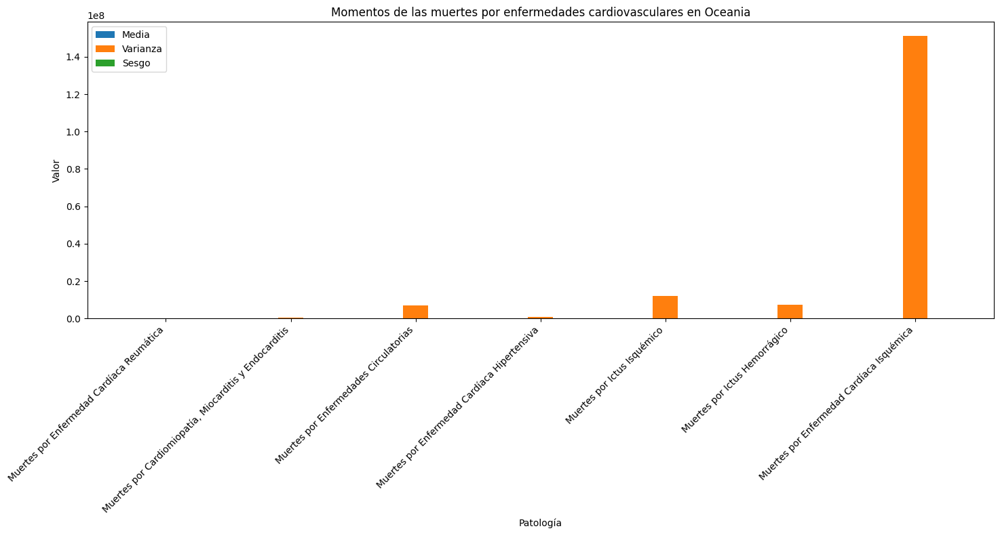

In [229]:
# Función para calcular los momentos
def calcular_momentos(df, patologia):
    data_patologia = df[patologia].dropna()
    media = np.mean(data_patologia)
    varianza = np.var(data_patologia)
    sesgo = skew(data_patologia)
    return media, varianza, sesgo

# Bucle para calcular y graficar los momentos por continente y patología
for continente, paises in continentes.items():
    df_continente = df[df['Entity'].isin(paises)]
    print(f"Momentos para las muertes por enfermedades cardiovasculares en {continente}")
    
    momentos_continente = {}

    for patologia in patologias:
        media, varianza, sesgo = calcular_momentos(df_continente, patologia)
        patologia_legible = reemplazar_texto(patologia)
        momentos_continente[patologia_legible] = {'media': media, 'varianza': varianza, 'sesgo': sesgo}
        
        print(f"Para {patologia_legible}:")
        print(f"Media: {media}")
        print(f"Varianza: {varianza}")
        print(f"Sesgo: {sesgo}")
        print("="*90)
        
    # Graficar los momentos para el continente actual
    patologias_legibles = list(momentos_continente.keys())
    medias = [momentos_continente[p]['media'] for p in patologias_legibles]
    varianzas = [momentos_continente[p]['varianza'] for p in patologias_legibles]
    sesgos = [momentos_continente[p]['sesgo'] for p in patologias_legibles]
    
    x = np.arange(len(patologias_legibles))
    width = 0.2
    
    fig, ax = plt.subplots(figsize=(15, 8))
    
    bar1 = ax.bar(x - width, medias, width, label='Media')
    bar2 = ax.bar(x, varianzas, width, label='Varianza')
    bar3 = ax.bar(x + width, sesgos, width, label='Sesgo')
    
    ax.set_xlabel('Patología')
    ax.set_ylabel('Valor')
    ax.set_title(f'Momentos de las muertes por enfermedades cardiovasculares en {continente}')
    ax.set_xticks(x)
    ax.set_xticklabels(patologias_legibles, rotation=45, ha="right")
    ax.legend()
    
    plt.tight_layout()
    plt.show()

## coeficiente de variación

Coeficiente de Variación para las muertes por enfermedades cardiovasculares en Africa
Para Muertes por Enfermedad Cardíaca Reumática:
Coeficiente de Variación (CV): 3.6731292393696875
Para Muertes por Cardiomiopatía, Miocarditis y Endocarditis:
Coeficiente de Variación (CV): 3.706661706816667
Para Muertes por Enfermedades Circulatorias:
Coeficiente de Variación (CV): 3.709669423157929
Para Muertes por Enfermedad Cardíaca Hipertensiva:
Coeficiente de Variación (CV): 3.6858256742790334
Para Muertes por Ictus Isquémico:
Coeficiente de Variación (CV): 3.719921790697227
Para Muertes por Ictus Hemorrágico:
Coeficiente de Variación (CV): 3.6871678012905007
Para Muertes por Enfermedad Cardíaca Isquémica:
Coeficiente de Variación (CV): 3.757894923209071


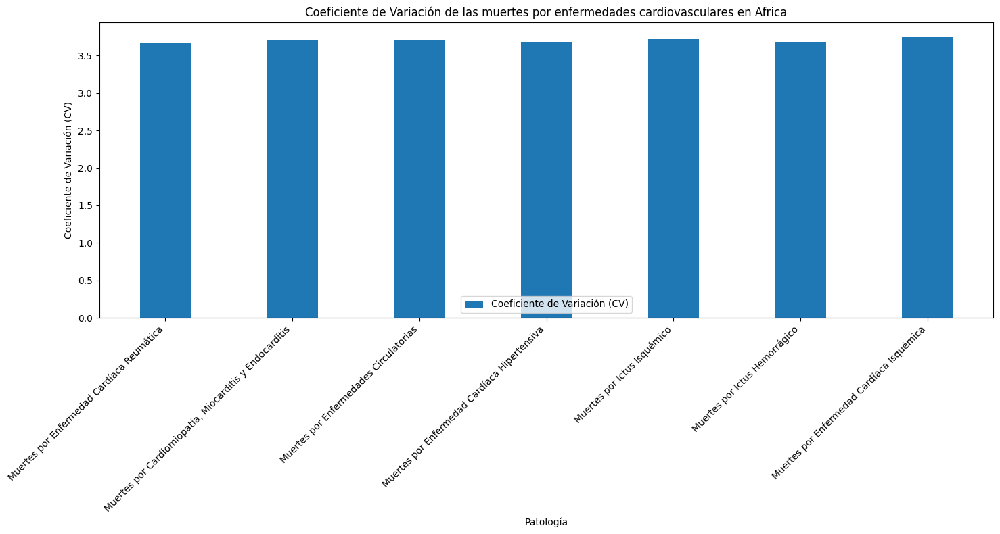

Coeficiente de Variación para las muertes por enfermedades cardiovasculares en America del Norte
Para Muertes por Enfermedad Cardíaca Reumática:
Coeficiente de Variación (CV): 2.531310739003096
Para Muertes por Cardiomiopatía, Miocarditis y Endocarditis:
Coeficiente de Variación (CV): 2.9019491673064066
Para Muertes por Enfermedades Circulatorias:
Coeficiente de Variación (CV): 2.8290741762747054
Para Muertes por Enfermedad Cardíaca Hipertensiva:
Coeficiente de Variación (CV): 2.755903367979834
Para Muertes por Ictus Isquémico:
Coeficiente de Variación (CV): 2.6453473876493176
Para Muertes por Ictus Hemorrágico:
Coeficiente de Variación (CV): 2.577353958107868
Para Muertes por Enfermedad Cardíaca Isquémica:
Coeficiente de Variación (CV): 2.7441389752660914


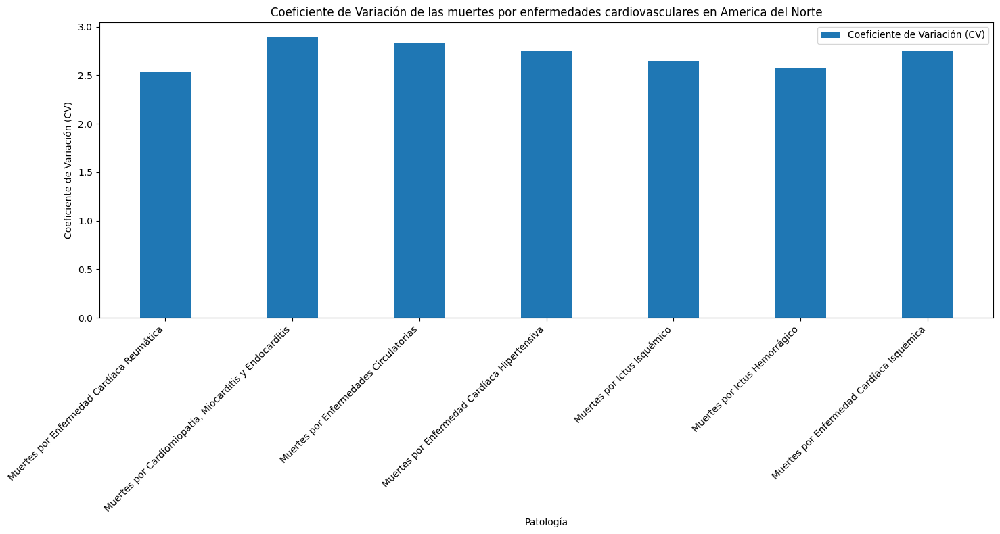

Coeficiente de Variación para las muertes por enfermedades cardiovasculares en America del Sur
Para Muertes por Enfermedad Cardíaca Reumática:
Coeficiente de Variación (CV): 1.8915156845291548
Para Muertes por Cardiomiopatía, Miocarditis y Endocarditis:
Coeficiente de Variación (CV): 1.9672097524085848
Para Muertes por Enfermedades Circulatorias:
Coeficiente de Variación (CV): 1.890004808415283
Para Muertes por Enfermedad Cardíaca Hipertensiva:
Coeficiente de Variación (CV): 1.837036697729103
Para Muertes por Ictus Isquémico:
Coeficiente de Variación (CV): 1.898292582301007
Para Muertes por Ictus Hemorrágico:
Coeficiente de Variación (CV): 1.8350915907988707
Para Muertes por Enfermedad Cardíaca Isquémica:
Coeficiente de Variación (CV): 1.7962747980291218


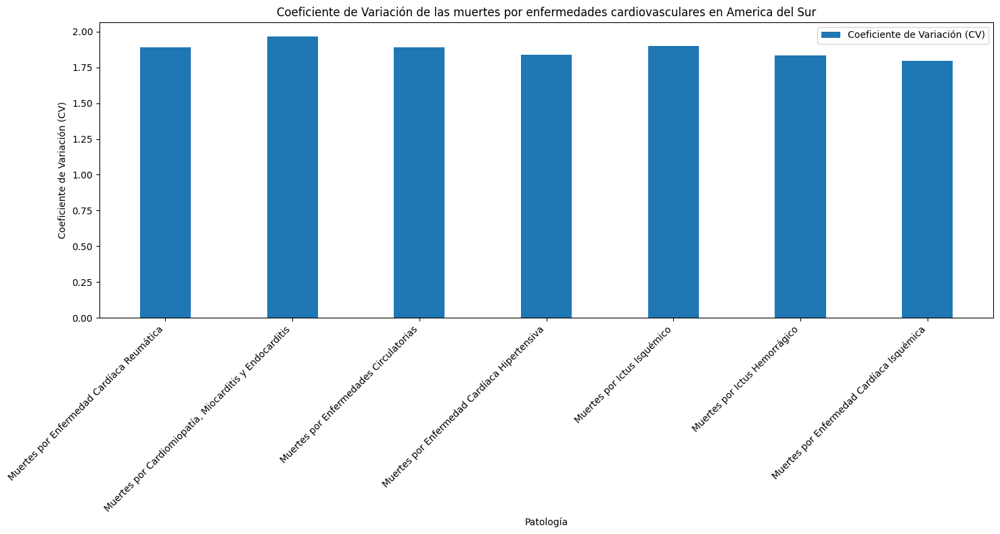

Coeficiente de Variación para las muertes por enfermedades cardiovasculares en Asia
Para Muertes por Enfermedad Cardíaca Reumática:
Coeficiente de Variación (CV): 3.859237661375627
Para Muertes por Cardiomiopatía, Miocarditis y Endocarditis:
Coeficiente de Variación (CV): 3.5776071005058503
Para Muertes por Enfermedades Circulatorias:
Coeficiente de Variación (CV): 3.674275350342567
Para Muertes por Enfermedad Cardíaca Hipertensiva:
Coeficiente de Variación (CV): 3.7966616507532764
Para Muertes por Ictus Isquémico:
Coeficiente de Variación (CV): 3.793462908438607
Para Muertes por Ictus Hemorrágico:
Coeficiente de Variación (CV): 3.7887284635260707
Para Muertes por Enfermedad Cardíaca Isquémica:
Coeficiente de Variación (CV): 3.7253045366808966


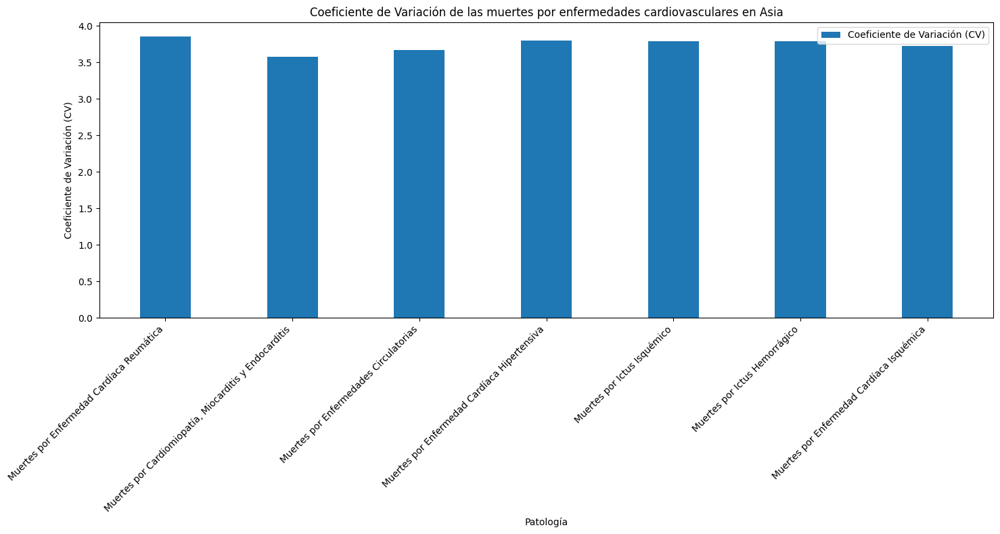

Coeficiente de Variación para las muertes por enfermedades cardiovasculares en Europa
Para Muertes por Enfermedad Cardíaca Reumática:
Coeficiente de Variación (CV): 3.234554971992544
Para Muertes por Cardiomiopatía, Miocarditis y Endocarditis:
Coeficiente de Variación (CV): 3.384906854230272
Para Muertes por Enfermedades Circulatorias:
Coeficiente de Variación (CV): 3.1441182430456043
Para Muertes por Enfermedad Cardíaca Hipertensiva:
Coeficiente de Variación (CV): 3.227881101993067
Para Muertes por Ictus Isquémico:
Coeficiente de Variación (CV): 3.3146764031254983
Para Muertes por Ictus Hemorrágico:
Coeficiente de Variación (CV): 3.239072238835943
Para Muertes por Enfermedad Cardíaca Isquémica:
Coeficiente de Variación (CV): 3.228277084845581


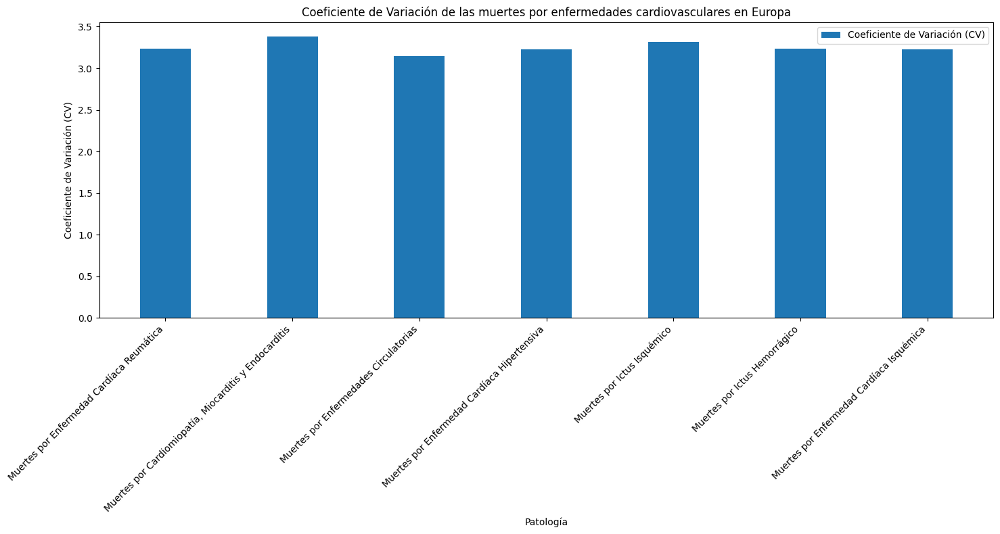

Coeficiente de Variación para las muertes por enfermedades cardiovasculares en Oceania
Para Muertes por Enfermedad Cardíaca Reumática:
Coeficiente de Variación (CV): 1.6948706667114768
Para Muertes por Cardiomiopatía, Miocarditis y Endocarditis:
Coeficiente de Variación (CV): 1.8402388441627076
Para Muertes por Enfermedades Circulatorias:
Coeficiente de Variación (CV): 1.866539583124795
Para Muertes por Enfermedad Cardíaca Hipertensiva:
Coeficiente de Variación (CV): 1.6859174664009684
Para Muertes por Ictus Isquémico:
Coeficiente de Variación (CV): 1.8247850256792146
Para Muertes por Ictus Hemorrágico:
Coeficiente de Variación (CV): 1.6255952443294792
Para Muertes por Enfermedad Cardíaca Isquémica:
Coeficiente de Variación (CV): 1.7398249446611769


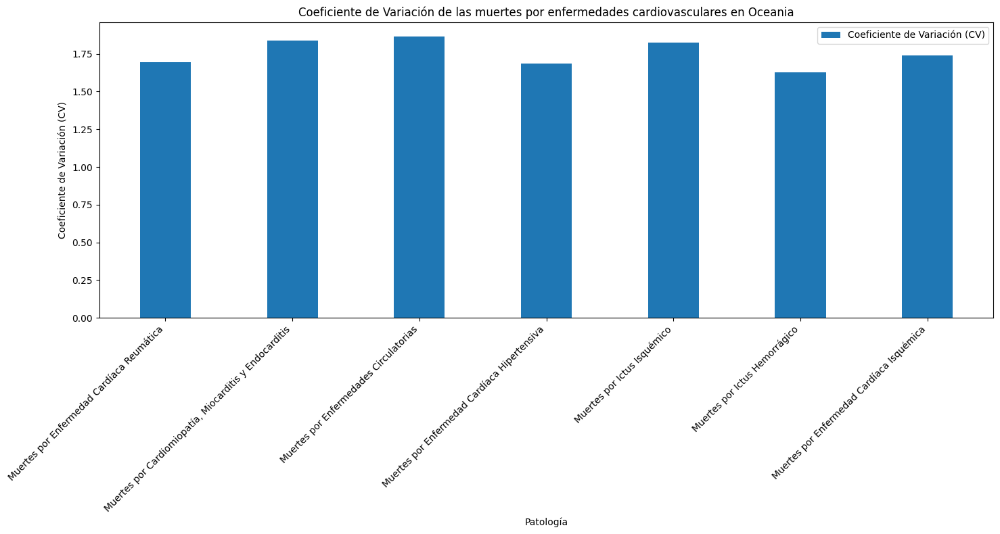

In [230]:
# Función para calcular el coeficiente de variación
def calcular_coeficiente_variacion(df, patologia):
    data_patologia = df[patologia].dropna()
    media = np.mean(data_patologia)
    desviacion_estandar = np.std(data_patologia)
    cv = desviacion_estandar / media
    return cv

# Bucle para calcular y graficar el coeficiente de variación por continente y patología
for continente, paises in continentes.items():
    df_continente = df[df['Entity'].isin(paises)]
    print(f"Coeficiente de Variación para las muertes por enfermedades cardiovasculares en {continente}")
    
    cvs_continente = {}

    for patologia in patologias:
        cv = calcular_coeficiente_variacion(df_continente, patologia)
        patologia_legible = reemplazar_texto(patologia)
        cvs_continente[patologia_legible] = cv
        
        print(f"Para {patologia_legible}:")
        print(f"Coeficiente de Variación (CV): {cv}")
        print("="*90)
        
    # Graficar el coeficiente de variación para el continente actual
    patologias_legibles = list(cvs_continente.keys())
    cvs = [cvs_continente[p] for p in patologias_legibles]
    
    x = np.arange(len(patologias_legibles))
    width = 0.4
    
    fig, ax = plt.subplots(figsize=(15, 8))
    
    bar = ax.bar(x, cvs, width, label='Coeficiente de Variación (CV)')
    
    ax.set_xlabel('Patología')
    ax.set_ylabel('Coeficiente de Variación (CV)')
    ax.set_title(f'Coeficiente de Variación de las muertes por enfermedades cardiovasculares en {continente}')
    ax.set_xticks(x)
    ax.set_xticklabels(patologias_legibles, rotation=45, ha="right")
    ax.legend()
    
    plt.tight_layout()
    plt.show()

## Sesgo

Sesgo para las muertes por enfermedades cardiovasculares en Africa
Para Muertes por Enfermedad Cardíaca Reumática:
Sesgo: 6.812073813175804
Para Muertes por Cardiomiopatía, Miocarditis y Endocarditis:
Sesgo: 6.801526284441501
Para Muertes por Enfermedades Circulatorias:
Sesgo: 6.881096546397012
Para Muertes por Enfermedad Cardíaca Hipertensiva:
Sesgo: 6.838792597838829
Para Muertes por Ictus Isquémico:
Sesgo: 6.941764356025917
Para Muertes por Ictus Hemorrágico:
Sesgo: 6.8183403647643726
Para Muertes por Enfermedad Cardíaca Isquémica:
Sesgo: 6.6298986496515155


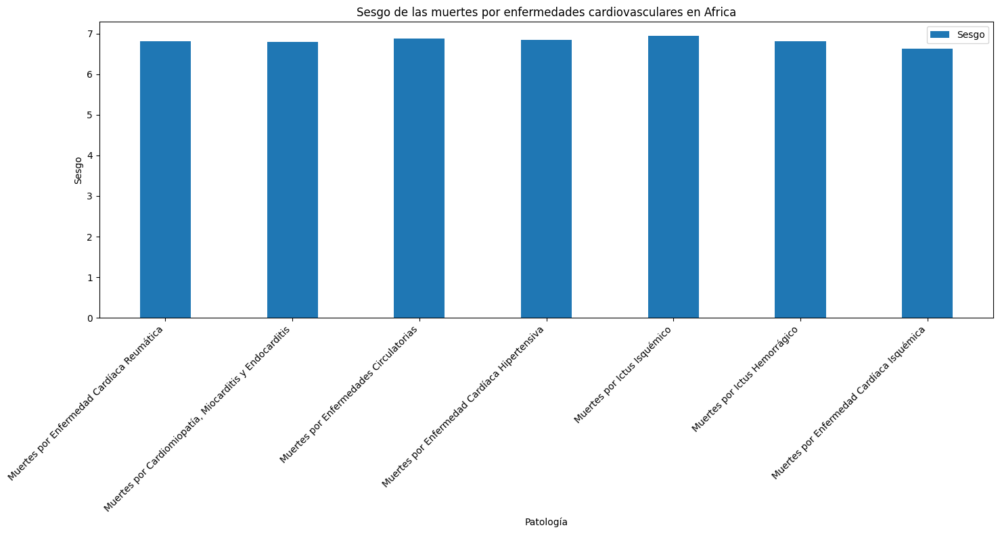

Sesgo para las muertes por enfermedades cardiovasculares en America del Norte
Para Muertes por Enfermedad Cardíaca Reumática:
Sesgo: 3.1279254301590766
Para Muertes por Cardiomiopatía, Miocarditis y Endocarditis:
Sesgo: 2.883780842503068
Para Muertes por Enfermedades Circulatorias:
Sesgo: 2.97627948918127
Para Muertes por Enfermedad Cardíaca Hipertensiva:
Sesgo: 3.2328371708536228
Para Muertes por Ictus Isquémico:
Sesgo: 3.055429484632576
Para Muertes por Ictus Hemorrágico:
Sesgo: 3.116313004930891
Para Muertes por Enfermedad Cardíaca Isquémica:
Sesgo: 2.955653017236642


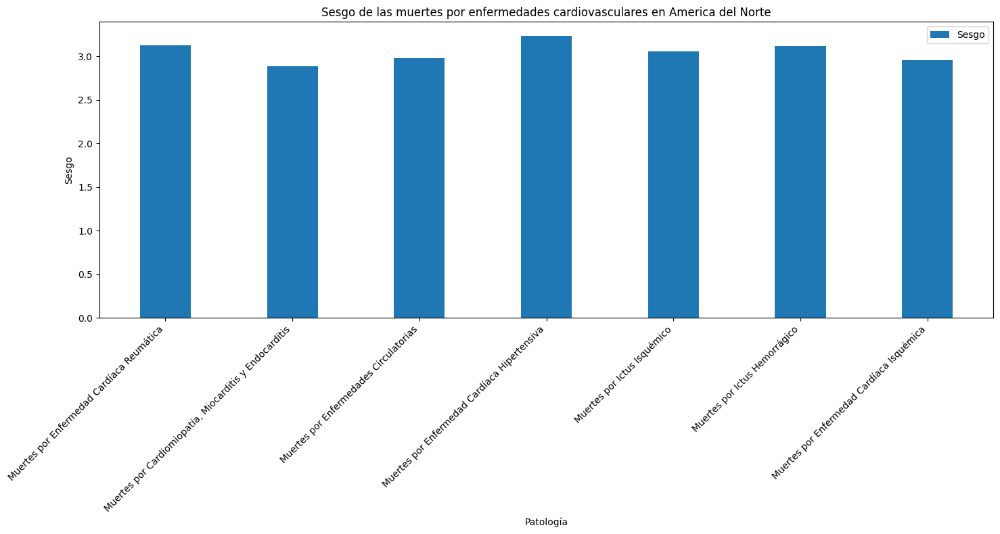

Sesgo para las muertes por enfermedades cardiovasculares en America del Sur
Para Muertes por Enfermedad Cardíaca Reumática:
Sesgo: 2.1861464938498303
Para Muertes por Cardiomiopatía, Miocarditis y Endocarditis:
Sesgo: 2.0317228133038063
Para Muertes por Enfermedades Circulatorias:
Sesgo: 2.3105249550119957
Para Muertes por Enfermedad Cardíaca Hipertensiva:
Sesgo: 2.4508933957603642
Para Muertes por Ictus Isquémico:
Sesgo: 2.1746053340883953
Para Muertes por Ictus Hemorrágico:
Sesgo: 2.228766358649378
Para Muertes por Enfermedad Cardíaca Isquémica:
Sesgo: 2.3490705514632153


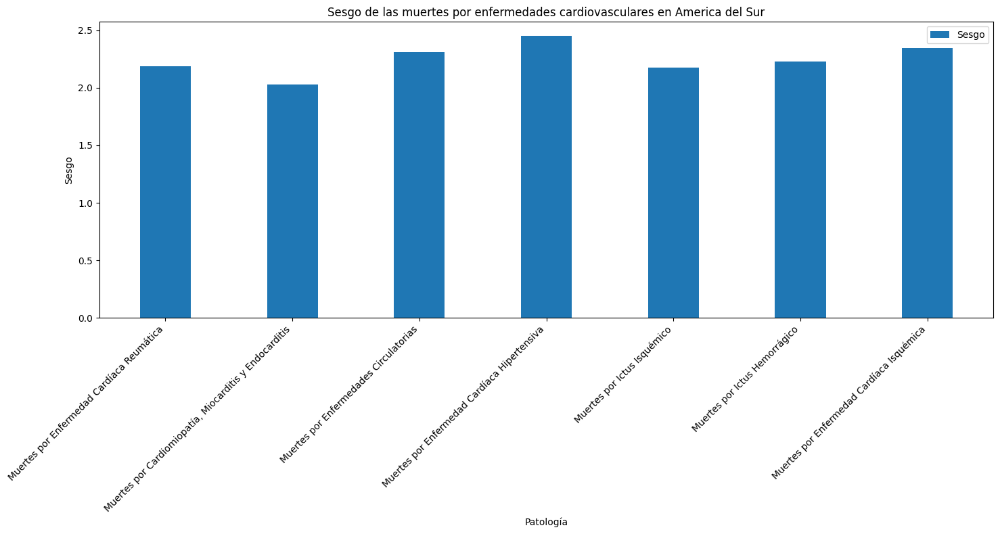

Sesgo para las muertes por enfermedades cardiovasculares en Asia
Para Muertes por Enfermedad Cardíaca Reumática:
Sesgo: 4.773089587314836
Para Muertes por Cardiomiopatía, Miocarditis y Endocarditis:
Sesgo: 5.7771730689452685
Para Muertes por Enfermedades Circulatorias:
Sesgo: 5.75228599744891
Para Muertes por Enfermedad Cardíaca Hipertensiva:
Sesgo: 5.483265169494541
Para Muertes por Ictus Isquémico:
Sesgo: 5.289504916329435
Para Muertes por Ictus Hemorrágico:
Sesgo: 5.02451469519539
Para Muertes por Enfermedad Cardíaca Isquémica:
Sesgo: 5.52710869355686


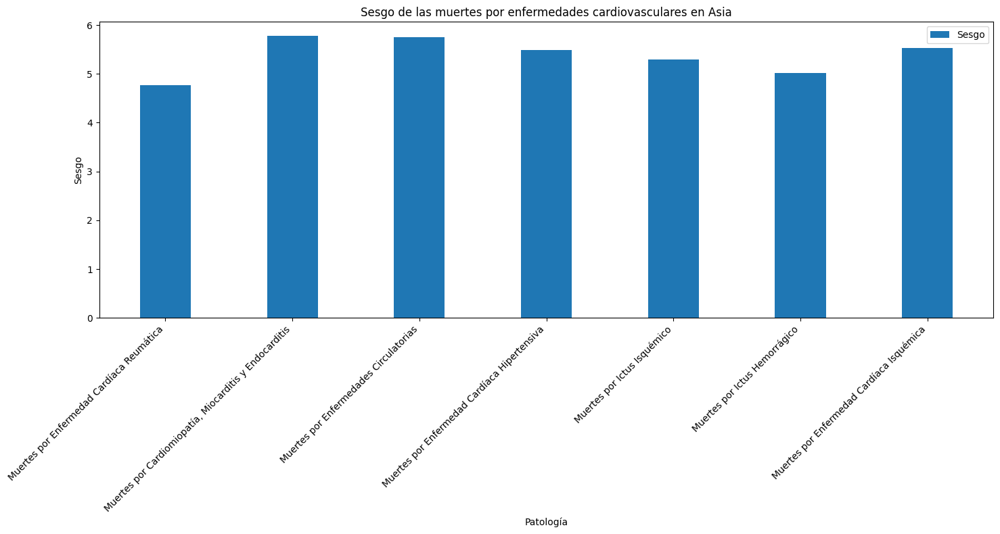

Sesgo para las muertes por enfermedades cardiovasculares en Europa
Para Muertes por Enfermedad Cardíaca Reumática:
Sesgo: 5.4770023968595565
Para Muertes por Cardiomiopatía, Miocarditis y Endocarditis:
Sesgo: 4.889682828310057
Para Muertes por Enfermedades Circulatorias:
Sesgo: 5.583149121221579
Para Muertes por Enfermedad Cardíaca Hipertensiva:
Sesgo: 5.683342450912456
Para Muertes por Ictus Isquémico:
Sesgo: 5.162651130021468
Para Muertes por Ictus Hemorrágico:
Sesgo: 5.465142507149118
Para Muertes por Enfermedad Cardíaca Isquémica:
Sesgo: 5.281670460411995


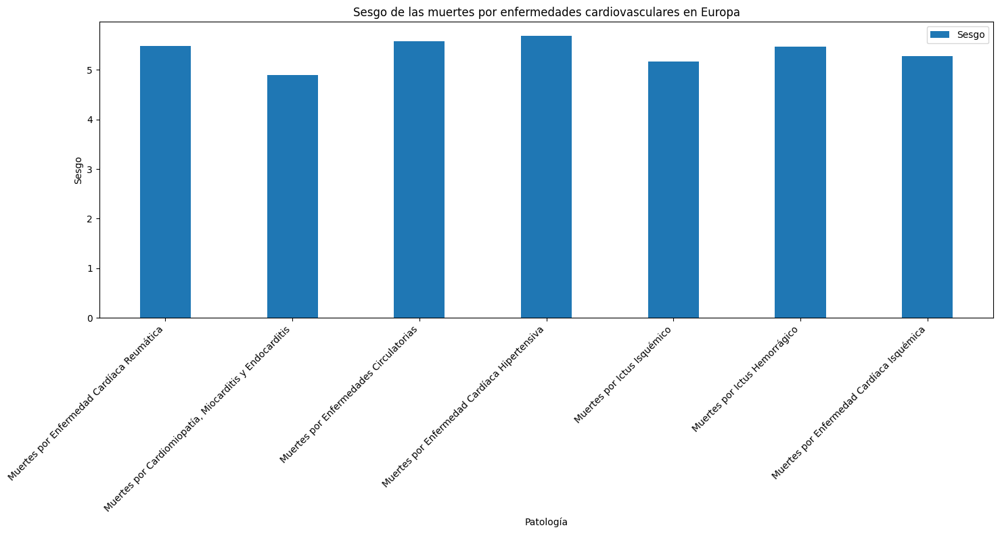

Sesgo para las muertes por enfermedades cardiovasculares en Oceania
Para Muertes por Enfermedad Cardíaca Reumática:
Sesgo: 1.9629731492482232
Para Muertes por Cardiomiopatía, Miocarditis y Endocarditis:
Sesgo: 1.8584947988140659
Para Muertes por Enfermedades Circulatorias:
Sesgo: 1.762019439384836
Para Muertes por Enfermedad Cardíaca Hipertensiva:
Sesgo: 2.075243996511416
Para Muertes por Ictus Isquémico:
Sesgo: 1.7002176614464826
Para Muertes por Ictus Hemorrágico:
Sesgo: 1.9502770472878916
Para Muertes por Enfermedad Cardíaca Isquémica:
Sesgo: 1.778673740075485


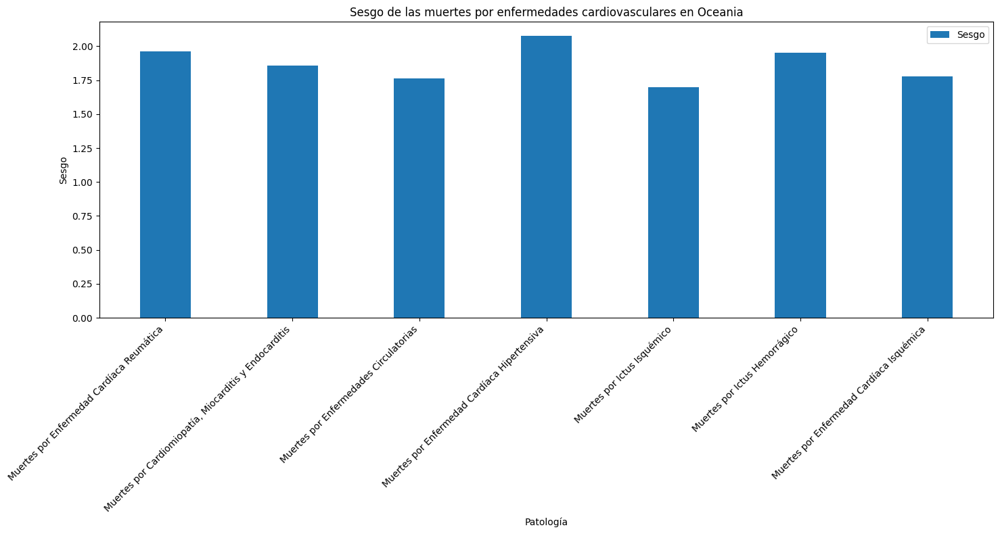

In [231]:

# Función para calcular el sesgo
def calcular_sesgo(df, patologia):
    data_patologia = df[patologia].dropna()
    sesgo = skew(data_patologia)
    return sesgo

# Bucle para calcular y graficar el sesgo por continente y patología
for continente, paises in continentes.items():
    df_continente = df[df['Entity'].isin(paises)]
    print(f"Sesgo para las muertes por enfermedades cardiovasculares en {continente}")
    
    sesgos_continente = {}

    for patologia in patologias:
        sesgo = calcular_sesgo(df_continente, patologia)
        patologia_legible = reemplazar_texto(patologia)
        sesgos_continente[patologia_legible] = sesgo
        
        print(f"Para {patologia_legible}:")
        print(f"Sesgo: {sesgo}")
        print("="*90)
        
    # Graficar el sesgo para el continente actual
    patologias_legibles = list(sesgos_continente.keys())
    sesgos = [sesgos_continente[p] for p in patologias_legibles]
    
    x = np.arange(len(patologias_legibles))
    width = 0.4
    
    fig, ax = plt.subplots(figsize=(15, 8))
    
    bar = ax.bar(x, sesgos, width, label='Sesgo')
    
    ax.set_xlabel('Patología')
    ax.set_ylabel('Sesgo')
    ax.set_title(f'Sesgo de las muertes por enfermedades cardiovasculares en {continente}')
    ax.set_xticks(x)
    ax.set_xticklabels(patologias_legibles, rotation=45, ha="right")
    ax.legend()
    
    plt.tight_layout()
    plt.show()

## Kurtosis

Curtosis para las muertes por enfermedades cardiovasculares en Africa
Para Muertes por Enfermedad Cardíaca Reumática:
Curtosis Experimental: 46.04680268228292
Curtosis Teórica: -0.17630059780283913
Para Muertes por Cardiomiopatía, Miocarditis y Endocarditis:
Curtosis Experimental: 46.44561116322248
Curtosis Teórica: -0.07132103182531013
Para Muertes por Enfermedades Circulatorias:
Curtosis Experimental: 47.71543533044533
Curtosis Teórica: 0.03309413554911611
Para Muertes por Enfermedad Cardíaca Hipertensiva:
Curtosis Experimental: 47.05718050936147
Curtosis Teórica: 0.24372051486266644
Para Muertes por Ictus Isquémico:
Curtosis Experimental: 49.31321236130528
Curtosis Teórica: -0.12108905353248867
Para Muertes por Ictus Hemorrágico:
Curtosis Experimental: 46.05700279490813
Curtosis Teórica: 0.30357822347647057
Para Muertes por Enfermedad Cardíaca Isquémica:
Curtosis Experimental: 45.15214433546512
Curtosis Teórica: -0.30581743648441506


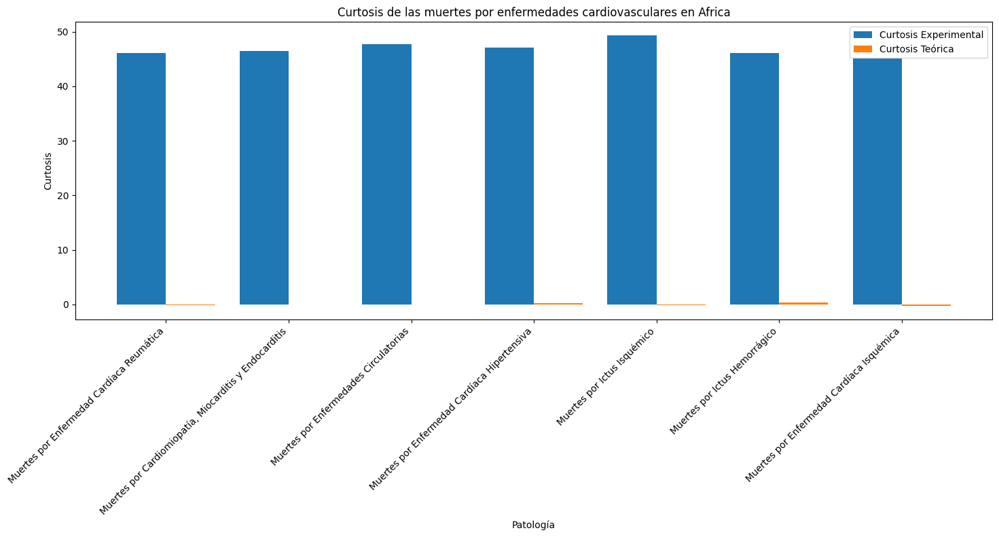

Curtosis para las muertes por enfermedades cardiovasculares en America del Norte
Para Muertes por Enfermedad Cardíaca Reumática:
Curtosis Experimental: 8.935125168851714
Curtosis Teórica: -0.17825564813430184
Para Muertes por Cardiomiopatía, Miocarditis y Endocarditis:
Curtosis Experimental: 6.448305346576577
Curtosis Teórica: 0.10088411026467359
Para Muertes por Enfermedades Circulatorias:
Curtosis Experimental: 7.340937096495649
Curtosis Teórica: -0.10872370849062385
Para Muertes por Enfermedad Cardíaca Hipertensiva:
Curtosis Experimental: 9.841946654831874
Curtosis Teórica: 0.3998792616313813
Para Muertes por Ictus Isquémico:
Curtosis Experimental: 8.05726903315564
Curtosis Teórica: 0.15783599303406337
Para Muertes por Ictus Hemorrágico:
Curtosis Experimental: 8.611553745511936
Curtosis Teórica: 0.12604874788662146
Para Muertes por Enfermedad Cardíaca Isquémica:
Curtosis Experimental: 7.190050419456398
Curtosis Teórica: 0.1694269418478993


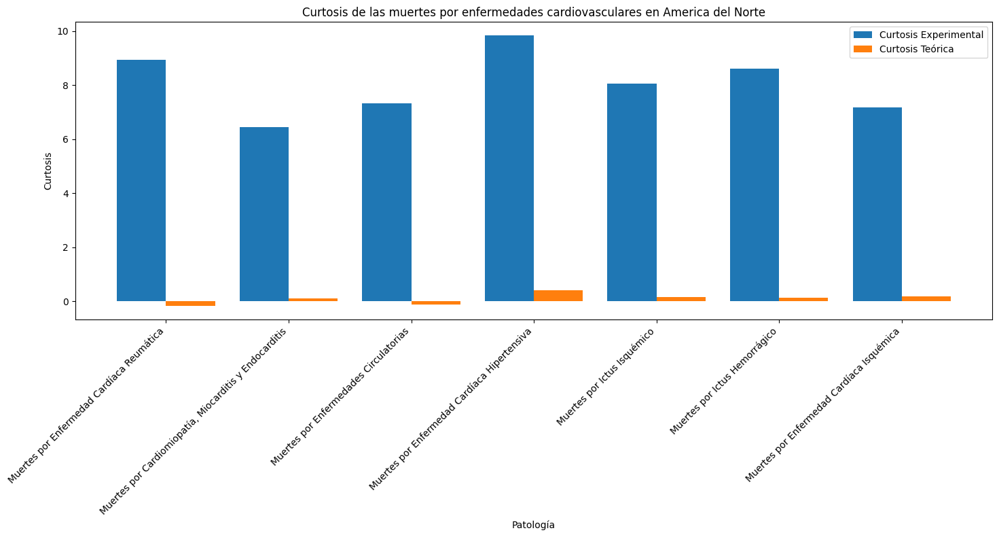

Curtosis para las muertes por enfermedades cardiovasculares en America del Sur
Para Muertes por Enfermedad Cardíaca Reumática:
Curtosis Experimental: 3.309746522719146
Curtosis Teórica: 0.11617547439441811
Para Muertes por Cardiomiopatía, Miocarditis y Endocarditis:
Curtosis Experimental: 2.52790703003018
Curtosis Teórica: -0.21912484303655289
Para Muertes por Enfermedades Circulatorias:
Curtosis Experimental: 4.366056712817766
Curtosis Teórica: 0.23187405305115005
Para Muertes por Enfermedad Cardíaca Hipertensiva:
Curtosis Experimental: 5.0927782225837355
Curtosis Teórica: 0.24126272641853674
Para Muertes por Ictus Isquémico:
Curtosis Experimental: 3.261251555429067
Curtosis Teórica: -0.32999215715071895
Para Muertes por Ictus Hemorrágico:
Curtosis Experimental: 3.5739522947761344
Curtosis Teórica: 0.3434747246684213
Para Muertes por Enfermedad Cardíaca Isquémica:
Curtosis Experimental: 4.43238021660484
Curtosis Teórica: -0.09159730563206736


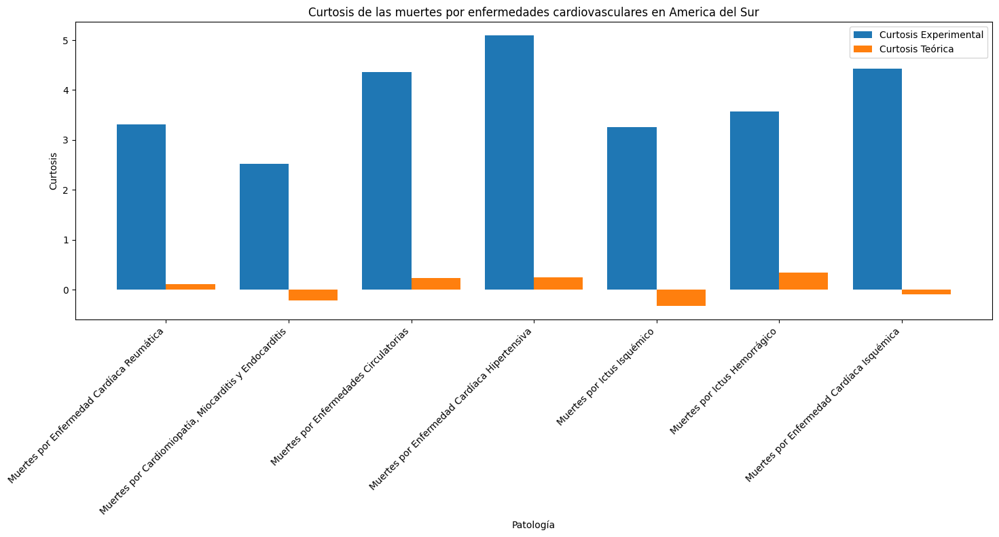

Curtosis para las muertes por enfermedades cardiovasculares en Asia
Para Muertes por Enfermedad Cardíaca Reumática:
Curtosis Experimental: 23.389685667846635
Curtosis Teórica: 0.06388979162652797
Para Muertes por Cardiomiopatía, Miocarditis y Endocarditis:
Curtosis Experimental: 34.45519433332816
Curtosis Teórica: 0.04402877621282908
Para Muertes por Enfermedades Circulatorias:
Curtosis Experimental: 35.69637337165739
Curtosis Teórica: -0.024327361390491742
Para Muertes por Enfermedad Cardíaca Hipertensiva:
Curtosis Experimental: 31.898976494280006
Curtosis Teórica: -0.08311304332488723
Para Muertes por Ictus Isquémico:
Curtosis Experimental: 28.87140487083146
Curtosis Teórica: -0.09259702970329231
Para Muertes por Ictus Hemorrágico:
Curtosis Experimental: 25.387182400818855
Curtosis Teórica: -0.10104804650253874
Para Muertes por Enfermedad Cardíaca Isquémica:
Curtosis Experimental: 32.58467380516339
Curtosis Teórica: 0.29912332202974223


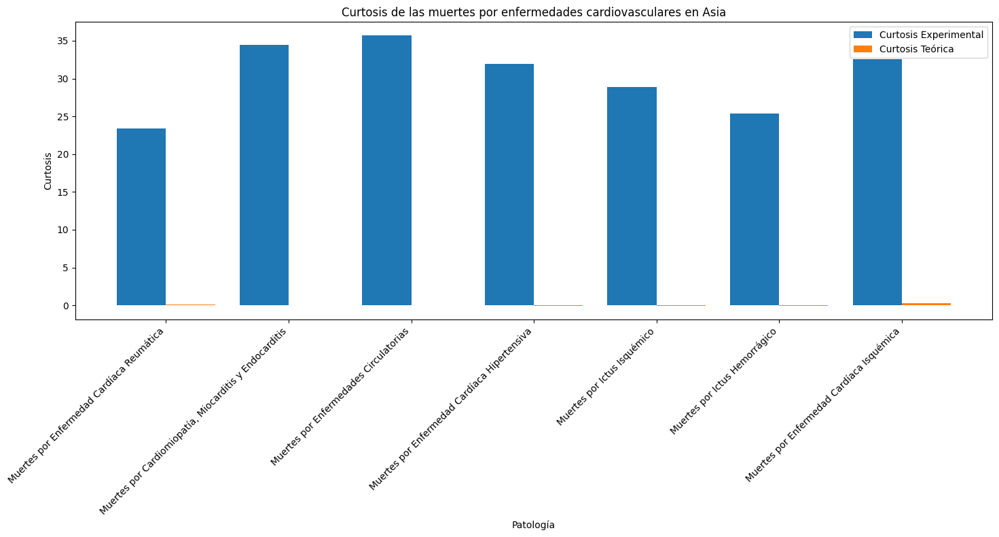

Curtosis para las muertes por enfermedades cardiovasculares en Europa
Para Muertes por Enfermedad Cardíaca Reumática:
Curtosis Experimental: 31.056568545187254
Curtosis Teórica: -0.10689943139859004
Para Muertes por Cardiomiopatía, Miocarditis y Endocarditis:
Curtosis Experimental: 24.0204125304593
Curtosis Teórica: -0.20255526821719583
Para Muertes por Enfermedades Circulatorias:
Curtosis Experimental: 31.100041173940298
Curtosis Teórica: -0.02483248064135113
Para Muertes por Enfermedad Cardíaca Hipertensiva:
Curtosis Experimental: 33.696993763399476
Curtosis Teórica: -0.22689754675722762
Para Muertes por Ictus Isquémico:
Curtosis Experimental: 27.172385577278604
Curtosis Teórica: 0.06274417688159728
Para Muertes por Ictus Hemorrágico:
Curtosis Experimental: 30.529504125021475
Curtosis Teórica: 0.14683634299395498
Para Muertes por Enfermedad Cardíaca Isquémica:
Curtosis Experimental: 28.25273839032339
Curtosis Teórica: 0.23202632771086895


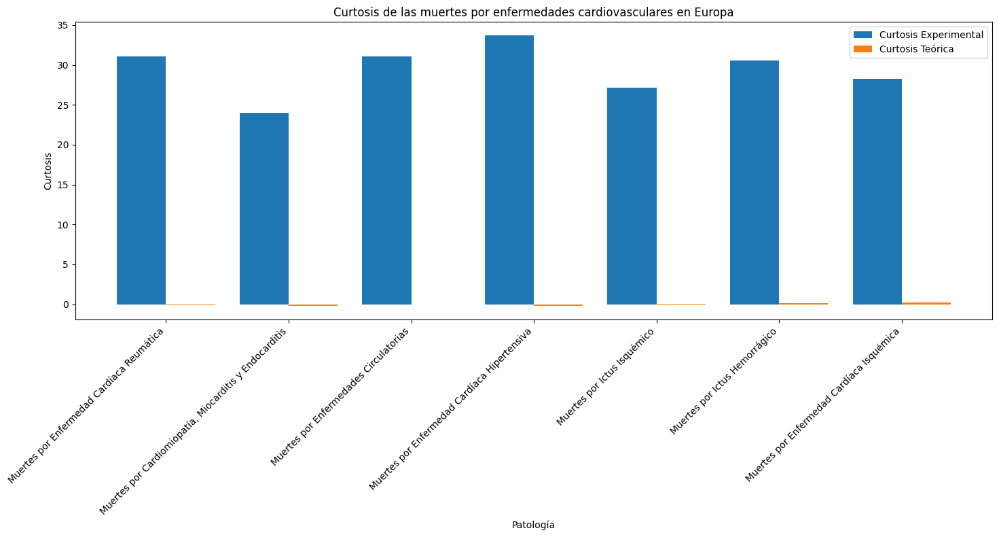

Curtosis para las muertes por enfermedades cardiovasculares en Oceania
Para Muertes por Enfermedad Cardíaca Reumática:
Curtosis Experimental: 2.673143530783988
Curtosis Teórica: 0.9907106907530356
Para Muertes por Cardiomiopatía, Miocarditis y Endocarditis:
Curtosis Experimental: 2.037132897326118
Curtosis Teórica: 0.14397984805769415
Para Muertes por Enfermedades Circulatorias:
Curtosis Experimental: 1.5374506826452414
Curtosis Teórica: 0.04362715442149101
Para Muertes por Enfermedad Cardíaca Hipertensiva:
Curtosis Experimental: 3.5659577537576226
Curtosis Teórica: 0.17759152753876428
Para Muertes por Ictus Isquémico:
Curtosis Experimental: 1.1902494821828347
Curtosis Teórica: -0.36839209074223467
Para Muertes por Ictus Hemorrágico:
Curtosis Experimental: 2.786795622349495
Curtosis Teórica: 0.09356112145187323
Para Muertes por Enfermedad Cardíaca Isquémica:
Curtosis Experimental: 1.622534375162366
Curtosis Teórica: -0.0387367826981988


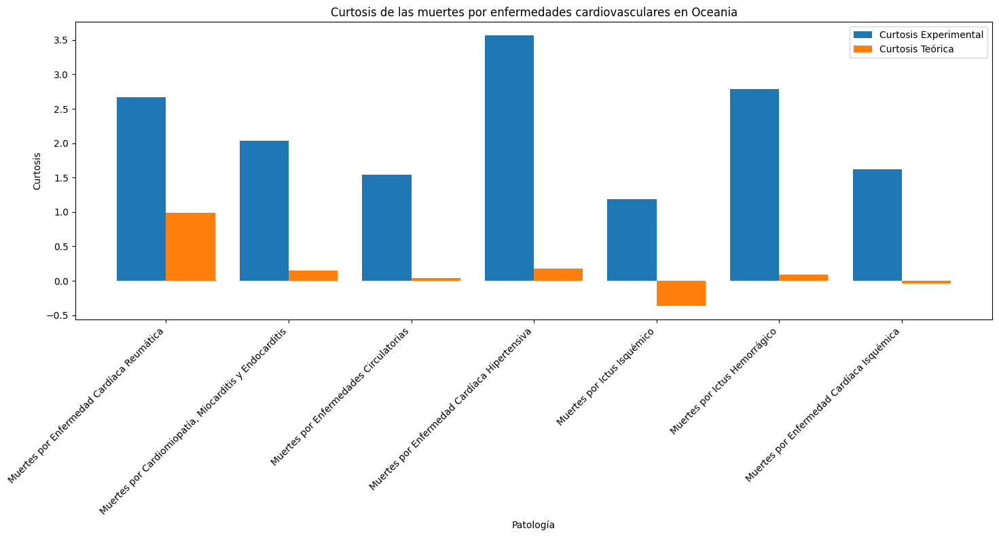

In [234]:
from scipy.stats import kurtosis, norm
# Función para calcular la curtosis
def calcular_curtosis(df, patologia):
    data_patologia = df[patologia].dropna()
    curtosis_experimental = kurtosis(data_patologia)
    mu, std = norm.fit(data_patologia)
    data_teorica = np.random.normal(mu, std, len(data_patologia))
    curtosis_teorica = kurtosis(data_teorica)
    return curtosis_experimental, curtosis_teorica

# Bucle para calcular y graficar la curtosis por continente y patología
for continente, paises in continentes.items():
    df_continente = df[df['Entity'].isin(paises)]
    print(f"Curtosis para las muertes por enfermedades cardiovasculares en {continente}")
    
    curtosis_continente = {}

    for patologia in patologias:
        curtosis_experimental, curtosis_teorica = calcular_curtosis(df_continente, patologia)
        patologia_legible = reemplazar_texto(patologia)
        curtosis_continente[patologia_legible] = (curtosis_experimental, curtosis_teorica)
        
        print(f"Para {patologia_legible}:")
        print(f"Curtosis Experimental: {curtosis_experimental}")
        print(f"Curtosis Teórica: {curtosis_teorica}")
        print("="*90)
        
    # Graficar la curtosis para el continente actual
    patologias_legibles = list(curtosis_continente.keys())
    curtosis_experimentales = [curtosis_continente[p][0] for p in patologias_legibles]
    curtosis_teoricas = [curtosis_continente[p][1] for p in patologias_legibles]
    
    x = np.arange(len(patologias_legibles))
    width = 0.4
    
    fig, ax = plt.subplots(figsize=(15, 8))
    
    bar1 = ax.bar(x - width/2, curtosis_experimentales, width, label='Curtosis Experimental')
    bar2 = ax.bar(x + width/2, curtosis_teoricas, width, label='Curtosis Teórica')
    
    ax.set_xlabel('Patología')
    ax.set_ylabel('Curtosis')
    ax.set_title(f'Curtosis de las muertes por enfermedades cardiovasculares en {continente}')
    ax.set_xticks(x)
    ax.set_xticklabels(patologias_legibles, rotation=45, ha="right")
    ax.legend()
    
    plt.tight_layout()
    plt.show()

# Intervalos

## Intervalo de confianza para la media de la población

In [235]:
# Función para calcular el intervalo de confianza para la media
def intervalo_confianza_media(df, patologia, confianza=0.95):
    data_patologia = df[patologia].dropna()
    n = len(data_patologia)
    media = np.mean(data_patologia)
    stderr = stats.sem(data_patologia)
    intervalo = stats.t.interval(confianza, n-1, loc=media, scale=stderr)
    return media, intervalo

# Bucle para calcular el intervalo de confianza por continente y patología
for continente, paises in continentes.items():
    df_continente = df[df['Entity'].isin(paises)]
    print(f"Intervalo de confianza para la media de las muertes por enfermedades cardiovasculares en {continente}")
    
    for patologia in patologias:
        media, intervalo = intervalo_confianza_media(df_continente, patologia)
        patologia_legible = reemplazar_texto(patologia)
        
        print(f"Para {patologia_legible}:")
        print(f"Media: {media}")
        print(f"Intervalo de Confianza: {intervalo}")
        print("="*90)

Intervalo de confianza para la media de las muertes por enfermedades cardiovasculares en Africa
Para Muertes por Enfermedad Cardíaca Reumática:
Media: 695.2907416666666
Intervalo de Confianza: (542.735386669177, 847.8460966641561)
Para Muertes por Cardiomiopatía, Miocarditis y Endocarditis:
Media: 1334.9662305555557
Intervalo de Confianza: (1039.3841972125797, 1630.5482638985318)
Para Muertes por Enfermedades Circulatorias:
Media: 2629.5956462962963
Intervalo de Confianza: (2046.8903257914121, 3212.3009668011805)
Para Muertes por Enfermedad Cardíaca Hipertensiva:
Media: 5296.967296296296
Intervalo de Confianza: (4130.730114142398, 6463.204478450194)
Para Muertes por Ictus Isquémico:
Media: 6525.879962962963
Intervalo de Confianza: (5075.780834998854, 7975.979090927072)
Para Muertes por Ictus Hemorrágico:
Media: 10844.348324074075
Intervalo de Confianza: (8455.870780000716, 13232.825868147434)
Para Muertes por Enfermedad Cardíaca Isquémica:
Media: 22916.073101851853
Intervalo de Confian

## Intervalo de confianza para la varianza de la población

In [236]:
# Función para calcular el intervalo de confianza para la varianza
def intervalo_confianza_varianza(df, patologia, confianza=0.95):
    data_patologia = df[patologia].dropna()
    n = len(data_patologia)
    varianza_muestral = np.var(data_patologia, ddof=1)
    chi2_inf = stats.chi2.ppf((1 - confianza) / 2, n - 1)
    chi2_sup = stats.chi2.ppf(1 - (1 - confianza) / 2, n - 1)
    intervalo_inf = (n - 1) * varianza_muestral / chi2_sup
    intervalo_sup = (n - 1) * varianza_muestral / chi2_inf
    return varianza_muestral, (intervalo_inf, intervalo_sup)

# Bucle para calcular el intervalo de confianza por continente y patología
for continente, paises in continentes.items():
    df_continente = df[df['Entity'].isin(paises)]
    print(f"Intervalo de confianza para la varianza de las muertes por enfermedades cardiovasculares en {continente}")
    
    for patologia in patologias:
        varianza_muestral, intervalo = intervalo_confianza_varianza(df_continente, patologia)
        patologia_legible = reemplazar_texto(patologia)
        
        print(f"Para {patologia_legible}:")
        print(f"Varianza Muestral: {varianza_muestral}")
        print(f"Intervalo de Confianza: {intervalo}")
        print("="*90)

Intervalo de confianza para la varianza de las muertes por enfermedades cardiovasculares en Africa
Para Muertes por Enfermedad Cardíaca Reumática:
Varianza Muestral: 6528413.021100154
Intervalo de Confianza: (6010742.862681649, 7116316.086102799)
Para Muertes por Cardiomiopatía, Miocarditis y Endocarditis:
Varianza Muestral: 24508050.885083783
Intervalo de Confianza: (22564686.31191649, 26715073.96803105)
Para Muertes por Enfermedades Circulatorias:
Varianza Muestral: 95246861.8537425
Intervalo de Confianza: (87694267.07989295, 103824125.85874909)
Para Muertes por Enfermedad Cardíaca Hipertensiva:
Varianza Muestral: 381528052.5168816
Intervalo de Confianza: (351274806.1690832, 415885791.63881075)
Para Muertes por Ictus Isquémico:
Varianza Muestral: 589858838.5959316
Intervalo de Confianza: (543086013.8016673, 642977386.3974631)
Para Muertes por Ictus Hemorrágico:
Varianza Muestral: 1600276521.8862612
Intervalo de Confianza: (1473382681.3892224, 1744386195.8649094)
Para Muertes por Enfe

# Prueba

## Prueba *t_Student*

In [243]:
# Función para realizar la prueba t-Student entre dos continentes
def prueba_t_student(df, patologia, continente1, continente2):
    data_continente1 = df[df['Entity'].isin(continentes[continente1])][patologia].dropna()
    data_continente2 = df[df['Entity'].isin(continentes[continente2])][patologia].dropna()
    
    t_stat, p_value = stats.ttest_ind(data_continente1, data_continente2, equal_var=False)  # Prueba t para muestras independientes
    return t_stat, p_value

# Comparación de dos continentes específicos
continente1 = "Africa"
continente2 = "Europa"

# Bucle para realizar la prueba t-Student por patología
for patologia in df.columns[2:]:  # Suponiendo que las patologías empiezan en la tercera columna
    t_stat, p_value = prueba_t_student(df, patologia, continente1, continente2)
    patologia_legible = reemplazar_texto(patologia)
    
    print(f"Prueba t-Student para {patologia_legible} entre {continente1} y {continente2}:")
    print(f"Estadístico t: {t_stat}")
    print(f"Valor p: {p_value}")
    if p_value < 0.05:
        print("Resultado: Hay una diferencia significativa entre las medias de los dos grupos.")
    else:
        print("Resultado: No hay una diferencia significativa entre las medias de los dos grupos.")
    print("="*90)

Prueba t-Student para Year entre Africa y Europa:
Estadístico t: 0.0
Valor p: 1.0
Resultado: No hay una diferencia significativa entre las medias de los dos grupos.
Prueba t-Student para Muertes por Enfermedad Cardíaca Reumática entre Africa y Europa:
Estadístico t: -2.3795523982282876
Valor p: 0.017463141806884762
Resultado: Hay una diferencia significativa entre las medias de los dos grupos.
Prueba t-Student para Muertes por Cardiomiopatía, Miocarditis y Endocarditis entre Africa y Europa:
Estadístico t: -6.81692887156812
Valor p: 1.773538966170505e-11
Resultado: Hay una diferencia significativa entre las medias de los dos grupos.
Prueba t-Student para Muertes por Enfermedades Circulatorias entre Africa y Europa:
Estadístico t: -7.268743044924518
Valor p: 8.213435744425502e-13
Resultado: Hay una diferencia significativa entre las medias de los dos grupos.
Prueba t-Student para Muertes por Enfermedad Cardíaca Hipertensiva entre Africa y Europa:
Estadístico t: -1.6254958013295984
Valor